In [112]:
import json
import pandas as pd
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt


pd.options.plotting.backend = "plotly"

pd.set_option('display.max_rows', None)

In [172]:
df_source = pd.read_csv("data/query_by_category.csv", delimiter = ",")
df_source.head()

,platform,query,pds_cat_id,cft_cat_name,imps,clicks,search_count,conversion,gp
0,touch,oil change,5e3979be-70e4-4e97-a028-1f764764a33c,Oil Change,5168,589,992,77,970.8709
1,touch,massage,f0c8bbc1-baa4-4048-ace6-8bf7bf14cae5,Couples Massage,4967,402,1801,16,499.1053
2,touch,great wolf lodge,23de9165-5b2b-46d2-8074-3621bc39caed,Water Parks,3916,733,1326,8,483.3520
3,touch,botox,46593102-75e9-4da6-96f8-5b5449827a5b,Botox,3402,460,658,8,502.2845
4,web,massage,f0c8bbc1-baa4-4048-ace6-8bf7bf14cae5,Couples Massage,3337,100,913,2,53.2699


In [295]:
date_to_save = df_source[["cft_cat_name", "gp"]].groupby("cft_cat_name").sum().sort_values(["cft_cat_name", "gp"], ascending = True).reset_index()
#saved.head()
# Write to CSV without pandas
#output_file = 'models/category_sort.csv'
#with open(output_file, 'w', encoding='utf-8') as f:
#    f.write('text,value\n')
#    for row, data in date_to_save.iterrows():
#        #print (data.gp)
#        f.write(f'{data.cft_cat_name},{data.gp}\n')

In [139]:
df_source.query("query == 'couple massage' and conversion > 0").groupby(["cft_cat_name"]).agg({
        'query' : 'first', 'pds_cat_id' : 'first',
        'cft_cat_name' : 'first', 'imps' : 'sum', 'clicks': 'sum', 'conversion' : 'sum', 'gp': 'sum'}).sort_values(['gp'], ascending = False)

,query,pds_cat_id,cft_cat_name,imps,clicks,conversion,gp
cft_cat_name,,,,,,,
Couples Massage,couple massage,f0c8bbc1-baa4-4048-ace6-8bf7bf14cae5,Couples Massage,1451,121,3,94.1285


In [251]:
df = df_source[["imps", "conversion", "clicks", "gp", "cft_cat_name"]].query("clicks > 0").groupby(["cft_cat_name"]).agg({
    "clicks" : "sum", "cft_cat_name" : "first", "conversion" : "sum", "imps" : "sum", "gp" : "sum"}
)[["imps", "conversion", "clicks", "gp"]].reset_index().sort_values("gp", ascending = False)
df["ctr"] = df["clicks"] / df["imps"]
df["cvr"] = df["conversion"] / df["clicks"]
df.head()

,cft_cat_name,imps,conversion,clicks,gp,ctr,cvr
477,Laser Hair Removal,7107,38,847,3509.4022,0.119178,0.044864
206,Couples Massage,21941,61,1774,2499.2164,0.080853,0.034386
303,Facial,23955,63,1899,2420.9111,0.079274,0.033175
563,Oil Change,13390,179,1291,2347.3227,0.096415,0.138652
441,Injectables & Fillers,6306,18,854,1623.4938,0.135427,0.021077


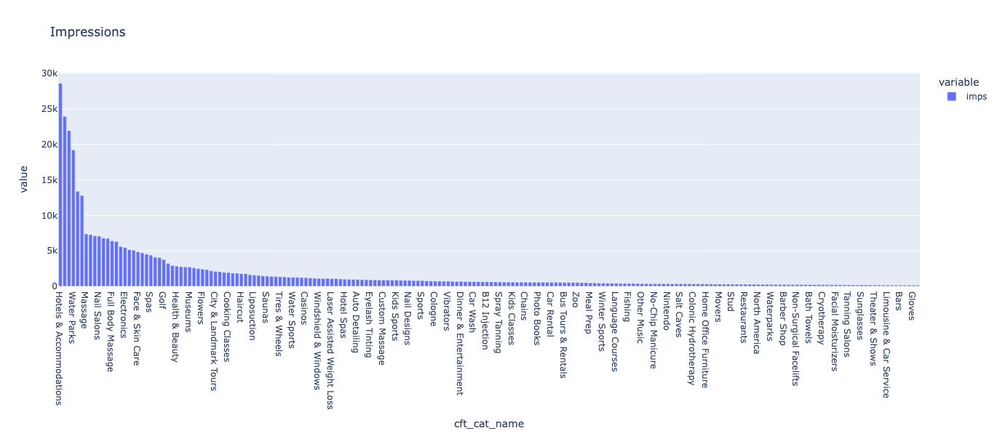

In [257]:
df1 = df1.reset_index().set_index(["cft_cat_name"])
df1 = df1.sort_values(by='imps', ascending=False).head(200)
df1["imps"].plot.bar(width=1200, height=600, title = "Impressions")

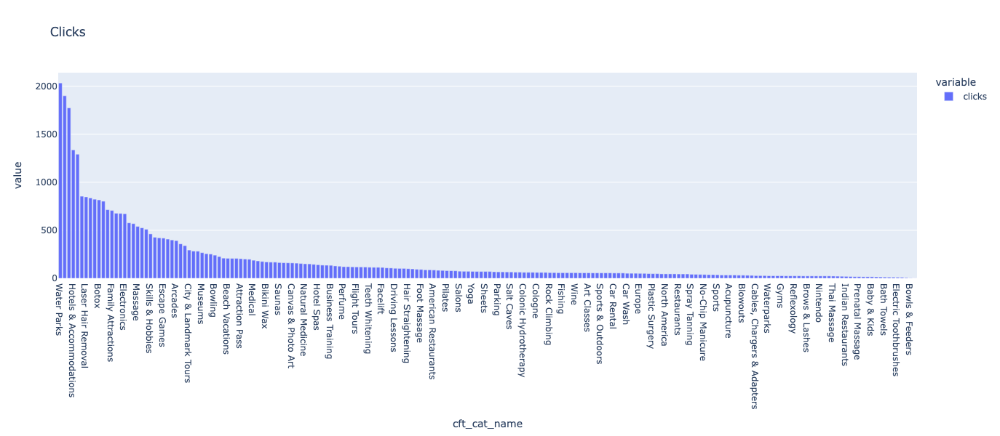

In [258]:
df1 = df1.reset_index().set_index(["cft_cat_name"])
df1 = df1.sort_values(by='clicks', ascending=False).head(200)
df1["clicks"].plot.bar(width=1200, height=600, title = "Clicks")

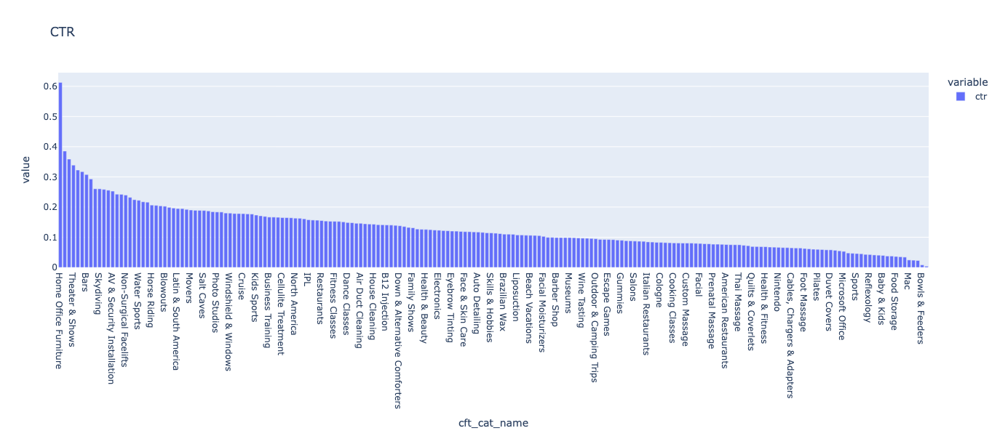

In [259]:
df1 = df1.reset_index().set_index(["cft_cat_name"])
df1 = df1.sort_values(by='ctr', ascending=False).head(200)
df1["ctr"].plot.bar(width=1200, height=600, title = "CTR")

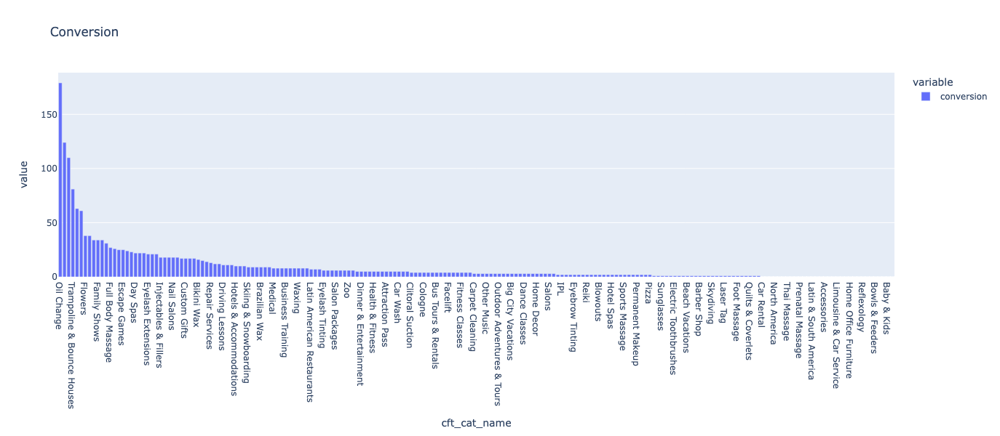

In [261]:
df1 = df1.reset_index().set_index(["cft_cat_name"])
df1 = df1.sort_values(by='conversion', ascending=False).head(200)
df1["conversion"].plot.bar(width=1200, height=600, title = "Conversion")

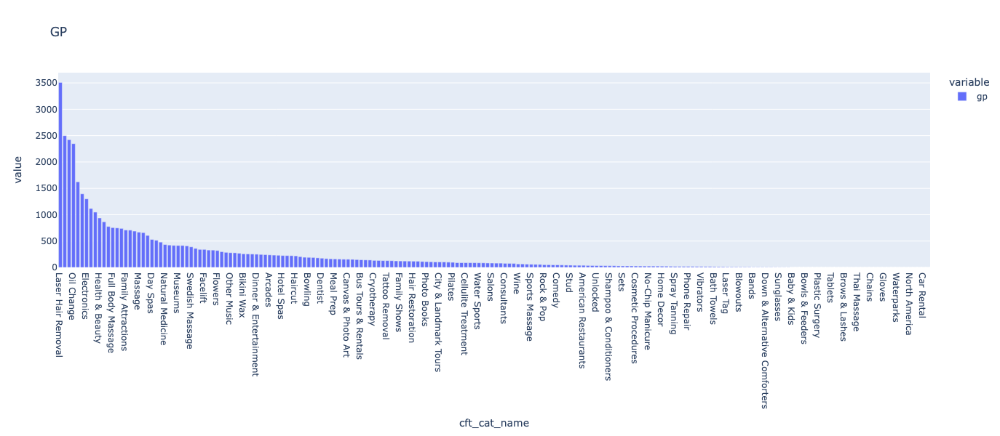

In [262]:
df1 = df1.reset_index().set_index(["cft_cat_name"])
df1 = df1.sort_values(by='gp', ascending=False).head(200)
df1["gp"].plot.bar(width=1200, height=600, title = "GP")

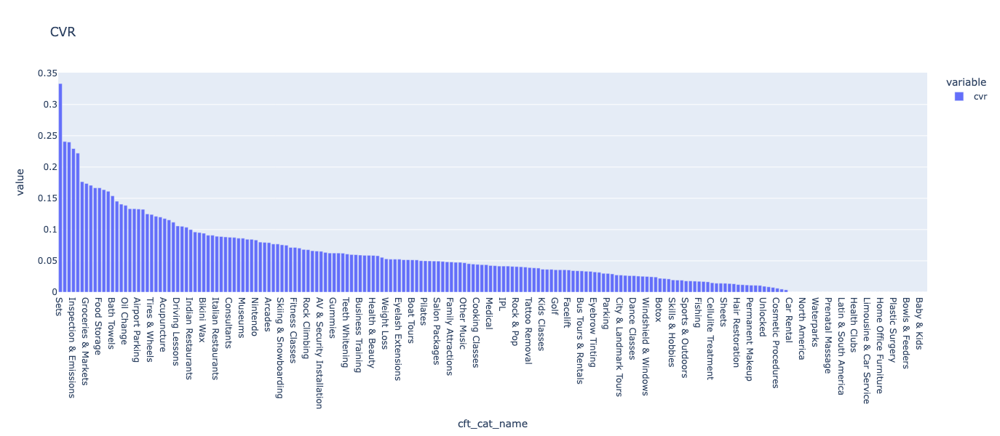

In [263]:
df1 = df1.reset_index().set_index(["cft_cat_name"])
df1 = df1.sort_values(by='cvr', ascending=False).head(200)
df1["cvr"].plot.bar(width=1200, height=600, title = "CVR")

In [265]:
correlation_matrix = df[["imps", "conversion", "clicks", "ctr", "cvr", "gp"]].corr()

# Zobrazení korelační matice
print(correlation_matrix)

                imps  conversion    clicks       ctr       cvr        gp
imps        1.000000    0.557998  0.935790 -0.175147  0.008854  0.710301
conversion  0.557998    1.000000  0.695704 -0.141776  0.112768  0.732196
clicks      0.935790    0.695704  1.000000 -0.183684  0.020077  0.817892
ctr        -0.175147   -0.141776 -0.183684  1.000000 -0.091512 -0.154863
cvr         0.008854    0.112768  0.020077 -0.091512  1.000000  0.049848
gp          0.710301    0.732196  0.817892 -0.154863  0.049848  1.000000


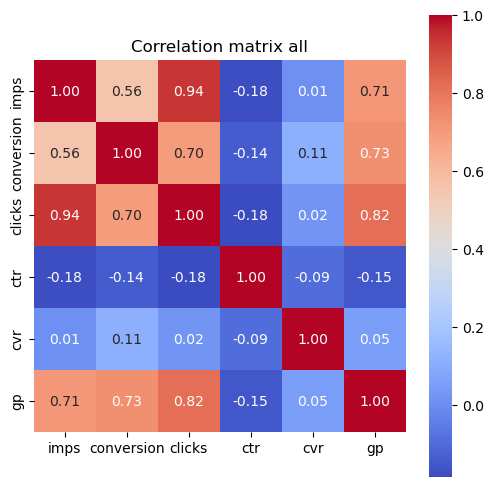

In [266]:
# Vytvoření tepelné mapy korelační matice
plt.figure(figsize=(6, 6))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True)
plt.title('Correlation matrix all')
plt.show()

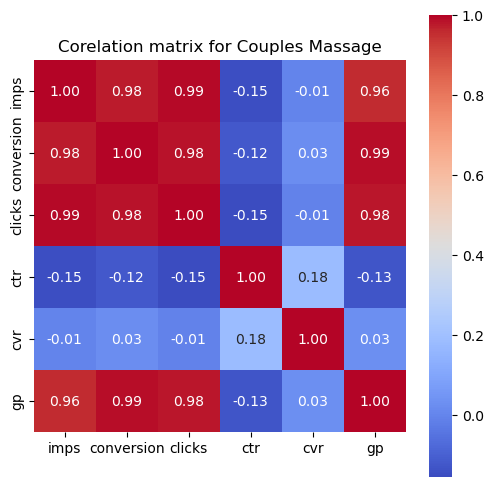

['massage', 'couples massage', 'spa', 'couples message', 'couple massage', 'couples', 'dyer in', 'massages', '224 massage', 'couples massage near me', 'massage and spa couples', 'mess', 'love institute', 'massage for 2', 'essentials', 'whitman soa', 'sakura', 'plainview massage', 'philadelphia', 'massages in renton wa', 'massages for couples', 'massage.', 'massage, single person, near 43228', "massage valentine's day", 'massage spa', 'massage couples', 'massage couple', 'massage chicago couples', 'massage bound brook nj', 'massa', 'masages', 'masage', 'masaage', 'massage sauna', 'massage reflexology', 'massage places', 'massage parlor', 'massage on main', 'massage on 95th oaklawn', 'massage nashville', 'massage green spa', 'massage for two', 'message couple deal', 'little red day spa', 'magnificent mile', 'lush', 'lymphatic massage for couples', 'towngate massage', 'two person massage', 'two hour massage', 'sunshine therapy spa', 'swedish', 'the couple spa', 'thai spa', 'thai massages'

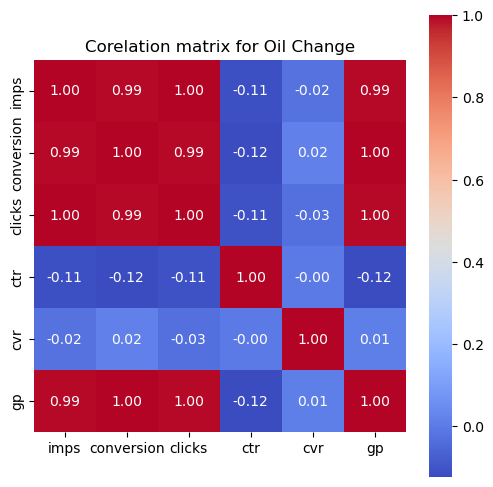

['oil change', 'oil', 'valvoline', 'full synthetic oil change', 'synthetic oil change', 'jiffy lube', 'oil changes', 'oil chnage', 'synthetic oil', 'vavoline', 'jiff', 'experience top notch oil change', 'jiffy lube full synthetic blend oil change', 'calabasas car care', 'kwik kar', 'midas', 'oil springfield massachusetts', 'synthetic oil change kwik kar', 'transmission oil change', 'tire rotation', 'oil change in glastonbury, ct', 'valvoline hamilton', 'take 5 oil', 'valvoline oil change glastonbury', 'valvoline west springfield', 'oil change wallingford', 'oil filter change', 'mountainview tires', 'meinike', 'jiffy lube florida', 'oil  change', 'oil change durham', 'mr tire', 'oil xhange', 'oil chnage deals', 'oil chsnge', 'oil discounts near me', 'oil dorms', 'oilchange', 'oil changw', 'oil change coupons', 'oil change conventional', 'oil chan', 'oil chabnge', 'oil cha', 'oil and filter change', 'oil changsss', 'oil change fully synthetic', 'oil change in newark delaware', 'oil chang

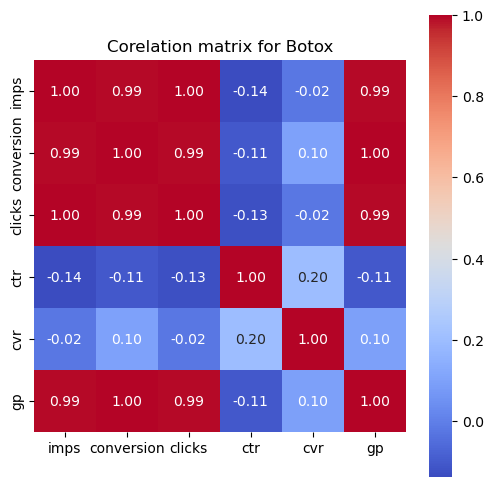

['botox', 'notox', 'botox fort worth', 'botox inua', 'scottsdale sculpt', 'pines', 'promd tox bar', 'promd', 'peach', 'masseter botox', 'masseter', 'lip injections', 'lip filler botox', 'liquivida wellness center', 'lighttouch', 'marionette lines', 'miriam', 'tox', 'tmj botox', 'wigwam spa', 'youthful medical spa', 'wrinkles', 'vishka skin care', 'selfie', 'skin perfect brothers', 'bulk botox', 'da vinci', 'as botox', '40 units of botox', 'body factory', 'borox', 'bolbella', 'botox 40 units', 'botox 60', 'botox underarm', 'botxos', 'botx', 'botox specials', 'botox near me', 'botox lift', 'botox jaw pain', 'botox injections', 'botox in tarzana', 'botox in orange ca', 'botox filler', 'botox brow lift', 'botox allen clinic', 'botox acne', 'boʻtox', 'baby botox', 'beverly hills rejuvenation center', 'ideal imagine botox', 'icon md', 'hotox', 'lavande spa', 'juvaderm ultra', 'juvederm under eyes', 'juvederm volbella', 'juvederm vol', 'keryflex', 'facial botox near', 'eye botox', 'faulkner',

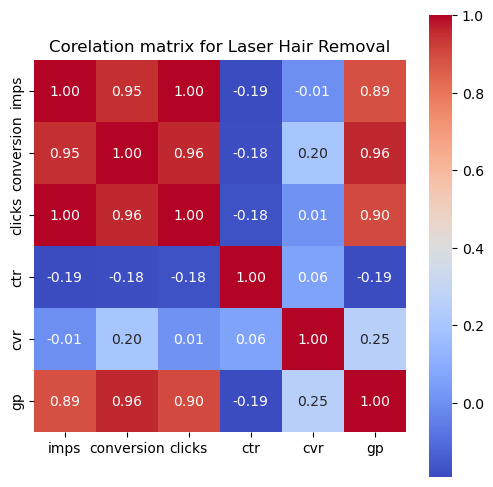

['laser hair removal', 'laser', 'laser hair-removal', 'lazer hair removal', 'sev laser', 'sev', 'yag laser', 'proskin', 'montclair rejuvenation', 'full body laser', 'laser hair', 'simplicity laser', 'laser hair removwl', 'hair laser', 'full leg laser', 'laser hair remobal', 'sec laser calabasas', 'painless lazer', 'prolase', 'precise medical', 'permanent laser hair removal', 'lser hair removal', 'love you laser', 'lotus health', 'luz lounge', 'láser', 'top aesthetics unlimited', 'top aesthetic laser', 'underarm hair removal', 'unlimited laser hair', 'unlimited laser hair removsl', 'unlimited', 'unique laser', 'tribella laser', 'turlock, ca', 'sun and shade spa oa', 'sedo', 'rejuv', 'removal remove red blood vessels: all kinds of telangiectasia, cherry hemangioma and more.', 'spa 7', 'spider vein removal', 'simplicity', 'sev calabasas', 'semper', 'skyn', 'skinstation laser', 'skinny spa', 'skin bleaching and laser hair removal', 'skin city lab', 'skinlicious', 'skinagency', 'candela', '

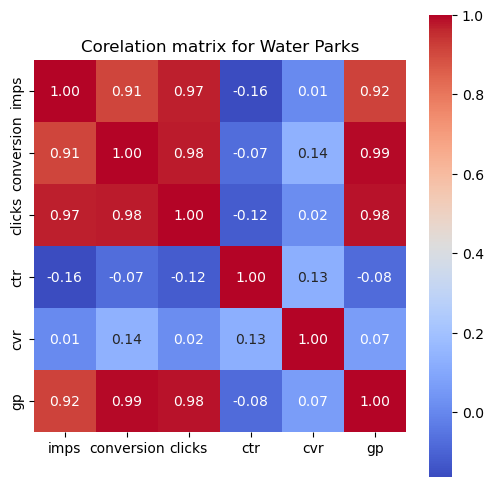

['great wolf lodge', 'legoland', 'great wolf', 'universal', 'restouran with kids', 'castaway bay', 'great wolf lodge day pass', 'lego atlanta', 'water', 'outdoor water park', 'orlando hotel', 'orlando fl', 'pocono’s', 'pocono resorts', 'meow wolf', 'michigan', 'menasha wi great wolf lo', 'legoland hot', 'legoland florida', 'legoland california', 'lego land resort', 'neeneh wi', 'nova adventure park', 'mirror maze orlando', 'moody gardens attractions', 'mountains', 'univeral studios', 'urban air adventure park', 'tannersville, pa', 'theme park', 'things for kids', 'the great wolf', 'the grand resort', 'wolf lodge', 'wolf', 'wisconsin dells single day passes', 'wi dells', 'williamburg', 'wilderness wisconsin dells', 'wilderness in the smokies', 'wilderness hotel', 'wilderness', 'virginia aquarium', 'valentine getaway', 'waterpatk', 'waterparks', 'waterpark pennsylvania', 'waterpark near ny', 'waterpark', 'water parks indoor', 'water parks', 'water park passes', 'water park new', 'water p

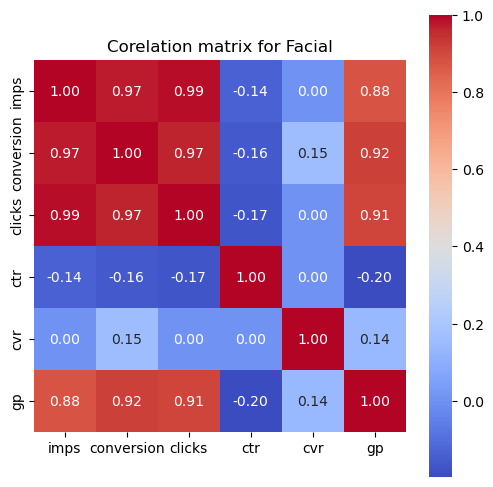

['facial', 'ultherapy', 'ipl', 'prp', 'hydrafacial', 'microdermabrasion', 'back facials', 'facials', 'hifu', 'face', 'chemical peel', 'bbl', 'chemical peel vi', 'acne facial', 'hydrating facials', 'gmg', 'naz', 'hydrafacials', 'paul mitchell', 'skin spa', 'collagen facial', 'facial with extractions', 'facial and massage', 'dermaplanning', 'skincare by melissa', 'ipanema', 'elevate salon', 'stone crop', 'oxygen facial', 'organic facial', 'plasma pen treatment', 'plasma facial', 'picosure', 'pico', 'phpto facial', 'profractional therapy', 'prp face', 'prosculpt medspa', 'pro facial', 'potomac medical aesthetics', 'pore', 'premiere', 'pari’s medspa', 'peel', 'peels', 'photfacial', 'photofacial', 'perfect peel', 'perfect derma peel', 'massage zurich', 'mcironeedling prp', 'massage and facial', 'massage facial', 'med spa', 'mephis', 'men’s facial', 'metairie, la botox', 'medspa', 'memphis aesthetics', 'lipl laser favialaser facial', 'lifty facial', 'lymphatic facial', 'new garden spa', 'nev

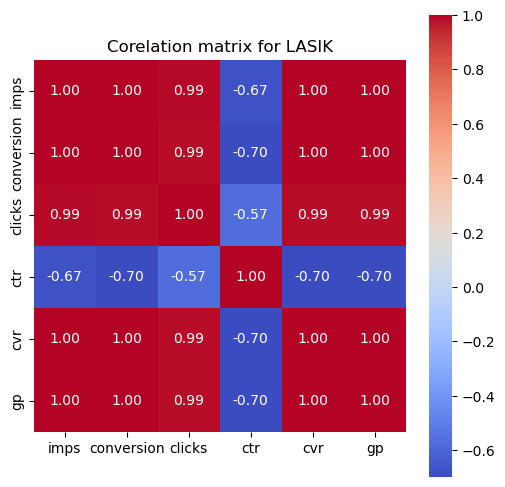

['lasik', 'lasik chicago', 'laser vein removal']


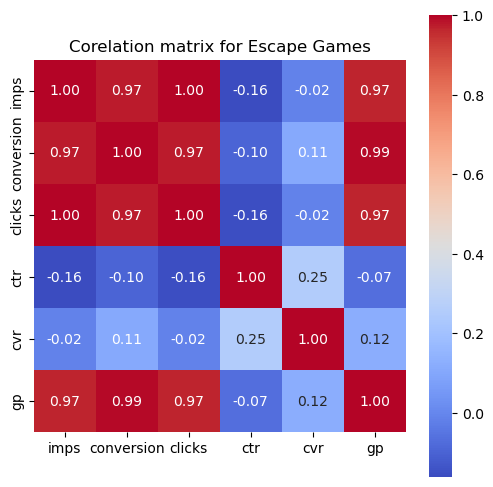

['escape room', 'mishmash', 'escape', 'escape rooms', 'missing piece eacape room', 'escape game', 'escape room gatlinburg', 'xscape room', 'paint  room', 'paint fight', 'panic escape room', 'mystic escape room', 'mystery rooms', 'odyssey', 'tyhe escape game', 'the great escape', 'the escape room moa', 'the escape room', 'the escape game grapevine', 'the escape game', 'venetian', 'saw escape room', 'scape room', 'rage room', 'rage', 'red giant', 'squid games', 'smash room', 'castle skateland', 'cville escape room', 'amazing escape room', '13th hour escape', 'in=mmersive escape', 'it escape', 'eacape room', 'escspe room', 'escapology', 'escaperoom', 'escapeology', 'escape roóm', 'escape rooms mn', 'escape room party', 'escape room mongeryville', 'escape room irvine', 'escape room for kids', 'escape room for 2', 'escape room austin', 'escape room anthem az', 'escape room 4', 'escape rook', 'escape it', 'escape game sawgrass', 'escape game chicago', 'esc', 'great room escape', 'great escap

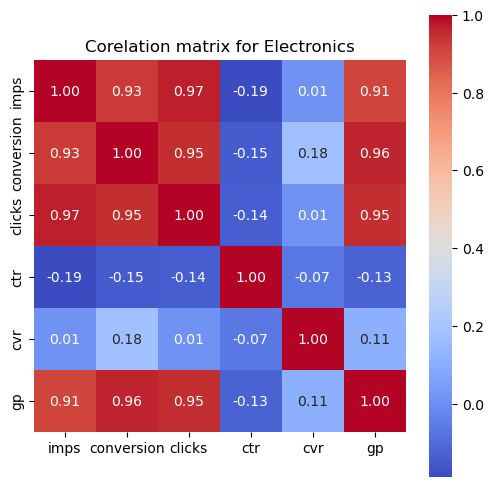

['microsoft office', 'microsoft', 'windows 11', 'office', 'office 2024', 'office 365', 'office 2024 professional plus', 'windows 10', 'office 2021', 'microsft', 'mcafee', 'microsoft office for mac', 'microsoft office 2021', 'word', 'office for mac', 'ms office', 'microsoft\\', 'windows 10 pro', 'microsoft 365', 'm365', 'office mac', 'windows 11 pro', 'windows 11 home', 'shredding', 'microsoft  office business', '2010 microsoft', 'microsoft office professional 2021', 'microsoft project', 'microsoft professional 2021', 'microsoft 2019', 'microsoft office 365 personal', 'window 11 pro', 'windows 10 key', 'microsoft businesss', 'office professional plus for windows', 'off', 'windows', 'microsoft 11', 'windows key', 'microsoft key', 'product key windows 11', 'office365', 'office tom', 'pmp', 'product key for windows 11', 'pc gamer', 'office professional 2024', 'office professional', 'micosoft 365 personal', 'mico', 'lifetime', 'license tom', 'office home and student 2021', 'office home and 

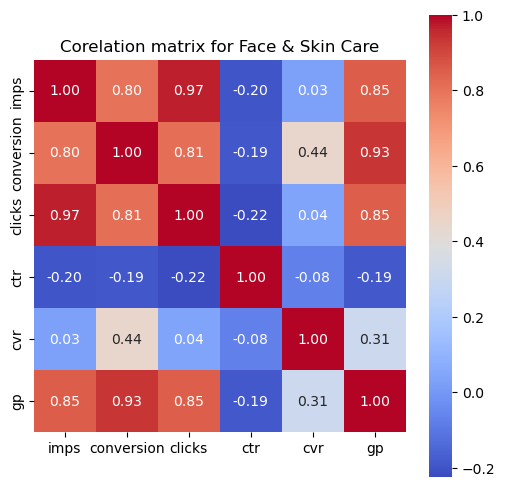

['microneedling', 'morpheus8', 'fraxel', 'fractional laser', 'pico laser', 'dermaplaning', 'dermablading', 'dark spots hands', 'pixel laser', 'pixel', 'pitted scars', 'prf treatment', 'prf', 'potenza', 'pores', "men's face laser treatment", 'melasma laser toning', 'láser treatment', 'neck treatment', 'nctf 135', 'micro', 'nucell skin me', 'midtown laser spa', 'mironeedling', 'micro needling albany ny', 'micro needling', 'micro needle', 'micro dermabrasion', 'micronedling', 'microneedlong', 'microneedlings', 'microneedling rf', 'microneedling prp', 'microneedle', 'my sunshine beauty', 'morpheus', 'morphe', 'tixel', 'underarm pigmentation', 'under eye treatment', 'undereye', 'tca cross acne treatment', 'xanadu', 'v beam', 'vitruvian beauty lounge.', 'scottsdalesculpt', 'santa ana zoo', 'scars', 'scarlett rf', 'scar laser', 'scar', 'radiofrequency', 'radiofrequency microneedling', 'prp microneedling', 'prp microneedle', 'prp micro', 'rf and micronedling', 'resurfacing', 'rf microneedling'

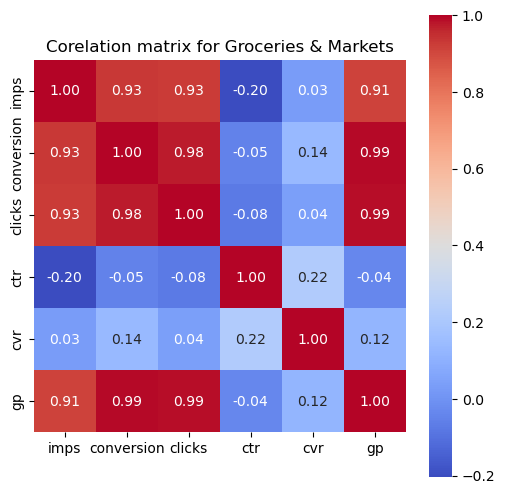

['costco', 'sams club', 'sams', 'bjs', 'bj', 'sam’s club', "sam's club", "bj's", 'cosco', 'cowtci', 'easy renewal', 'sam’s', 'sams membership', 'grocery', "sam's club card", 'costco membership', 'sam club mem', 'one-year costco membership with a $20 or $40 digital costco shop card', 'princeton athletic club', 'lobster restaurant', 'website', 'sams club membership renewal', 'sams club membership', "sam's membership", "sam's club ocala fl", "sam's c", "sam's", 'sam club', 'sams wholesale', 'sam’s membership', 'sam’s club plus', 'seaford', 'seafood', 'sms club membrship plus', 'cbd vape', 'clickup website', 'butcher', 'costos membership', 'costco deal', 'costco canada', 'costci', 'costc', 'cost', 'crab legs', 'crab', '15 dollar membership bj', 'blue crabs', 'bj’s maryville tn', 'bj’s', 'bjs membership', 'hulu', 'harbour house', 'homestead seafood festival', 'jonesboro', 'family membership', 'food williamsburg', 'gift cards']


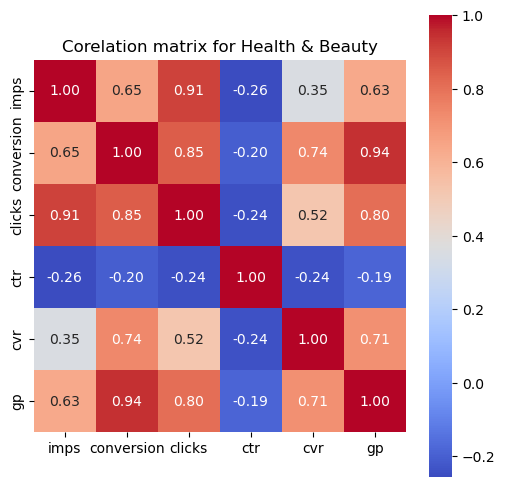

['semiglutide', 'semaglutide', 'weight loss', 'tirzepatide', 'ozempic', 'phentermine', 'weightloss', 'oze', 'oral semaglutide', 'options medical weight loss', 'phetmine weight lose', 'message', 'lipo c b12', 'nphentermune', 'monjauro', 'tirz', 'tir', 'tirzepatide coral gables', 'tirzepatide california', 'tirzepetide', 'tirzepitide', 'ultherapy nc', 'trizepatide', 'teeth aligners', 'terz', 'wrestlemania', 'vision works', 'weight shots', 'weight loss shots', 'weight loss medication', 'weight loss drugs', 'weight loss clinic', 'weight lodd', 'weight care', 'weight', 'weigh loss', 'success by design', 'sigmaglutide', 'semliglutide', 'semiglutide b12', 'semaglutide pills', 'semaglitide', 'sema', 'sem', 'cbd guumm', 'doctor', 'cosmetic medicine of coral gables', 'cosmeticrx', 'a and a', 'bmimd', 'balance life', 'invigor medical', 'health', 'eyeglasses', 'fitness', 'glp1', 'glp-1', 'glp', 'gentle fitness', 'fustorix.com']


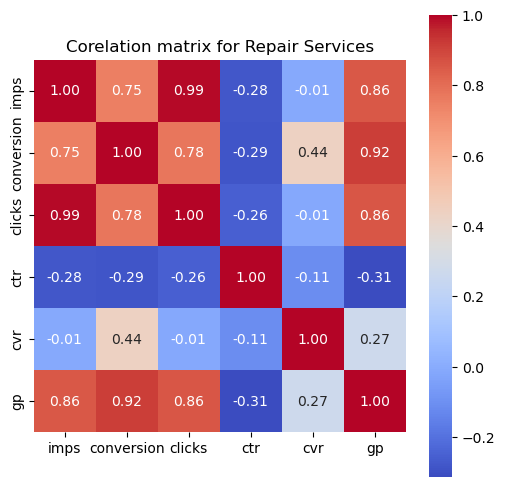

['brakes', 'brake', 'brake pads and rotors', 'break pads', 'brake pads', 'car battery', 'coolant', 'oil change package', 'mvr autorepaur', 'transmission', 'tune ups', 'rear brakes', 'repair', 'spark plugs', 'state inspection', 'ceramic pads', 'car breaks', 'car brake pads', 'car body shop repair', 'car air conditioning  check', 'car paint', 'car repair', 'automotive', 'auto zone', 'auto mall smog', 'brakes and pads', 'brake service', 'brake rotor', 'brake repaiar', 'brake pads rotors replacement', 'brake pad replacement', 'brake pad and rotors', 'brake pad', 'brake flush', 'brake fluid', 'breaks', 'break pad replacement', 'break', 'grand prairie', 'fuel induction service', 'german mechanic', 'galicia a', 'radiation flush coolant']


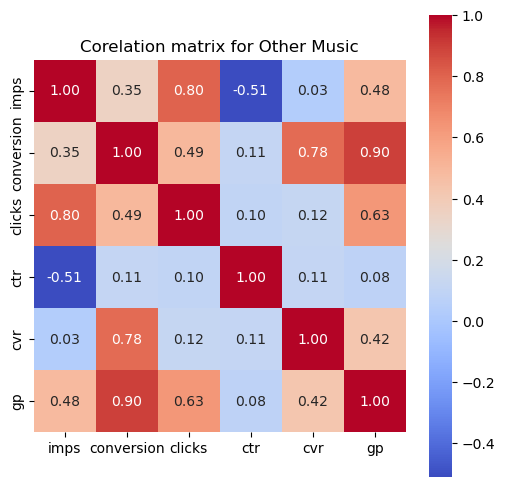

['reggae love fest', 'dru hill', 'old school concert', 'omarion', 'melanial tour boosie', 'millennium tour fort worth', 'millenium tour', 'trey songz', 'the millennium tour', 'the millennial tour', 'temptations', 'chicago bulls tickets', 'clubs', 'candle concert', 'adult', 'black eyed peas', 'hip hop', 'kinito', 'fantasia']


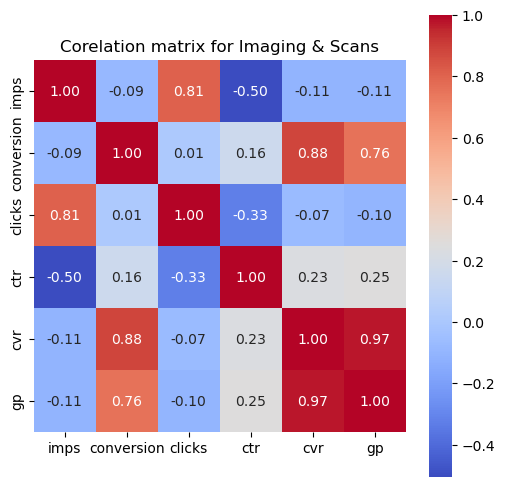

['the natural place broofield, colorado', 'dexa scan', 'pregnancy', 'miracle in progress', 'mri', 'ultrasound', 'virtual imaging', 'sneak a peak', 'cat scan', 'dexa', 'dexafit', '4d', '3d ultrrasound', '3d ultrasound', 'body scan', 'body fat scan', 'body composition', 'gender reveal', 'glow and grow baby pictures']


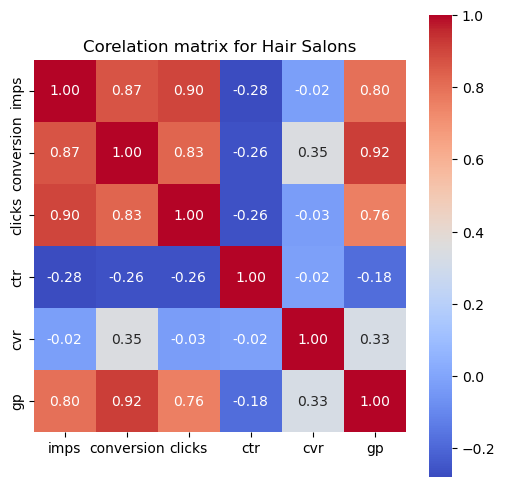

['head spa', 'we scalp care', 'hair', 'highlights', 'shortstack stylist', 'head massage bensalem pa', 'spa hair', 'beauty secret spa', 'scalp massage', 'hair salon', 'hair cut', 'scalp', 'root touch-ups', 'hair color', 'hair salons', 'salon deals', 'braids', 'ombre hair', 'organic hair color', 'plano head spa', 'pompano beach hair blowout', 'partial highlights', 'partial high lights with haircut and blow', 'partial', 'perm', 'mens hair coloring', 'medium knotless', 'medieval times arundel mills', 'lowlights', 'louisville orchestra', 'nd yag', 'microlinks', 'money piece highlight', 'touyuantang', 'updo hair', 'tape in', 'the salon', 'the face and body', 'women’s hair cut', "women's haircut", 'women hair', 'woodlands', 'v light hair extensions kit', 'wash cut blowjob', 'salon nv', 'salon hair color and cut', 'salon divine', 'salon', 'rosewood spa', 'root touchup', 'root touch up', 'santina', 'scalp treatment', 'scalp spa', 'scalp oil', 'scalp care', 'scalp and head massage', 'quincy high

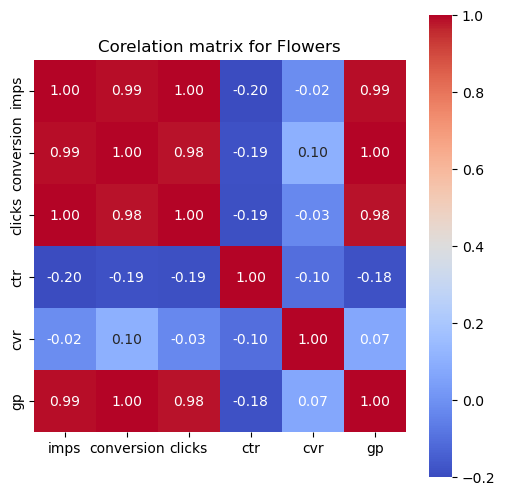

['flowers', 'rose farmers', '1800 flowers', 'fresh flowers delivery', 'atlanta flowers', '1-800 flowers', 'teleflora', 'flower delivery', 'flowera', 'fliwers', 'opi', 'pink roses', 'proglowers', 'telaflora', 'valentine’s day roses', 'valentines day', 'same day flowers', 'same day delivery flowers', 'roses', 'rose', 'red roses', 'chocolates', '36 garnet roses', 'blooms today', 'blooms', 'blue flowers', 'blue roses', 'bouquet', 'birthday flowers', 'birthday arrangement', 'flowers.com', 'flowers delivery', 'flowers and gifts', 'flower subscriptions', 'flower', 'florists.com', 'florists', 'florist', 'floral delivery', 'flwers', 'glwers', 'funeral flowet']


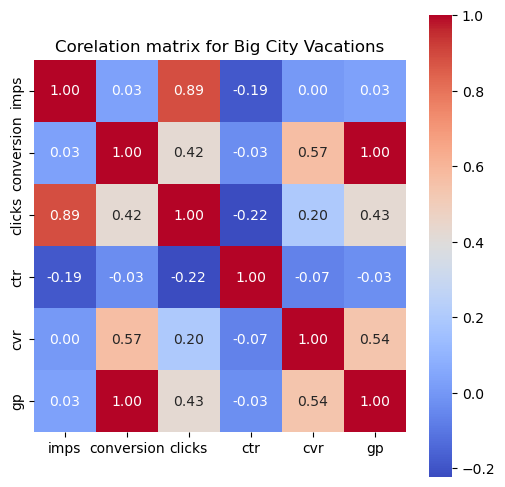

['king spa', 'ho', 'pod', 'paramount hotel nyc', 'mgm grand', 'lodging las vegas', 'linq hitel', 'linq', 'los angeles', 'marriott', 'newport, ri', 'new york city', 'new york broadway', 'new york', 'nyc hotel', 'nyc hotels', 'ocean inn villa', 'ocean city hotel in maryland', 'north myrtle beach hotel', 'north beach plantation', 'midtown hotels nyc', 'mt. fuji, 296 ny-17, hillburn, ny 10931', 'museum of', 'tournament of kings', 'time square hotel', 'time square', 'tarten room', 'the strat', 'what do you have vegas', 'westgate las vegas resort', 'vegas hotel', 'vegas flights', 'vegas deals', 'vegas', 'vagas', 'valentines day vegas', 'weekend getaway', 'warwick dallas', 'san francisco hotel', 'san antonio spus', 'san antonio river walk texas', 'san antonio river walk', 'rooms with a view', 'rooms on fremont street vegas', 'riverwalk hotel', 'rehoboth beach', 'spa hotel', 'strip', 'strat', 'chicago marriott downtown magnificent mile', 'chicago hotels', 'chicago', 'anaheim', 'atlantic', '5 s

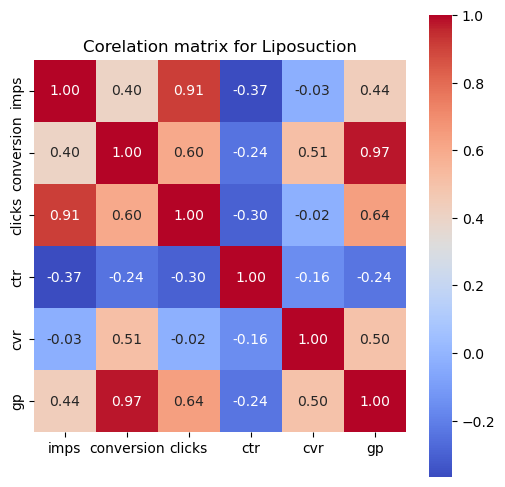

['laser lipo', 'laserlipo', 'cool sculpt', 'medi laser spa', 'lipo', 'liposuction', 'lipochin', 'lipo lounge', 'lipo light', 'light rx', 'non invasive laser lipo', 'non invasive bbl', 'mini neck lift', 'sense of skin', 'senseofskin', 'smart lipo', 'skin so sweet', 'cavitation rf', 'diamond dermis', 'cool sculpting elite', 'crypto sculpt', 'arm sculpting', 'arm lipo', 'arm', 'body sculting', 'body sculpt', 'body sculp', 'body', 'belly fat removal', 'belly fat', 'laser fat lipo', 'laser therapy', 'laser liposuction', 'laser lipo and wood therapy', 'east hill laser', 'experience velashape cellulite reduction at healthkey medspa clubs with sessions up to 52% off for smoother, firmer skin.', 'endo lift']


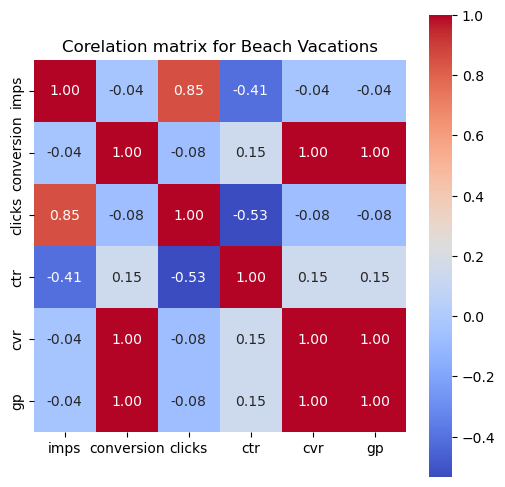

['puerto roco', 'package trips', 'oregon coast', 'pismo', "pedro's tacos", 'parking lax', 'mexico resort', 'mexico', 'lincon city', 'lifestyle resort', 'life style resort dominican republic', 'marathon fl', 'los cabos mexico', 'myrtle beach hotesl', 'myrtle beach horse', 'monterey, ca', 'travel air inclsive', 'trips to puerto rico', 'trip boston', 'tulum', 'vacation packages', 'weekend getaway puerto rico', 'waikiki', 'san diego ca', 'san juan spring break', 'puntacana', 'puertorico', 'puerto rico resorts', 'resorts in mexico', 'south beach miami hotels', 'cabo wabo', 'cabo resort', 'cabo grand solmar', 'cabo', 'cambria', 'canon beach hotels', 'car rental in puerto rico', 'date night', 'all inclusive vacation', 'all inclusive san juan', 'all inclusive resorts', 'all inclusive plus flight', 'all inclusive in puetro rico', 'all inclusive in puerto rico', 'all inclusive for 3', 'all incllusive', 'airfare all inclusive', 'airplain and hotel packages puerto rico', 'hotel cancun', 'hotel sta

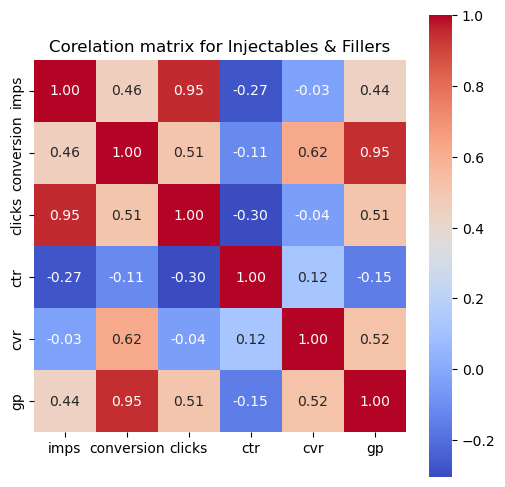

['dysport', 'lip fillers', 'lip', '40 units botox', 'bunny lines and crows feet', 'lip filler', 'restylane', 'daxxify', 'ponte vedra vein institute', 'hyloronic filler', 'plaza health and wellness', 'juvederm', 'jack and jill', 'nucell', 'filler', 'aesthetic heath and wellness', 'p shot', 'oxygen chamber', 'plasma fibroblast', 'prima med spa', 'prf injections', 'prof injections', 'mens enhancement', 'medical vitality', 'liquivida', 'lip injection', 'lip injec', 'lip flip', 'lip filltr', 'lip enhancement', 'lime aesthetics', 'life alert', 'marbella medical  40 units of xeomin', 'neuvaderm', 'nasolabia filler', 'non surgical butt radiesse', 'microbrasion', 'total med solution', 'under eye filler', 'under eye botox', 'undereye filler', 'ultra', 'tear trough', 'tarzana botox', 'the natural place', 'the injector lab med spa', 'the injector lab', 'wild and beautiful', 'xeomin', 'zbeaute', 'wrinkle', 'wellness med art', 'volume xc', 'voluma', 'volbella', 'samsung galaxy s 9 screen replacement

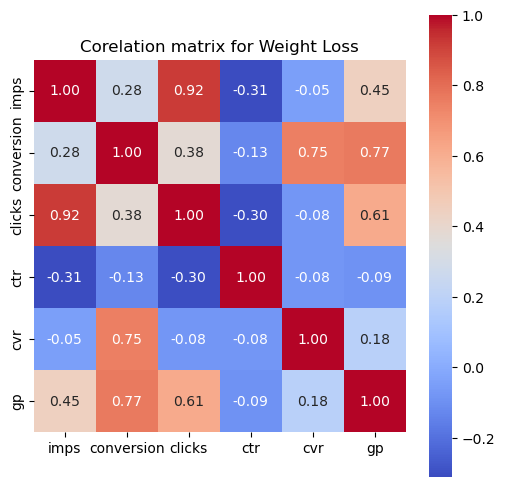

['emsculpt', 'skin tight', 'coolsculpting', 'emssculp neo', 'youthful trends', 'tirzepatide injections', 'ketone', 'garlic and tumeric pills', 'apple cider', 'plastic surgery', 'liquid lipo', 'lemon bottle', 'manhattan laser spa', 'male', 'neo', 'mommy make over', 'tickle lipo', 'ultrasound cavitation', 'ultrasonic fat reduction', 'ultrasonic cavitation', 'tru sculpt', 'tummy surgery', 'tens unit pelvic floor', 'zone 28', 'wood therapy', 'wright loss', 'wooden therapy', 'vela body shape', 'venus', 'velashape', 'vela shape iii', 'vela shape 3', 'vitamin', 'weightloss injections', 'weight watchers', 'weight loss pills', 'weight losa', 'salt therapy', 'sculptsure', 'red light therapy weight loss', 'red light th', 'stomach recuction', 'stomach', 'sugar factory', 'skin studio', 'chin lipo', 'cellulitis', 'cellulite reduction', 'cellulite', 'cavi lipo center', 'colon cleanse', 'deit', 'detox your body', 'detox body', 'detox', 'coolscupting', 'coolscuplt', 'coolsculpt', 'cool scuplting', 'coo

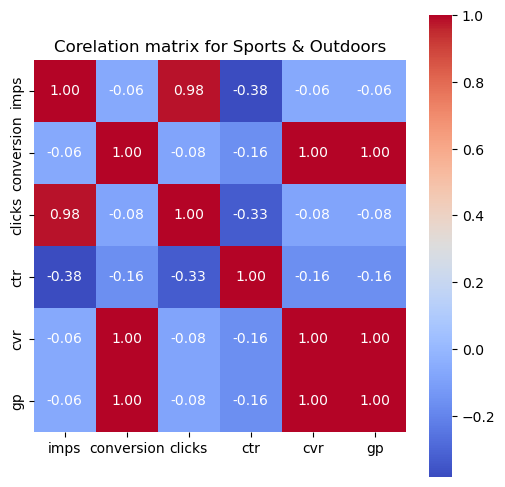

['bury the hatchet horsham', 'lone star axe', 'oaks park', 'things to do as a couple', 'snow tubing montage mountain', 'bury the hatchet', 'bury', 'blepharoplasty', 'break room', 'ax throwing', 'axe trowing', 'axe throwing nutley', 'axe throwing', 'axe thr', 'axe houston', 'axe', 'ismash', 'hawaii tours in hawaii', 'lasertron', 'jelly bean jungle']


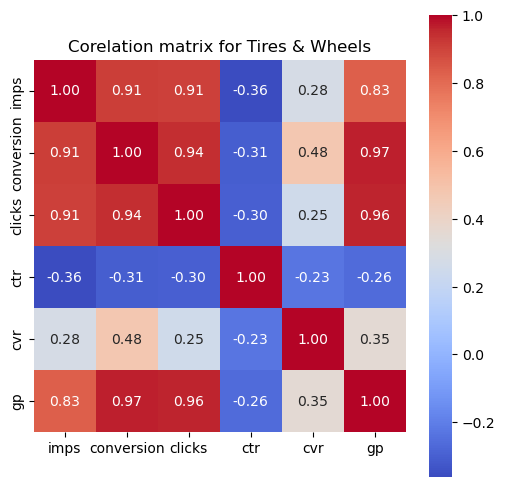

['wheel alignment', 'alignment', 'car alignment', 'tires', 'four wheel alignment', 'monroe', 'tire installation', 'tire balance', 'tire alignment', 'tire aligment', 'tire', 'wheel barring', 'wheel alighnment', 'wheel', 'rnr tire express st petersburg', 'skips', 'car wheel alignment', 'abas auto repair', '2 wheel alignment', '4 wheel alignment', 'aligntment', 'alignment in katy', 'alignent', 'aligment', 'balancing', 'fast tire']


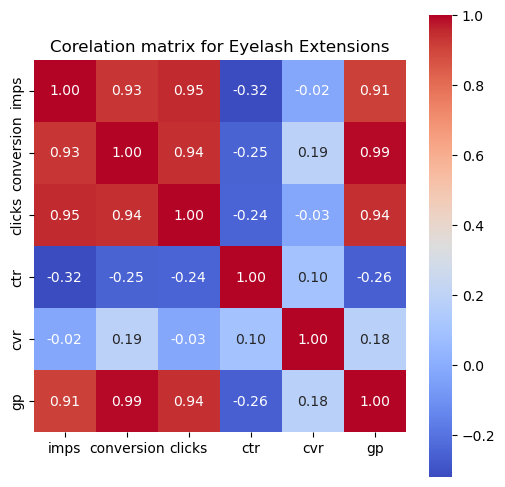

['lashes', 'eyelashes', 'eyelash extensions', 'eyelash extension', 'eyelash', 'lashful', 'lash', 'lash extensions', 'lash extension', 'eye lash', 'mink eyelashes', 'lorenco', 'new rose spa', 'mili lash', 'mink lashes', 'classic eyelash', 'damn esthetics', 'acrylic full set', '100 pcs lash extensions', 'bowlero commack', 'beauty studio nine', 'doll lash', 'hybrid lashes', 'kiss lashes', 'lashtastic', 'lashes extensions', 'lash remove extension', 'lash remove', 'lash lift tint', 'lash fill', 'lash externsions', 'lash extentions', 'lash extention', 'kash lift', 'eye lashes', 'eye lash extensions', 'eye lash extension', 'eye', 'ey', 'eyelashes extensions', 'eyelash training', 'eyelash fills', 'eyelash extention', 'eyelash course', 'eyelash  etension', 'eyelas', 'eyel', 'ellie lash']


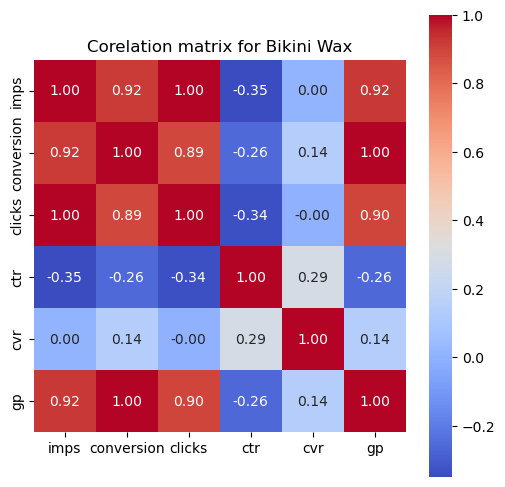

['brazilian wax', 'waxing', 'wax', 'brazilian', 'queens beauty parlor', 'bliss', 'male brazilian waxing', 'underarm', 'the wax den', 'v steam', 'vajacial', 'waxes', 'radiant waxing tampa', 'sugar wax', 'bleaching', 'brazilian bikini wax', 'braz', 'brazilian was', 'brazolian', 'brazillian wax', 'back wax', 'bikini waxing', 'bikini wax', 'eyebrow wax and tint']


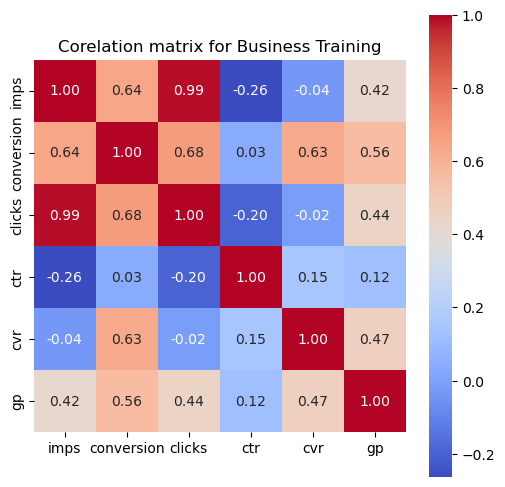

['relny', 'real estate', 'classes', 'cannabis', 'aceable', 'florida real estate 45 hour', 'azure tide', 'real estste', 'weed', 'online real estate', 'online real estate course', 'pistons game', 'property ans casualty', 'make up', 'marijuana growing', 'notary training', 'training', 'texas real estate', 'wine and painting', 'washington pre-licensing real-estate', 'real estate u', 'realestateu new york', 'realestateu', 'real states', 'real estateu', 'real estate online glass', 'real estate license course', 'real estate license', 'real estate exam', 'real estate course florida', 'real estate course', 'real estate classes', 'real  estate', 'real', 'stylist', 'ceshop real eastate', 'certificate small engine', 'business journal', 'business', 'amazon', 'aceable agent', 'beauty classes', 'bible course', 'insurance license', 'healthcare certified courses', 'hitt classes', 'law', 'eyelash classes', 'enhanced firearm training', 'gold cost school', 'group fitness instructing', 'forklift certificati

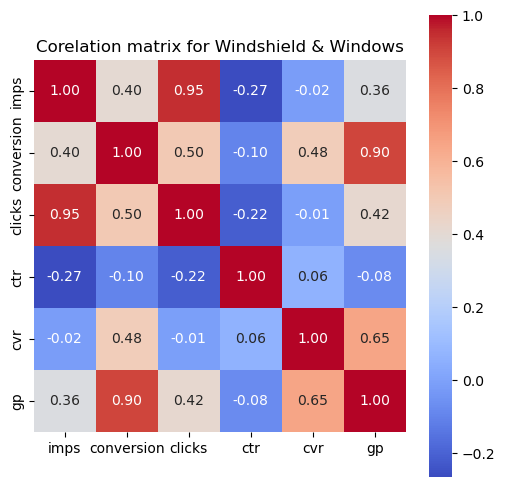

['window tinting', 'car guys chicago', 'tint', 'windshield chip repair', 'orange tints', 'massive mobile', 'mikes endow tint', 'mikes tint shop', 'mobile window tint', 'tints', 'tinting', 'tint world', 'tint windows', 'tinit window', 'timt', 'tesla window tint', 'windshield tint', 'windshield replacement', 'windshield repair', 'windshield chip', 'windshield', 'windsheild repair', 'windsh', 'windows tint', 'window tints', 'window tint for suv', 'window tint', 'window timt', 'window tent', 'window replacement', 'ceramic window tinting', 'ceramic window tint windshield', 'ceramic window tint', 'ceramic tint', 'bumper cars', 'car', 'car window tinting', 'car window tint', 'car window tent', 'car window glass', 'car tires', 'car tinting', 'car tint', 'auto window', 'auto glass', 'auto cooling system service', 'bonnie and clyde']


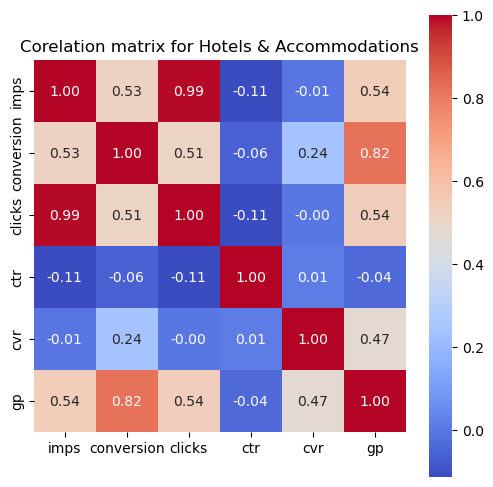

['bowling', 'sls miami', 'hotels', 'camelback', 'flamingo', 'vancouver hotel', 'hotel', 'napa', 'san diego zoo', 'garden of the gods lodge', 'catalina', 'bwi', 'mountain creek', 'seaworld', 'timber ridge', 'niagra falls', 'hilton garden inn chicago/oakbrook terrace', 'sea world', 'comedy', 'lehi', 'womens dove deordant', 'hershey', 'palm spring', 'omaha nevraska', 'ojai', 'omni spa', 'omni homestead', 'omni grove', 'palm springs', 'page', 'outer banks', 'ottawa hotels', 'orlando', 'poconos mountin', 'poconos', 'pigeon forge tn', 'pigeon forge', 'pico genesis', 'pittsburgh hotels', 'princeton', 'pool', 'portsmouth, nh', 'paso robles', 'park mgm', 'paris hotels', 'paris france', 'peppermill resort spa casino', 'pensacola fl', 'mazatlán', 'maya', 'mesa az', 'meritage', 'miami beach', 'miami', 'metropoint', 'loon', 'living desert', 'lgbt', 'mandalay bay shark', 'mandalay bay aquarium', 'mammoth', 'mall of america', 'marlborough', 'margaritaville', 'lowry park zoo', 'louisville ky', 'mackin

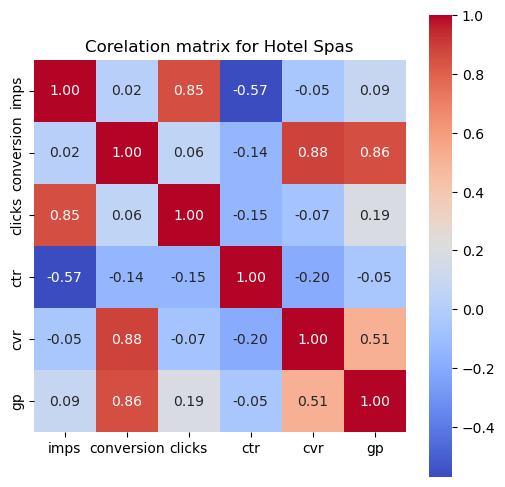

['carillon', 'naples grand spa', 'massage and spa', 'naples spa', 'whitbi spa', 'valley ho', 'scottsdale camelbach', 'sanctuary spa', 'red rock spa', 'spa orlando', 'standard spa miami', 'st. somewhere', 'cold plunge spa', 'couple resort day', 'couples massage resort', 'couples massage and facial', 'hotel spa', 'las vegas convention center south hall', 'facial hotel']


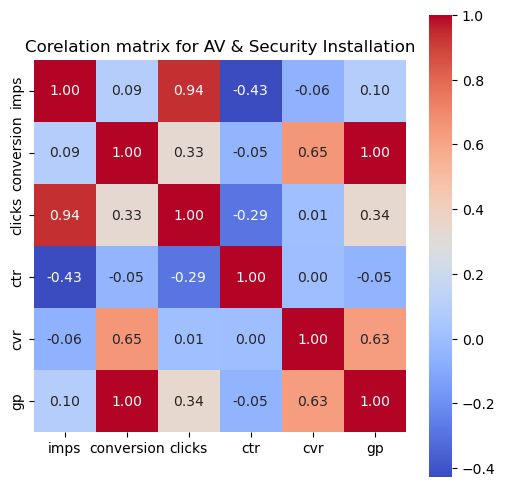

['remote car starter', 'car radio', 'tune-up', 're.ote start', 'remote starters', 'remote starter', 'remote start up', 'remote start installation', 'remote start', 'remote car start', 'car alarm', 'car starter package', 'car starter for manual', 'car starter', 'car remote starter', 'dashcam install', 'diamond exge', 'automatic car starter', 'automatic car start', 'auto start', 'auto car start', 'boomer']


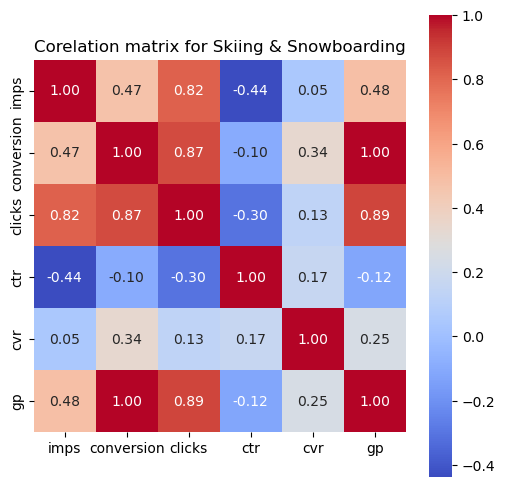

['big snow', 'snow tubing', 'mount peter lift ticket', 'pokono mountain snow sk', 'park city utah', 'lift ticket', 'mountaincreek', 'mountain creek snow tubing', 'mountain creek skiing nj', 'mountain creek ski', 'mount creek', 'tubing near me', 'tubing', 'snowboard lesson', 'snowboard', 'snow tubing pocono', 'snow tubing camelback', 'ski rentals', 'ski rental', 'camelback snow tubing', 'big bear snow summit', 'gore mountain']


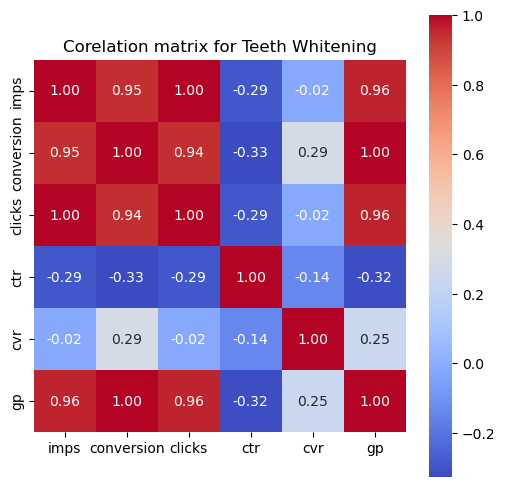

['teeth whitening', 'teeth whiten', 'teeth', 'teeyh whitening', 'teeth whiteninh', 'teeth cleaning and whitening', 'teeth bleaching', 'whitening', 'white', 'zoom teeth whitening', 'zoom teeth', 'smile institute', '75023 teeth whitening', 'bleach trays', 'bleach teeth', 'beaming white']


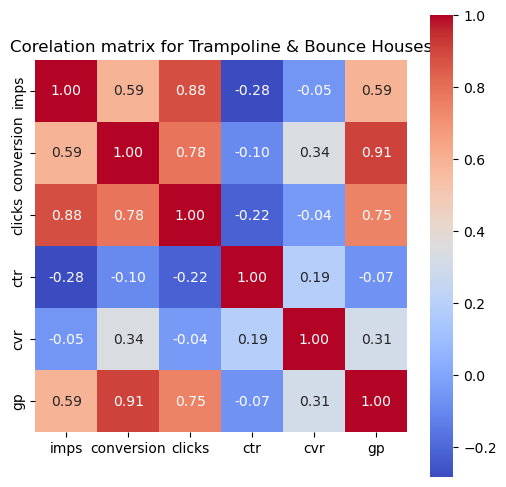

['sky zone', 'skyzone', 'kids blowdry', 'launch crossbay', 'get air', 'launch', 'rush', 'colosseum', 'trampoline park', 'uptown jungle', 'altitude', 'trampoline', 'just for fun', 'urbanair', 'jumping', 'phoenix rush fun park', 'sky zone shelby', 'smiley', 'irise', 'hang time', 'slick city', 'urban air oxford', 'tramp', 'indoor playground', 'flight adventure park', 'timonium sky zone', 'uptown junble', 'bounce bounce', 'ninja kidz', 'sky', 'lancaster', 'skyxone', 'phoenix ninja kidz', 'jump and play', 'off the wall', 'safari run', 'kangas', 'orchard park', 'play space', 'play place', 'port discovery', 'party places for kids', 'party kingdom', 'party birthday', 'mi combat', 'lego center', 'luv', 'my lil town', 'tram', 'trampolie', 'trampolin', 'trampolkne', 'trampoline playhouse', 'trampoline place', 'trampoline parks', 'toddler birthday', 'uptown juggle', 'uptown', 'up town jungle', 'surge trampoline', 'surge entertainment', 'teens activities', 'uptown jungle fun park', 'urban air brook

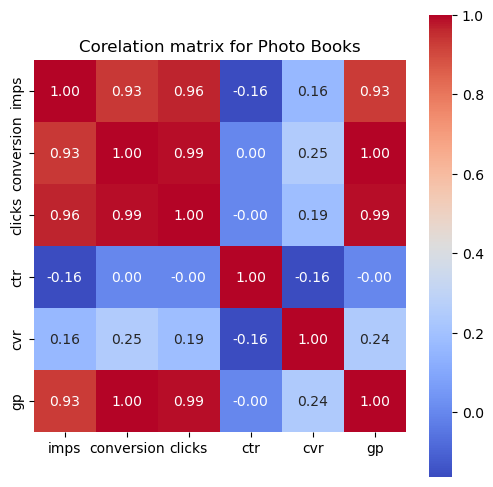

['shutterfly', 'photobooks', 'shutterfly book', 'hard cover photo book', 'photo book', 'shutter fly', 'printerpix', 'photo albums', 'photo books', 'photo books shutterfly', 'photobook', 'personalized book', 'shutterfly 12x12 photo albums', 'shutterfly canvas', 'shutterfly photo book', '8x10 shutterfly books', '20 page photobooks printerpix']


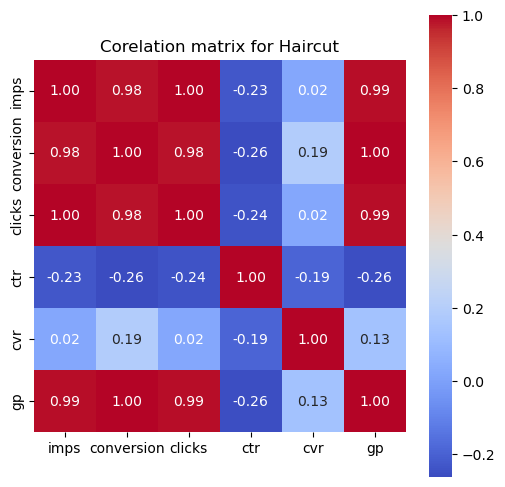

['haircut', 'haircut deep condition', 'haircuts', 'aveda institute', 'pixie cut', 'pivot point', 'patchogue', 'metro hair salon', 'lovely head salon', 'nv salon', 'moxie', 'women’s haircut', 'rosies beauty', 'roottouch up', 'saint marie haircut prices', 'single process', 'selvana hair salon', 'aura salon', 'blowdry', 'blow dry', 'bayalage', 'bella capelli', 'bellezza beauty salon', 'haircut womens', 'highlights haircut', 'highlight', 'jami cooke', 'hairsalon', 'hair cut woman', 'hair cut an color', 'hair cur', 'hair color streaks cur', 'hair perm', 'haircut and color', 'hair treatment', 'hair straight treatment', 'hair salon near lagrange illinois', 'hair salon and spa', 'hair root touch up', 'hair color and cut', 'hair blow out']


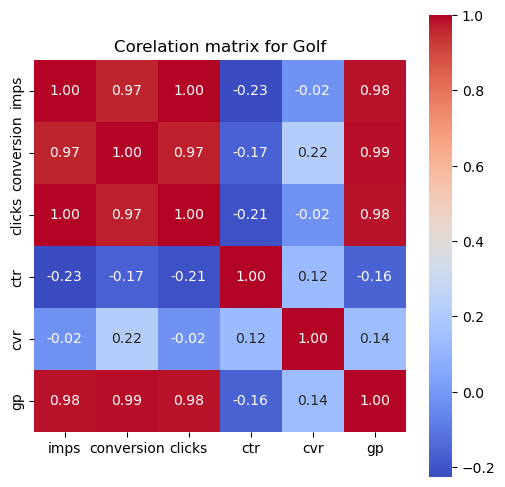

['golf', 'hackers', 'mini putt', 'gtr', 'mini golf', 'orlando stadium', 'pickle haus', 'memphis grizzlies', 'naples florida golf', 'miniature golfing', 'minigolf', 'monster golf san antonio', 'monster golf', 'tpc las vegas', 'tower tee', 'top golf', 'tee times', 'tee time', 'suncadia', 'sunridge', 'the ponds', 'x-golf', 'world of coca-cola', 'round 1', 'sawmill creek', 'putt shack', 'st. louis mo', 'shadow lake golf', 'bunker hill', 'cave creek', 'dining in winnipeg', 'adult fun', 'breaking benjamin', 'billiards', 'black light mini golf', 'indoor olayground', 'indoor mini golf', 'indoor golf', 'in door glow golf', 'hesperia', 'lakeville mn', 'kids golf lessons', 'golf palm springs', 'golf naples florida', 'golf lessons', 'golf in hudson fl rea', 'golf deals near hudson fl', 'golf course', 'golf range', 'golf sim', 'golf simulator', 'golfing', 'golf verrado']


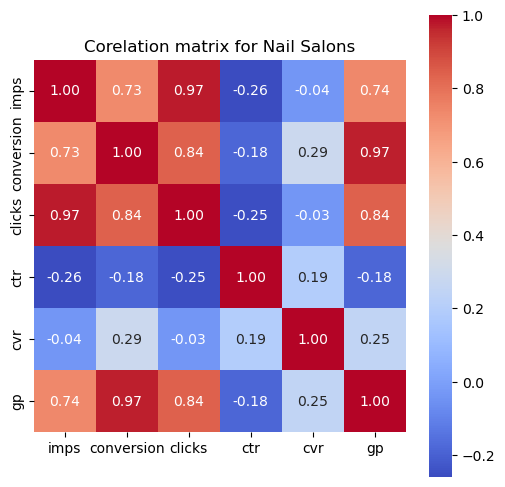

['nails', 'pedi', 'pedicure', 'mani pedi', 'nail', 'janine nails', 'pedi and manicure', 'gilmore', 'mani', 'no chip manicure', 'gel manicure', 'gel pedicure', 'pampers', 'professional gel nails', 'pediture', 'pedicures near me', 'pedicures', 'pedicure without nail polish', 'pedicure dallas', 'pedicure and manicure', 'pedicure 60645', 'pediccure', 'paraffin pedicure', 'pedícure', 'massage and pedicure', 'massa spa', 'medi and pedi', 'menicure', 'mani and pedi', 'mani pedi couple', 'manicure pedicure', 'manicure near 33618', 'manicure and pedicures', 'manicure and pedicure combination', 'manicure', 'mani/pedi', 'mani-pedi', 'mani pedis', 'nails gel', 'nails acylic', 'nailes', 'nail shop gift', 'nail salons', 'nail salon', 'nail manicure', 'nail extension', 'mini pedi', 'toes pedicure', 'waterless pedicure', 'vm beauty', 'russian pedicure', 'russian manicure and pedicure', 'russian manicure', 'spa pedicure', 'spa with mani pedi', 'shellac', 'cheap pedicure', 'cobb pedicure', 'dip nails', 

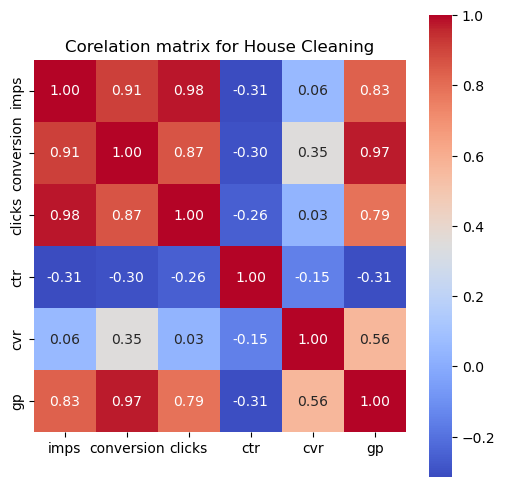

['cleaning', 'house cleaning', 'cleaner', 'medical grade home cleaning', 'maid', 'oc home cleaning', 'move out  cleaning', 'move out', 'cleaners', 'cleaning service', 'clean', 'deep clean', 'curtis e', 'danbury ct', 'apartment cleaning', 'house cleaning and organizing', 'house cleaners', 'house cleaner', 'house clean', 'house', 'home', 'home cleaning', 'furniture cleaning']


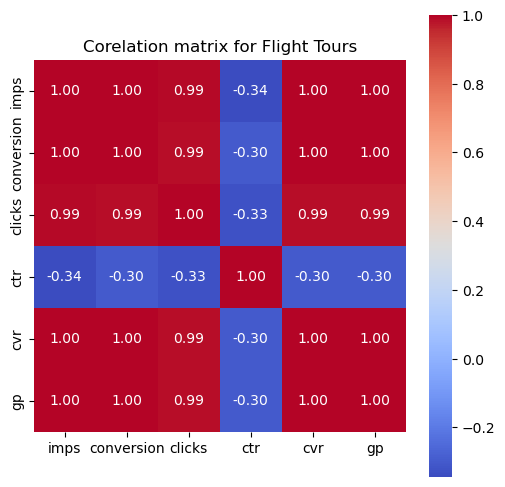

['helicopter', 'plane', 'nextgen', 'nyc helicopter', 'sunset flight', 'san francisco', 'shark viewing  tour', 'slide dallas', 'sky tours', 'chicago observation', 'airways', 'introductory flight', 'helicoptertour', 'helicopter tour for 2', 'helicopter tour', 'helicopter rides', 'helicopter ride', 'heli chicago', 'heli', 'heilcopter', 'hot air balloon ride', 'las vegas helicoptor', 'jeep tour', 'flight tour', 'flight school', 'flight lesson', 'flght lesson', 'fly chicago', 'go carts', 'fly for four', 'glider rides']


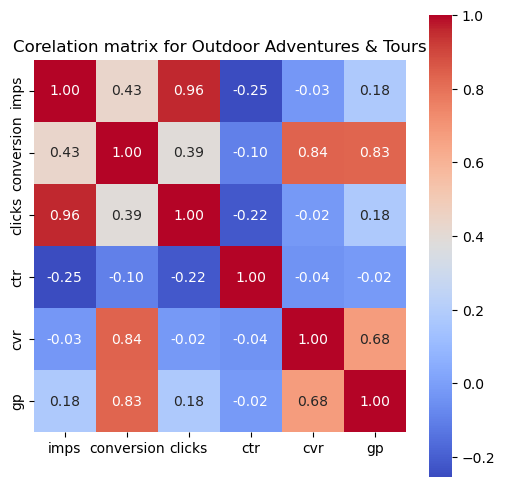

['hot air balloons', 'hot air balloon rides', 'atv', 'sedona jeep tours', 'offroad ocotillo', 'outdoor activities', 'plane ride', 'pink jeep tour', 'miami kids', 'off road', 'temecula hot air balloon', 'zip lining in vegas', 'utv', 'sand utv', 'sand hollow', 'race', 'sedona atv', 'steamboat springs', 'sphere', 'site tour', 'civil right museum', 'by brother', 'atv riding', 'atv night ride miami', 'atv night ride', 'atv las vegas', 'atv desert', 'atv riding group package', 'atv tour', 'atvs', 'atv vegas', 'arizona hot air balloon', '30min atv ride', 'adrenaline mountain', 'adrenaline atv tours', 'adventure', 'hot baloon', 'hot airballon', 'hot air baloon', 'hot air balloon', 'hot air ballon', 'hot air', 'las vegas atv tour', 'las vegas atv', 'kualoa ranch', 'jeep', 'florida keys', 'farm', 'extreame az utv', 'downtown st augustine', 'epic stargazing', 'guided atv tour', 'four people']


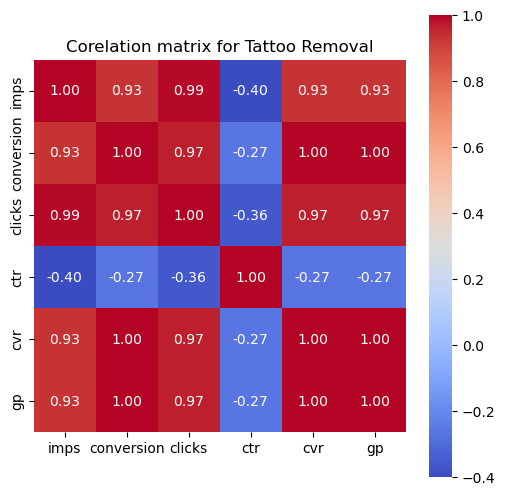

['tattoo removal', 'tattoo removable', 'tattoo', 'tatto removal lake forest', 'discover pico laser removal eyebrows tattoo', 'laser tattoo removal', 'laser tattoo', 'laser scar removal', 'eyebrow tattoo removal']


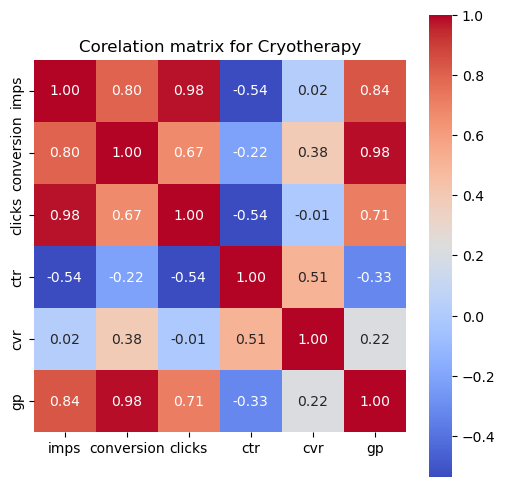

['cryotherapy', 'cryotherpy', 'neck fat', 'my body wellness', 'coolscuplting', 'crypotherapy', 'cryo facial', 'cryo', 'glo sun']


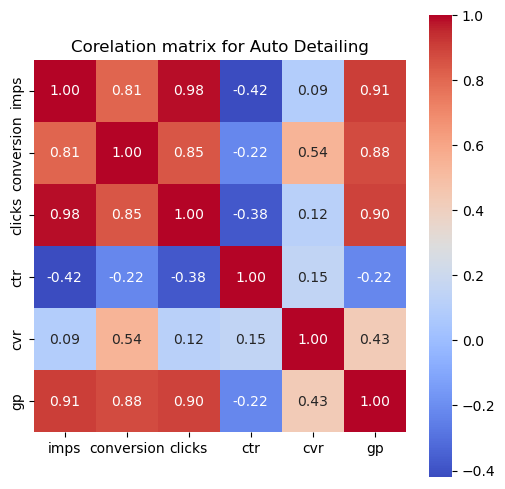

['car detailing', 'car detail', 'quiroga', 'auto detailing', 'paint pottery', 'nebo', 'oasis car waah', 'mobile car wash', 't-mobile', 'shampoo car seat', 'ceramic coating', 'ceramic wrap', 'bull riding', 'car cleaning', 'car coating', 'car clearning detailing', 'car interior detailing', 'car toys', 'car wash interior', 'car wash deels', 'details', 'detailing', 'detail', 'compact suv detail', 'auto show', 'auto detail', 'auto body painting', 'interior car cleaning', 'interior detail', "dynamic brother's detailing", 'full detail']


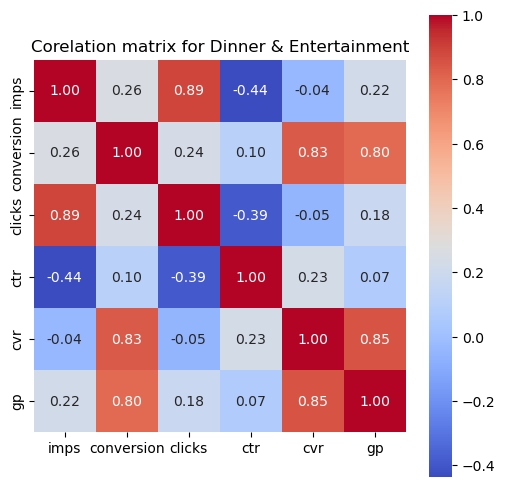

['flagship brunch san diego', 'dinner cruise', 'philadelphia cruise', 'adult entertainment', 'mauka warriors luau', 'live music', 'lu’au', 'naples florida', 'ocean voyage', 'midevil times dinner', 'murder mystery', 'sunset sailing', 'sunset sail', 'things to do sunday', 'victory cruise cape canaveral fl', 'valentine’s day dinner', 'valentines day dinner', "valentine's day dinners", 'volunteer princess', 'san francisco bay cruises', 'public history tour', 'restaurant week dinner cruise', 'sleuth mystery', 'ski lift tickets pa', 'chicago auto show', 'brunch cruise', 'casino cruise', 'day cruise miami', 'day cruise', 'dinner for two', 'dinner dectective', 'dinner boat', 'dinner', 'cru', 'cruise kids', 'cruise in', 'cruise dinner', 'alligator', '3 day cruise', 'booze cruise', 'boat celebreties', 'immersive gamebox', 'jodeci king theater', 'jungle queen dinner cruise', 'jungle queen', 'flamenco dinner show', 'firework', 'dolphin cruise', 'drag']


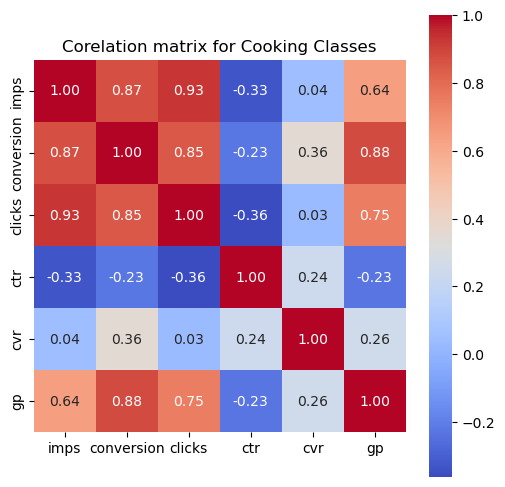

['class', 'cooking class', 'couples cooking class', 'cooking classes sc', 'cooking classes', 'pasta making class', 'pasta making', 'pasta class', 'pasta', 'sushi making class', 'sushi making', 'vegan cooking class', 'sauces', 'cocusocial', 'chocolate making class', 'cake makinh', 'cake decorating class', 'cake decorating', 'date night cooking class', 'cooking ckasses', 'cooking  class', 'cooking', 'couple cooking classes', 'couple cooking class', 'couple baking class', 'couples cooking classes nyc', 'couples cooking', 'couples class', 'baking class', 'baking', 'italian cooking classes', 'kura revolving sushi', 'kids baking', 'keto gift', 'flower arrangement class', 'group cooking', 'food class']


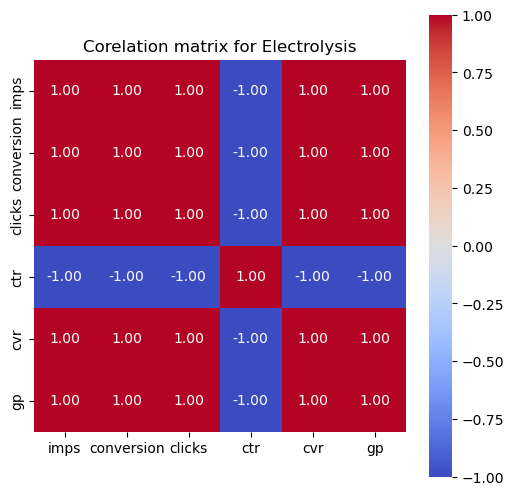

['electrolysis', 'ele']


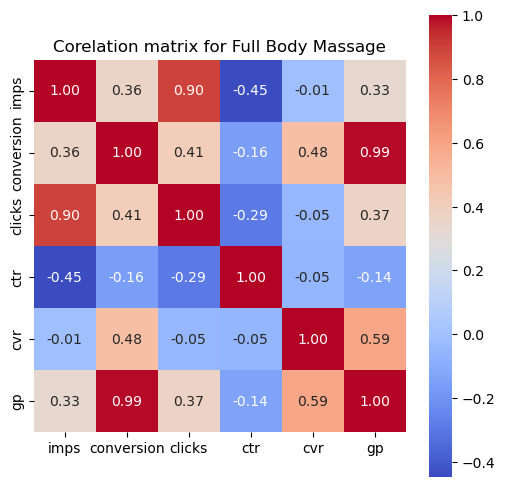

['massage heights', 'sante healing spa', 'joyaa spa', 'thai massge', 'professional body massage therapy', 'massage’s', 'massageluxe', 'massage, single person', 'massage and foot scrub', 'massage and detox', 'massage all days', 'massage men', 'massage marietta', 'massage heights spring cree', 'men’s full body massage', 'mesage', 'message 172nd broadway', 'mas', 'madsage', 'nani', 'naples florida 90 minute massage', 'northeast', 'mu tao massage', 'treat your feet', 'swedish couples massage', 'zen day spa', 'saku', 'royal vitality massage', 'santa fe couples massage', 'reflexology massage', 'soavia', 'spine and sports therapy massage', 'single massage', 'deep tissue massage pleasanton', 'aqua stone spa', '90 minutes massage', '90 min massage hendersom', 'accolades spa', '2 hour massage', '1 full body massage', 'body massage', 'beauty', 'himalayan sal', 'hand and stone', 'head and scalp massage', 'hair spa and shoulder massage', 'group massage', 'full body massages for 2', 'full body massa

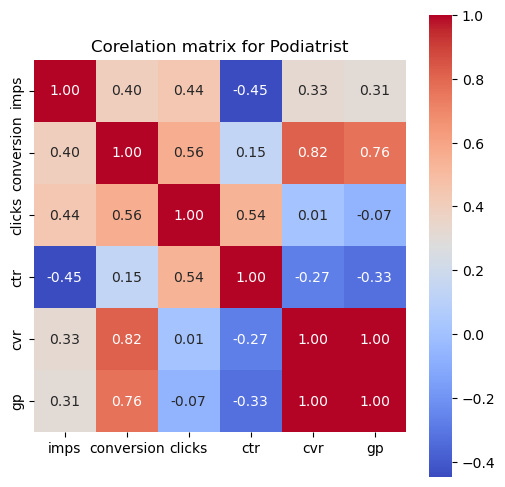

['laser nail', 'foot detox', 'medical pediacuer', 'nail fungus', 'toenail laser', 'rolling meadows', 'laser toenail']


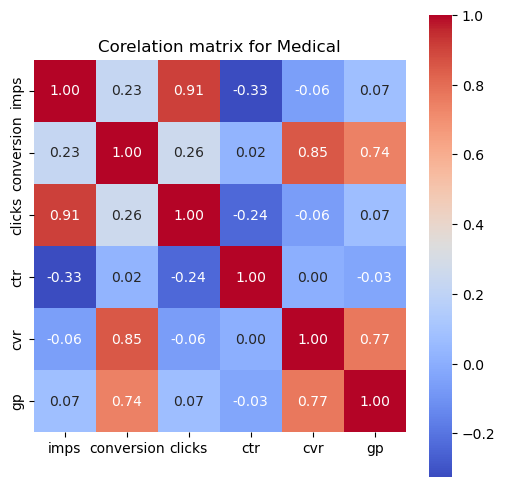

['laser toe', 'soft wave', 'gentle giant care', 'iv infusion', 'food sensitivities', 'lab', 'iv', 'allergy', 'advanced food and allergy', 'palm beach par three', 'pain management', 'pain', 'prime iv hydration', 'prime iv', 'medical pedicure', 'nad therapy', 'nad  iv', 'nad', 'nutrient testing', 'toenail fungus', 'toenail fungud', 'titr8', 'underarm sweat', 'ucari for dogs', 'therapy using muscle roller', 'vegas iv drip', 'vitamins', 'vitamin iv delray', 'vitamin energy iv drip at liquivida wellness center', 'vitamin d 3', 'vitamin d', 'root sharka', 'prp injections in houston for joints', 'restore sonterra', 'sofwave', 'soft wave therapy', 'shoulder therapy', 'shockwave therapy', 'dna testing', 'any lab test now', 'allergy panel', 'astra', 'asap iv', 'advanced labs', 'blood test', 'bac shot', 'biovital', 'beauty iv', 'i v drips', 'hyperbaric oxygen therapy', 'hydration treatment  iv', 'hydration vitamin  iv', 'hydration iv', 'ivf', 'iv therapy', 'iv teraphy', 'iv hydration', 'iv glutat

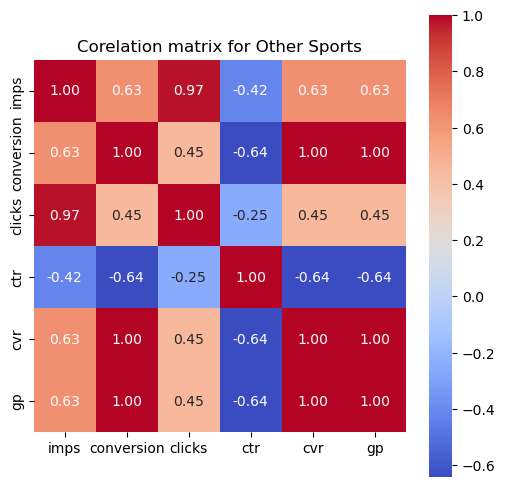

['stock show', 'pro rodeo tickets', 'pbr', 'national western stock show', 'western stock show colorado', 'rodeo', 'stockshow tickets', 'stockshow', 'stock', 'denver stock show', 'denver todeo', 'general admission tickets coloardo stock show']


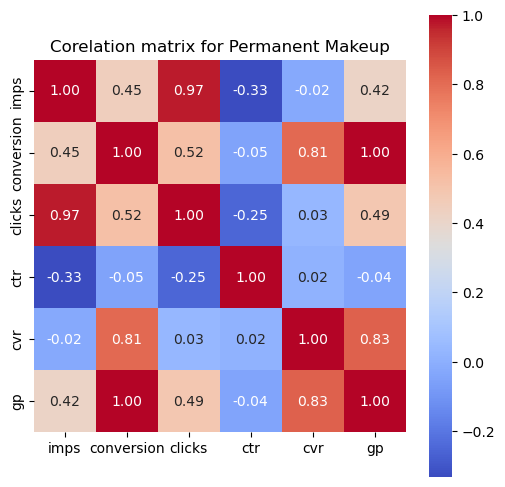

['nano', 'eye liner', 'microblading', 'ombré', 'ombre powder', 'ombre brows', 'permanent foundation', 'permanent eye liner', 'permanent brows', 'permanent', 'permanent makeup', 'permanent eyeliner', 'lip permanent', 'lip blushing', 'lip blush', 'micoblading', 'micrblading', 'nano brows', 'nanoblading', 'microblanding', 'microblading nadia', 'microblading eyebrows', 'microblading eye brows', 'microblading brow', 'microbladijng', 'microbladign', 'microbladig', 'microblade', 'microbladding', 'micro blade eyebrows', 'microsh', 'tattoo eye liner', 'brows by nikki', 'brows', 'carpe diem', 'ariava', 'hairline microblading', 'eyebrow ombré', 'eyebrow microshading', 'eyebrow microblading', 'eyebrow microbalding', 'eye brows', 'eyebrow tatooing', 'eyebrow tattoos', 'eyebrows', 'eyebrow transplant', 'ebrows microblading', 'grace aesthetic', 'hair stroke eyebrows']


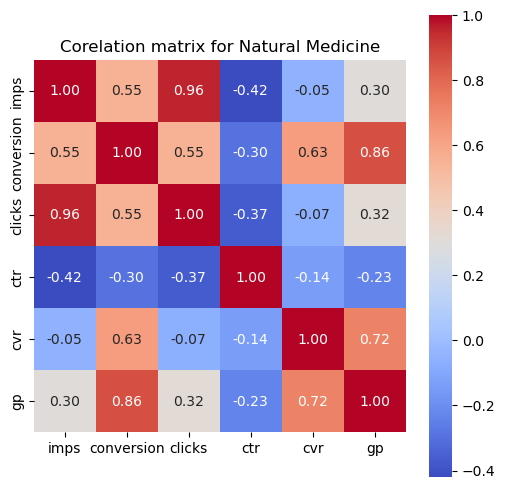

['hyberbaric healing', 'hyperbaric', 'medical marijuan', 'medical marijuana', 'cupping', 'renew medical marijuana card', 'massachusetts medical card', 'medical marijuana card new patient evaluation', 'medical card', 'online certification', 'one ohio', 'ohio medical marijuana doctor', 'ohio medical marijuana renewal', 'ohio medical marijuana', 'ohio medical card', 'oxygen bar', 'med', 'medical marijuana pa', 'medical marijuana cards', 'medical marijuana card pa', 'medical marijuana card online', 'medical marijuana card', 'medical maijuana', 'medical', 'light health center', 'marijuana doctor', 'marijuana card', 'marijuana  card in', 'marijuana', 'marajuana doctor st. augsutine', 'nj medical marijuana card', 'weed dr', 'releaf', 'softwave  therapy', 'st jude medical brandon', 'cheap trick', 'docmj', 'hyperbaric oxygen chamber', 'hyperbaric oxygen', 'hyperbaric chamber', 'hypeebaric', 'leafwell', 'juiced', 'florida medical marijuana dr', 'ear wax removal']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



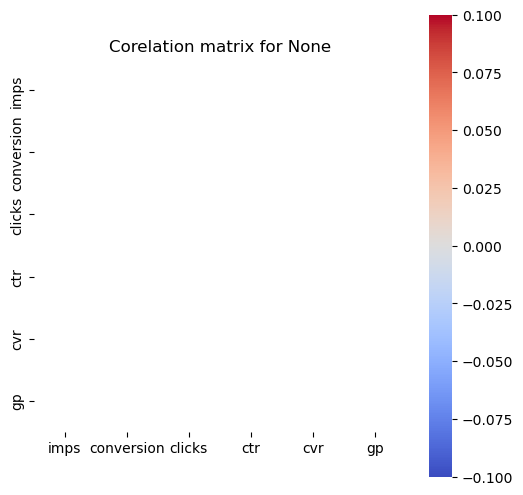

[]


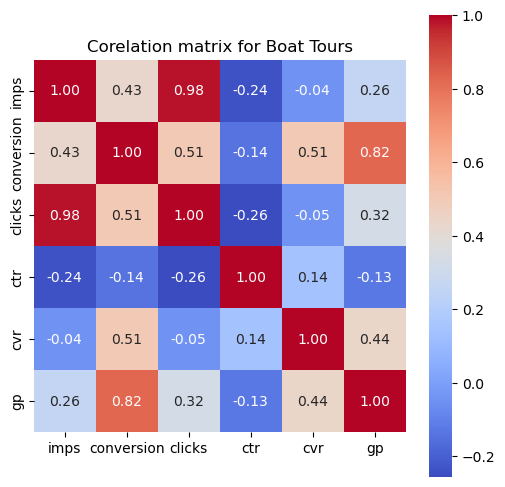

['creole queen', 'river cruise', 'whale watching', 'san diego whale watch', 'cruise', 'things to do', 'sunset whale watch', 'party sunset cruise', "venice of america tour | millionaire's row | complimentary drinks", 'cake parties', 'statue of liberty', 'swamp tour', 'discovery whale watch', 'sunset cruise', 'tours', 'whale', 'venice of the', 'san diego harbor tour', 'meadows', 'pacwhale', 'plane tickets', 'pontoon boat tour', 'pier cruises', 'private dinner boat', 'private boat', 'private yacht', 'party boat', 'miami fl celeb boat tour', 'miami everglades tour', 'legacy whale watch', 'newport whales', 'newport', 'naples, florida', 'niagara falls boat tour', 'nyc', 'ocean outfitters', 'night boats', 'monterey bay aq', 'tiki boat ride', 'up adventure park', 'sunset', 'swamp tour new orleans', 'swamp', 'wheelchair tour miami', 'whale wstch haleiwa', 'whale watching kauai', 'whale watch', 'yatch', 'yacth', 'yacht', 'zoo tampa', 'zoo new orleans', 'veneise of america millionaire', 'valentin

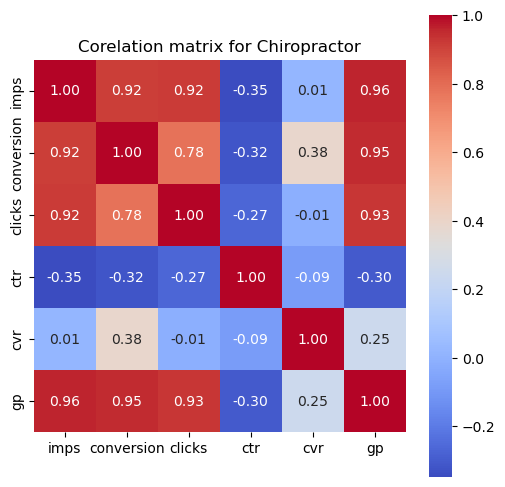

['chiropractor', 'chiropractic', 'chirop', 'postres', 'massages in maryland', 'massage near queens', 'male message austin', 'whole body chiropractic', 'woodhouse massege', 'real deal wellness', 'spinal decompression', 'chiropractic adjustment', 'chiropr', 'chiro', 'chir', 'chiropractorr', 'chiropractor massage', 'chiropractot', 'aqua massage in reno, nv', 'back adjustment']


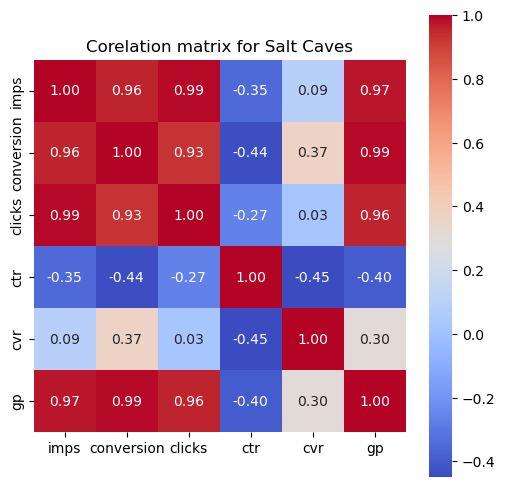

['salt cave', 'salt sanctuary', 'salt room', 'salt', 'private spa room', 'me spa', 'tradtions at the glen spa johnson city ny', 'transquility spa', 'salt rooms', 'salt chamber', 'corcova salt spa', 'himalayan salt cave', 'hillsborough', 'halotherapy', 'float state']


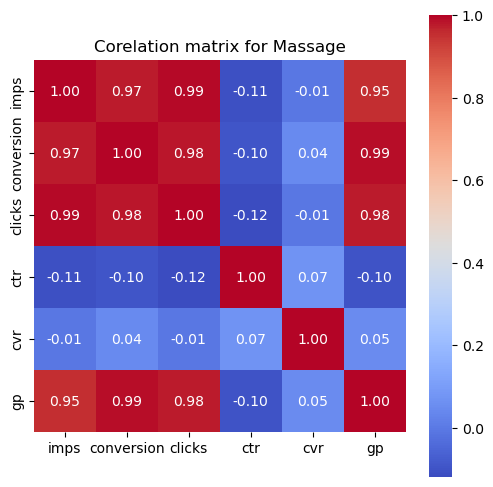

['massage', 'couples massage', 'spa', 'massage heights', 'couples message', 'couple massage', 'lymphatic draining', 'couples', 'deep tissue massage', 'dyer in', 'massages', 'deep tissue', '224 massage', 'postnatal massage', 'step up skin laser', 'tocasierra spa at hilton phoenix resort (7677 north 16th street, phoenix)', 'lymphatic drainage massage', 'sante healing spa', 'reflexology', 'couples massage near me', 'massage and spa couples', 'mess', 'stretch massage', 'fa fa foot spa', 'joyaa spa', 'swedish massage', 'thai massge', 'wave arts', 'love institute', 'massage for 2', 'essentials', 'regen medical', 'deep', 'whitman soa', 'lymphatic', 'massage chapel hill', 'sakura', 'shiatsu', 'electric muscle stem', 'omaha zoo', 'pampered massage therapy', 'plainview massage', 'professional body massage therapy', 'post op lymphatic message', 'prenatal massage', 'prenatal', 'pregnant massage', 'paris massage', 'phoenix', 'philadelphia', 'maternity massage', 'massgae', 'massaging', 'massage’s', 

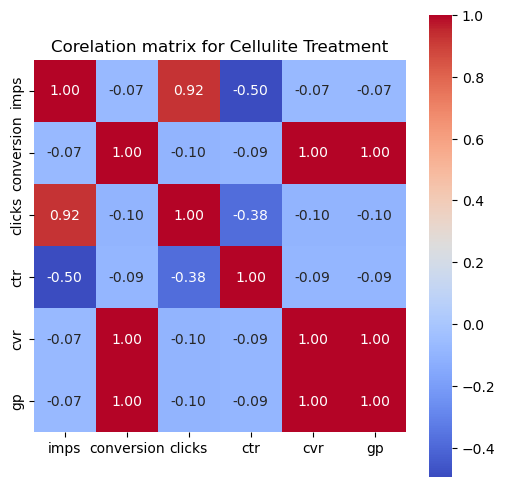

['cava lipo', 'tummy tightening', 'venus legacy', 'sculpt', 'southshore laser', 'suda tonic body wrap', 'skin tightning', 'cellulie', 'cavitation', 'cavitatiin', 'cativation', 'body fat', 'body cavation', 'bodyology', 'fat removsl', 'fat freezing treatments', 'fat dissolve injections', 'esthetics', 'evolve body sculpting', 'endermologia', 'endermologie', 'endospere']


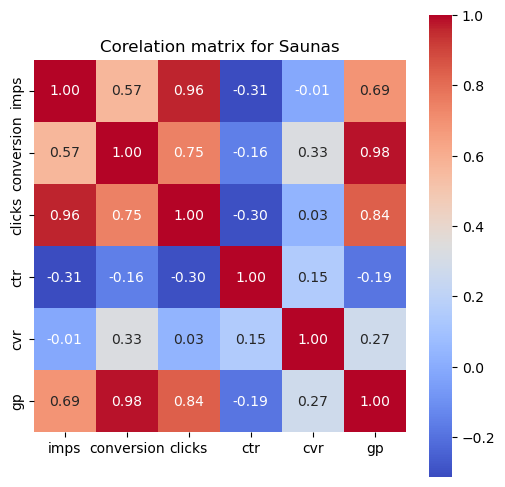

['spa world', 'sauna', 'saunas', 'spa wprld', 'dallas tan republic', 'suana', 'ohio cyro', 'oxygen', 'organic to green', 'total spa package', 'waterbar', 'wellness', 'rollshaper red light', 'spaworld', 'spa/sauna', 'souna', 'spa ans sauna', 'led sauna', 'cold plunge', 'car wrap', 'deep blue med spa', 'des plaines', 'cry', 'accelerat8', 'hyberberic chamber', 'infrared sauna palm harbor', 'infrared suana', 'infrared sauna', 'infrared', 'infra', 'infared sauna', 'infared', 'kume', 'float away spa', 'fire and ice', 'east windsor massage']


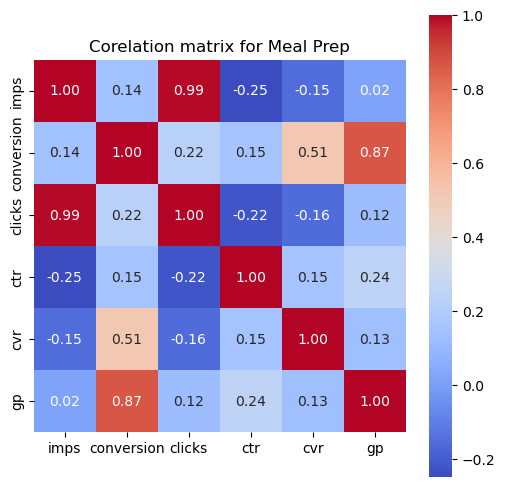

['factor', 'meal kit', 'factor meals', 'tempo', 'green chef', 'food', '"for two"', 'meal kits', 'meal kit delivery', 'meal delivery', 'meal', 'uber eats codes', 'uber eats', 'uber', 'vegan food', 'blue apron', 'home chef', 'keto meals', 'family meal delivery', 'everyplate']


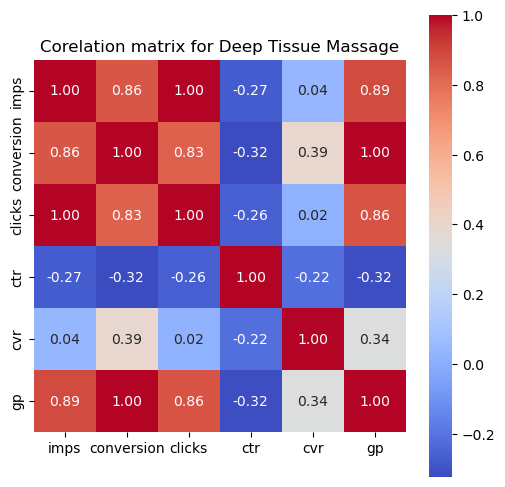

['deep tissue massage', 'deep tissue', 'deep', 'phoenix', 'massgae', 'massaging', 'massage couple deal', 'massage 10022', 'masajes', 'massage du jour', 'massage north austin', 'massage highlands ranch', 'meet spa', 'ma', 'sunshine lily', 'walk in massage', 'royal spa', 'san tan valley', 'spa group', 'solace massage', 'sports massage', 'chinese massage', 'cellulite light therapy', 'deep tissue for two', 'deep tissue masssage', 'deep tissue or swedish', 'd massage', 'couples massage deep tissue', '90 minute massage', 'aa massage studio', '4 hand massage', 'bobospa', 'bamboo beauty spa', 'back massage', 'far infrared sauna', 'element massage', 'enjoy up to 21% off at ny foot spa with a variety of luxury body massage options including hot stones and essential oils', 'glorious hands wellness and beauty']


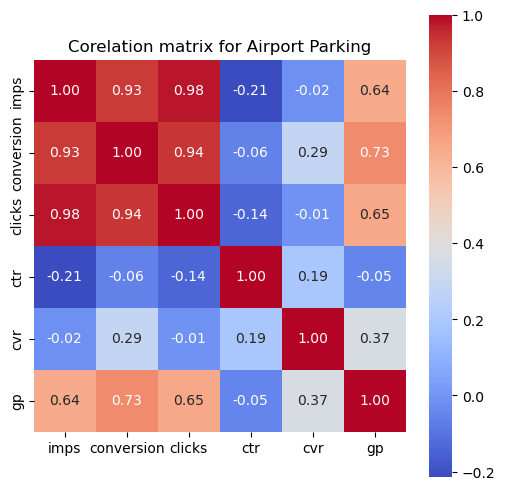

['park and jet philadelphia reservations', 'airport parking', 'seatac parking', 'jfk parking', 'airport', 'hobby airport parking', 'park n go', 'masterpark', 'lax parking', 'peachy parking', 'parking at newark airport', 'peachy', 'extra car', 'bradley airport parking', 'masterpark lot b', 'seatac', 'parking spot', 'the parking spot', 'phl airport parking', 'ohare parking', 'phx parking', 'park dia', 'park and flight', 'park', 'park n fly', 'park spot', 'parking airport', 'parking seatac', 'parking dfw airport', 'parking cvg airport', 'parking bwi airport', 'parking at ewr', 'parking at bradley', 'parking at bdl', 'parking at atl', 'parking at airport', 'phl parking', 'masterpark c', 'master park', 'miami international airport parking', 'miami airport parking', 'long term parking fort lauderdale airport', 'long term parking ewr', 'lga parking', 'newark airport parking', 'newark airport', 'mitchell airport', 'snap', 'bwi parking', 'bwi airport parking', 'dallas lovefield inn', 'dia parki

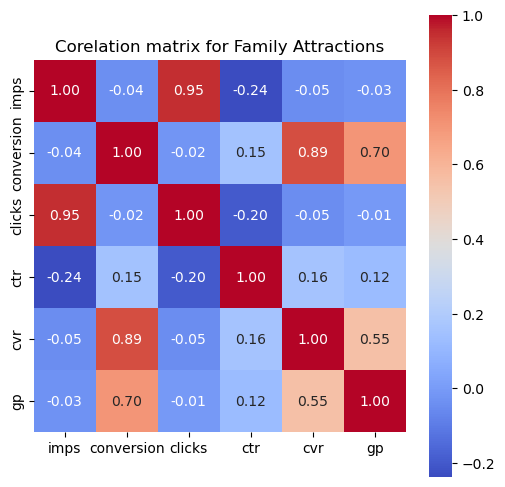

['deezerland', 'atlanta aquarium', 'area53', 'book of free', 'smileys', 'las vegas kids', 'brickfest', 'are53', 'boulder adventure park', 'dezeland', 'andretti melbourne', 'fun station cedar rapids', '2 person mountain coaster', 'rocky mountain alpine coaster', 'bolder adventure', 'sea world tickeys', 'belmont park california', 'old town', 'orlando aquarium', 'orlando magic basketball tickets', 'perfume making class for kids', 'peppa pig lego land', 'peppa pig', 'perot museum', 'legoland winterhaven', 'legoland san diego', 'lego', 'lefoland', 'mall of america attractions', 'magic kingdom tickets', 'new jersey aquarium', 'newport aquarium', 'nickelodeon universe', 'nickelodeon american dresm', 'nickelodeon', 'midevil time', 'musem', 'monterrey bay aquarium', 'titanic exhibition', 'unversal', 'universal studios tickets', 'universal studios orlando', 'universal studio', 'universal park', 'universal orlando', 'universal 2day', 'univeral studios tickets', 'sunken gardens', 'the strat jump',

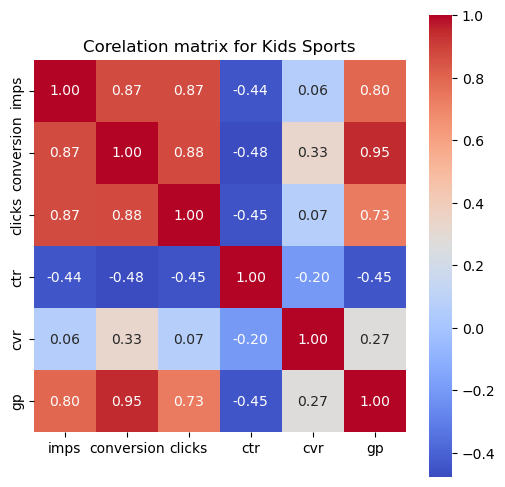

['urban air', 'area 53', 'big air', 'paintball', 'archery', 'ghosttown zipline', 'jayell ranch', 'paint ball', 'play', 'parks', 'natural bridge caverns', 'linq zipline', 'natural bridge', 'tanks paintball', 'things for men', 'wilderness at the smokies day pass', 'zip lining', 'sevierville', 'climbing class', 'climb works', 'bungee jump', 'dodgebow', 'colorado for december', 'atv ri', 'adrenaline park', 'blast camp paintball', 'hampton, va skyzone', 'hollywood sports airsoft', 'kids ziplinig', 'kids friendly', 'kayak balboa', 'freemont zipline']


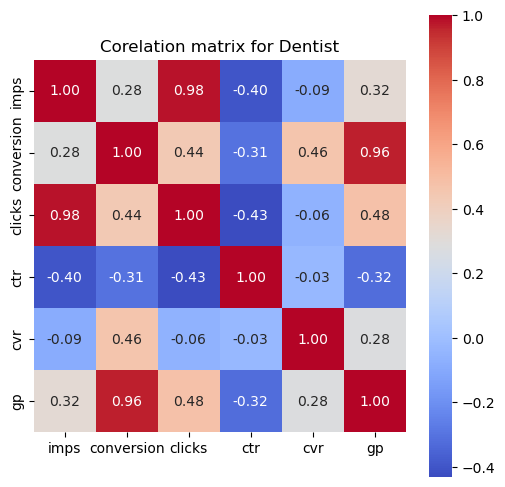

['dental cleaning', 'teeth cleaning', 'dentist', 'dental clrsning', 'dental services', 'tooth', 'wendy mayer', 'deep teeth cleaning', 'dentists', 'dentist deep cleaning', 'dentist cleaning', 'dental work', 'dental implant', 'dental', 'flouride', 'fresh dental smiles']


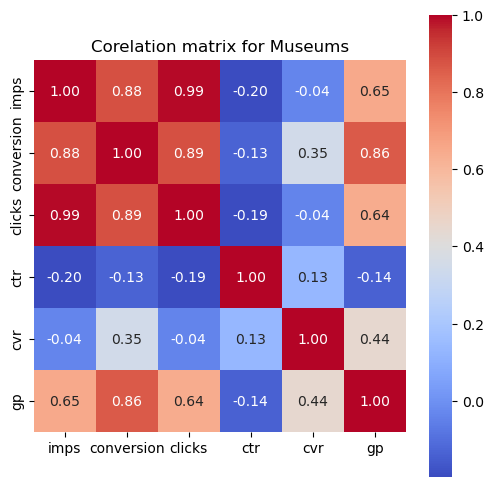

['kids', 'museum of illusions', 'museum', 'md science center', 'annual adventuer maryland science center', 'maryland science center', 'bible museum', 'dezerland', 'selfie world', 'museums', 'banksky museum', 'jamnola', 'vanderbilt summit down', 'chilul', 'seattle', 'mardi gras', 'hershey childrens museum', 'activities', 'museum of illusions kansas city', 'museum of art and design', 'the new york historical', 'oneworld', 'one world observatory', 'paradox museum', 'medieval torture', 'medieval times', 'medieval time', 'lone star flight museum', 'mardi gras world', 'madame', 'new york historical society', 'national music museum', 'nyc museums', 'mob museum', 'movie prop experience', 'musuem', 'must do', 'museum of the bible', 'museum of natural', 'museum of illusion', 'museum of icecream', 'museum of ice cream', 'museum membership', 'mount vernon', 'summit one', 'summit 1 vanderbilt', 'summit', 'the summit', 'uss midway', 'warbird', 'san', 'savannah', 'science museum', 'science center', '

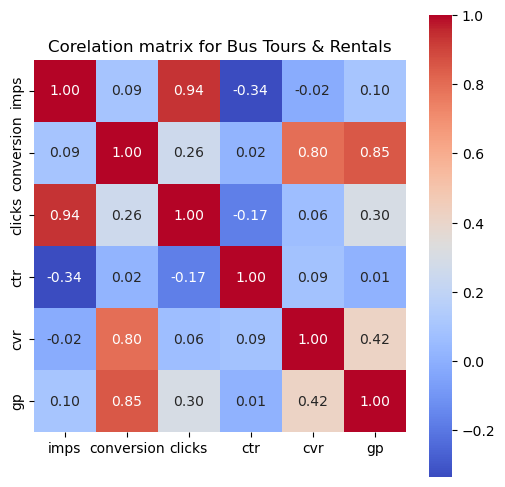

['big bus', 'bus', 'crawl', 'old town trolley tour', 'pool party', 'party bus', 'miami tours', 'national park express', 'night bus', 'nola ghost riders', 'millineum tour', 'monuments by moonlight', 'tour guides', 'top view night', 'trolley tour', 'the ride', 'wildlife safari airboat ride', 'vegas helicopter', 'savannah ga trolley', 'south rim tour', 'chicago night life', 'club', 'buffet las vegas', 'big bus tour', 'hawaii bus tour', 'hoover dam', 'hoover dam tour', 'hop on', 'hop on iconic', 'hop on hop off sightseeing bus', 'dunn tour', 'dubai one day taxi']


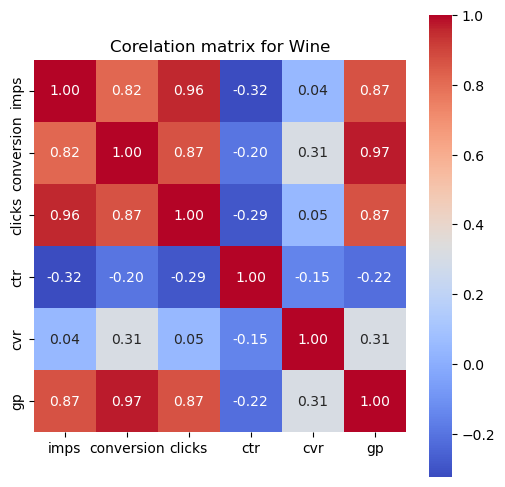

['wine', 'wine tasting', 'priority wine pass', 'red wine', 'winetasting', 'engagement gifts', 'paso wine tours', 'paso robles wine tour', 'lioness', 'leoness cellar', 'malbec red', 'moscato', 'tomasello', 'sweet wines moscato', 'sweet wines', 'temecula wineries', 'temecula wine tasting', 'temecula', 'wine tasting for 3', 'wine tasting class', 'wine tasting and limo', 'wine tastin', 'wine tas', 'wine organic', 'wine of the month', 'wine insiders', 'wine and cheese', 'wine tasting sedona', 'wine tasting temecula', 'wines with free shipping', 'wines', 'winery', 'wineries', 'wine with free shipping', 'wine tour', 'wine testing', 'wine tastings', 'vivac', 'schnebly', 'rescue wine', 'splash wines', 'splash', 'chardonnay boat', 'brooks hill winery', '20 bottles wine', 'barefoot wine', 'bare foot wine', 'house wine', 'home wine tasting', 'jerome', 'group wine tours', 'group wine tasting', 'fragrance making class']


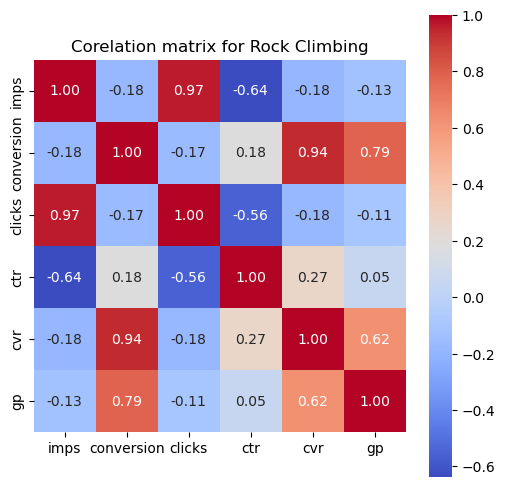

['1 or 2 intro classes, 1- or 12-month climbing passes, or 6-month memberships at hangar 18 (up to 36% off)', 'asana', 'az on the rocks', 'mesa', 'mesa rim', 'momentum', 'winter activities', 'urban air los angeles', 'rock climbing', 'climbing gym', 'climbing', 'climb zone', 'climb', 'area 53 laser tag', 'bowling manhattan', 'indoor rock climbing', 'hangar 18', 'go kart indoor', 'gift cards lasertag']


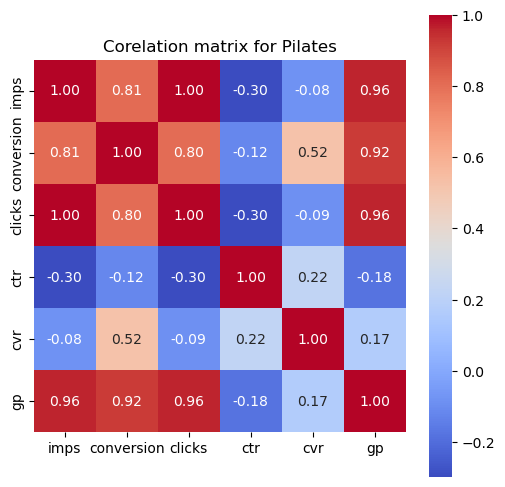

['pilates', 'witt', 'white house pilates', 'pilates classes', 'pilates reformer rental', 'pilaties', 'patty witt', 'mat pilates', 'workout', 'reformer pilates', 'reformer', 'art of pilates', 'bodyrok alamo', 'lagree', 'gramercy pilates', 'function pilates']


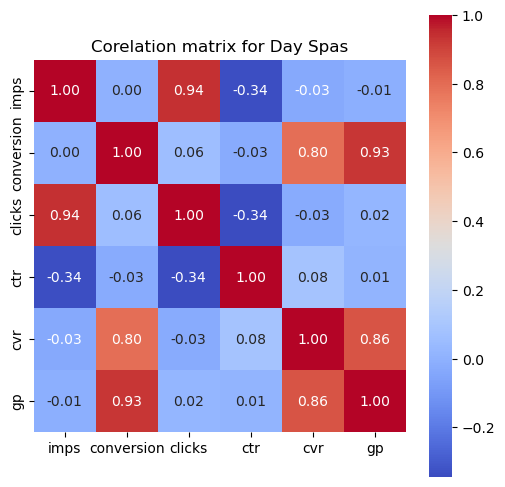

['kings spa', 'spa luxe', 'new york spa club', 'king soa', 'korean spa', 'gangnam spa', 'pampering package', 'prosperous paradise spa', 'pregnant massage\xa0', 'me', 'maui spa', 'massage and pedicures', 'massage and facial packages', 'massage for couples', 'medical spa', 'mani pedi massage', 'luxury spa', 'new day spa', 'oceana', 'nomad', 'mom and daughter spa', 'mint wellness', 'trubliss', 'tea soa', 'the spa club', 'wildflower spa', 'wildflower', 'women’s spa', 'wellness spa', 'verse chicago experience', 'urbana spa', 'valentine’s day package', "valentine's day", 'valentine day couple', 'water therapy', 'water lounge', 'san francisco zoo', 'sante', 'q sspa', 'qc spa', 'q spa', 'q sauna', 'purr spa', 'renew day spa', 'spa logic', 'spa pass', 'spa party', 'spa pampering', 'spa packages', 'spa package', 'spa messages', 'spa mellia mall', 'spa massage for two', 'spa in blueisland il', 'spa experience', 'spa deals', 'spa. world', 'spa services', 'spa de parejas', 'spa de agua', 'spa bath'

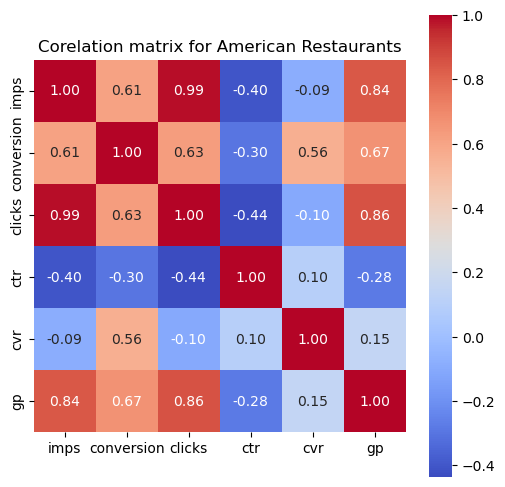

['restaurants', 'restaurant', 'dicks last res', 'restaurants.com', 'chimis', 'mexican', "chimi's", 'restaurant.com', 'blueberry hill', 'restaurant chimi', 'crooked pint', 'desayunos', 'oplika resturant', 'planet hollywood', 'park tavern', 'persian food', 'tacos', 'wings', 'rainforest cafe', 'rain forest cafe', 'resturents', 'resturants.com', 'restaurant food brooklyn', 'restaunt', 'southern girls restaurant', 'spirit of norfolk', 'burgers', 'bulls', 'cash back', 'desayuno', 'dinner for 2', 'american dream', 'big city diner', 'big boy', 'havana', 'kosher', 'leatherbys', 'great british', 'group party restaurants', 'food denver colorado 80212', 'fodue restaurant', 'gift card']


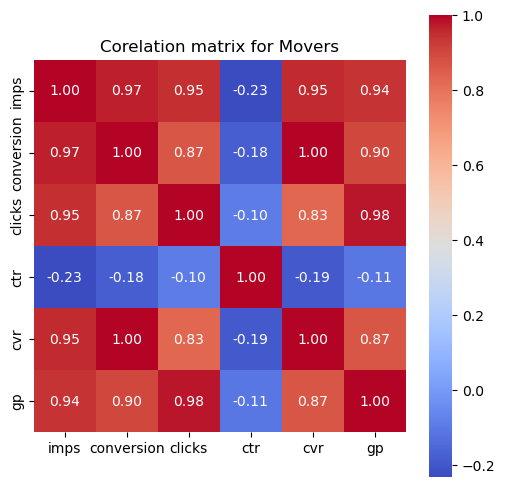

['movers', 'moving', 'moving trucks', 'moving truck', 'moving services', 'moving company', 'moving companies', 'mover', 'movers and truck']


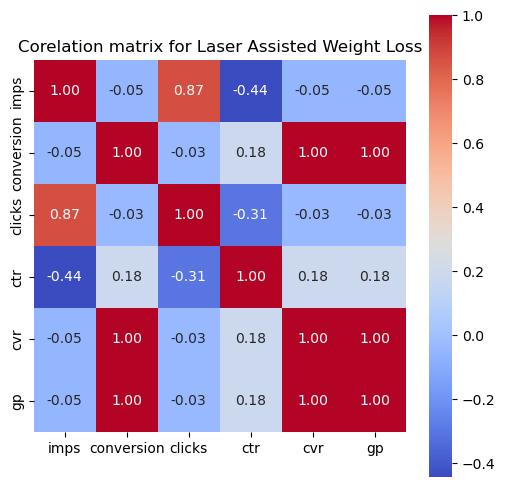

['skin tight', 'liquid lipo', 'lemon bottle', 'mommy make over', 'tickle lipo', 'ultrasound cavitation', 'ultrasonic fat reduction', 'ultrasonic cavitation', 'tru sculpt', 'tummy surgery', 'wooden therapy', 'vela body shape', 'venus', 'velashape', 'vela shape iii', 'weight losa', 'sculptsure', 'red light therapy weight loss', 'stomach recuction', 'stomach', 'skin studio', 'chin lipo', 'cellulitis', 'cellulite reduction', 'cellulite', 'cavi lipo center', 'detox your body', 'cryoskin', 'couture med spa', 'arm sculpt', 'arm fat reduction', '400 west jericho', 'adore spa', 'body treatments', 'body sculpting', 'body contouring', 'body contour albuquerque', 'brazillian lazer', 'bella derma', 'inmode', 'hcg injections', 'laser fat', 'laser whole body', 'fat freezing', 'fat removal', 'fat reduction', 'fat injection', 'erbium fractional laser', 'get rid of double chin']


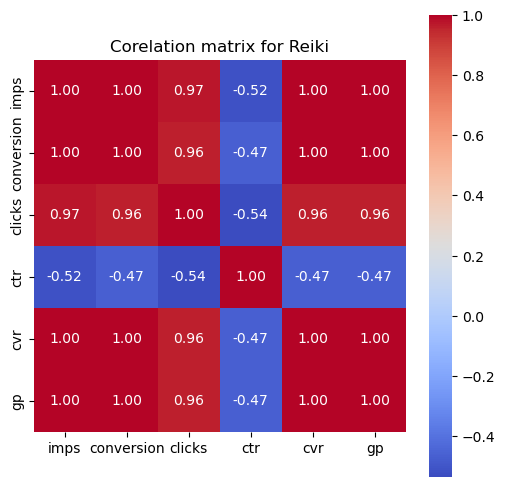

['reiki', 'reimi', 'reiki healing', 'sound bath', 'eau claire wi']


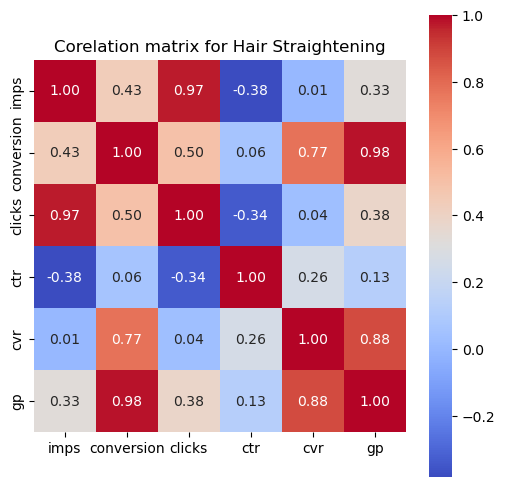

['unfltrd', 'keratin', 'organic keratin', 'single process, haircut', 'diva salon', 'blow out hair', 'brazilian straightening', 'brazilian blowout hair treatment', 'brazilian blowout', 'brazilian blout', 'brazilian treatment', 'brazillian blowout', 'botox hair', 'beauty and apa', 'black hair salon', 'keritin', 'keratine', 'keratin treatment', 'keratin rteatment', 'keratin hair treatment', 'keratin blowout', 'hair keratin', 'hair cut and color', 'hair stylist', 'hair straightening', 'hair botox', 'hair bar nyc', 'hair bar']


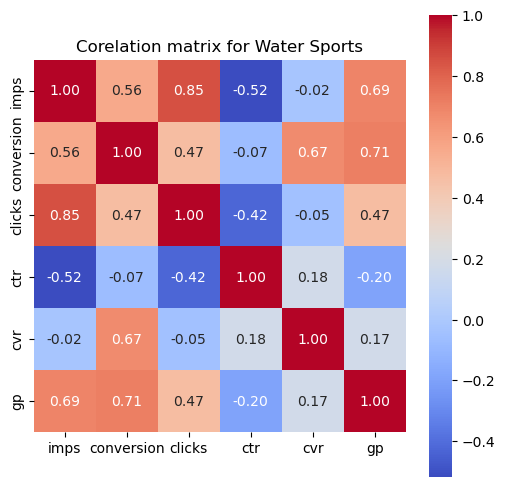

['jet ski', 'zipline', 'kayak', 'pontoon boat rental', 'swan eola', 'paddleboard', 'pontoon', 'private sail', 'private captained boat tour', 'parasailing tour xtreme', 'parasailing', 'miami watersports', 'long island canoe kayak rentals', 'lihue', 'mantas', 'manta ray', 'manta', 'oahu', 'night snorkling', 'night', 'museum of ancient life', 'treetop trekking miami', 'sunset tour', 'swimming with manatee', 'swim with manatees', 'surf', 'swan boats', 'surfing lessons', 'surfing', 'surf lesson', 'the edge', 'white water rafting', 'ziplining keana farms', 'ziplining', 'zipl', 'zip lining big island', 'sea quest', 'sandiego', 'rafting', 'rnb booze cruise chicago', 'south san francisco', 'shark', 'snorkeling for kids', 'snorkling', 'snorking', 'snorkeling', 'snorkel', 'child', 'led kayak', 'dixie', 'crystal river manatee', 'atv rentals', 'atv self guide', 'airboats', 'boating', 'boat ride and jet ski', 'beach horse riding', 'indoor sky di', 'hawaii island', 'hot tub cruise', 'kona', 'jetsky',

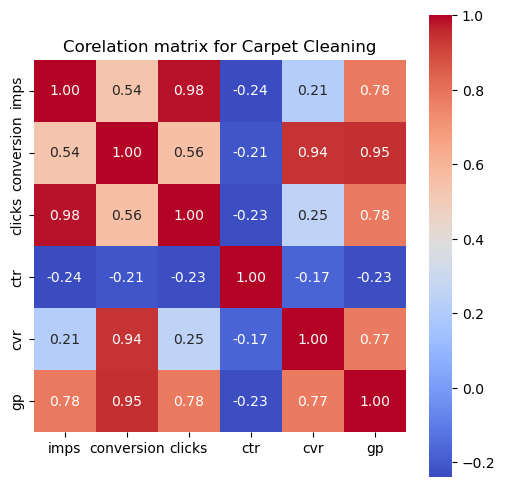

['carpet', 'carpet cleaning', 'upholstery cleaning', 'upholstery', 'upholestry cleaning', 'rug cleaning', 'sofa cleaning', 'steam cleaning', 'cleanup', 'carpret cleaning', 'carpets', 'carpetcleaning', 'carpet shamoo', 'carpet cleaning deals', 'carpet cleaning austin, tx', 'carpet cleaners', 'carpet cleaner', 'carpet clean', 'carpert cleaning', 'couch cleaning', 'couch clean', 'area rug cleaning']


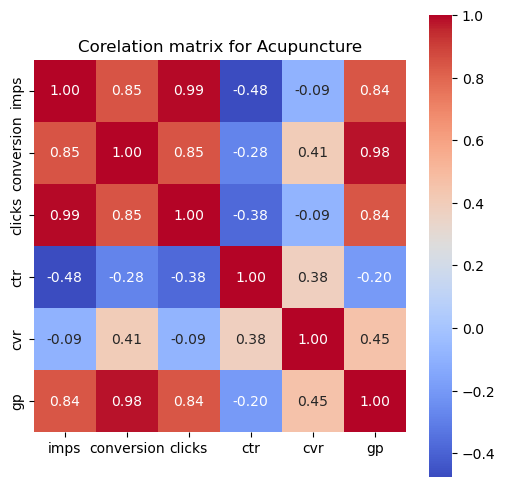

['acupuncture', 'balance acupuncture', 'accupuncture', 'sports medicine', 'accupunture', 'acupunture', 'acupunctune', 'acupun']


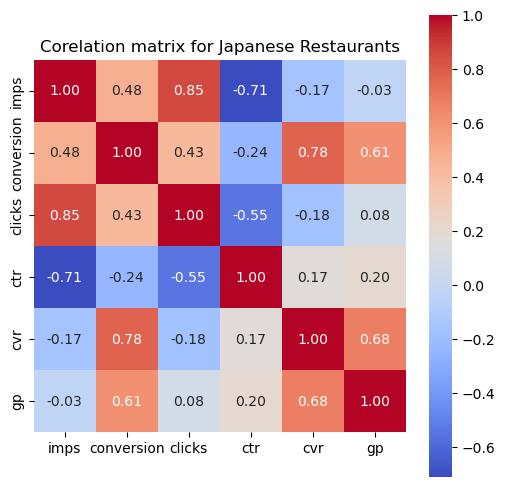

['gyu king', 'hibachi', 'osak', 'sushi for 2', 'sushi', 'takara', 'sushi near me', 'sake', 'japanese', 'japanese steakhouse', 'fuji sushi and steakhouse']


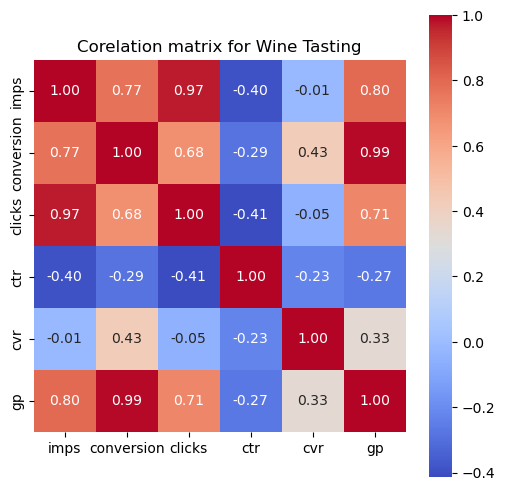

['wine tasting', 'priority wine pass', 'winetasting', 'lioness', 'leoness cellar', 'tomasello', 'temecula wineries', 'temecula wine tasting', 'temecula', 'wine tasting for 3', 'wine tasting and limo', 'wine tastin', 'wine tas', 'wine and cheese', 'wine tasting sedona', 'wine tasting temecula', 'winery', 'wineries', 'wine tour', 'wine testing', 'wine tastings', 'vivac', 'schnebly', 'brooks hill winery', 'home wine tasting', 'jerome', 'group wine tours', 'group wine tasting']


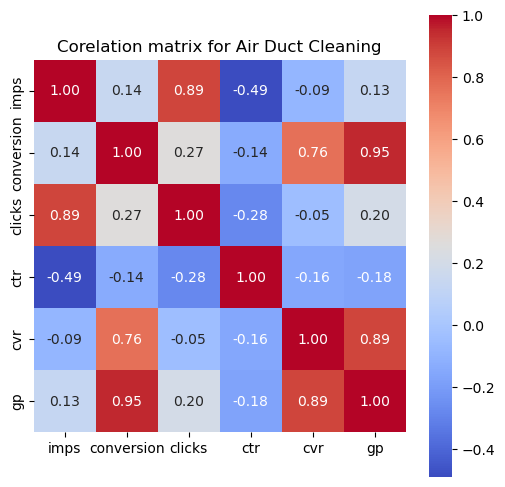

['air duc', 'chimney dryer', 'furnace cleaning', 'air duct cleaning', 'dryer vent cleaning', 'vents, air duct cleaning', 'vent cleaning', 'vent cleaner', 'washer dryer vent clean only', 'chimney cleaner', 'aird', 'air vents', 'air ducts', 'air duct', 'hvac', 'hvac cleaning', 'duct vent cleaning', 'duct cleaning', 'duct and vent cleaning', 'dryer vent clean only', 'dryer vent clean', 'gutter cleaning']


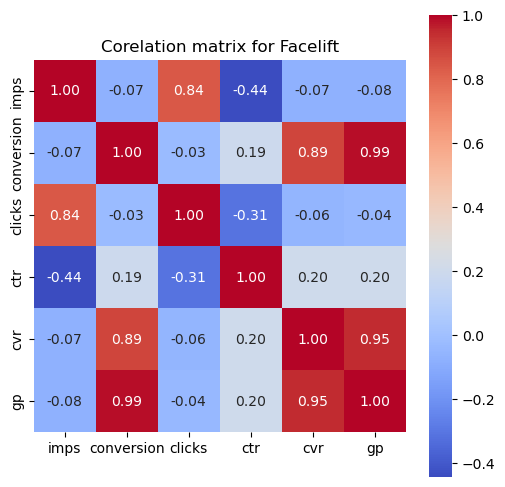

['tight face', 'pro thread', 'prf under eyes', 'pdo', 'pdo smooth threads', 'pdo  threads', 'pdo t', 'pdo thread', 'pdo threats', 'pdo threads', 'pdo threadlift', 'pdo threading', 'loose skin surgery', 'lift', 'neck lift non invasive', 'non surgical face lift', 'non surgical', 'mono threads', 'tighten skin', 'ultrassom face', 'ultherapy face and neck', 'tribella face', 'surgery', 'theads', 'threads', 'thread lifts', 'thread lift', 'thread', 'thernalift', 'thermage neck lift', 'thermage', 'tension threads', 'the glam squad', 'v-beam', 'sculpt spa', 'radiotherapy for face neck', 'rf slimming face', 'chin treatment', 'carbon facial', 'hands renew skin tightening', 'laser fit', 'jawline thread', 'jaw thread', 'jaw facelift', 'jet plasma', 'facelift', 'face tightening', 'face threading', 'face lift', 'eyelid surgery', 'fibroblast', 'foxy eye pdo', 'forma skin tightening']


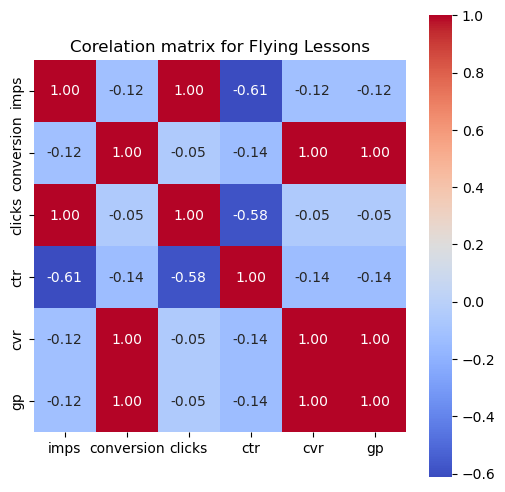

['anthelion', 'toddler fun', 'floral arrangement  classes', 'extreme flight simulation', 'fly']


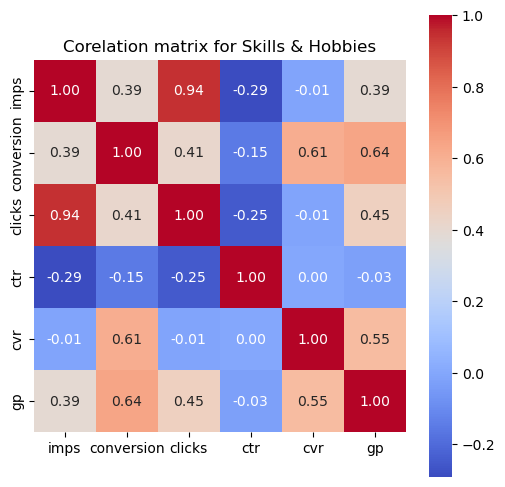

['art barro', 'pottery', 'cheers pablo', 'pottery class', 'pole class', 'paint and sip', 'painting', 'bartender', 'face painting', 'paint', 'painting with a twist', 'painting with wine', 'paint and pour', 'painting class for kids', 'paint party', 'paint night', 'paint n sip', 'paint class', 'paint and wine night', 'paint and vino', 'paint and twist', 'painting and drinking beer', 'painting class', 'oregon conceal weapons permit', 'paintnite', 'piano lessons', 'physical therapy', 'pottery class for two', 'pottery wheel clay', 'pottery wheel class', 'pottery wheel', 'pottery lessons', 'pottery date', 'pottery classes', 'photography lessons', 'photography course', 'photography class', 'massage spa near me for lee nj', 'massage back relief', 'level 99', 'license to carry', 'lincoln city', 'mixology class', 'mixology', 'minnesota cannabis', 'music', 'muse paint bar', 'motorcycle training', 'tips certification', 'toaster', 'trigger-point-massage', 'tufting class', 'twin cities carry', 'wine 

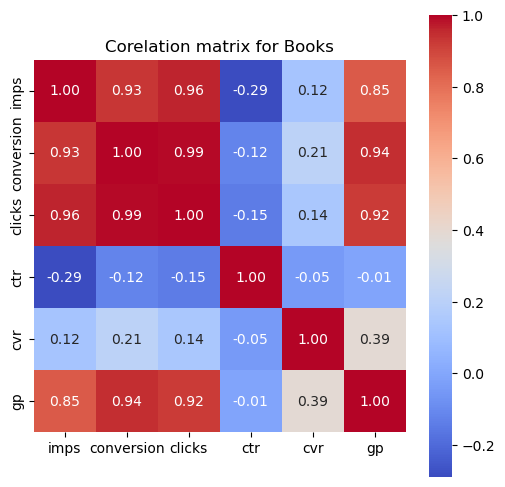

['shutterfly', 'microsoft office 2024 professional plus', 'photobooks', 'shutterfly book', 'hard cover photo book', 'photo book', 'shutter fly', 'printerpix', 'photo albums', 'photo books', 'photo books shutterfly', 'photobook', 'personalized book', 'office 2024 lifetime 2 users', 'office 2024 2 user', 'microsoft professional plus', 'microsoft office professional plus 2024', 'shutterfly 12x12 photo albums', 'shutterfly canvas', 'shutterfly photo book', '8x10 shutterfly books', 'abc mouse', '20 page photobooks printerpix', 'brakes plus']


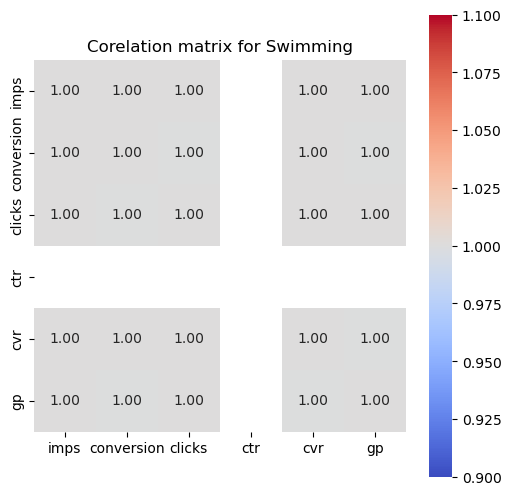

['aquatech', 'swim lessons', 'adult racing']


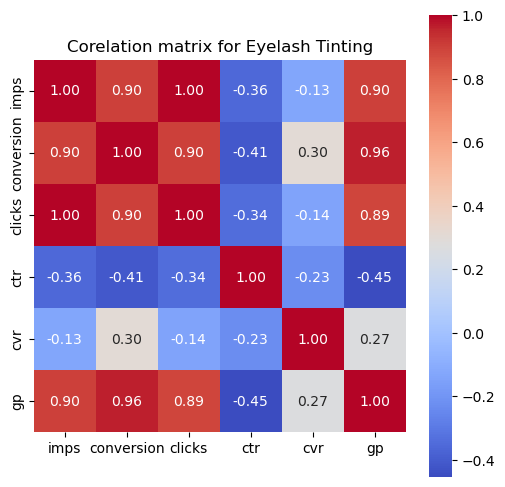

['lash lift', 'lash lift and tint', 'lash loft', 'eyelash tint and lift', 'celebrity lashes and makeup', 'laminate', 'last lift', 'lash tint and lift', 'lash tint', 'lash method', 'keratin lash lift', 'eye lash lift and tint']


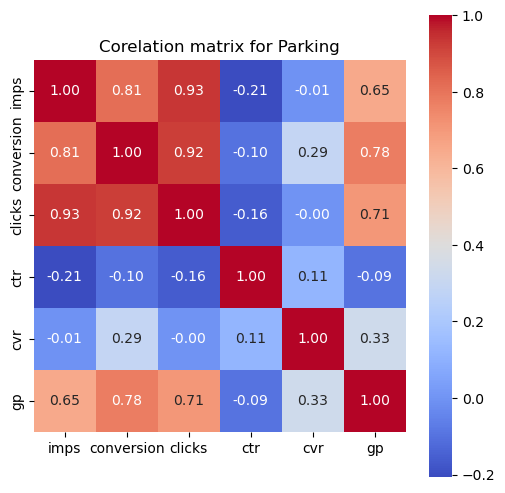

['park and jet philadelphia reservations', 'airport parking', 'parking', 'georgia aquarium', 'seatac parking', 'jfk parking', 'airport', 'hobby airport parking', 'park n go', 'masterpark', 'lax parking', 'peachy parking', 'parking at newark airport', 'peachy', 'parking lot new-york', 'extra car', 'bradley airport parking', 'masterpark lot b', 'seatac', 'parking spot', 'the parking spot', 'phl airport parking', 'ohare parking', 'phx parking', 'port of miami', 'park dia', 'park and fly', 'park and flight', 'park', 'park n fly', 'park spot', 'parking airport', 'parking seatac', 'parking penn', 'parking nyc east', 'parking garage near west 46th', 'parking dfw airport', 'parking cvg airport', 'parking bwi airport', 'parking at ewr', 'parking at bradley', 'parking at bdl', 'parking at atl', 'parking at airport', 'phl parking', 'phillip', 'masterpark c', 'master park', 'miami international airport parking', 'miami airport parking', 'long term parking fort lauderdale airport', 'long term parki

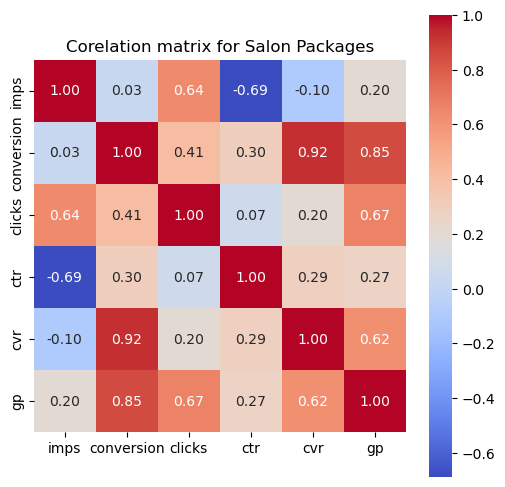

['shannon lee', 'xcellent', 'collectiv academy', 'under eyes', 'windflower spa', 'well feet spa', 'scalp spa costa mesa', 'relaxing facial', 'spa hair treatment', 'solaia', 'stretch mark', 'hyatt hill country spa', 'ink stretch mark removal', 'intimate bleaching', 'hesd spa', 'face and chin treatment']


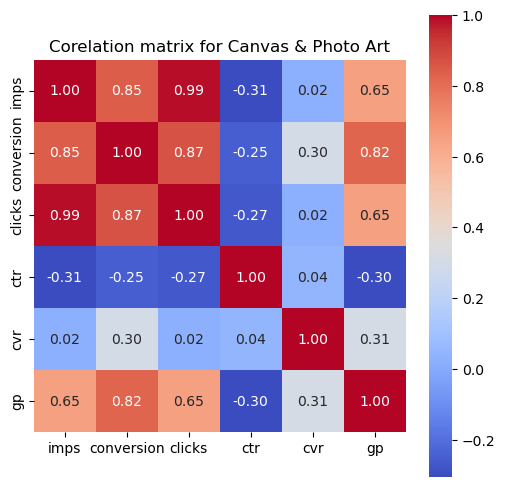

['canvas print', 'canvas', 'art', 'canvas prints', 'photo', 'photo canvas', 'canvas 30x40', 'metal prints', 'canvas p', 'paint and sip columbia sc', 'paint protection', 'picture on metal', 'picture canva', 'print photos', 'poster prints', 'panoramic canvas print', 'photo prints', 'photo csnvas', 'personal trainor', 'metal print', 'shutterfly photos', 'smallwood frame', 'canvas 11x14', 'canvasonsale', 'canvas with shipping', 'canvas photos', 'canvas on sale', 'canvas on demand free ship', 'canvas on demand', 'canvas free shipping', 'canvas collage', 'canvas 9x12', 'cvs prints', 'custom. framing', 'custom wall art acrylic', 'custom wall art', 'custom', 'arcrilic nails', '16x61 canvas print', '35x45 metal print', '48x36', '4 16x20 canvas prints', '30x40 canvas', 'acrylic nails', 'acrylic print', 'large canvas', 'large canvas print', 'gallery-wrapped prints from simple canvas prints']


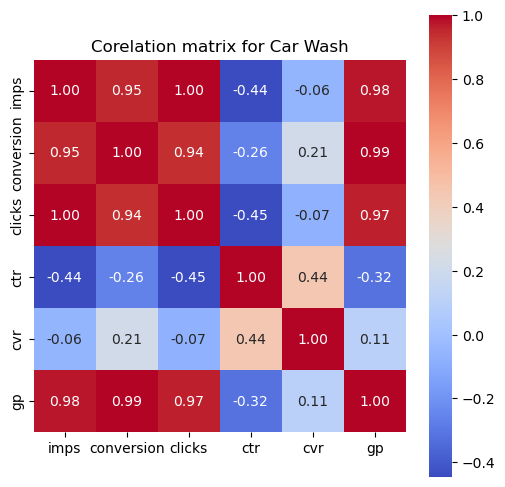

['car wash', 'bloomington car wash', 'mobile car detail', 'ziebart', 'clay bar car detail', 'carvwash', 'carwash', 'car wax', 'auto spa']


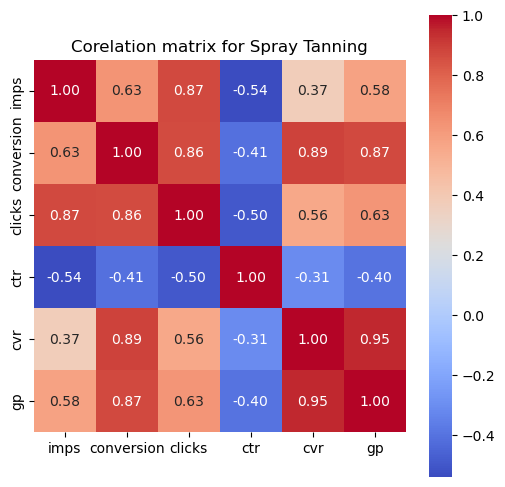

['tan', 'tanning', 'spray tan', 'tannn', 'tanning salon', 'tann', 'versa spray tan', 'spray tans', 'spray tanning']


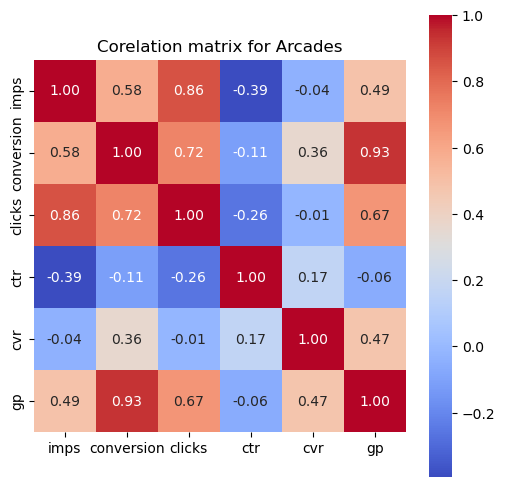

['chuck e cheese', 'bowlero', 'gametime', 'in the game', 'lucky strike', 'wonderverse', 'free play arcade', 'quarters', 'amf', 'arcade', 'kid activities', 'chuckecheese', 'stars and strkes', 'pinball', 'party for kids', 'parties', 'peter piper pizza', 'live nation', 'lucky snake arcade', 'the colony grandscape', 'vacaville', 'sandbox vr', 'sayville', 'rage rooms', 'stars and stripes', 'stars and strikes', 'skokie', 'chicago go karts fun arcade', 'cheese', 'chickecheese', 'ch', 'cicis pizza', 'churk e cheese', 'chucky e cheese', 'chucky cheese', 'chuckle cheese', 'chuckie cheese', 'chuck e. cheese', 'chuck e cheesee', 'chuck e cheese birthday', 'chuck', 'chuch e cheese', 'chuc', 'catch air', 'dave busters', 'dave and busters hauppauge', 'dave', 'amp up', 'amazing jakes', 'arcades', 'activity', 'activate games', 'bpwlero', 'bowling bowlero', 'bowlero timonium', 'bowlero fairlawn', 'bowlero centreville', 'bowlero bethesda', 'bowlero and wichita', 'bowlera', 'bow and arrow game', 'incredib

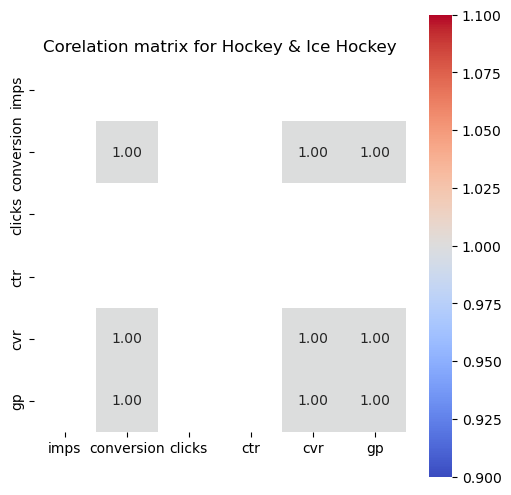

['chicago wolves', 'storage cube kids']


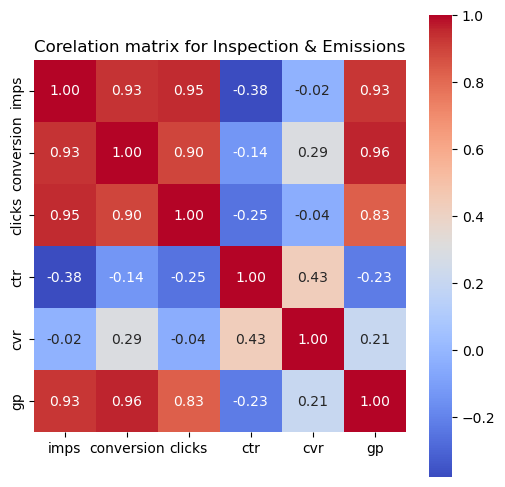

['smog', 'smog check', 'smog test', 'emissions', 'smog chrck', '7 day smog', 'car inspection', 'inspection and emmisions', 'emissions test', 'star smog check', 'star smog certificate', 'star smog', 'smog test 92008', 'inspection', 'emmissions', 'emiss']


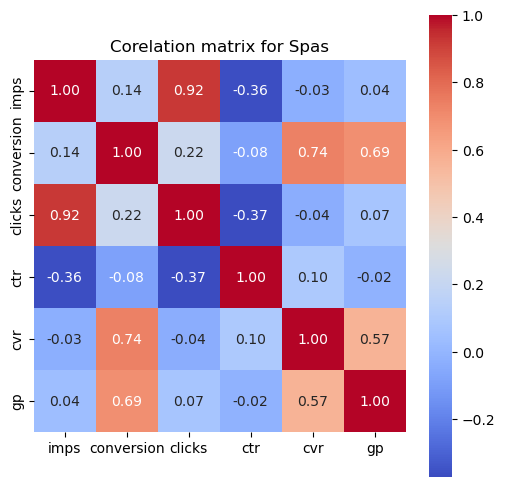

['carillon', 'kings spa', 'spa luxe', 'naples grand spa', 'hamam beldi', 'new york spa club', 'sante salt cave and healing spa', "men's massage", 'float', 'red light therapy', 'king soa', 'float spa', 'body scrub', 'korean spa', 'massage palace', 'gangnam spa', 'revitalize red light', 'pampering package', 'oxygen therapy', 'princess', 'prosperous paradise spa', 'pregnant massage\xa0', 'pearland', 'massagr', 'massage with facial', 'me', 'maui spa', 'massage and spa', 'massage and pedicures', 'massage and facial packages', 'massage luxe', 'massage lux', 'massage for couples', 'message luxe', 'medlife', 'meditation', 'medical spa', 'medical massage', 'light therapy', 'male spa', 'mani pedi massage', 'luxury spa', 'lux massage', 'lymphatic message', 'new day spa', 'new spa 7', 'nails and massage', 'nashville', 'naples spa', 'naperville', 'oceana', 'nomad', 'mild hyperbaric therapy', 'mom and daughter spa', 'mint wellness', 'mud wrap spa', 'my beauty spa', 'motor city float', 'trump spa', '

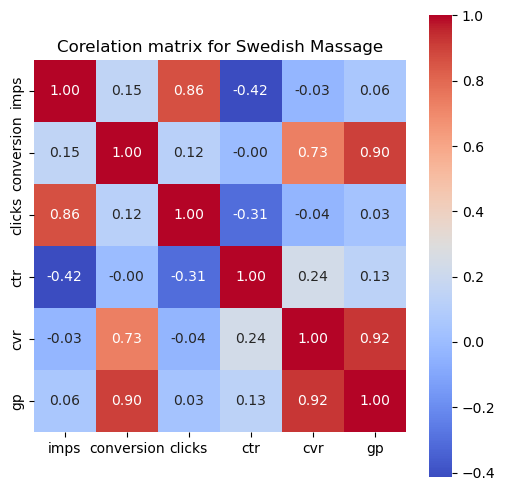

['tocasierra spa at hilton phoenix resort (7677 north 16th street, phoenix)', 'swedish massage', 'wave arts', 'prenatal massage', 'pregnant massage', 'masaje lonfatico', 'massage envy', 'massage monroeville', 'messa', 'lilac massage', 'murrieta hotsprings', 'touch of health', 'tire change', 'thai massage near me', 'zen massage', 'relaxing', 'reiki massage', 'sojo spa', 'spa day durham', 'spa body massages', 'cherry hill day spa', 'deep sweedish massage', 'deep massage', 'couples massage downtown houston', 'anew', '90-minute massage', '120 minute massage', '30 minutes massage', 'heavenly massage orland park', 'holistic bodyworks', 'la vita day spa', 'kume spa', 'jennifer day spa', 'facial massage for two', 'elements', 'go relax day spa', 'zz spa']


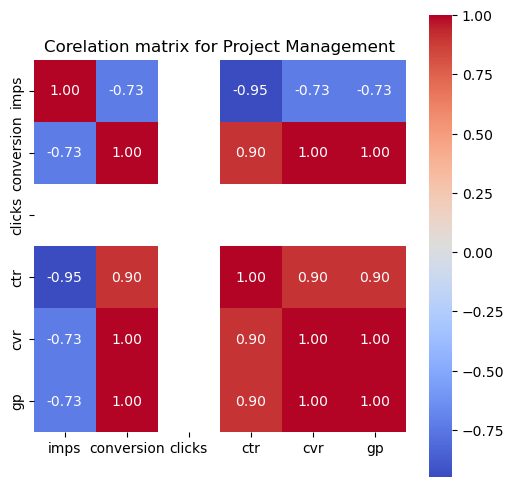

['msi black belt', 'scrum master', 'lean green', 'lean 6']


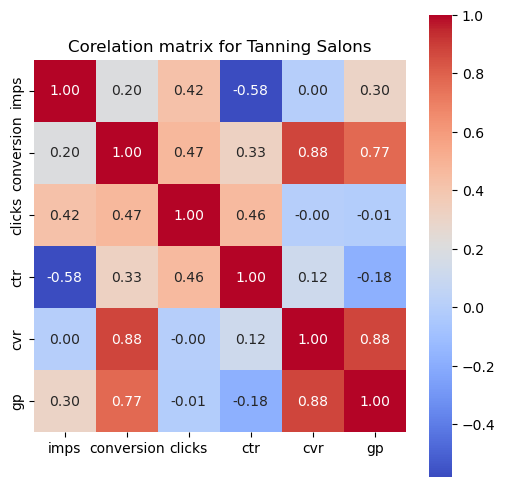

['tanning salon queens', 'sunless tan', 'sunseekers', 'sunny kisses', 'west palm beach', 'spray', 'airbrush spray tans sacramento']


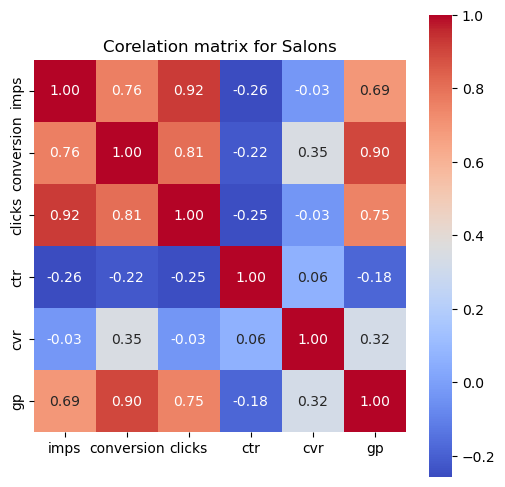

['head spa', 'nails', 'we scalp care', 'hair', 'highlights', 'pedi', 'pedicure', 'mani pedi', 'shortstack stylist', 'tanning salon queens', 'eyelash lift', 'head massage bensalem pa', 'spa hair', 'nail', 'beauty secret spa', 'scalp massage', 'hair salon', 'hair cut', 'janine nails', 'pedi and manicure', 'scalp', 'gilmore', 'root touch-ups', 'sunless tan', 'hair color', 'mani', 'hair salons', 'no chip manicure', 'salon deals', 'braids', 'gel manicure', 'sunseekers', 'gel pedicure', 'ombre hair', 'pampers', 'organic hair color', 'plano head spa', 'pompano beach hair blowout', 'professional gel nails', 'pediture', 'pedicures near me', 'pedicures', 'pedicure without nail polish', 'pedicure dallas', 'pedicure and manicure', 'pedicure 60645', 'pediccure', 'paraffin pedicure', 'partial highlights', 'partial high lights with haircut and blow', 'partial', 'pedícure', 'perm', 'massage and pedicure', 'massa spa', 'medi and pedi', 'mens hair coloring', 'medium knotless', 'medieval times arundel mi

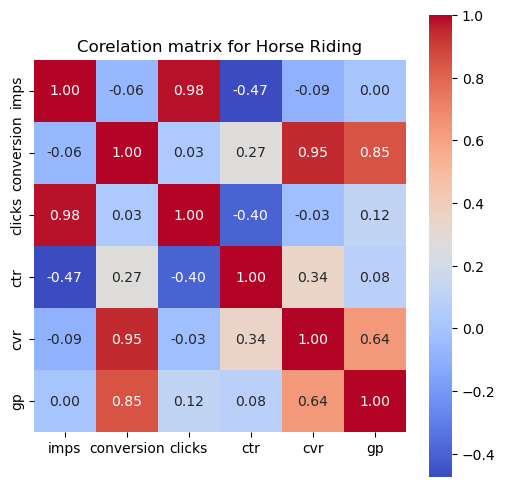

['horseback', 'tampa bay downs', 'trail rides', 'trail ride', 'scottsdale ari', 'ranch', 'activtues', 'horse riding lessons', 'horseback traill rides', 'horseback riding', 'horseback rides', 'horseback ride', 'horse riding', 'horse ride leasons', 'horse back riding', 'horse back ridinf', 'horse', 'equestrian', 'georgetown tx horseback riding']


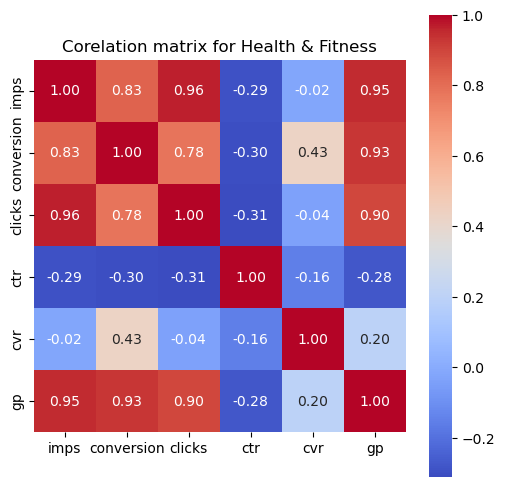

['yoga', 'online yoga', 'hyperbaric healing', 'centreofexcrllence', 'cpr', 'onlin cpr', 'online course', 'online juicing', 'masajes pies', 'mental health', 'taping certification', 'yoga online', 'puppy yoga', 'release yoga', 'simply fit', 'cpr/first aid  training gilbert, az', 'cpr classes', 'course work', 'ariel yoga', '1st aid course', 'aha bls', 'bls', 'basic life support', 'herb classes', 'learning', 'kids yoga']


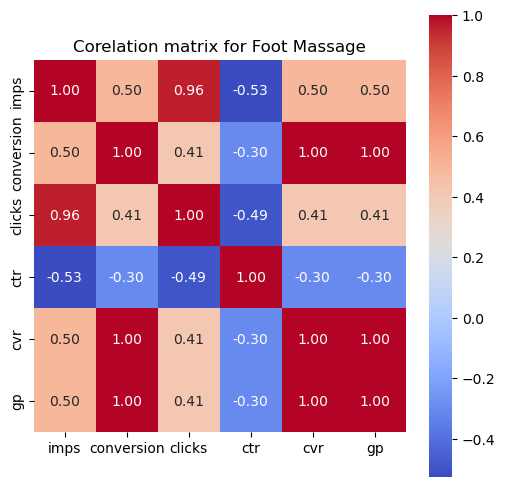

['reflexology', 'massages in reno, nv', 'tranquility', 'reflecology', 'couple rmt', 'couple pedicare', 'attiva', 'ionic foot bath', 'hot stone massage', 'jasmine tcm', 'foot reflexology', 'foot massage n. university drive', 'foot massage', 'foot and hand massage', 'foot', 'foot spa', 'gel manicure and foot spa']


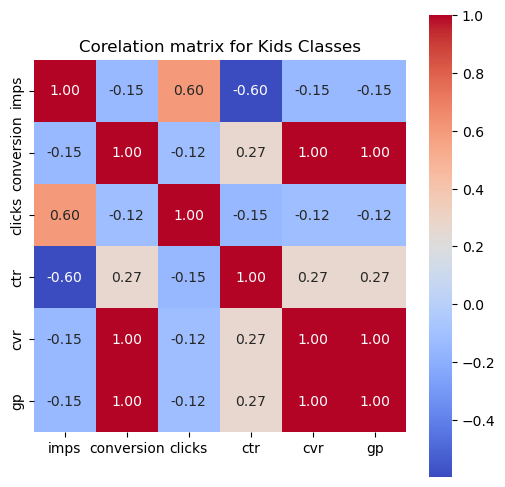

['parkour', 'paint kids', 'piano lesson', 'pottety', 'matt burke', 'lessons', 'voice lessons', 'cheap pottery', 'aim martial arts', 'baby classes', 'kid dance', 'kids martial arts', 'karate classes', 'guitar lessons', 'for kids']


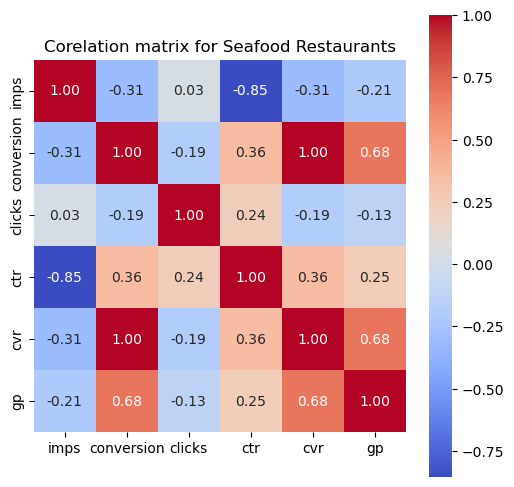

['oceanique', 'fairgrounds hotel resturant allentown pa', 'margaritas', 'sea food', 'sea bar restaurant', 'soul food', 'comedy branson', 'all u can eat seafood restaurants', 'festival']


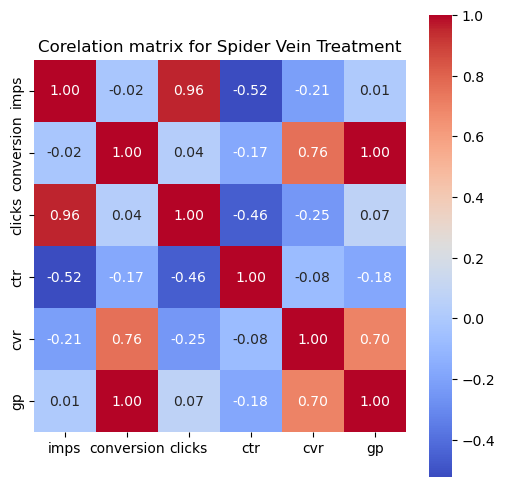

['vein', 'vein clinic', 'yag laser spider', 'veins', 'sclerotherapy injections', 'sclerotherapy', 'schelotherapy', 'spider vein', 'jiva']


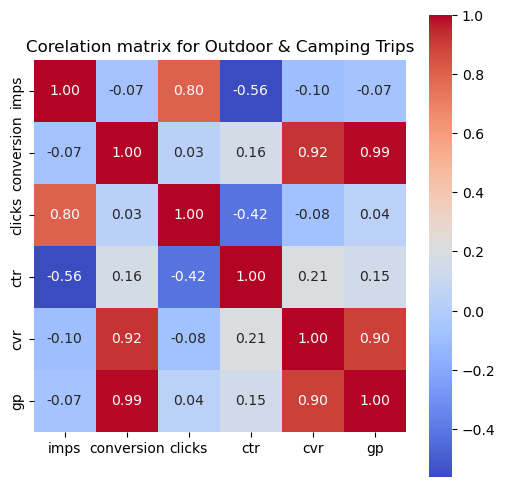

['the georgian court hotel', 'sheraton', 'travelodge niagara falls', 'palm springs hotel', 'poconos ski resorts fishing', 'poconos cabin', 'pocono', 'pigeon fforge', 'paradise steeam', 'michigan lake', 'loon mountain', 'lodge', 'loveland ski', 'nia', 'niagra', 'treetops', 'tree tops resort', 'trips with airfare', 'the glen house', 'yosemite view lodge', 'west mountian', 'reno nugget', 'reno', 'steele hill', 'show boat hotel', 'snow tube', 'snow summit', 'ski lessons', 'denver', 'colorado springs', 'cove haven', 'couples retreat', 'all inclusive hotel arizona', 'blue ridge', 'hotel outdoor', 'hotel pet friendly', 'hotel rochester h', 'hotel zoso', 'la quinta', 'leavenworth wa', 'jets pizza', 'grand sierra', 'getaway with airfare from dfw', 'getaway']


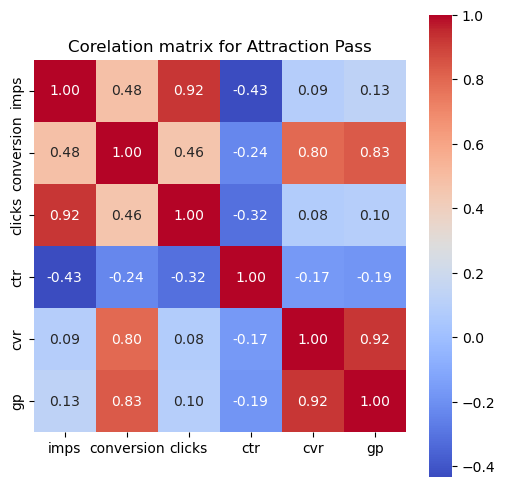

['pogo pass', 'go city las vegas', 'pass', 'city pass', 'high roller', 'palm beach zoo', 'orlando eye', 'other world', 'orlando flex sightseeing pass', 'pogo', 'polynesian', 'pogo pass dallas', 'pearl harbour', 'philadelphia zoo', 'philadelphia and subburbs', 'los angeles pass', 'new york city attractions', 'top view discover pass', 'universal studios hollywood', 'trolly', 'wing over washington', 'willis tower skydeck', 'yearly passed to several attractions', 'zoo miami', 'wonderworks', 'san francisco hop pass', 'safari park', 'san fransisco', 'sea life aquarium orlando', 'seaquarium', 'rise ny', 'rise', 'southern az attractions alliance', 'shedd aquarium', 'shedd', 'skydeck', 'chicago aquarium', "chief's luau admission", 'children’s museum', 'citypass', 'city go', 'california pass', 'bumper bowling', 'day pass', 'dallas aquarium', 'dallas world aquarium', 'connect pass', 'aqua pass', 'attraction pass', 'attraction', '3 things', 'adventure aquarium', 'icon park', 'houston city pass', '

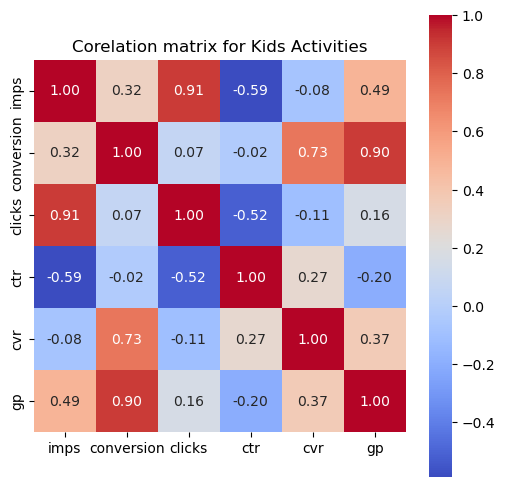

['birthday', 'doodle', 'party', 'ninja kids', 'slime', 'cheap fun stuff kids', 'cooking kids', 'activities teen', 'birthday party', 'birthday party for toddlers', 'birthdayparty', 'birthday party packages', 'birthday party package', 'late mother daughter activities', 'kid birthday', 'kids birthday parties', 'kids birthday party', 'kids parties', 'kids spa', 'kids painting', 'flippos']


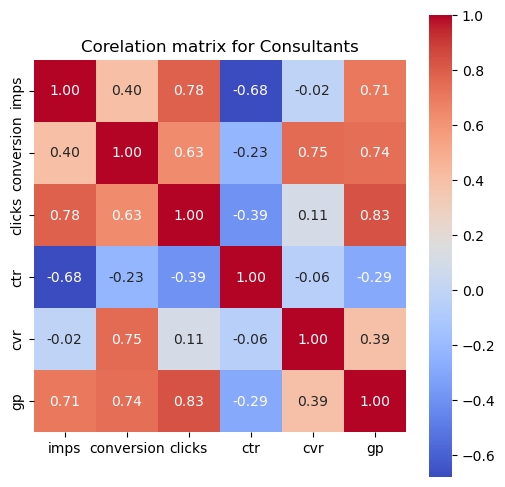

['ancestry', 'ancestry dna', 'will', 'legal wills', 'phychic', 'oracle', 'past and the future that', 'notary public', 'notary', 'murrieta', 'tarot', 'will maker software', 'webpage design', 'webpage', 'psy', 'psychic', 'dna test', 'costo renewal membership', 'colour iq', 'astrologer', '3 person', 'brake pad services', 'headway', 'get aways']


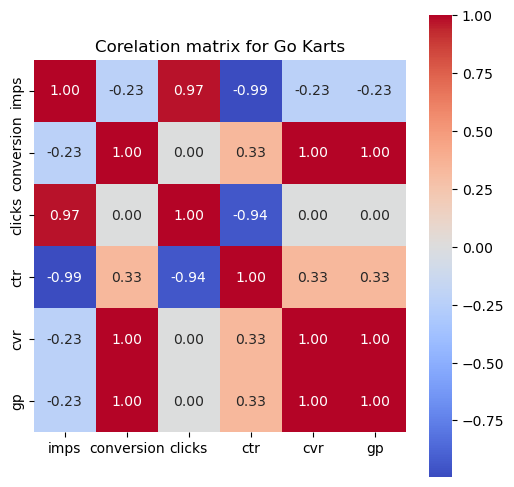

['buggy', 'sunbuggy', 'sky rise restraunt', 'dune buggy']


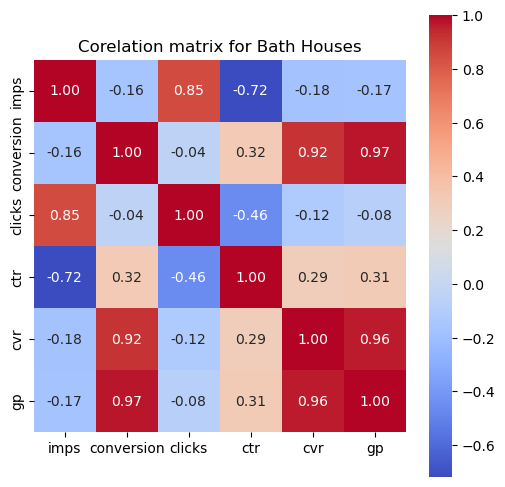

['king spa for two', 'couples spa with sauna', 'kingspa', 'mud bath', 'the fountain spa', 'yoni steam', 'scalp  spa', 'spa sauna', 'spa whitestone queens', 'soju spa', 'spa day pool', 'spa castle college pt ny', 'bathhouse', 'bath house', 'bath', 'island spa and sauna', 'island spa', 'kings spa nj', 'king spa new jersey', 'king sauna', 'king', 'korea', 'esteem med spa']


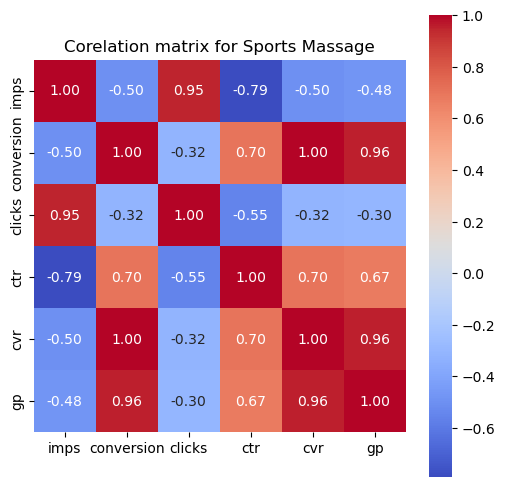

['stretch massage', 'regen medical', 'paris massage', 'sacred hour massage', 'sports therapy', 'claire']


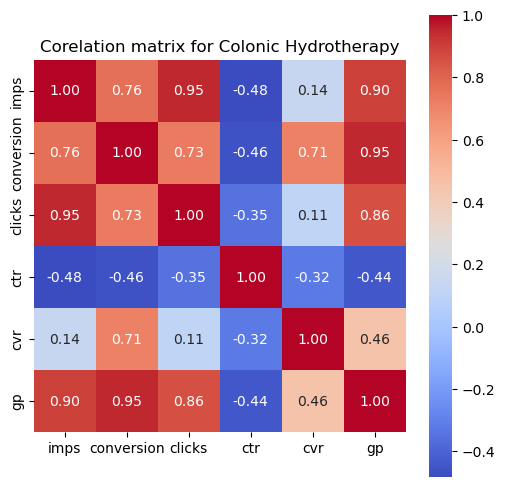

['colonic', 'colon', 'hydrotherapy', 'professional colon cleanse', 'nirvana', 'colon cle', 'colon cleansing', 'colón cleanse', 'colonics', 'colon hydrotherapy session', 'colon hydrotherapy', 'colon clense', 'baltimore colonic', 'hydro therapy']


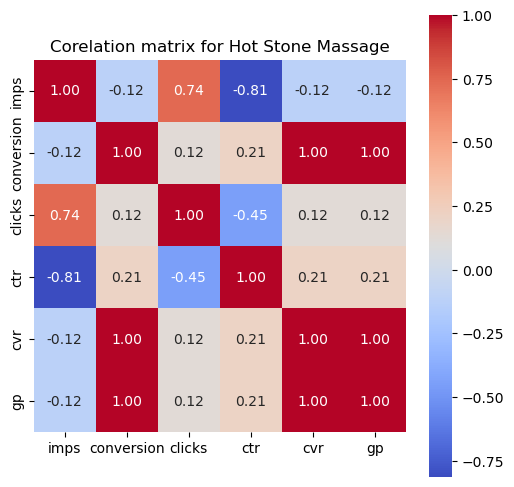

['fa fa foot spa', 'massage deep tissue myofacial release', 'mass', 'massage deal deal for', 'lux foot spa', 'maddage', 'mosa spa', 'versailles', 'romantic picnic', 'spa in queens', 'stone massage', 'seven day foot spa', 'china liangtse wellness', "annie's massage", 'apple therapy', '90 minute couples massage', '86 bowery spa', 'hot stone', 'epidermal']


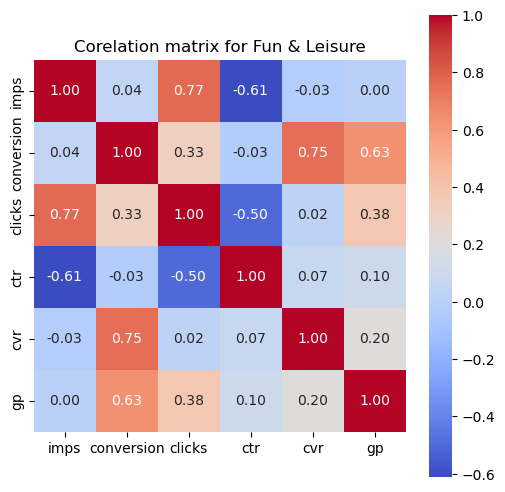

['spartan', 'candle', 'healthy cooking classes', 'priority pass', 'party packages', 'lol', 'make your own perfume', 'lounge', 'nuvo olive oil', 'ninja warrior', 'mosaic', 'tough mudder', 'tarpon', 'wine class', 'workshop', 'vr', 'rug making', 'race track', 'revolution adventure', 'spartan race charlotte', 'spartan race', 'collarbratory', 'candles', 'candlemaking', 'candle making atlanta', 'candle making', 'business lounge', 'date new orleans', 'dance party', 'create me pottery', 'craft your own bong', 'atlanta airport lounge', 'arundal mills', 'aaa membership', 'airport lounge pass', 'adventure to adult', 'blumoon', 'blacksmith', 'house of immersions', 'honey', 'lansdale pa', 'escape lounge', 'ground zero new york', 'fun for teens', 'gem mining']


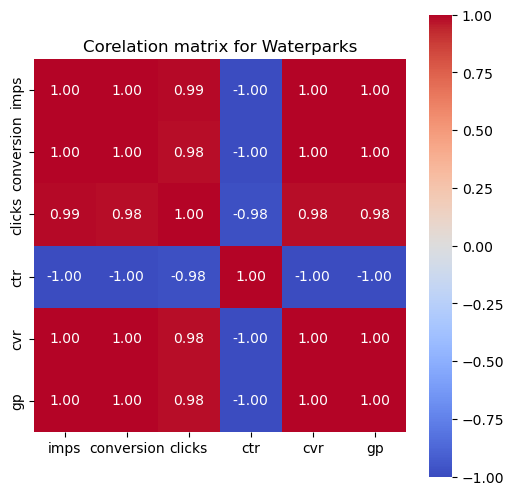

['six flags', 'six flags ny', 'edventure', 'great escape lodge', 'great escape']


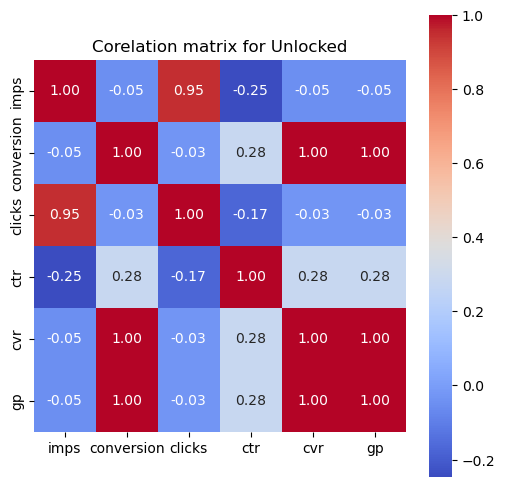

['iphone 13 pro max', 'phones', 'phone', 'unlocked phones', 'unlocked iphone 12', 'verizon phones', 'samsung galaxy a55 5g unlocked phone', 'samsung galaxy a55 5g', 'refurbished iphone', 'cellphones', 'comic', 'android tv', 'apple phones', 'apple iphone mini 512gb', 'apple iphone mini 1tb', 'apple iphone 512gb', 'apple iphone 1tb mini', 'apple iphone 1tb', 'apple iphone 14', 'apple', 'b well', 'ihpone 13 pro 512gb a grade', 'iphones', 'iphone14', 'iphone unlocked', 'iphone se', 'iphone screen repair', 'iphone 15', 'iphone 14 pro', 'iphone 14', 'iphone 13 pro unlocked', 'iphone 13 mini', 'iphone 13 512gb', 'iphone 13', 'iphone 12', 'iphone', 'iphine', 'google pixel', 'galaxy']


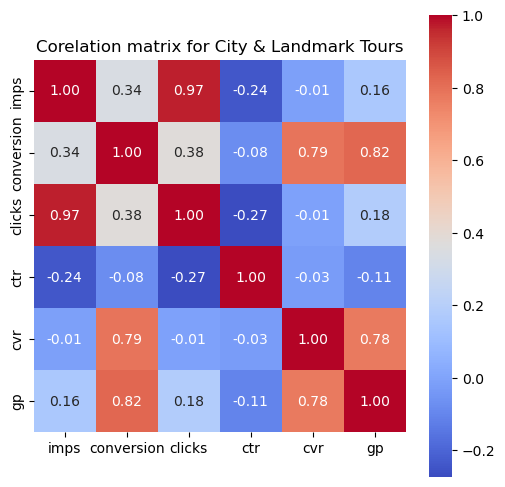

['nyc hop-on', 'food tour', 'bus tour', 'new orleans premier ghost, voodoo', 'color factory', 'tour', 'tombstone', 'destrehan museum', 'one world', 'palm springs tramway', 'pacific science center', 'playground', 'pirate cove', 'portland spirit', 'pedicabs', 'pedicab', 'pearl harbor full day tour with lunch', 'pearl harbor', 'pearl haboir', 'pearl', 'peal herber yckey', 'mauna kea', 'maui', 'little italy', 'liberty science center', 'neon sign museum', 'neon', 'new orlean scavenger hunt', 'new york hop on hop off', 'new york activities', 'new rock city', 'natural history museum', 'napa valley wine trolley classic tour', 'oahu tours', 'observatory', 'niagara falls tour', 'milwaukee art museum', 'millennium tour', 'museum of modern art', 'mountain bikin', 'tour company', 'topview nigh', 'top view 48 hour', 'times square', 'top of the world', 'tea around town', 'tasting', 'thing to do', 'thermage flx', 'texas wino', 'witches brew', 'wine tasting tour', 'wine train', 'wynwood food tour', 'we

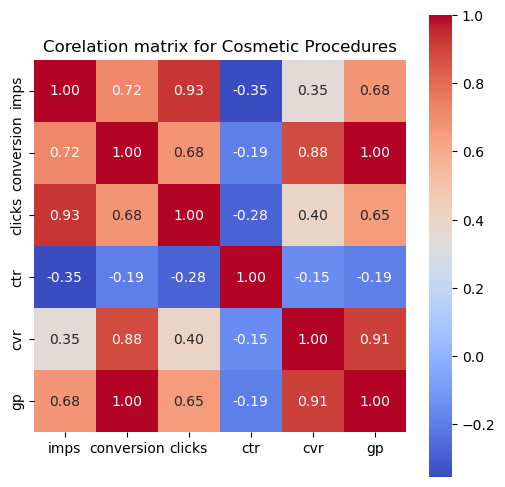

['butt', 'skin tightening', 'oligio', 'profound rf', 'liquid lift in georgia', 'neck lift', 'nonsurgical butt lift', 'non surgical butt', 'non invasive but lift', 'non -surgical butt lift with bonus laser lipo session at turkish esthetic center  up to 77% off', 'microneedling radio', 'morpheous 8', 'morpheus 8', 'morpheus 8 face and neck skin tightening treatment', 'morpheus8 rf microneedling treatment in nyc', 'treatments', 'wood sculpting', 'vacuum butt lift', 'vacuum', 'scarlet srf', 'radiofrequemcy', 'radio frequency skin tightening', 'radio frequency assisted lipolysis', 'radio frequency', 'rf lifting', 'rf', 'skinovatio', 'skin tightening session', 'skin tighten', 'butt radiesse', 'c02 laser', 'butt lift', 'butt cupping', 'day spas near me', 'aspiring laser', 'agnes rf', 'beauty fix medspa', 'beauty factory', 'bella medspa', 'hush aesthetics', 'jowls', 'jawline lift', 'fat dissolver', 'fibroblast skin tightening', 'emface', 'frazional laser']


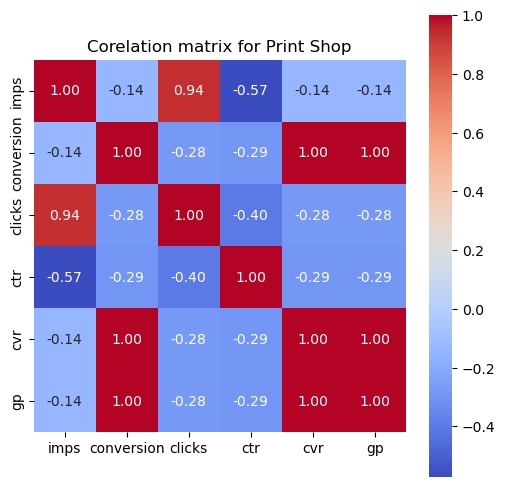

['legacybox film transfer', 'photo download', 'legacybox', 'legacy', 'video transfer', 'shutterfy', '$7.00 file transfer']


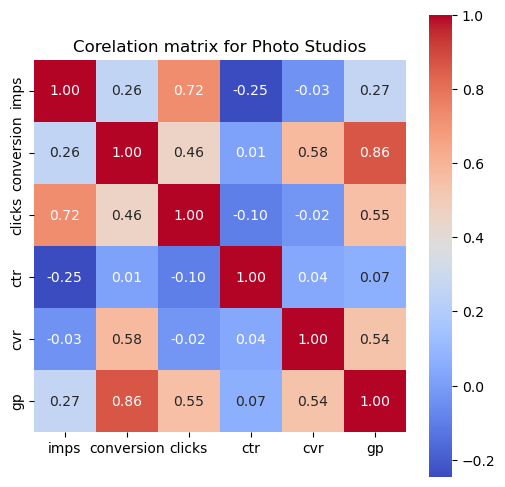

['boudoir', 'jc penny photo', 'studio primetime', 'jc penny portraits', 'jcpenney portrait', 'jcpennny', 'photography', 'jcpenney', 'maternity photo', 'jcpenny', 'jcpenney portraita', 'photography shoot packages', 'picture people', 'picture', 'pineville', 'professional headshot', 'portrait jcpenney', 'potraits', 'potrait', 'portraits', 'portrait photography', 'portrait jcpeney', 'portrait jcepney', 'portrait', 'photoshoot', 'photography hea', 'photographers', 'photographer', 'photo shoot', 'photo sessions', 'photo session', 'photo se', 'photo headshots', 'pet photography', 'maternity photography', 'maternity photos', 'maternity photoshoot', 'maternity shoot', 'lofetouch', 'lifetouch', 'new born photographer', 'newborn photos', 'newborn photography', 'newborn photo', 'san diego ink studio', 'senior portrait', 'senior photography', 'budoir', 'dogen photography', 'cop portraits', '12426 maybrook ave whittier ca', 'boudoir photography', 'boudoir photo shoot', 'belladonna', 'infant photogra

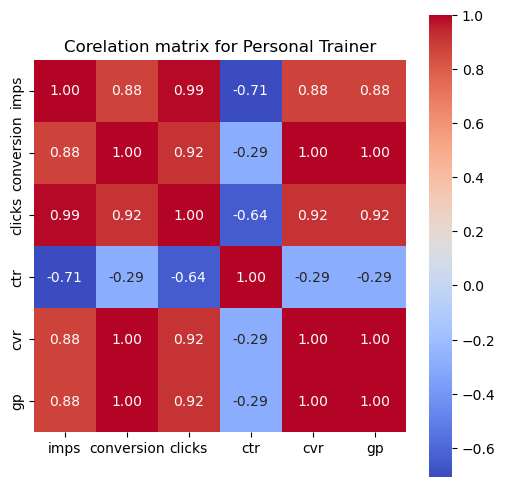

['personal trainer', 'personal training', 'trainer', 'the strength code', 'gym trainer']


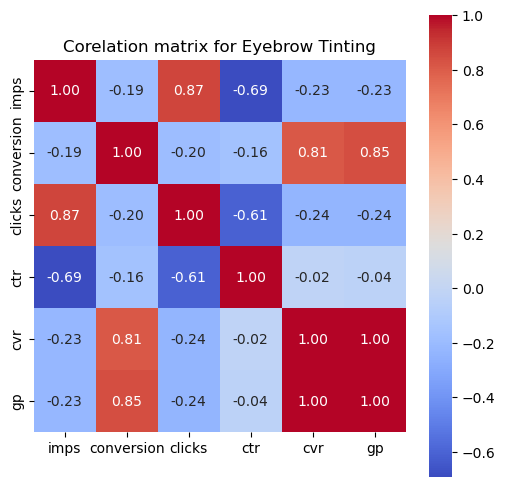

['brow lamimation', 'brow tinting', 'microblading brows', 'brows lamination', 'brow lamination', 'beauty brow oc', "it doesn't need to", 'laminating', 'lash and brow lamination', 'eyebrow lamination', 'eyebrow', 'eyebrow tinting', 'eyebrow tint']


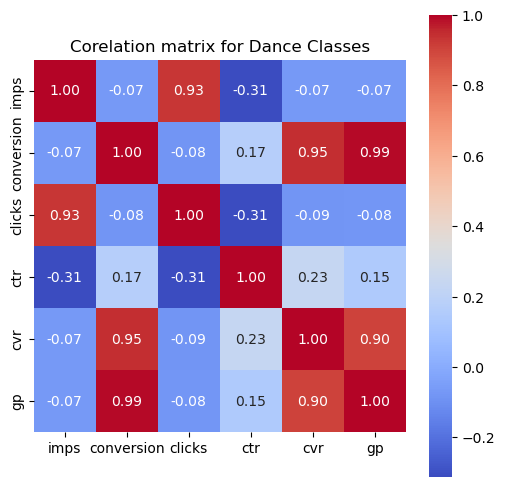

['pole dancing classes', 'wedding dance classes', 'pole dance', 'private salsa classes', 'potterry clases', 'tango lessons', 'tango', 'wedding lessons', 'wedding lessongs', 'salsa kings', 'salsa dancing', 'salsa dance lessons', 'salsa classes', 'salsa class', 'salsa', 'spanish lesson', 'class dance', 'carmel', 'casino dancin', 'dancing with sylvia', 'dancing class', 'dancing', 'dance lessons', 'dance classes', 'dance', 'couples dance class', 'bachata', 'ballroom dance', 'humor', 'latin dance', 'fitness clasd', 'exotic dance class', 'group dance class', 'fred astaire', 'for couple']


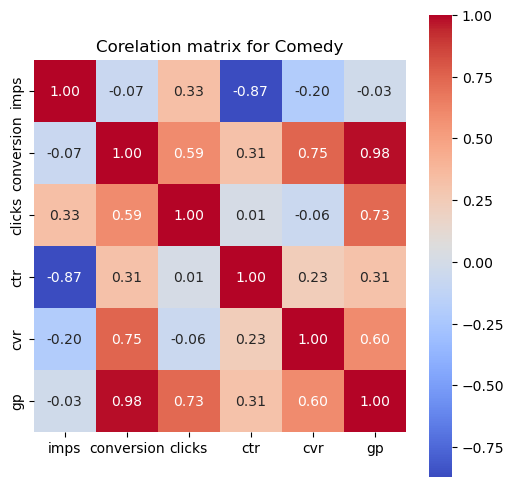

['drunk shakespeare', 'comedy show midtown new york', 'plays in chicago area', 'ny comedy', 'comedy show', 'comedy club', 'atlantic city comedy club', 'laugh factory', 'drunk shakesphere', 'groupon live']


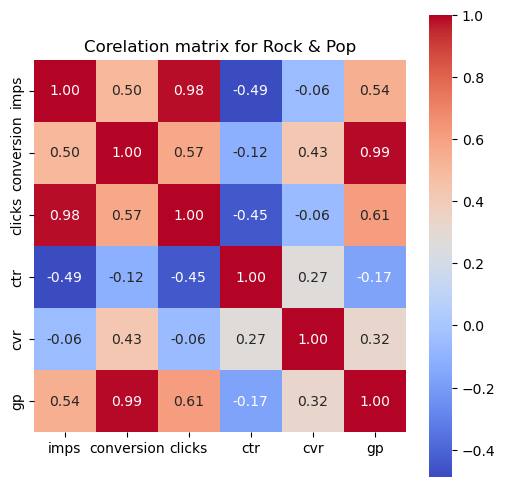

['concerts', 'styx', 'the brotherhood camden', 'papa roach', 'papa', 'live theater and concerts', 'nightlife', 'unforgettable fire paramount', 'tickets to disneys owrld', 'ticket center', 'westbury music fair', 'riverbend toto concert tickets', 'rise against', 'collective soul', 'cincinnati concerts', 'concertsts', 'concert ticket', 'concert', 'billy joel concert', 'indoor rock climb']


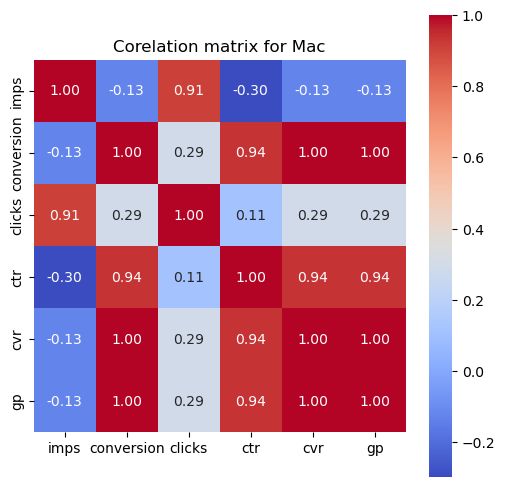

['macbook', 'production computer', 'macbook pro', 'macbook air', 'laptop']


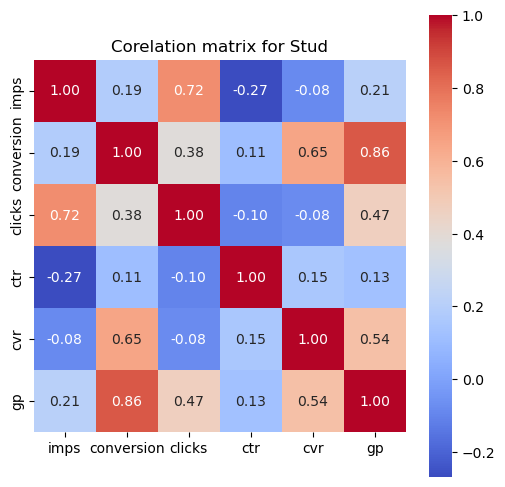

['boudoir', 'moissanite', 'jc penny photo', 'studio primetime', 'jc penny portraits', 'jcpenney portrait', 'jcpennny', 'photography', 'jcpenney', 'maternity photo', 'jcpenny', 'jcpenney portraita', 'photography shoot packages', 'jelwery', 'alex earrings', 'diamond stud earrings', 'swiss valley', 'picture people', 'picture', 'pineville', 'professional headshot', 'portrait jcpenney', 'potraits', 'potrait', 'portraits', 'portrait photography', 'portrait jcpeney', 'portrait jcepney', 'portrait', 'photoshoot', 'photography hea', 'photographers', 'photographer', 'photo shoot', 'photo sessions', 'photo session', 'photo se', 'photo headshots', 'pet photography', 'maternity photography', 'maternity photos', 'maternity photoshoot', 'maternity shoot', 'mary j blidge', 'lofetouch', 'lesbian earrings', 'lifetouch', 'new born photographer', 'newborn photos', 'newborn photography', 'newborn photo', 'tahitian pearl', 'swaroski earrings', 'san diego ink studio', 'sterling silver studs', 'stud earings',

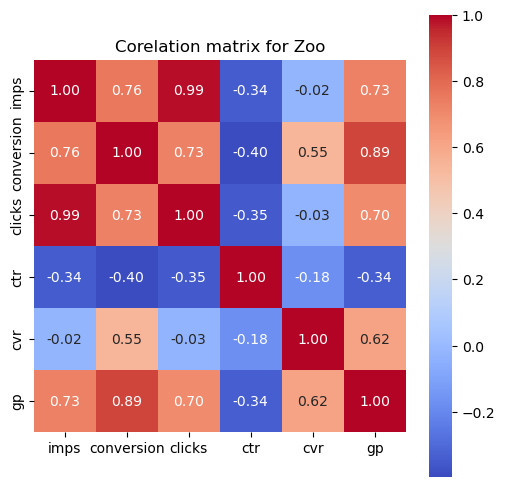

['zoo', 'animal', 'wild florida', 'san antonio zoo', 'phoenix zoo', 'phoenix soo', 'lichifield', 'near by zoo', 'nature', 'museum of discovery', 'monkey sanctuary', 'to do', 'wildlife zoo', 'wildlife world zoo', 'wildlife safari', 'zoo jacksonville fl', 'safaripark', 'sb zoo', 'single activities', 'sloth zoo', 'central florida zoo', 'bronx zoo', 'animal  kingdom', 'aquariums', 'brevard zoo', 'indianapolis zoo', 'fishing tours', 'everglades tour', 'graceland ticket tours', 'for two', 'gator']


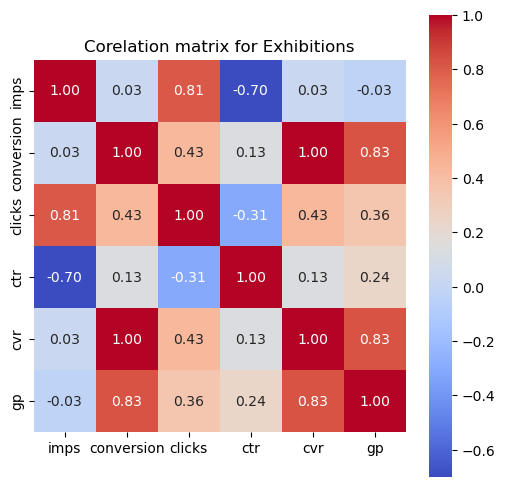

['comic-con', 'home show', 'mandalay', 'luxor', 'verse', 'real bodies', 'shark reef vegas', 'central florida comic con', "discovering king tut's tomb", 'comic con', 'comicon', 'bodies', 'ice bar', 'home show fairgrounds']


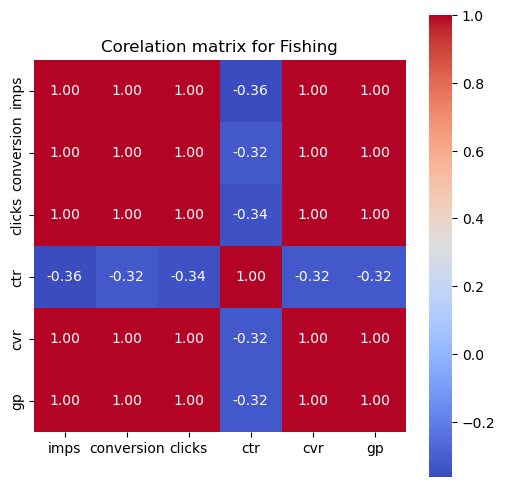

['fishing', 'outdoors', 'newport fishing', 'oahu fishing trip', 'pure florida', 'charter fishing', 'deep sea fishing', 'daveys locker', 'couples activities', 'apollo beach fishing charter', 'fishing salt water', 'fishing charter', 'fish guide', 'fly fishing']


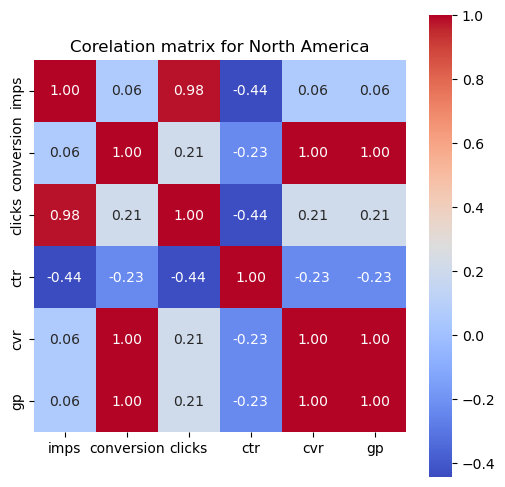

['flight', 'on off bus', 'plane ticket to hawaii', 'vacation packages with airfare', 'deals', 'dates', 'big bus tours', 'inclusive with air', 'hawi', 'hawaii', 'flights', 'europe vacation', 'gocity']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



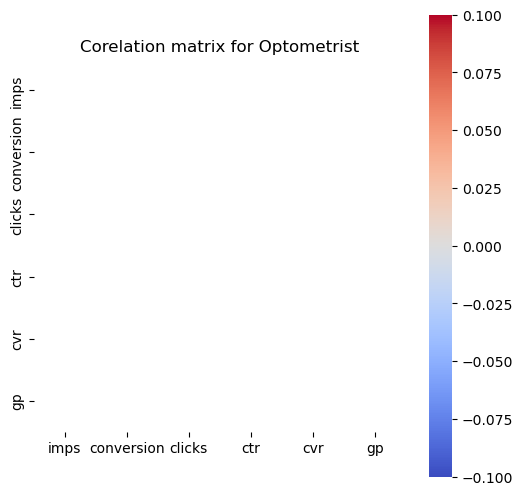

['vision exam']


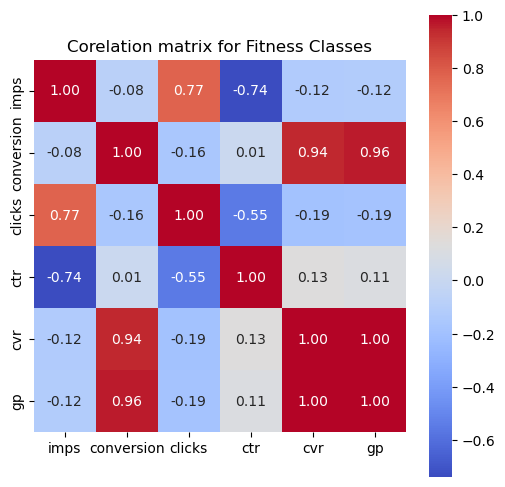

['air aerial fitness', 'pure barre', 'pole dancing', 'pole classes', 'pole', 'wedding dance', 'romance and dance', 'single adult gymnastics', 'sexy pole dance', 'dance class', 'ariel class', 'affordable adult gymnastics class', 'aerial yoga', 'aerial class', 'aerial', 'aer', 'adult dance', 'adult gymnastics', 'barre', 'ballet']


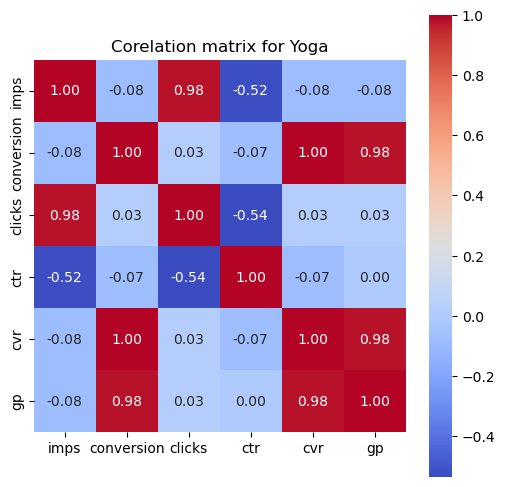

['veda yoga', 'modern yoga', 'pilates class', 'yogo', 'yoga near fontana', 'zenya', 'ra yoga', 'spin classes', 'shelton', 'annapolis power yoga', 'aerial silks', 'i am limitless', 'hot yoga carlsbad ca', 'hot yoga', 'exercise classes']


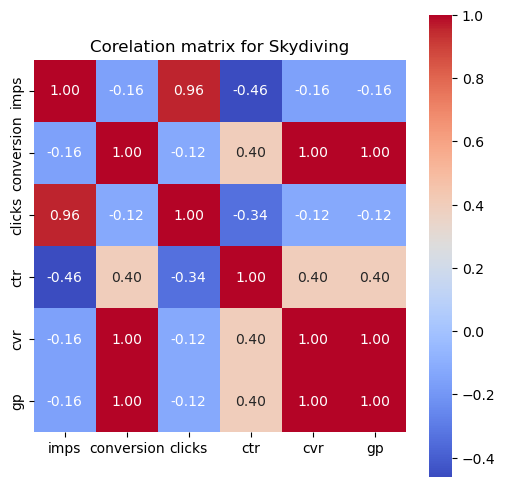

['oceanside skyjump', 'peris skydiving', 'skydriving', 'skydiving', 'skydive', 'skidiving', 'cincinnati zoo', 'air balloon', 'ifly westchester', 'ifly', 'i fly', 'indoor skydive', 'indoor skydiving', 'high speed carting']


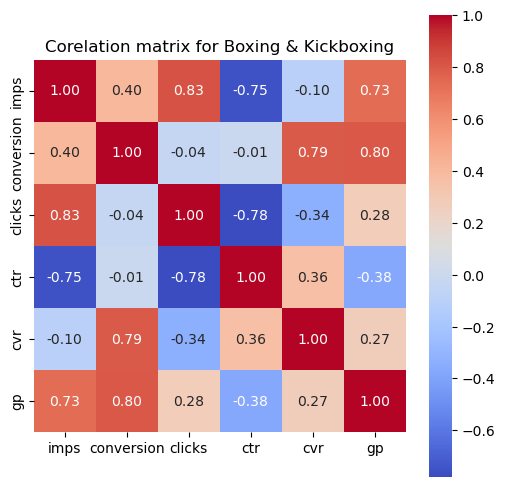

['boxing', 'inner warrior', 'cko', 'brooklyn martial arts', 'kickboxing in bronx', 'kickboxing', 'fitness class', 'gym huntington beach']


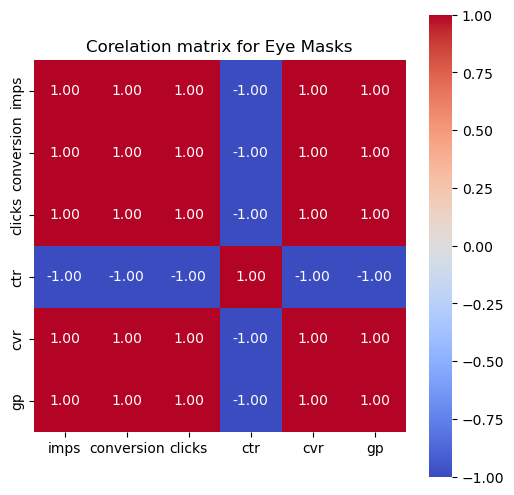

['undereye treatment', 'tens pads']


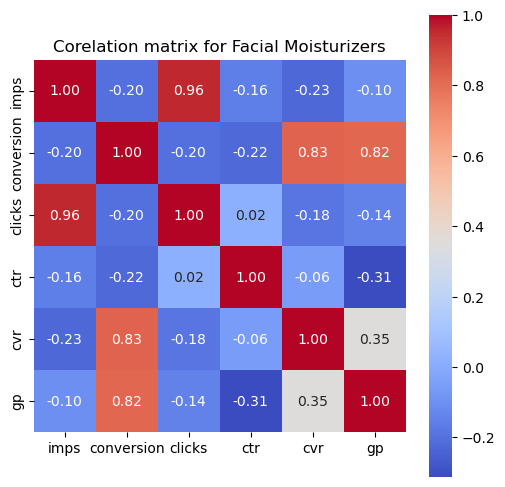

['facial with extractions', 'stone crop', 'obagi', 'microsculpting', 'mousturizer', 'tretinol cream', 'skin cream', 'all', 'biodance']


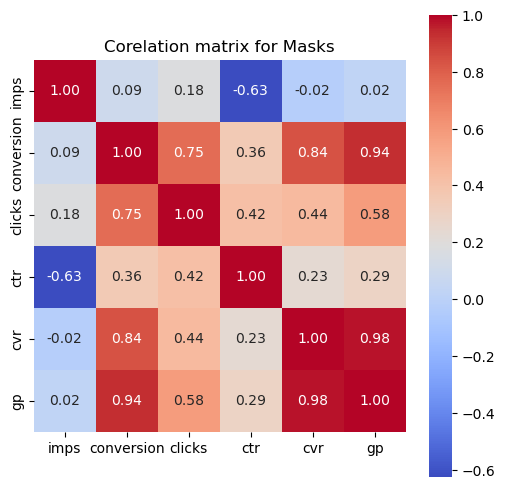

['undereye treatment', 'k18', 'peter thomas roth face tightener', 'unite hair products', 'tens pads', 'sheet mask', 'davines', 'k1', 'facial masks', 'facial mask']


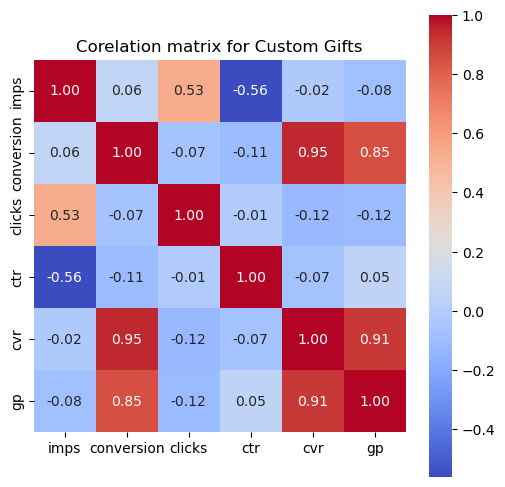

['build a head', 'custom head cutout on a stick', 'shutterfly calendar', 'cardboard cutouts', 'calendar', 'photoaffections', 'photo calendars', 'personalized', 'personalization mall', 'person underwear', 'lego land', 'nobility titles', 'mommy son date', 'murder', 'moving service', 'murder mystery dinner', 'trash can', 'title', 'sybaris', 'tianyu', 'tennis', 'wood theraphy', 'valentines packag', "valentine's gift", 'retirement gifts', 'shutterfly desk calendar', 'shutterlfy', 'children', 'celtic axe throwing', 'calender', 'custom phone docking station with engraving options available', 'custom calendar', 'couples deals', '3d', 'bobbleheads', 'big head', 'head shots', 'head cutouts', 'land', 'justyling', 'japanese garden', 'keychains', 'fat head']


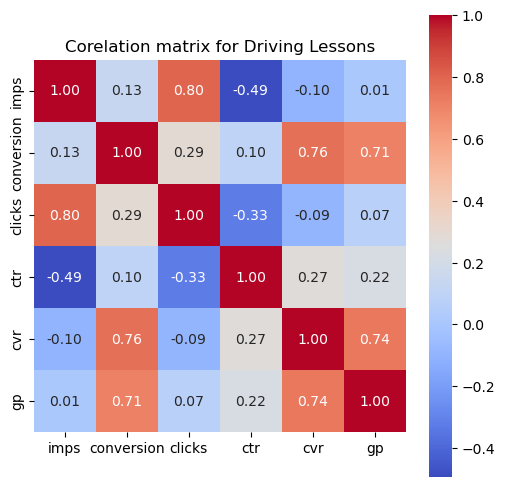

['5 hour course', 'ohio drivers ed classes from aceable', 'driving ed', 'drivers ed direct', 'drivers training', 'mycaliforniapermit', 'drivers ed', 'traffic school', 'drivers education', 'online drivers ed', 'online driver’s education', 'online permit', 'maryland driving leaner permit', 'license', 'motorcycle classes', 'texas coalition', 'safeway', 'student driver', 'ca driving license practice test', 'ca driver ed', 'defensive driving course for lower insurance', 'defensive driving course', 'defensive driving', 'defensive', 'course for adult refresher driving', '5 hour class', '5 hour pre-license', '5 hour driving license', '5 hour driving class', 'behind the wheel training', 'behind the wheel drivers training', 'best way driving school', 'learner permit course', 'jackson ca', 'driving test', 'driving school', 'driving permit test', 'driving lessons', 'driving instructor', 'driving ed course', 'driving classes', 'driving', 'driver’s ed', 'driver’s behind the wheel', 'drivers school',

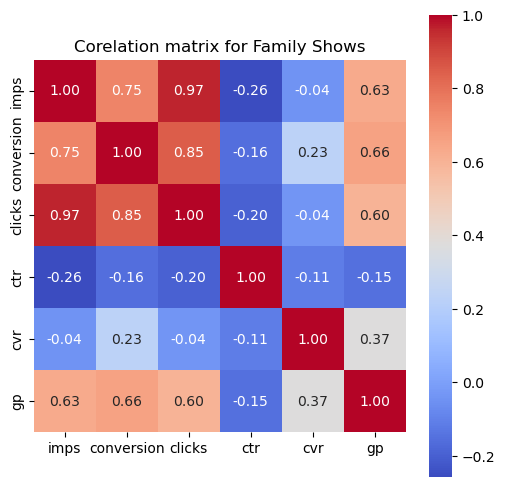

['regal', 'movies', 'shows', 'group movie tickets', 'moonstruck', 'williamsburg movie', 'amc', 'dominos', 'movie', 'movie tickets', 'amc gift card', 'regal moorestown', 'dine in movie', 'movie tavern', 'ovo', 'paw patrol', 'lion king broadway tickets', 'lift tickets', 'majestic cinema', 'main event', 'magic', 'national stock show', 'o show', 'mjr movie theater', 'movie ticket', 'movie theatre', 'movie theater', 'movie movie tickets', 'movie dine', 'movie amc', 'todo with kids', 'tickets', 'the mentalist', 'things to do with kids', 'wilson', 'vegas shows', 'virginia beach', 'vineland nj', 'water circus', 'warrington pa', 'seattle boat show', 'santa anita', 'regal movies', 'regal theatre', 'regal theater', 'regal movie tickets', 'regal lynchburg', 'regal cinema', 'reg', 'studio movie grill', 'staten island', 'show', 'kokomo joes', 'cine', 'cinema', 'cinemark', 'cinemark 16', 'circ', 'cirque du soleil: ovo', 'cirque du soleil', 'cirque', 'circus ole', 'circus', 'circue fesolei', 'dave and

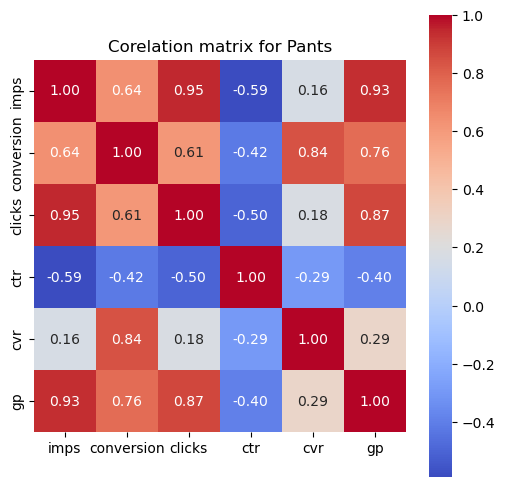

['stretch', 'women’s clothes', 'sweatpants woman', "women's two piece outfits", 'clothing', 'coffee pods holder', 'joggers women', 'jeggings']


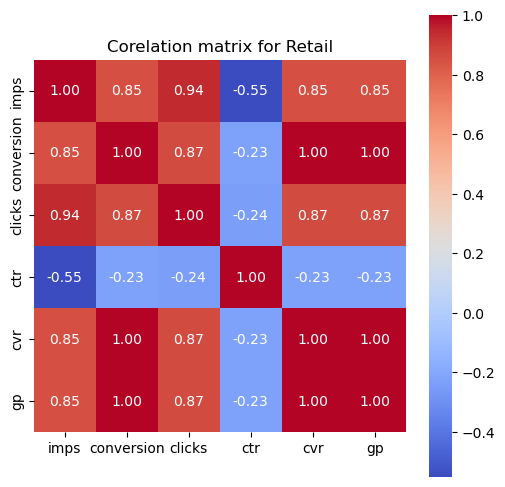

['aaa', 'planetarium', 'match dating', 'macys', 'tire deals', 'walmart', 'strip club', 'cigar of the month']


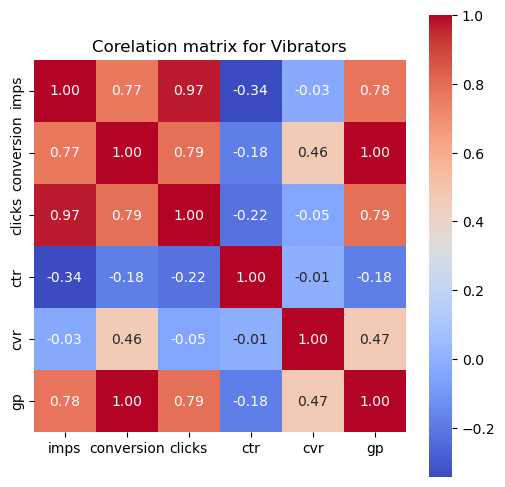

['adult toys', 'red rose vibrator', 'vibr', 'liberator', 'womens adult toys', 'vibrators nipple for women', 'vibrators for women', 'vibrators', 'vibrator for men', 'vibrator', 'dildo', 'adult toy', 'best rated sex toy']


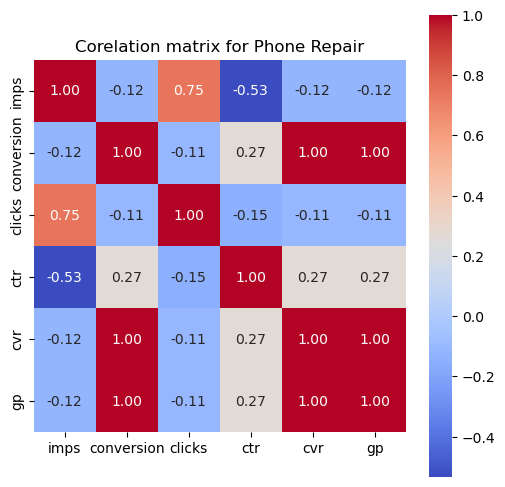

['iphone 11 repair', 'phones for seniors', 'phone repair', 'maybach', 'samsung cellphone screen repair', 'samsung screen', 'samsung repair', 'samsung galaxy screen repair', 'screen repair', 'screen', 'smartphone repair', 'cell phones', 'cell phone repair', 'i phone 14 pro max screen repair', 'iphone screen replacement', 'iphone screen 13', 'iphone screen', 'iphone back glass', 'iphone 14 screen repair', 'iphone 14 pro screen repair', 'iphone 14 pro screen', 'ipad screen replacement', 'iphone 13 pro max screen', 'iphone 12 screen repair', 'iphone 12 screen broke', 'iphone 12 repair', 'iphone 12 pro back glass repair', 'iphone 12 mini screen repair', 'ipad screen repair', 'ipad repair', 'fix phone screen']


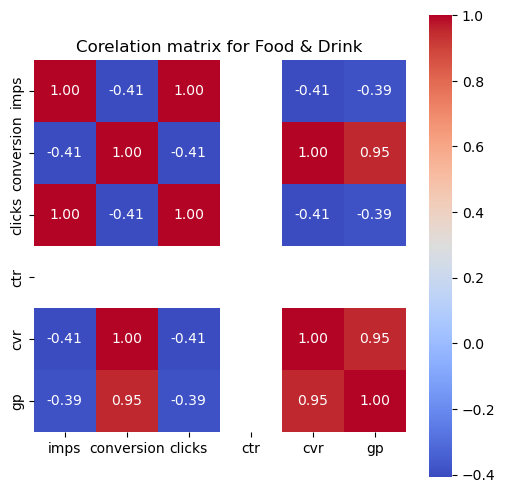

['tequila tasting', 'wine festival', 'salt cave new york city', 'stans donut fest', 'bourbon']


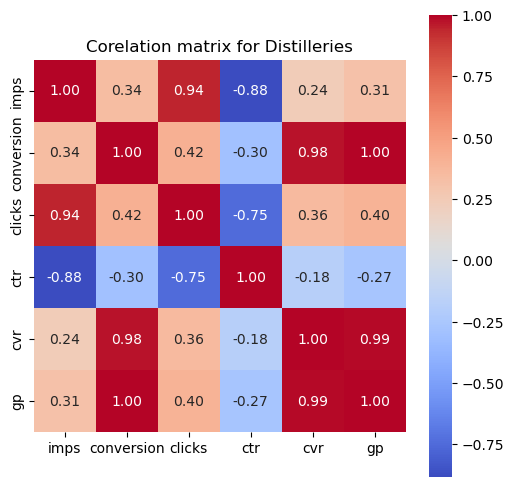

['casey jones', 'whiskey tasting', 'philadelphia illuminatio', 'wine tasting class', 'whiskey', 'your and tasting', 'cocktail', 'distillery', 'house wine', 'group dinner', 'fragrance making class']


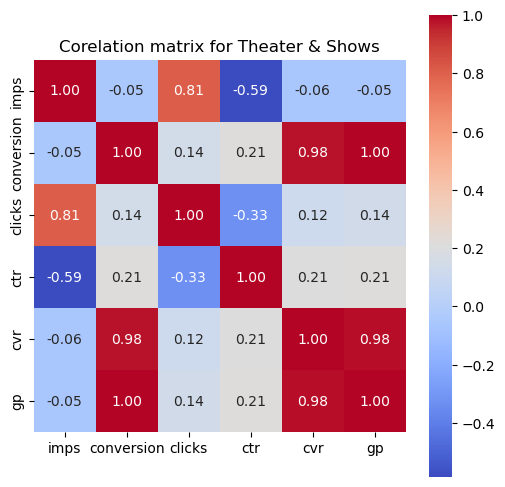

['smiles mishawaka in', 'pirate dinner adventure', 'pirates show', 'pirates dining', 'pirates', 'pirate show', 'pirate dinner', 'pirate adventure', 'pirate', 'mauka warriors luau at hawaii country club', 'meveskin', 'men in review hunk show', 'lion king broadway show', 'lehman', 'magic show', 'theater', 'riverdance', 'showa', 'dinner theater', 'dinner shows', 'dinner show', 'anniversary dinner', 'blue man group', 'blue man', 'flower show ticket', 'front porch improv', 'girls night out']


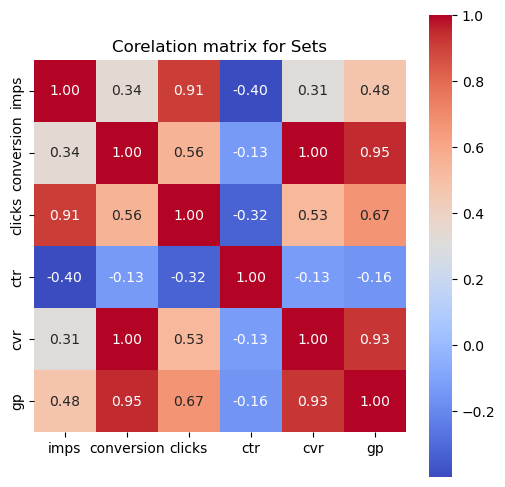

['sexy lingerie', 'lingerie', 'pajamas', 'pajamaj', 'living proof', 'makeup brush', 'make perfume', 'mont blanc', 'toilet seat', 'tytan', 'twin bed in a bag', 'textured comforter', 'womens boots', 'suitcase', 'queen size comforter set', 'queen comforter', 'coach floral', 'cal king comforter', 'california king comforter set', 'brown full size comforter sets with pillows', 'cotton pajamas  pants for men', 'comforter sets 100% cotton lightweight', 'comforter sets', 'comforter light weight', 'comforter', 'comfor', 'conforters', '7 piece comforter set', '10 piece comforter set queen', 'bra and panties set', 'bra and panties', 'bars', 'black diamond earrings', 'kitchen table set', 'jasper, ab', 'female hair dryer', 'external hard drive', 'golf clubs', 'hair curling iron', 'full size bed in bag comforter sets with pillows', 'full size bed', 'gift set women']


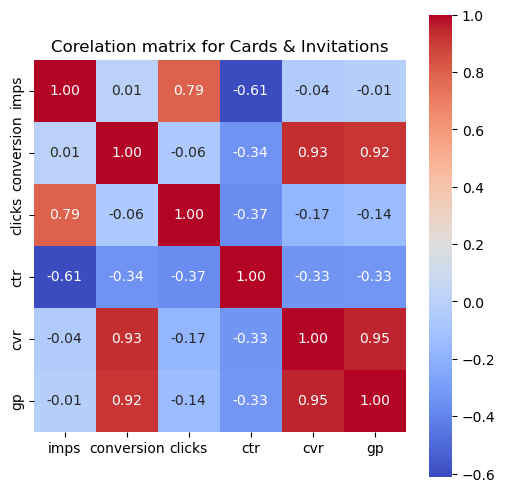

['200 custom photo cards', 'holiday cards', 'photo affections', 'invitations', 'photo cards', 'new years cards', 'tape conversion', 'vistaprint', 'restaurant gift cards utah', 'southtree', 'business cards', 'cards', 'card', 'custom photo cards', '100 custom photo cards', 'address labels', 'address stamp']


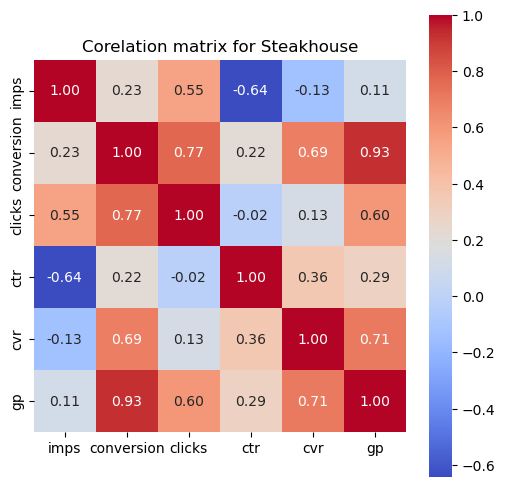

['black angus', 'restaurants in honolulu', 'grill ipanema', 'black', 'parthenon', 'novilhos', 'novilho', 'notty pine restaurant', 'nolvihos', 'steakhouses', 'steak', 'brazilian steakhouse', 'brazilian restaurant']


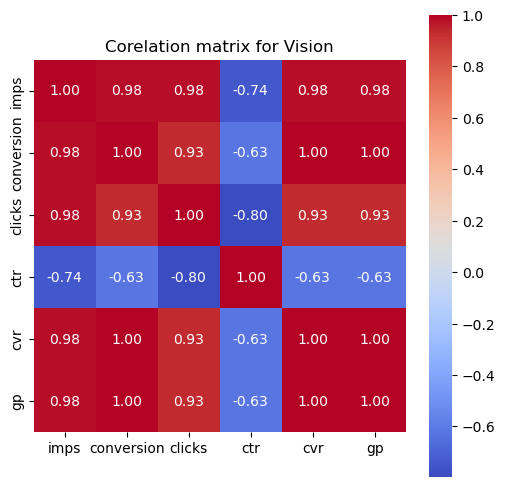

['eye exam', 'optometry', 'eye doctor', 'eye contact exam', 'glasses']


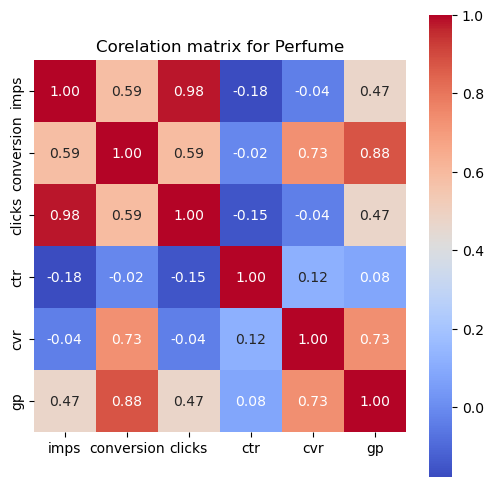

['laurant intese', 'perfume', 'gorgeous', 'burberry women', 'pleasure estee lauder', 'coach poppy', 'bacarat rouge', 'fragrance', 'prada', 'parfum', 'perfume women', 'perfumes', 'perfume versace', 'men fragrance', 'make perfume', 'maison replica', 'magie noir', 'new york perfume', 'obsession cologne for women', 'no malone', 'montale', 'tiffany', 'woman perfume', 'womens boots', 'versace bright crystal', 'versace dylan turquoise', 'valention', 'valentino perfume', 'viva la juicy', 'prrfume', 'sheet brit perfume', 'chanel perfume', 'coach floral', 'candle tom ford', 'bulgarian woman perfume', 'daisy so fresh', 'daisey', 'dolce', 'designer perfumes', 'armani womans perfume', '75062', 'born in roma', 'bond women', 'bond wome', 'barakkat', 'black opium perfume', 'her perfume', 'lacome women', 'la vie est belle', 'escape perfume', "gucci women's", 'gucci mane', 'gucci bamboo', 'gypsy water', 'fragrances4ever', 'fragrances', 'gift set women']


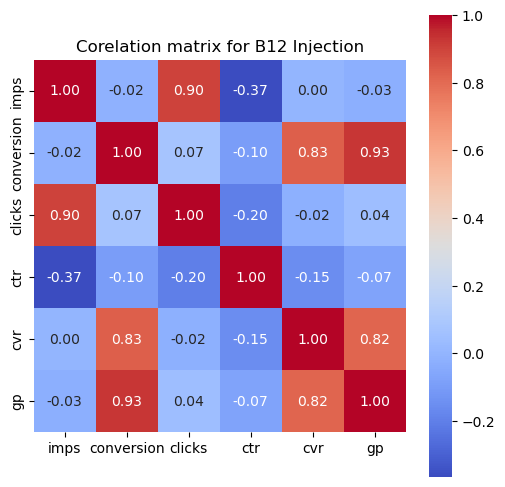

['weightcare', 'vitamin b 12 injections', 'b12 shot', 'mic-b12 compound', 'mic', 'lipotropic injections for men', 'lipotropic injection', 'lipotropic', 'lipo injection', 'lipo b injections', 'nad iv', 'nad injections', 'weight loss injections', 'wellness clinic', 'weight loss injection', 'vitamin injection', 'vitamin c injection', 'vitamin c', 'vitamin b-12 shots', 'sorven', 'sermorelin', 'skinny shot', 'clinic', 'deit shot', 'a better weigh', 'beach medical', 'b12 shots', 'b12 mic', 'b12 injections', 'b12 injection', 'b12 and lipo injections', 'b12', 'b-12 injections', 'b 12 shots', 'iv spa', 'injection']


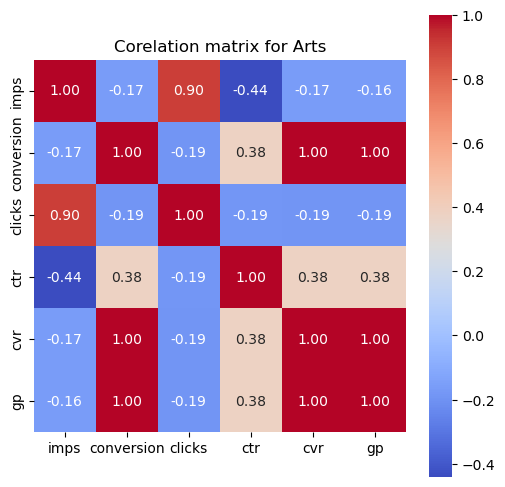

['avf 2025', 'mio', 'philadelphia auto show', 'martial arts', 'lux candle', 'mma', 'self defense', 'self defense for women', 'burlesque', 'art class', 'Aug 28', 'bjj', 'judo', 'jiu jitsu', 'karate', 'fit classes', 'drag brunch', 'gazillion bubble show']


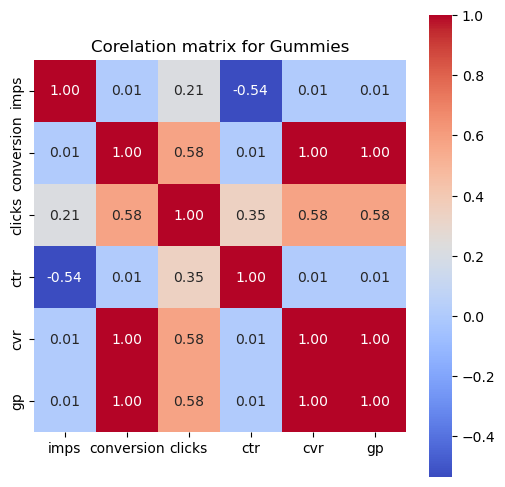

['cbd gummies', 'sour worns cbd gummies', 'sleep gummies', 'cbd sugarfree', 'cbd sugar free', 'cbd  sugarfree on sale', 'cbd', 'golden goat', 'gummies']


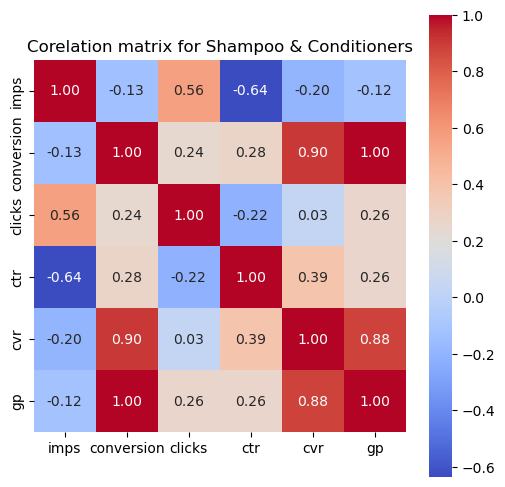

['nioxin 2', 'pureology', 'keraste', 'pravana', 'nioxin system 4', 'nioxin 2 shampoo', 'nioxin', 'nioxib system 2', 'routine shampoo', 'sebastian', 'purology hydrate', 'pureology hydrate', 'pureology conditioner', 'pureologu', 'shampoo aveda', 'shampoo', 'cairns australia', 'def', 'conditioner', 'aveda', 'joico', 'kerastase', 'hair conditioner']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



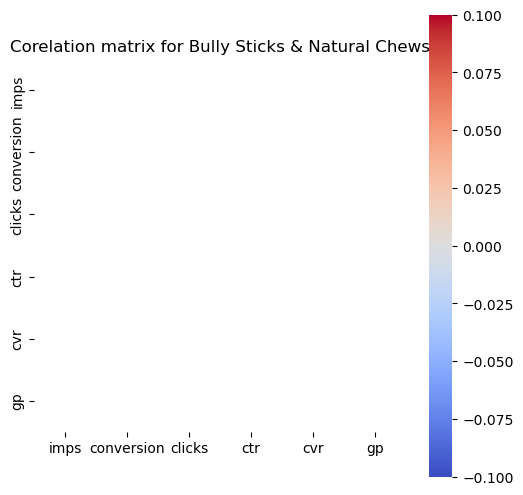

['dog treats']


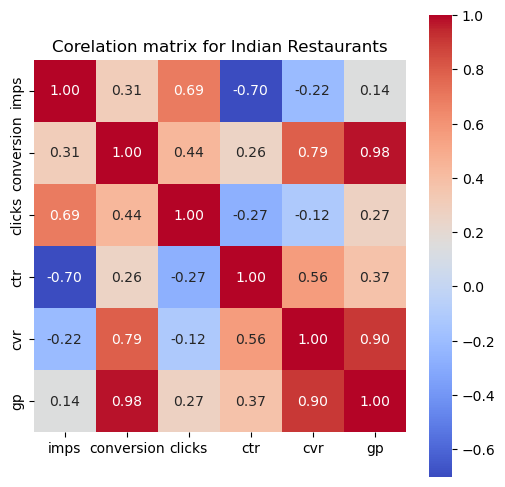

['curry club', 'indian', 'om indian', 'curry leaves', 'indias kitchen', 'indian restaurant', 'indian buffet', 'india']


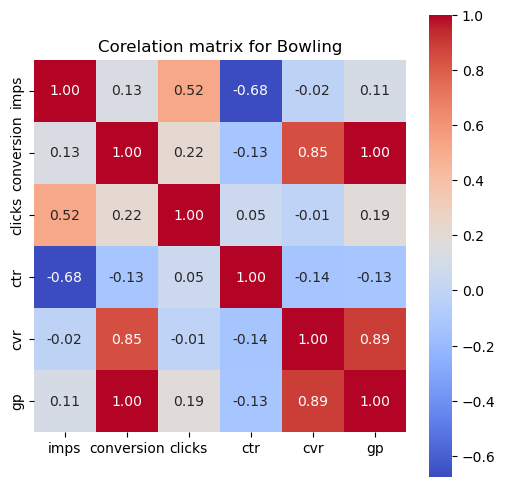

['bryant lake bowl', 'sparetime', 'pins n pockets', 'pins and pockets', 'midway lanes', 'minneapolis', 'ryan family amusements bowling', 'schaumburg bowling', 'spare time entertainment', 'spare time', 'splitsville bowling', 'capital lanes', 'daytona beach', 'cosmic bowling', 'anaheim bowling', 'air jordan shoes', 'bolwing', 'broadway lanes', 'bowling waukegan', 'bowling for 2', 'bow', 'bowlinf', 'bowl 360 astoria', 'bowl 360', 'bowl', 'emerald bowl', 'ep bowling']


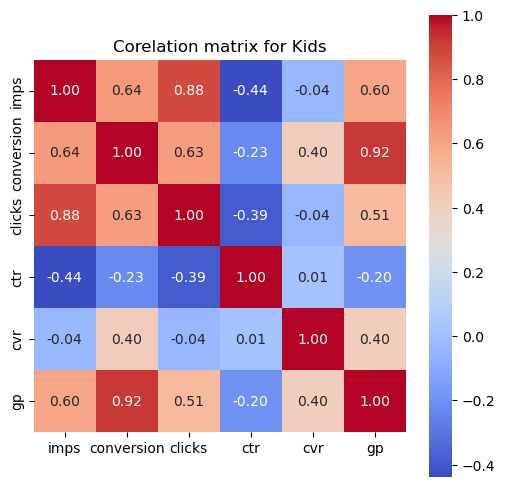

['urban air', 'area 53', 'parkour', 'birthday', 'big air', 'paintball', 'weekly junior magazine', 'doodle', 'times magazine', 'archery', 'ghosttown zipline', 'jayell ranch', 'paint kids', 'paint ball', 'outdoor carpet', 'play', 'places to play for kids', 'piano lesson', 'pottety', 'party', 'parks', 'natural bridge caverns', 'matt burke', 'linq zipline', 'lessons', 'magazines', 'magazine kids', 'natural bridge', 'ninja kids', 'my groupons', 'tanks paintball', 'things for men', 'wilderness at the smokies day pass', 'zip lining', 'voice lessons', 'science word', 'sevierville', 'slime', 'cheap pottery', 'cheap fun stuff kids', 'climbing class', 'climb works', 'bungee jump', 'customized baby blanket', 'dodgebow', 'cooking kids', 'colorado for december', 'atv ri', 'aim martial arts', 'activities teen', 'adrenaline park', 'blast camp paintball', 'baby classes', 'baby', 'birthday party', 'birthday party for toddlers', 'birthdayparty', 'birthday party packages', 'birthday party package', 'highl

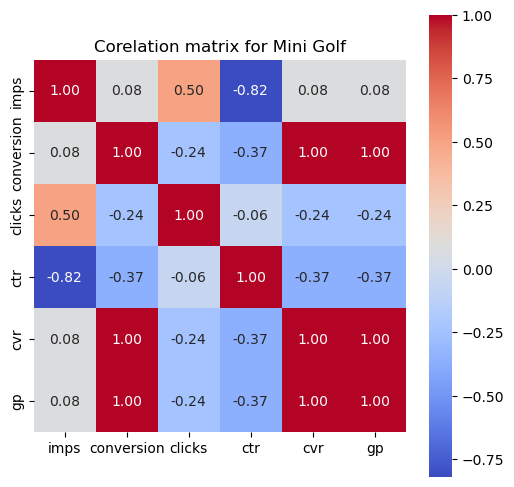

['mini putt', 'orlando stadium', 'memphis grizzlies', 'minigolf', 'monster golf san antonio', 'monster golf', 'round 1', 'putt shack', 'st. louis mo', 'adult fun', 'black light mini golf', 'indoor mini golf', 'in door glow golf', 'golfing']


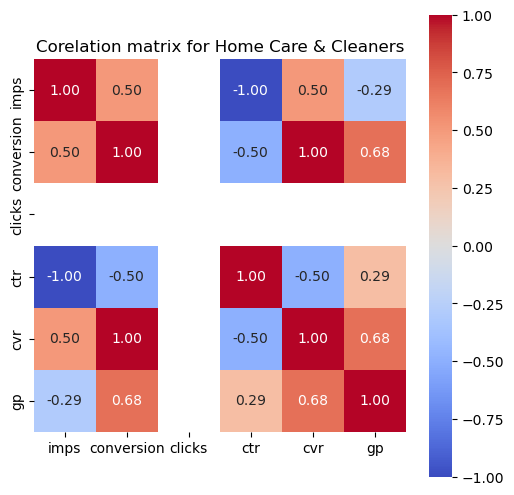

['cleaning products', 'spin scrubber', 'peppermint soap']


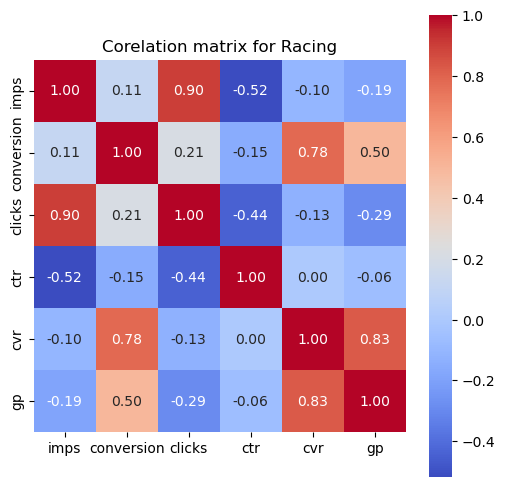

['extreme go karting', 'volt', 'monster truck', 'outdoor go carting', 'piquet', 'pinballz', 'nascar', 'monaco go carts', 'monster wherls', 'monster wheels', 'monster trucks', 'monster jam', 'truck show', 'woodbury', 'racing', 'r1', 'sim racing algonquin', 'blake jones racing center', 'indoor gocart', 'hotwheels', 'hot wheels monster trucks', 'hot wheel', 'hoffman estates', 'k1 speed', 'driving experience', 'drive', 'go kart', 'go cart', 'hot wheels']


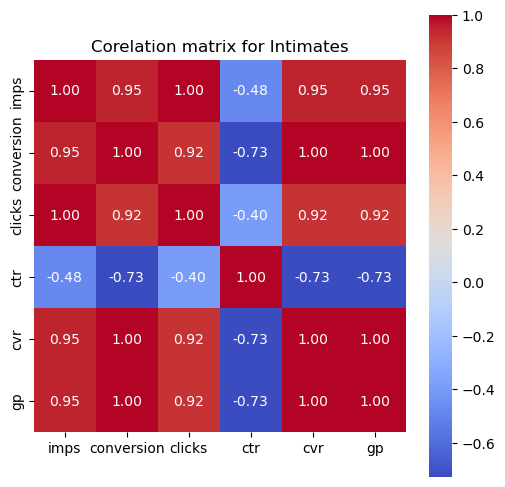

['bra', 'plus size tube top', 'bra sets']


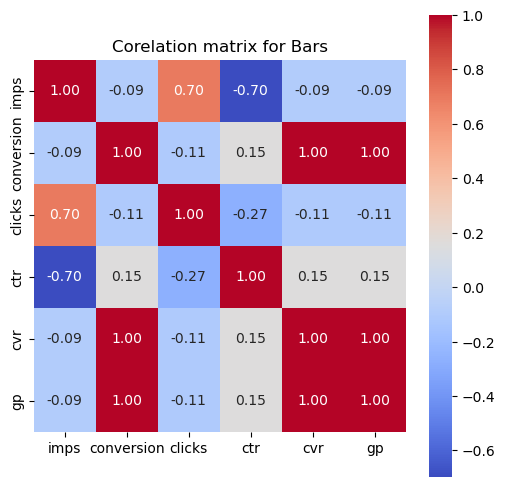

['pub crawl', 'old las vegas', 'portland maine', 'linq roller', "lu'au", 'lounge bar', 'roof top bar', 'resistance fitness', 'sharron’s winery', 'sky dining', 'charlotte', 'cielo rooftop lounge', 'classpop sushi', 'buffalo battle grounds', 'dining in the dark', 'adventure dome', 'bar stool', 'bar', 'battle and brew', 'blackout', 'beer', 'hookah lounge', 'las vegas strip', 'kareoke', 'karyoke', 'flatstick', 'drinks']


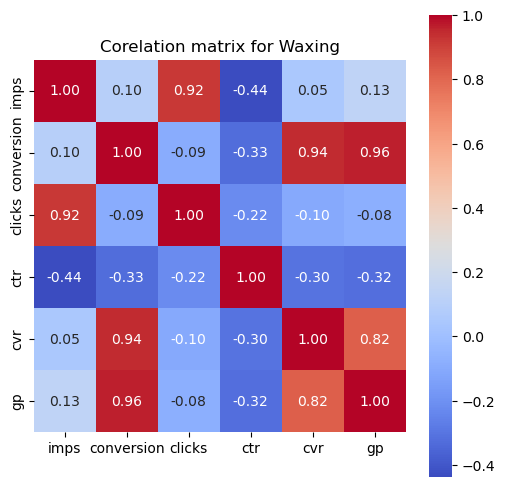

['sugar', 'sugar cove', 'leg wax', 'leg sugaring', 'naked peach', 'nail and waxing salons', 'the velvet box', 'the spa room', 'white rose wax', 'vajacials', 'waxing men', 'sugaring', 'sugar waxing', 'clear aligners', 'brow tint', 'cassandra', 'couples skin spa', 'brazilian beeswxax', 'hello sugar', 'eye brow wax', 'eyebrow waxing', 'european wax', 'hair waxing', 'hair re', 'full body wax', 'full leg wax']


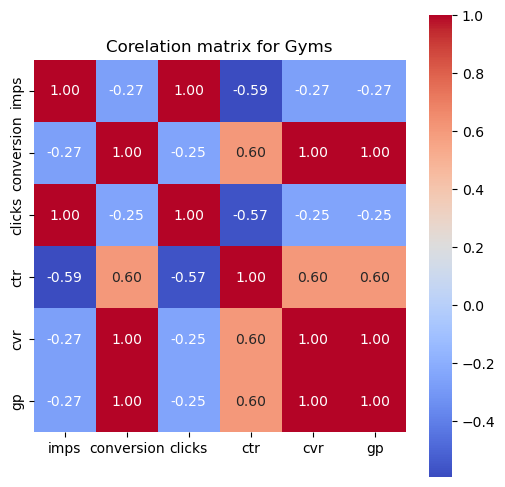

['bodi', 'mbys foldable foam baby play mat for playpen 50"x50", reversible waterproof', 'cko kickboxing', 'fitness gyms', 'gyms']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



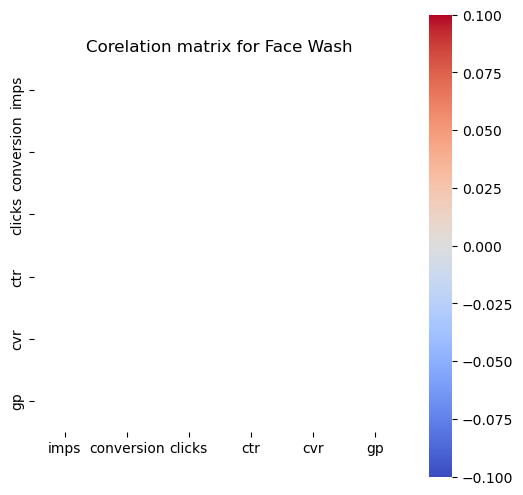

['obagi gentle cleanser']


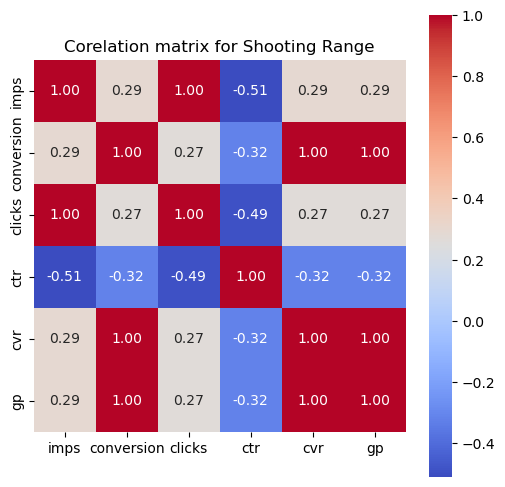

['shooting range', 'pasabocas', 'sandy spring gun range', 'redlands shooting club', 'shooting range in new jersey', 'shooting', 'concealed handgun vlass', 'battlefield', 'battle bots', 'learning fun', 'k1 indoor carts', 'gun', 'gun range', 'fund things to do']


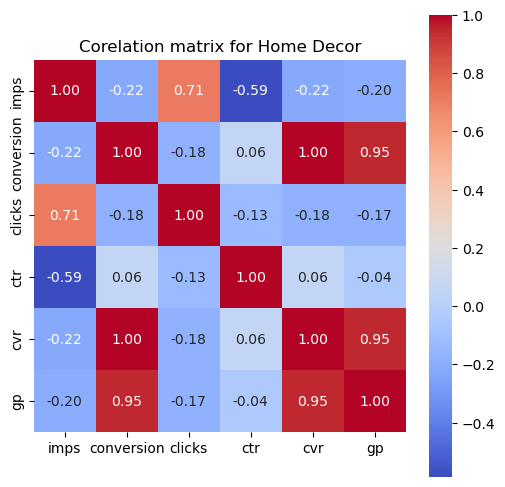

['picture blanket', 'photo collage blanket', 'syracuse, in', 'pillow covers', 'printer pix', 'photos', 'photo blanket', 'photo gifts', 'pet pillow', 'personalized blankets', 'monogramonline', 'thermal blanket', 'wayfair', 'stockings', 'car blanket', 'custom ornaments', 'custom cupcakes', 'cotton candy candle', 'blankets', 'floral design workshop', 'eventos', 'fun and entertainment']


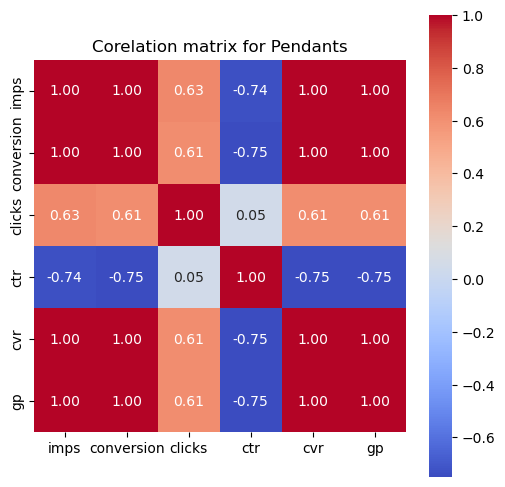

['crystal necklace', 'snowflake necklace', 'sterling hgts mi.', 'citrine', 'b e esthetics']


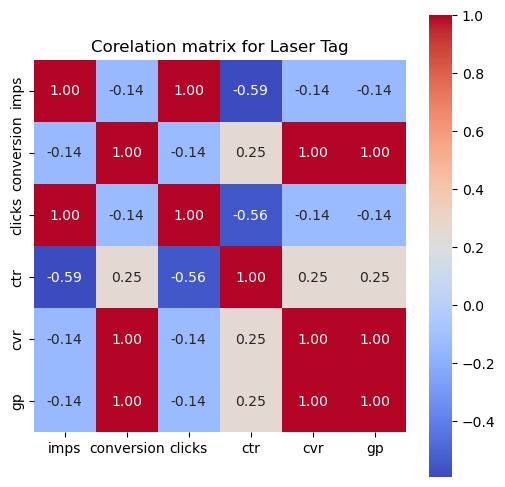

['game time', 'lol station', 'yolo fun', 'cj barrymore', 'lazer tag', 'laser web', 'laser tag st. louis', 'laser tag', 'fun things to do']


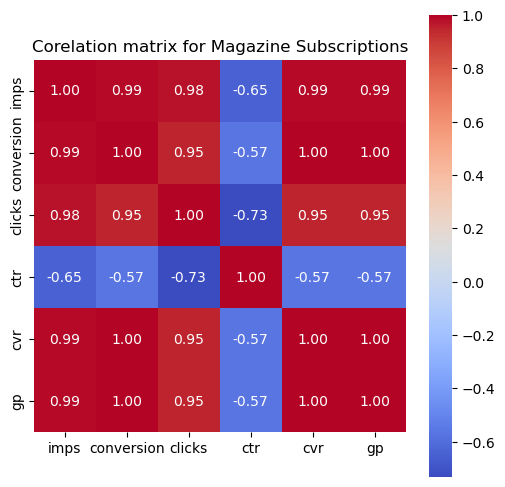

['magazine', 'print magazine subscription', 'phoenix home and garden]', 'people magazine', 'magazine subscription', 'tv guide', 'robb report magazines', 'colorado magazine', 'atlantic magazine', 'indianapolis monthly magazine', 'kids magazine', 'ha filers for cheeks', 'free magazine subscriptions']


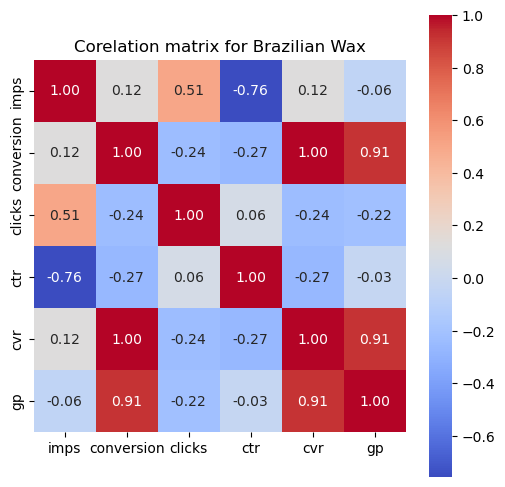

['brazillian wax at brazilian wax and spa by claudia', 'wax gigi', 'pro skin care', 'male brazilian wax', 'vagacial', 'wax legs', 'wax candy', 'aks', 'blossom brows', 'brazilian wax for two', 'brazilian wax with underarm', 'brazilian waxing']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



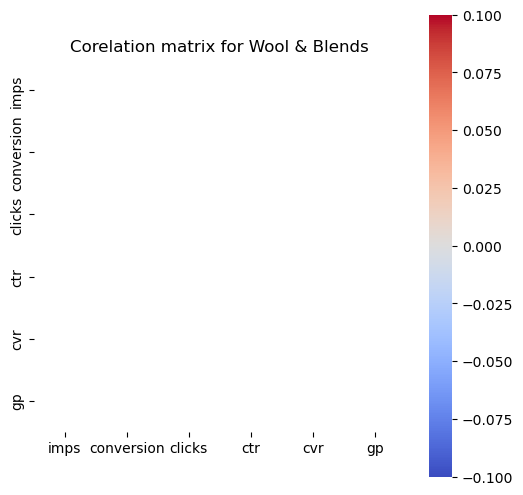

['mens wool']


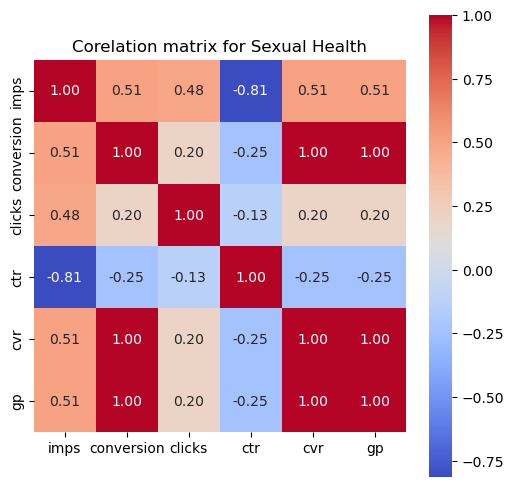

['sildenafil', 'viagara', 'cialis', 'cryosculpt', 'ed treatment', 'emsella']


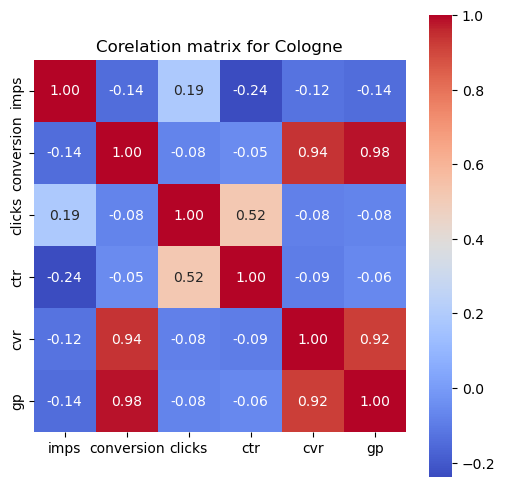

['mr burberry cologne', 'hugo', 'coach blue', 'burberry', 'perfumen men rabanne phantom parfum', 'men’s coach cologne', 'men’s cologne', 'mens fragrances', 'mens fragrance', 'mens eternity col', 'mens cologne', 'mont blanc', 'versace cologne', 'valentino', 'sauvage', 'chanel bleu cologne', 'cologne', 'coligen', 'carolina herrera', 'cologne prada', 'dior cologne', 'colonge', 'creed', 'aqua di gio', 'armani code profumo', 'jean paul gaultier cologne']


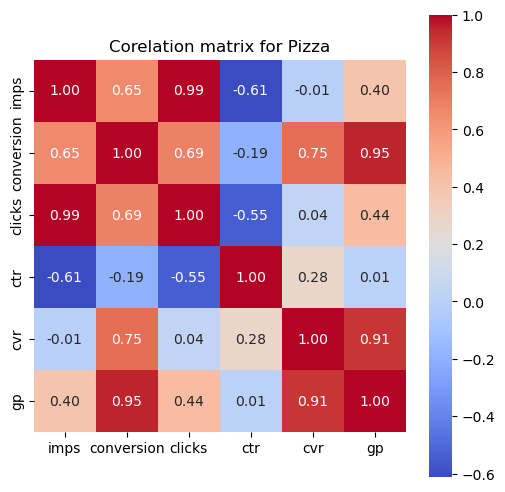

['pizzeria due', 'pizza', 'pizza denver colorado', 'parrish pizza', 'salvinos', 'ccs pizza', 'food delivery', 'ginos']


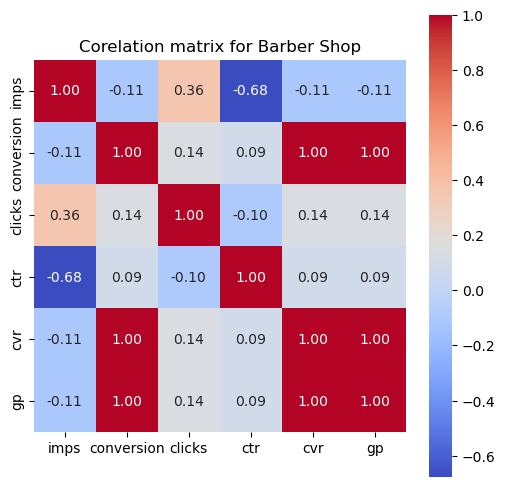

['kids haircut', 'men’s haircuts', 'mens haircut', 'mens hair cuts', "men's haircut", 'sun kissed hair', 'silk press hair dresser', 'cut and highlights', 'color hair for men', '20850 haircut', 'barbershop cuts', 'barbers', 'barber', 'beard cut and hair cut', 'hair color for men']


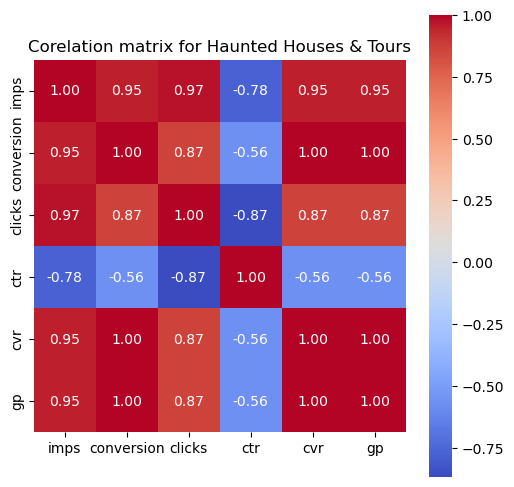

['ghost tour', 'whiskey tour', 'voodoo and vampire', 'haunt', 'haunted', 'ghostly experience walking tour', 'ghost tours new orleans', 'ghost']


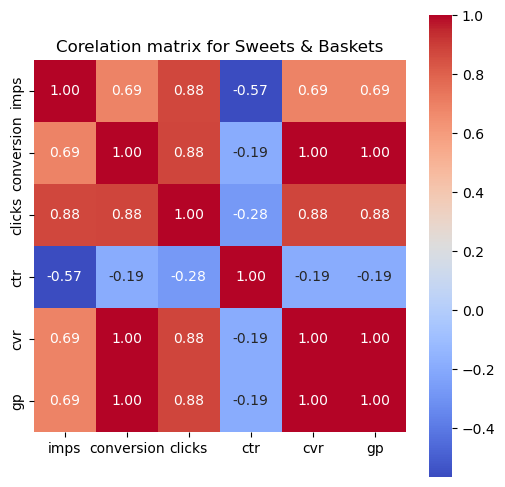

['ftd', 'valentines', "valentine's date", 'strawberries', "sherri's berries", 'chocolate covered strawberries', 'cookies', 'baskets', 'bakeries', 'gourmet', 'frozen fish foods', 'gift baskets']


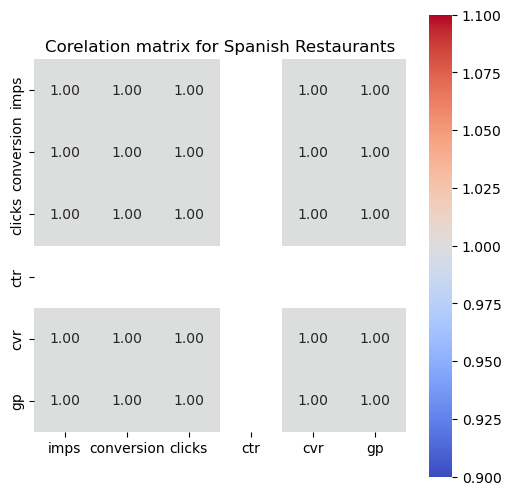

['noma', 'havana cafe']


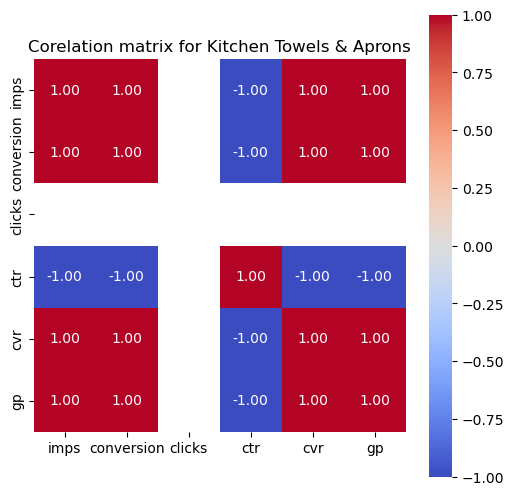

['hand towels', 'kitchen mats']


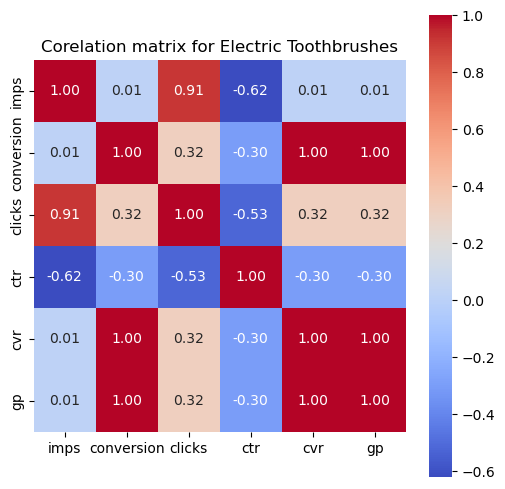

['electronic tooth brush', 'travel kit', 'toothbrush', 'tar removal electric pick', 'water flosser', 'carpet cleaning and house cleaning', 'electric tooth brush']


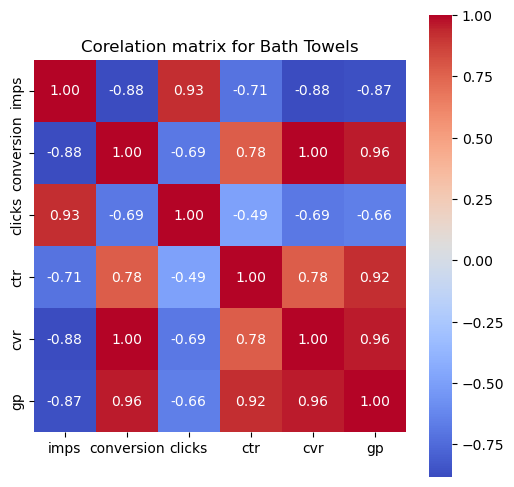

['bibb', 'bath sheets', 'towels', 'towel', 'bath towels', 'bibb towel']


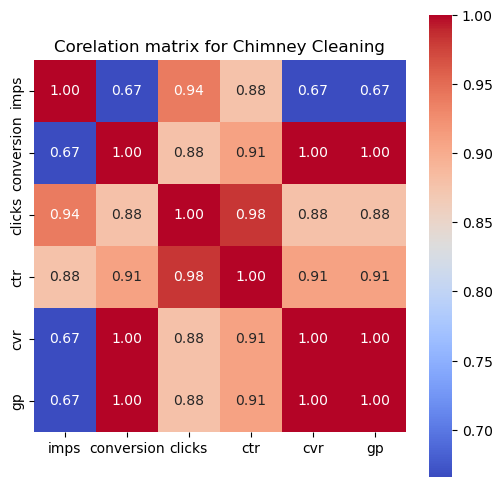

['chimney', 'chimney sweep', 'chimney inspection', 'chimney cleaning']


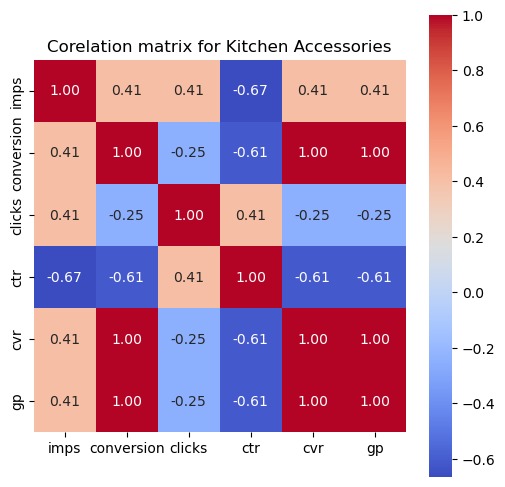

['photo coffee cup', 'mother of the bride dresses', 'coffee cup photo', 'beer mug', 'fandango coralridge mall']


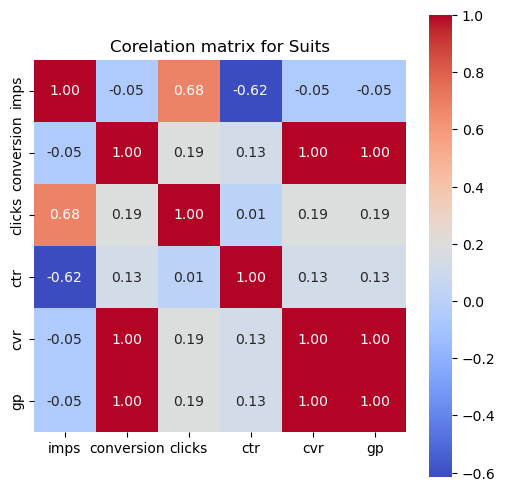

['men suits', 'mens slim fit suits', "men's thong", "men's suits", 'suits', 'suit', 'custom suits', 'dark green suit pants for men', 'black suit mens jacket 42t']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



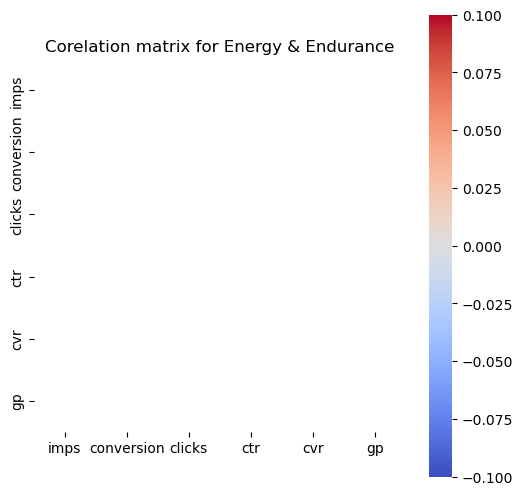

['testosterone']


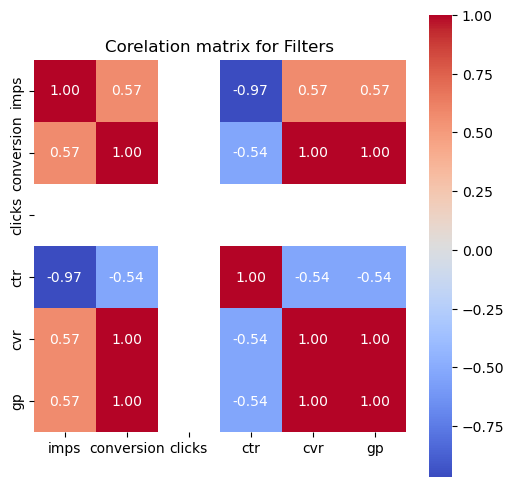

['air filter', 'merv8', 'high-efficiency furnace filters', 'furnace filters 20x30x1']


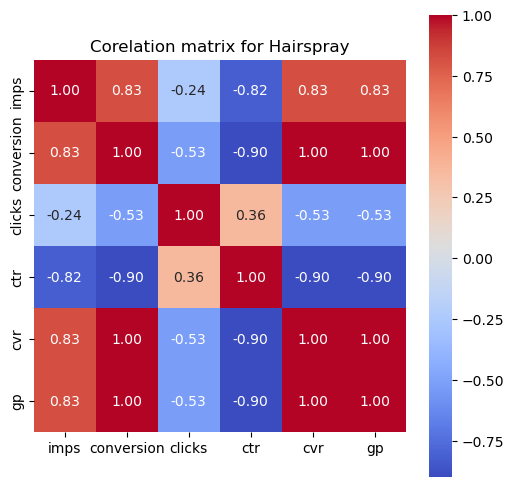

['kenra #25 hair spray', 'kenra hair products', 'shaper plus hairspray', 'bosley', 'bleach hair']


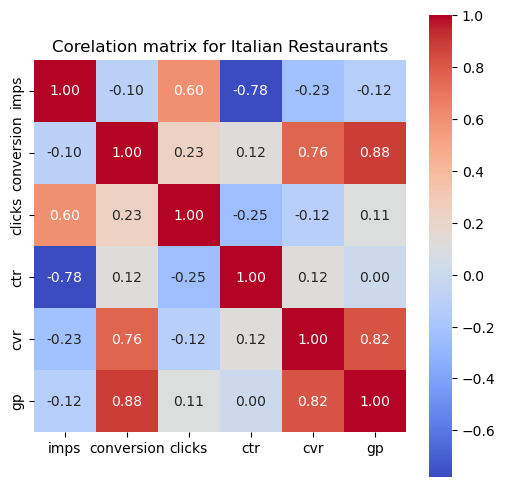

['rigazzi', 'brio', 'brios', 'bravo', 'pizza deals in suffolk county', 'mulinos', 'morristown nj restaurants', 'takeout  deals in suffolk county', "the frenchman's dough", 'valentine dinner', 'bustronome', 'dinner and entertainment', 'andiamo', 'ice skating carlsbad', 'italian food', 'italian', 'fabio', 'egift', 'food and drink']


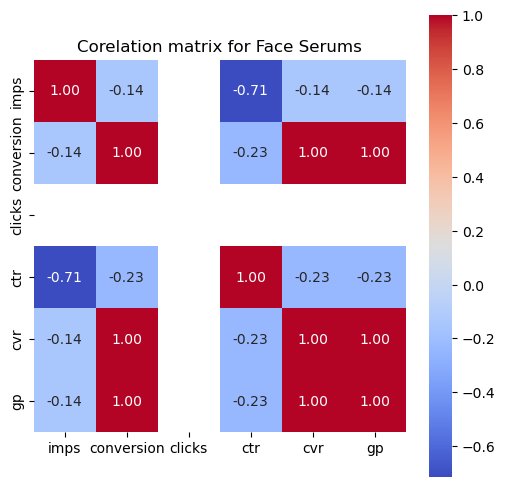

['alastin', 'peptide', 'skinceuticals serum', 'biossance', 'face wrinkle services']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



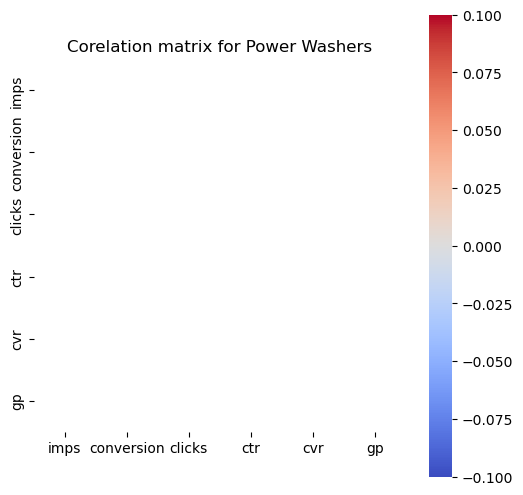

['pressure washer']


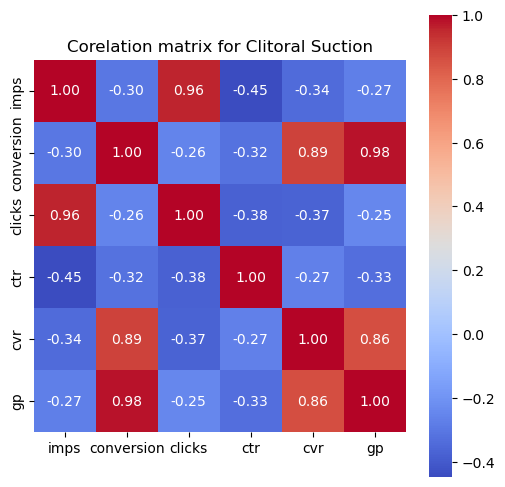

['rose toy', 'vibrato', 'clitoral vibrator', 'rose shape sucking vibrator g-spot private parts sex toy 7 speed...', 'uhaul', 'rose adult toy', 'sex', 'sexual wellness', 'sex toys', 'sex rose', 'galaxy projector']


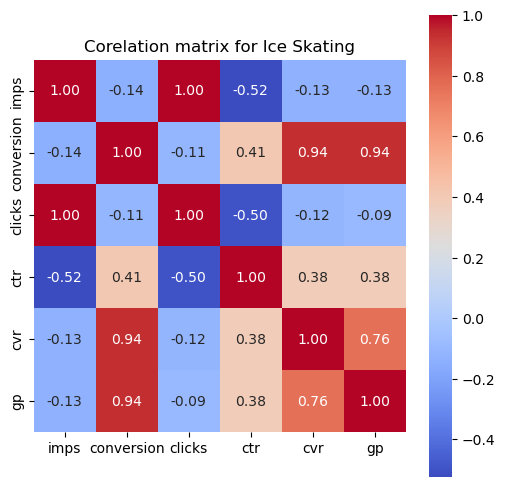

['skate', 'fairfax ice arena', 'twin rinks', 'rockafeller center ice skating', 'rental', 'ice works', 'ice skating', 'ice skate', 'ice ska', 'hanabi hibachi and sushi', 'kids woodshop', 'kendall ice arena']


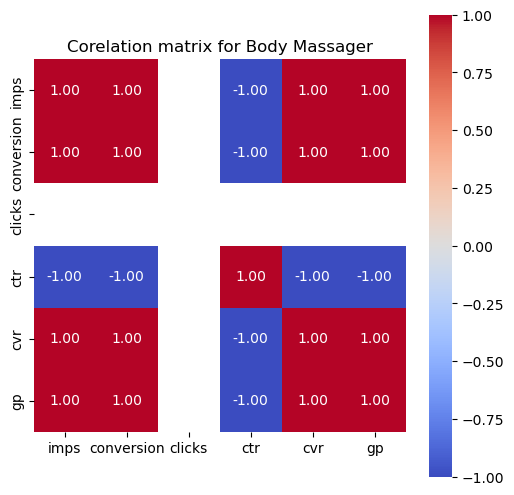

['shiatsu', 'massage for me']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



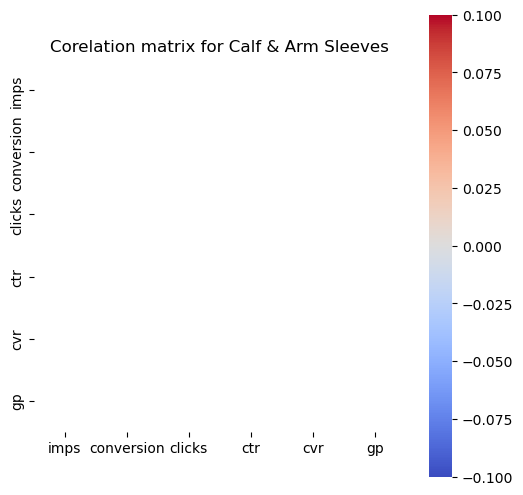

['knee brace']


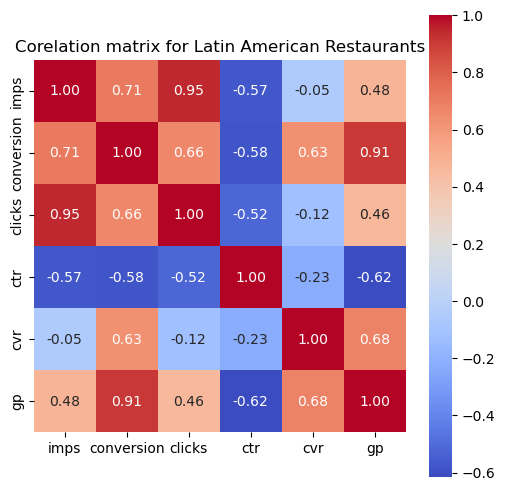

['chimis', 'mexican', "chimi's", 'restaurant chimi', 'desayunos', 'tacos', 'restaurant food brooklyn', 'southern girls restaurant', 'desayuno', 'havana', 'food denver colorado 80212', 'fodue restaurant']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



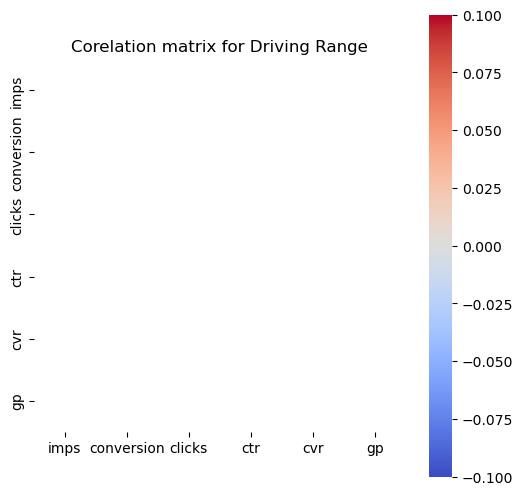

['range balls']


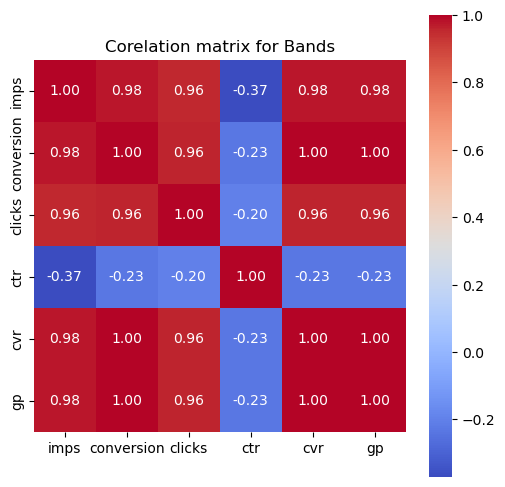

['rings', 'men’s gold wedding band', 'wedding bands', 'rings for women', 'sterling silver ring', 'sterling silver rings', 'diamond rings', 'anniversary band', 'anti-virus', 'jewelry men wedding ring 925', 'exercise bands', 'equanit']


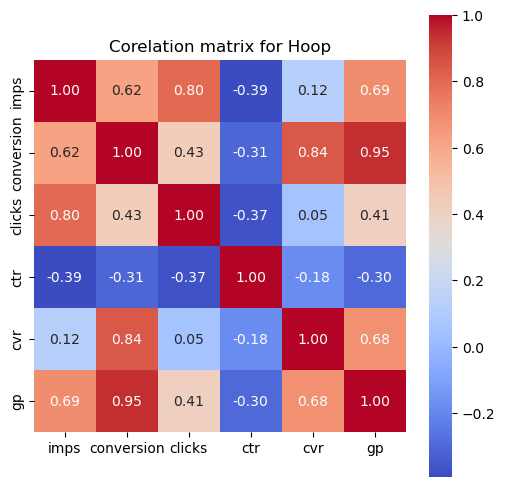

['hoop earrings', 'hoop earrings 25mm', 'earrings', 'swarovski', 'stirling silver earings', 'silver hoop', '14 k gold earrings', 'hoop hugging diamond', 'earings', 'gold earrings']


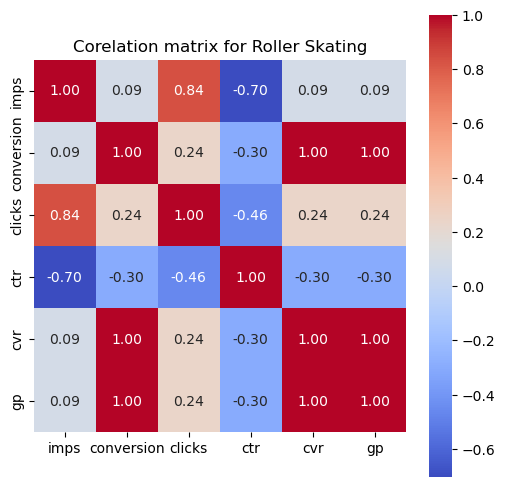

['roller skating', 'press play', 'youth active', 'xanadu skating', 'rollerskating', 'skating', 'area 53 skating', 'indoor go carts', 'king skate']


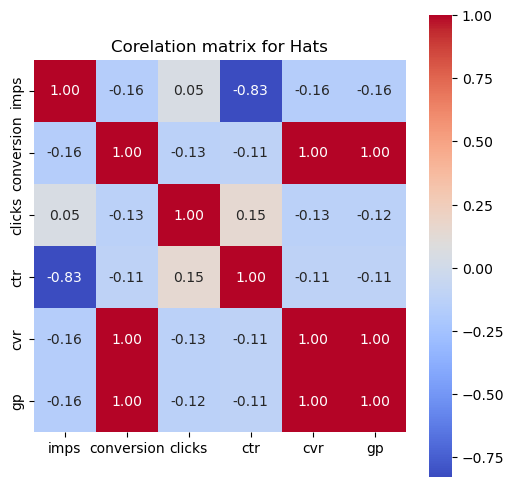

['panama roll up straw hat', 'men’s hat', 'men fedora hat', 'sun hat', 'the teal yogi', 'winter women boot', 'cowboy hats', 'hat scarf glove sets', 'jazz clubs']


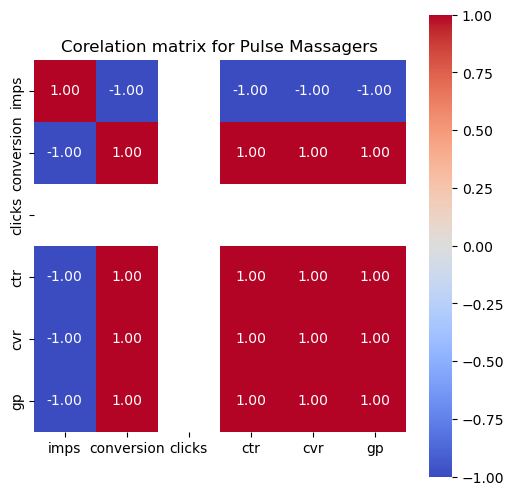

['electric muscle stem', 'tens electrode']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



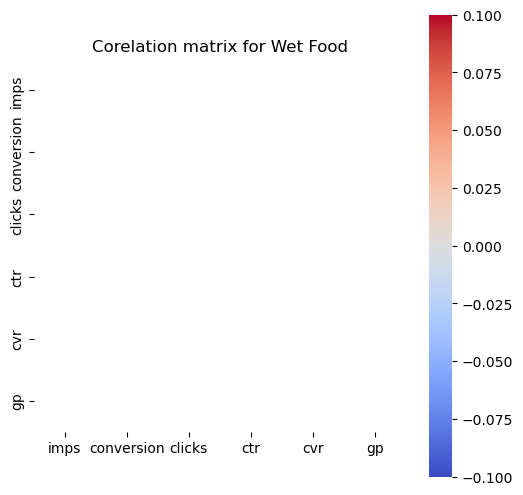

['chef scoochies']


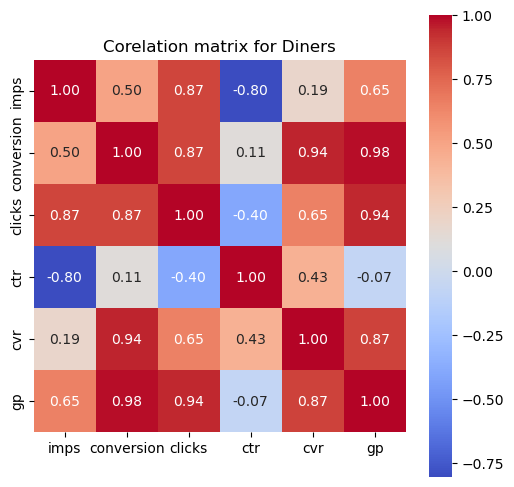

['ihop', 'waffle shop', 'breakfast']


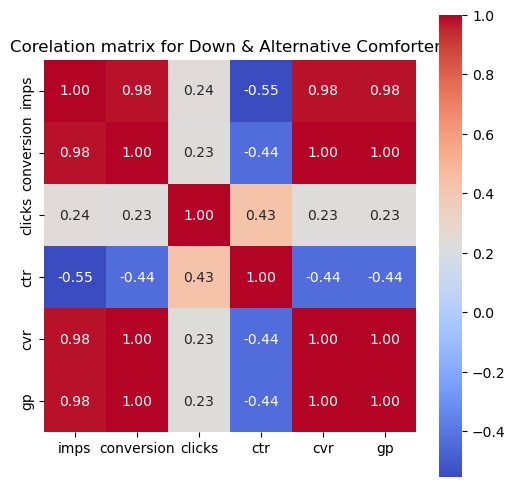

['comforters', 'comfortor', 'alternative down comforts', 'alternative comforters', 'king comforter hunter green', 'down compforters', 'down comforter', 'down com', 'down alternative t']


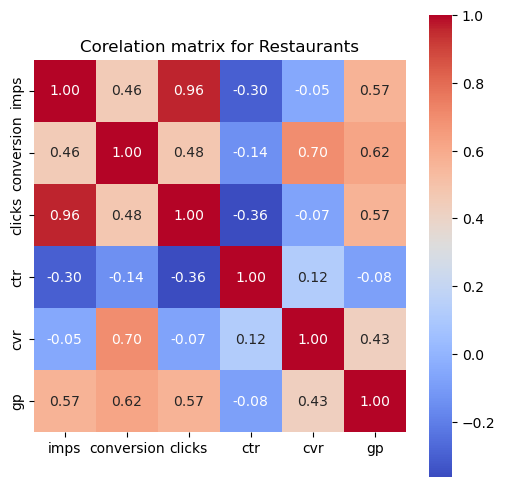

['restaurants', 'gyu king', 'oceanique', 'hibachi', 'restaurant', 'curry club', 'dicks last res', 'osak', 'restaurants.com', 'indian', 'sushi for 2', 'noma', 'rigazzi', 'chimis', 'mexican', "chimi's", 'brio', 'restaurant.com', 'egg', 'blueberry hill', 'restaurant chimi', 'crooked pint', 'desayunos', 'sushi', 'brios', 'bravo', 'fairgrounds hotel resturant allentown pa', 'om indian', 'pampas', 'oplika resturant', 'planet hollywood', 'pizza deals in suffolk county', 'park tavern', 'pho', 'persian food', 'media food', 'margaritas', 'luxury picnic', 'mulinos', 'morristown nj restaurants', 'takeout  deals in suffolk county', 'takara', 'tacos', 'sushi near me', 'the sea', 'thia food', "the frenchman's dough", 'wings', 'valentine dinner', 'sake', 'rudys', 'sea food', 'sea bar restaurant', 'rainforest cafe', 'rain forest cafe', 'resturents', 'resturants.com', 'restaurant food brooklyn', 'restaunt', 'remingtons of niagara restaurant', 'res', 'soul food', 'southern girls restaurant', 'spirit of n

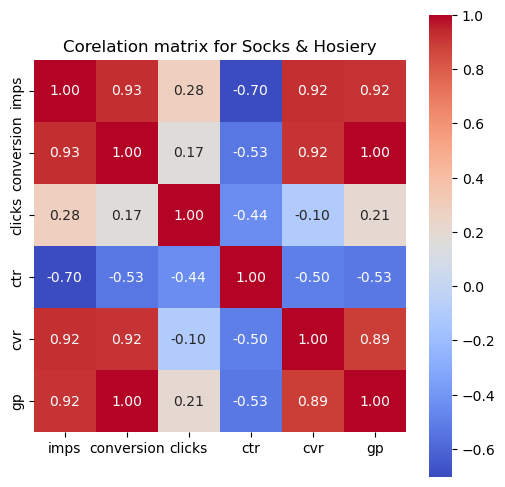

['holiday compression socks', 'compression socks', 'tights', 'thigh highs', 'winter']


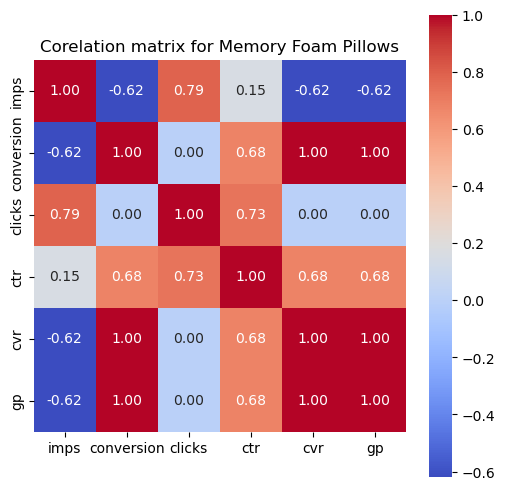

['pillows', 'pillow', 'my pillow']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



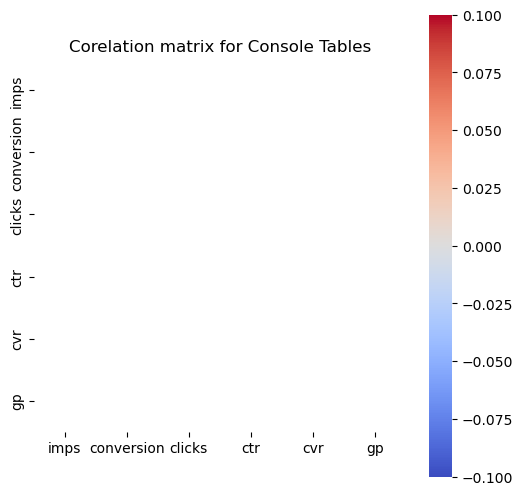

['console table']


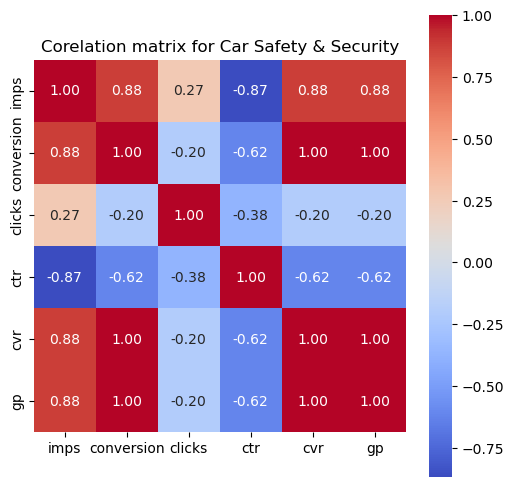

['battery jump', 'tire world', 'tools', 'air pump', 'jump starter', 'good year tires']


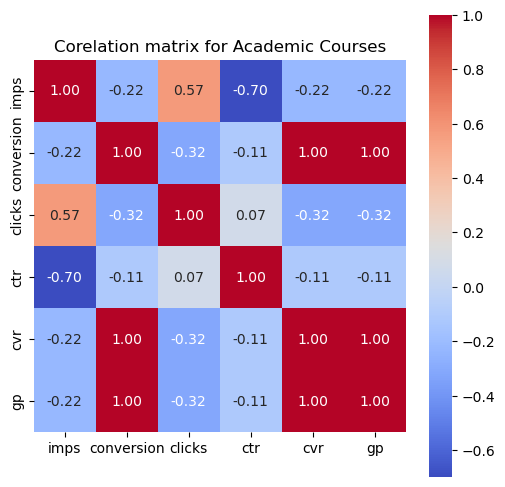

['little beakers', 'notary courses', 'tutoring', 'real estate one', 'real estate licensing class', '63-hour narrated real estate license']


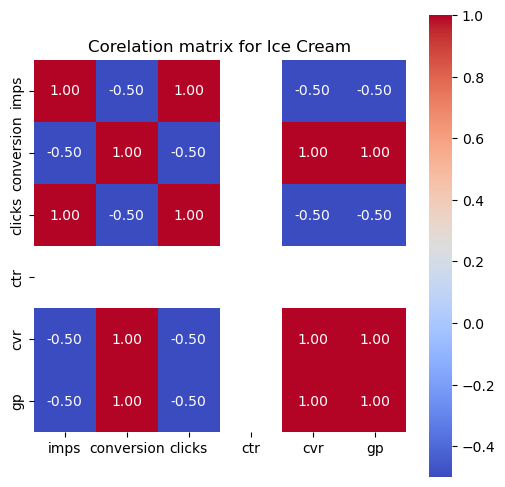

['cold stone', 'hey sugar', 'fort lauderdale']


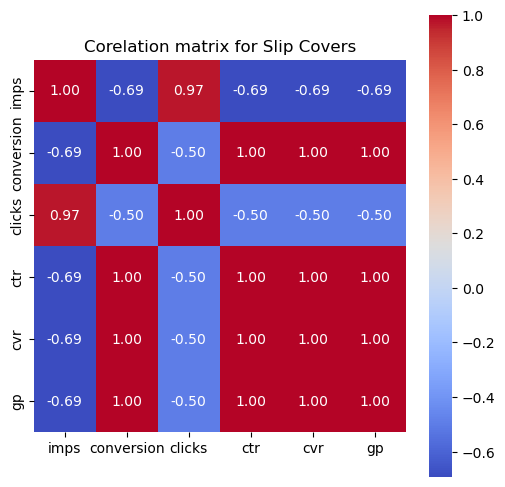

['sofa covers', 'couch covers', 'bamboo couch cover']


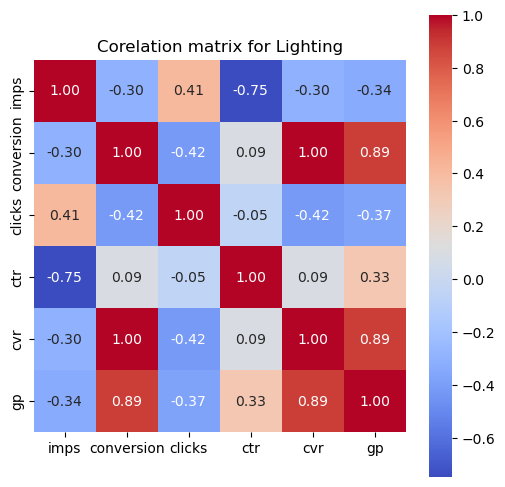

['solar mobiles', 'solar light', 'lighting', 'ledlight', 'solar fairy lighta', 'costway christmas', 'lazer light show', 'falling lights']


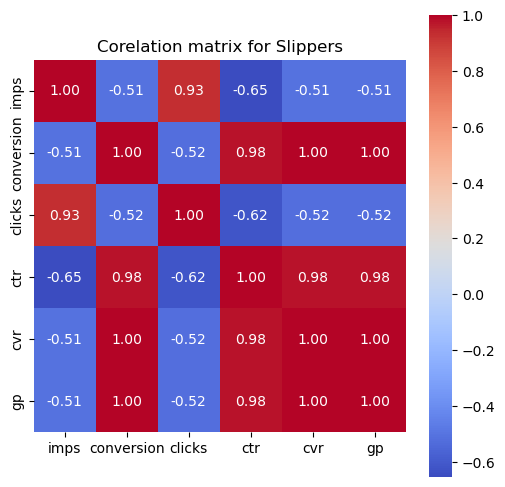

['slippers', 'women boots', 'sandals for women', 'lees hogies house']


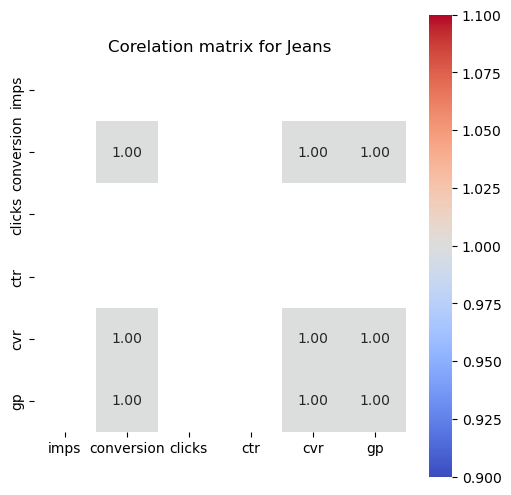

['mens clothes jeans', 'mens distressed jeans']


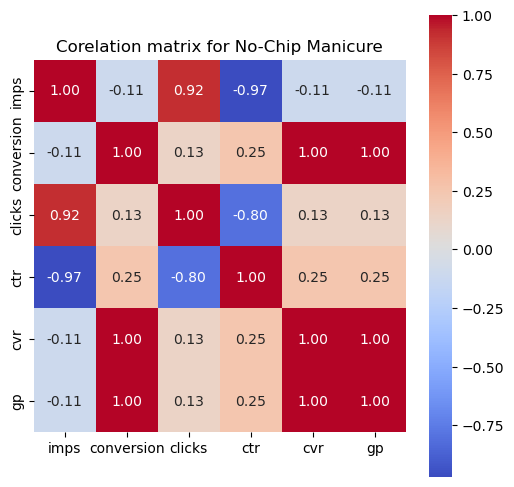

['luscious nails', 'mani padi', 'raybella nails', 'cheap nails', 'gel menicure abd pedicure']


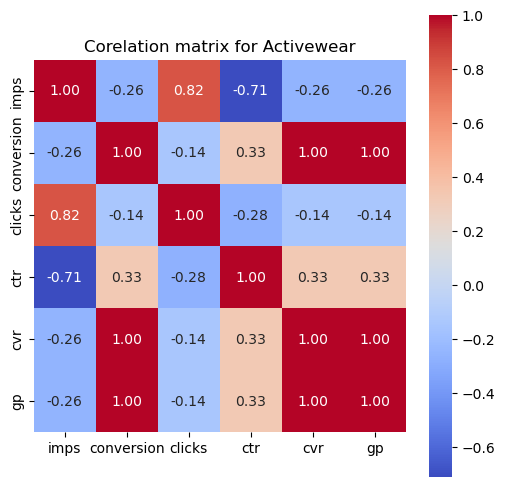

['men athletes spandex', 'mens jogger', 'mens hoodies', 'sweat suits', 'yoga pants', 'women lounge sets', 'women cloyhes', 'women clothes', 'workout clothes', 'high tea']


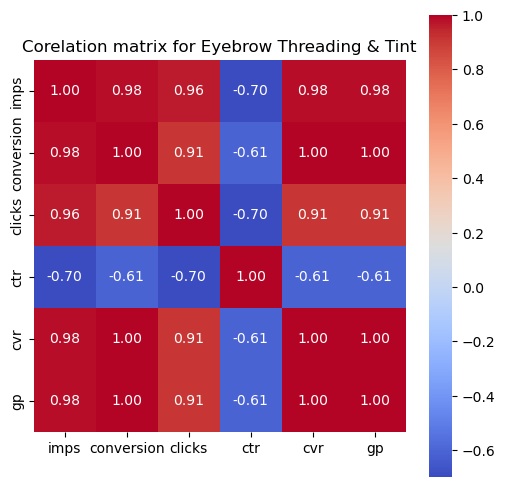

['eyebrow threading', 'wax eyeb', 'brow', 'beauty cafe', 'face lift injections', 'eyebrow coloring', 'eyebrows wax']


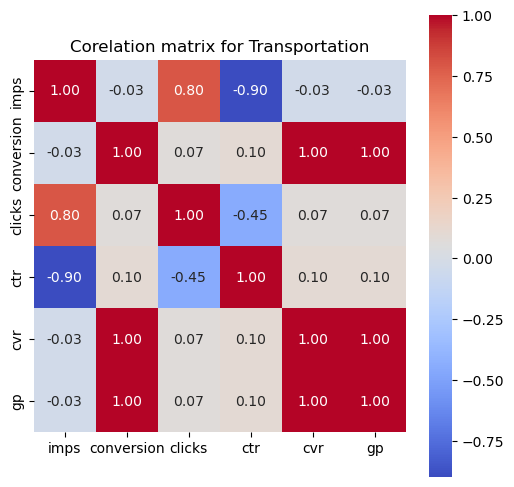

['velocity', 'test driving cars', 'race car driving experience', 'ride along', 'ride', 'cars', 'break things', 'extreme driving', 'drivexotic', 'exotic cars', 'for four']


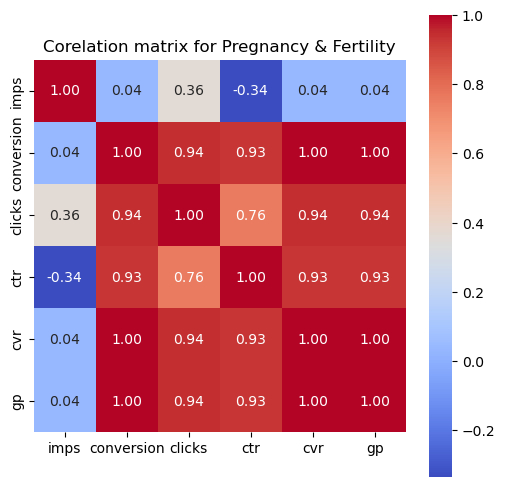

['baby doppler', 'fetal heartbeat monitor', 'fetal doppler']


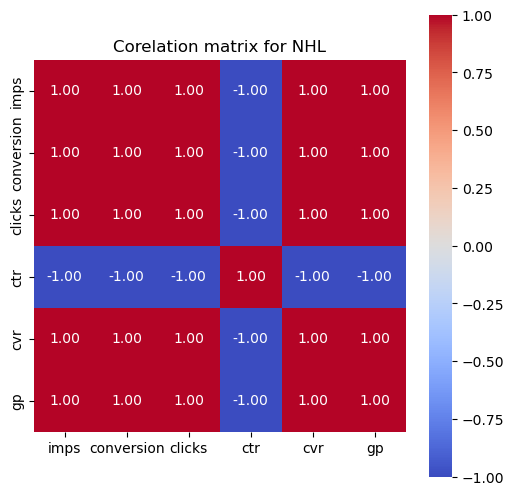

['philadelphia flyers', 'railers']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



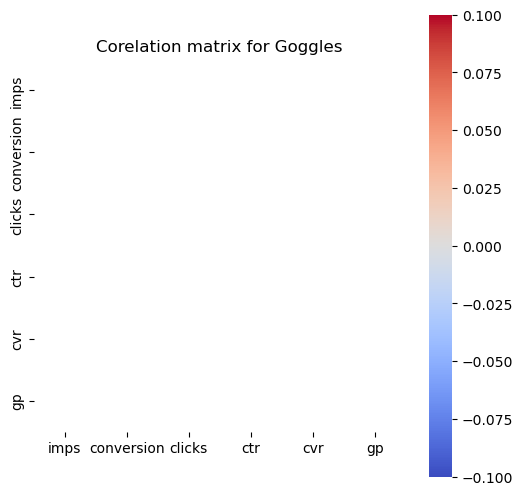

['goggles']


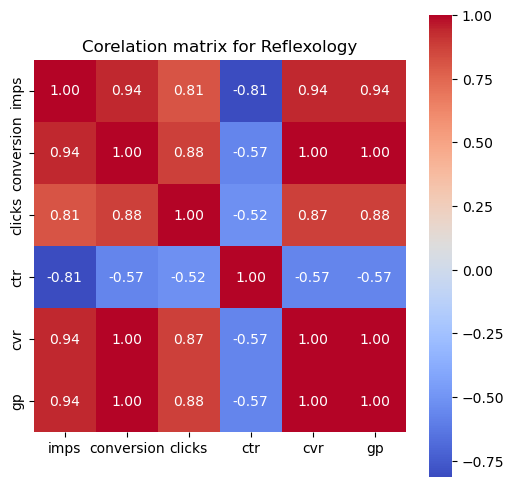

['foot reflexoligy', 'massage with reflexology', 'tao feet spa', 'couples message with reflexology', 'green health massage east windsor']


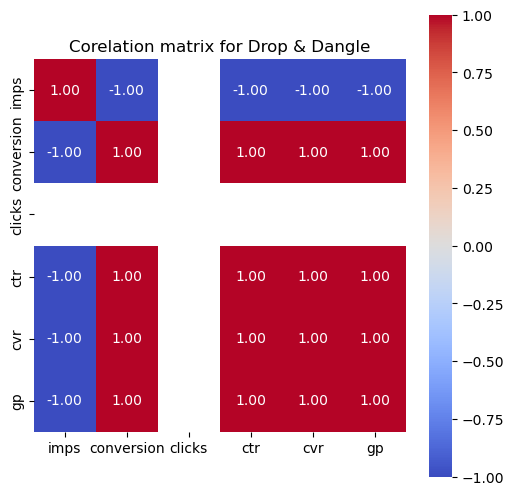

['borealis', 'precious  stone earrings']


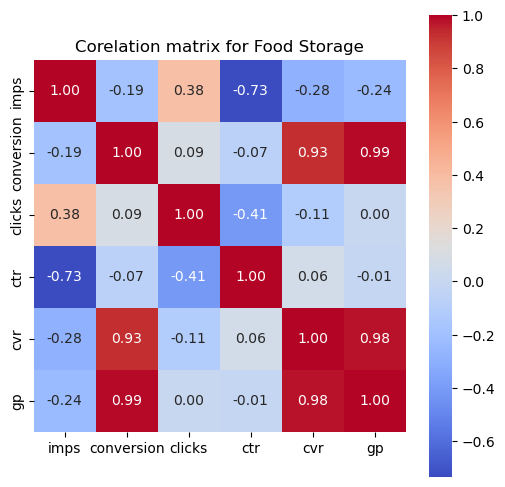

['dishes', 'kids lunch box', 'sticky phone  holder', 'spice rack', 'kitchen products', 'electric lunch box', 'food savers bags']


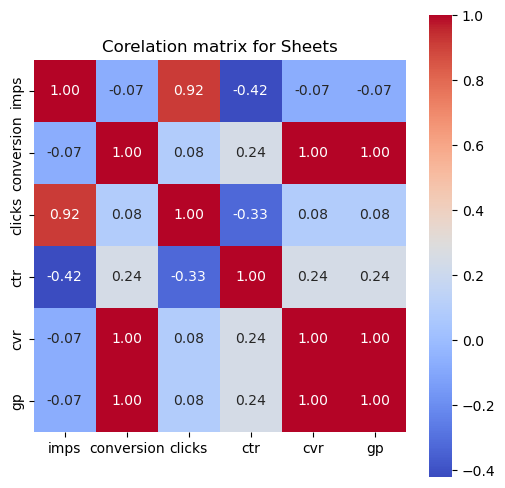

['bamboo sheets', 'organic', 'squat machine', 'sheets', 'silk sheets', 'sheets that keeps bugs away', 'snow blower', 'california king', 'cotton twin  sheets', 'cotton sheets', '6 piece king sizes sheets sets', '1800 count bamboo 6 piece sheet set', '1800 count bamboo', 'blue and white sheets', 'bamboo deep pocket sheets', 'bamboo deep pocket sheet sets', 'bed sheets flanel king size', 'bedding', 'beddin', 'bed sheets flanel', 'bed sheets', 'bed set', 'bed  sheet set', 'bed', 'king bed sheets', 'egyptian cotton king  sheets', 'extra deep pocket sheets', 'free shipping', 'glassware sets']


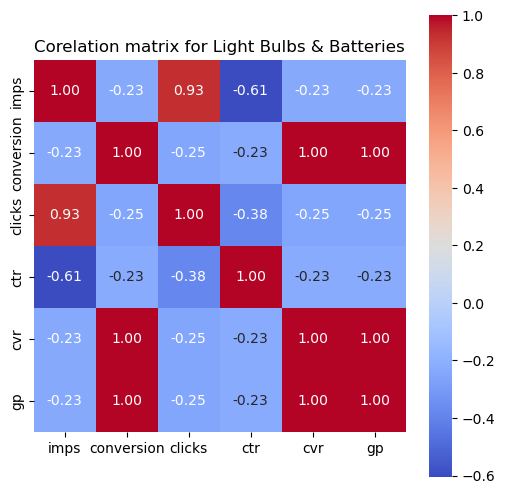

['aa batteries', 'cr2032', '9 v batteries', 'batteries', 'batteries free shipping']


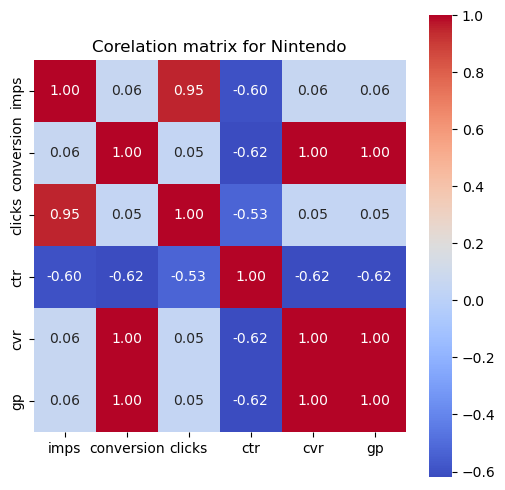

['switch', 'nintendo', 'pa system', 'pokemon', 'nintendo switch', 'super mario wonder', 'tesrs of the kindom', 'xenoblade', 'video games', 'final fantasy']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



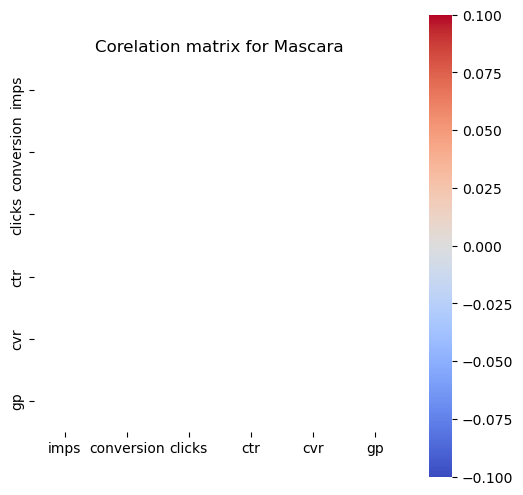

['it superhero mascara']


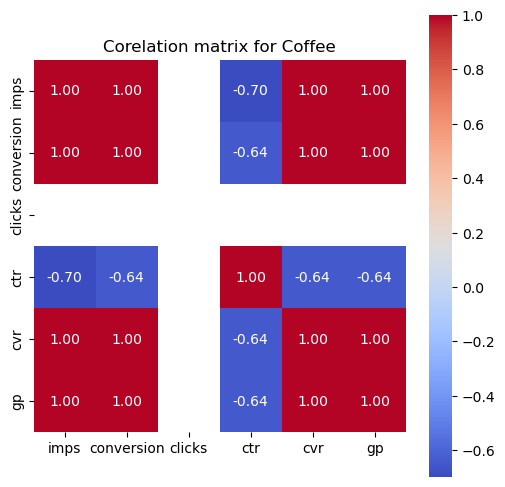

['coffee', 'ipods', 'green tea']


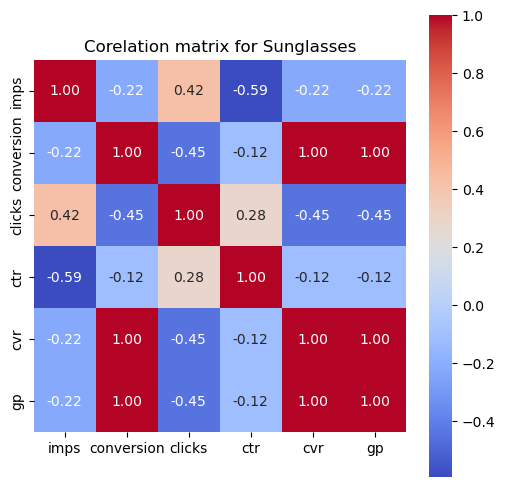

['men’s oakley sunglasses', 'oakley', 'nike', 'tom ford sunglasses', 'sunglasses', 'sunglass', 'rayban', 'black angis', 'holbrook']


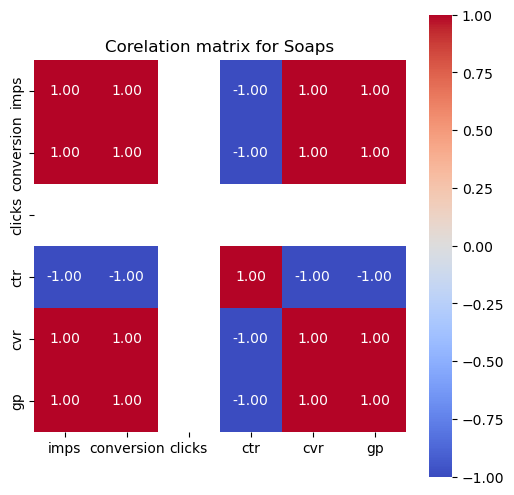

['dove soap', 'soap']


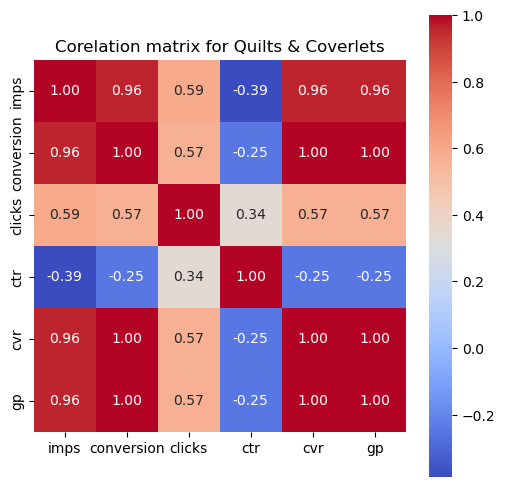

['quilt set', 'palm tree bedspread', 'quito set reversible', 'quilt set reversible queen quilt set purple queen', 'quilt set reversible queen', 'coastal reversable quilt', 'beachy bedspread', 'bedspread', 'king tropical quilt', 'king palm tree quilt']


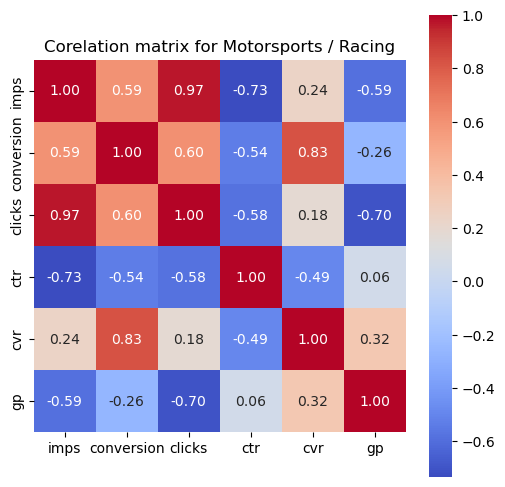

['monster truck', 'monster wherls', 'monster wheels', 'monster trucks', 'monster jam', 'truck show', 'sim racing algonquin', 'hotwheels', 'hot wheels monster trucks', 'hot wheel', 'hoffman estates', 'hot wheels']


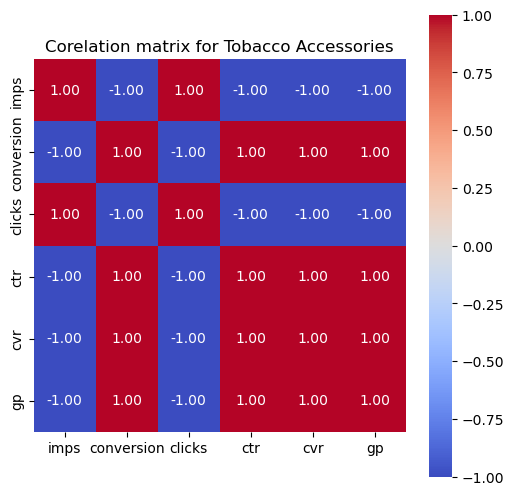

['weed rolling paper', 'glass blowing']


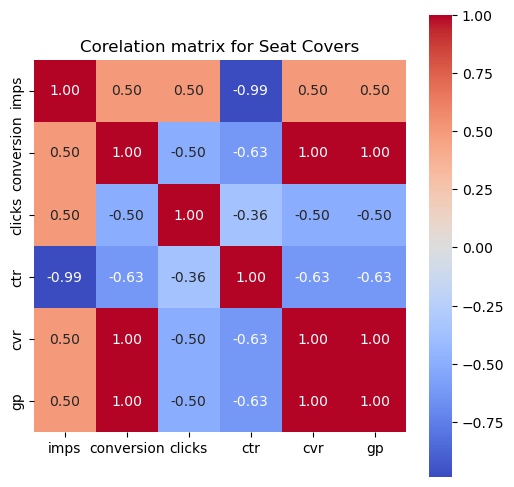

['car seat covers', 'seat covers', 'cars cooling system']


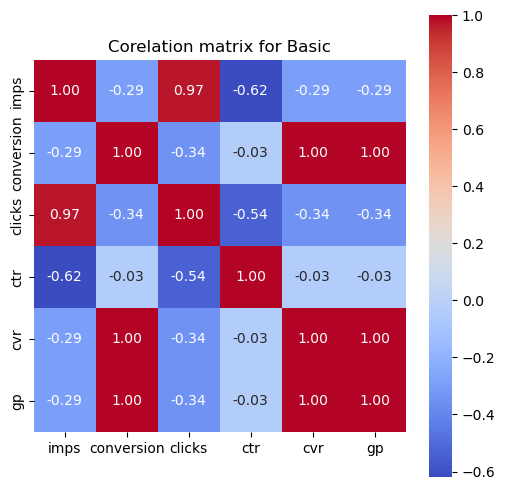

['lined leggings', 'old navy', 'yoga collective', 'women', 'gym top and pants']


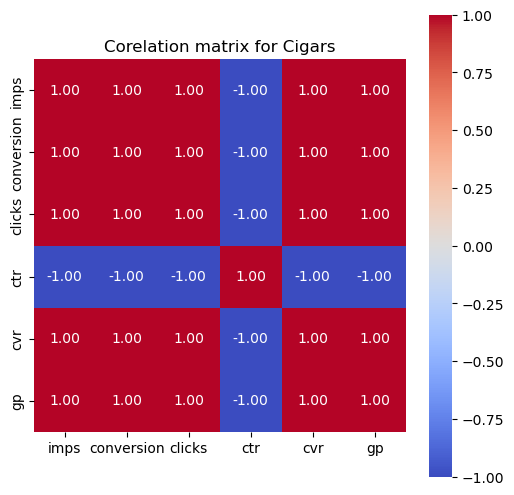

['cigars', 'massanutten']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



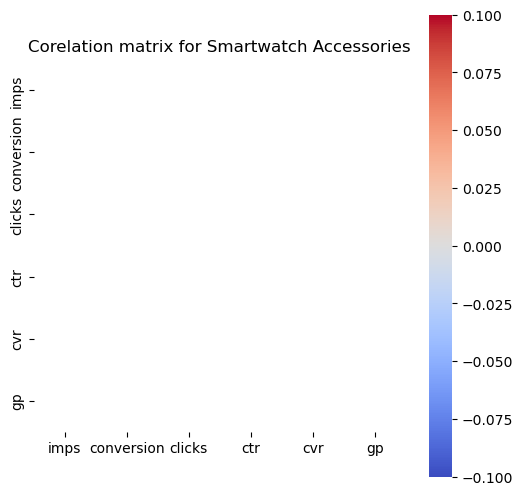

['loop band for apples watch']


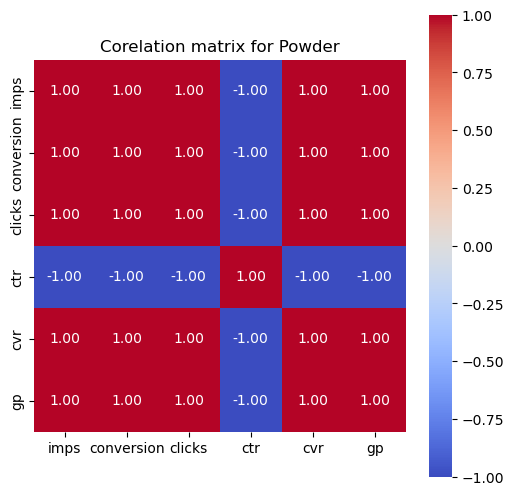

['teeth whitening powder', 'teeth whiteing']


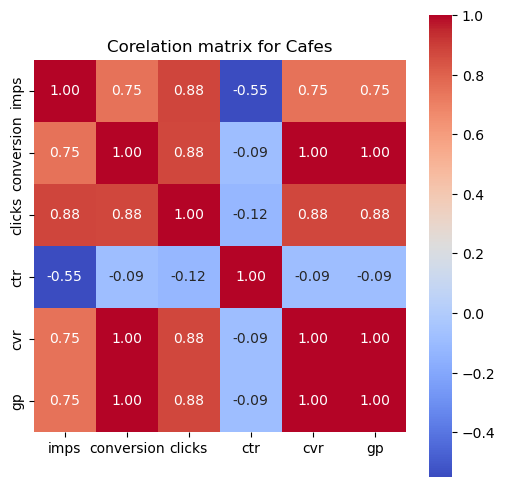

['panera', 'ms bs tea', 'tea tasting', 'starbucks gift card', 'cafe', 'boba tea', 'hot pot', 'fruity ice treats']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



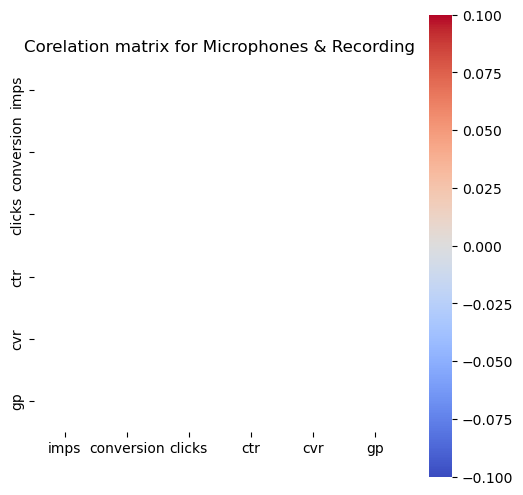

['microphone']


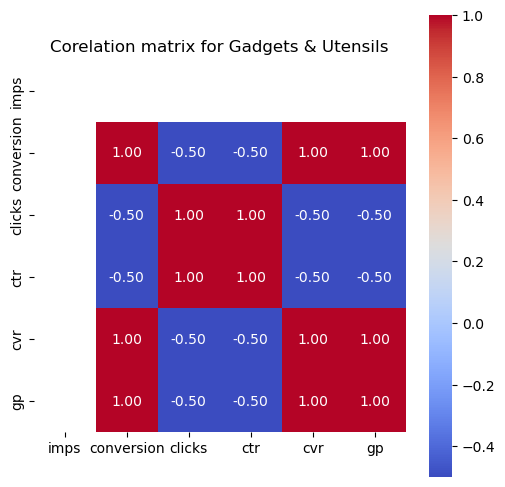

['weed grinder', 'kitchen tools', 'grinder']


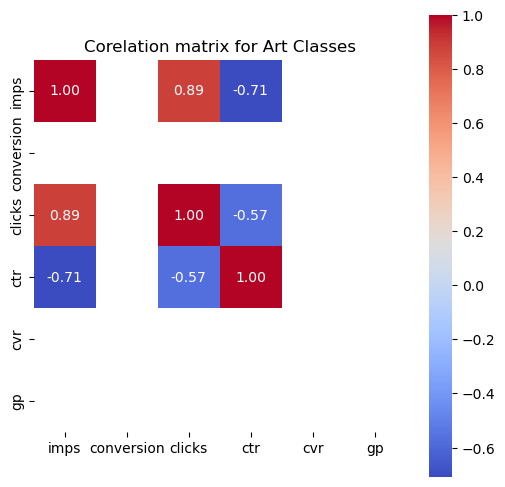

['paint with a twist', 'painting activity', 'paint nite', 'paint nighgt', 'paint birthday party', 'pottary craft', 'long island', 'leo angelo art san diego ca', 'neon brush experience', 'rooftop', 'sacramento', 'splash paint', 'spin art', 'sip', 'art dates', '8062', 'body painting', 'fun dates']


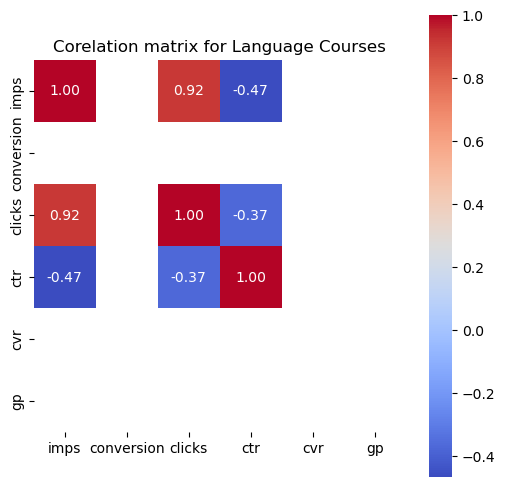

['online classes', 'payroll', 'tesol', 'tefl', 'xcel', 'vegan learn to', 'rosetta stone', 'sign language', 'certificates', 'courses', 'language', 'korean bathhouse', 'learn spanish', 'learn language', 'foreign language', 'german']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



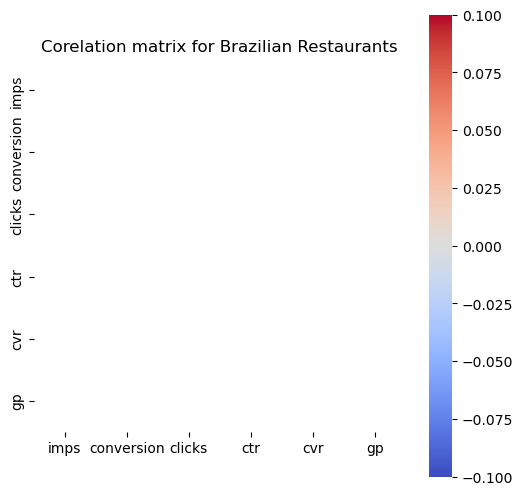

['pampas', 'all you can drink']


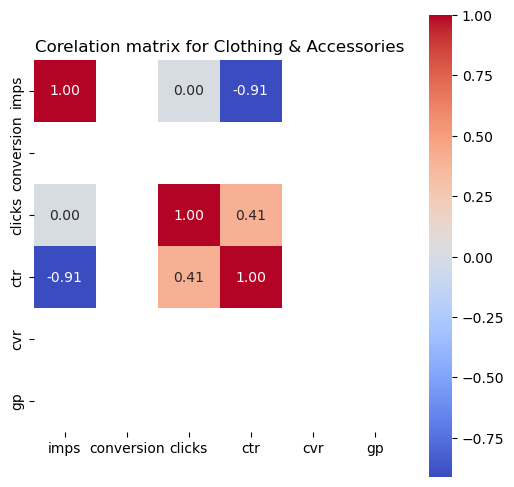

['pandora', 'stamps', 'shein coupon', 'custom t-shirts', 'graduation']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



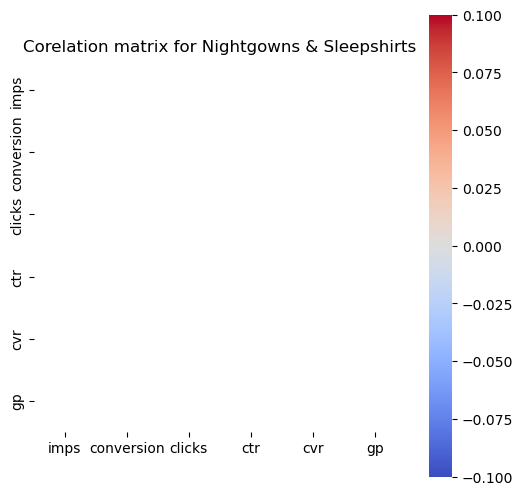

['pajama']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



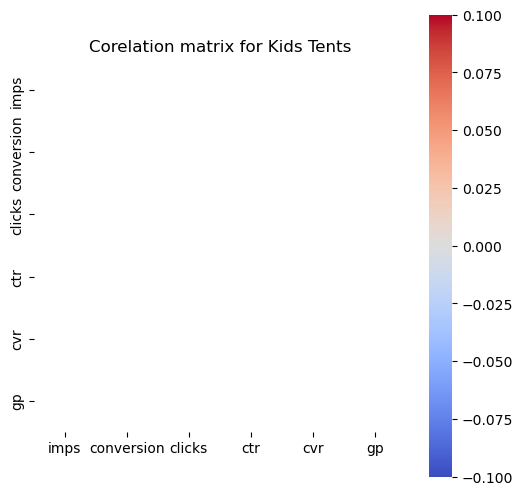

['outdoor carpet']


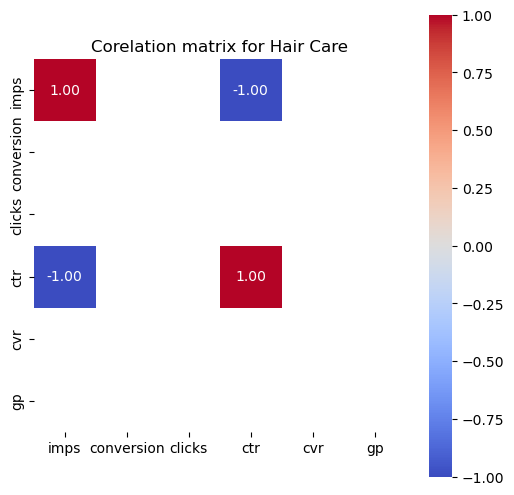

['ouidad', 'night cream', 'pureology hydrate shampoo or conditioner or duo 33.8 oz']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



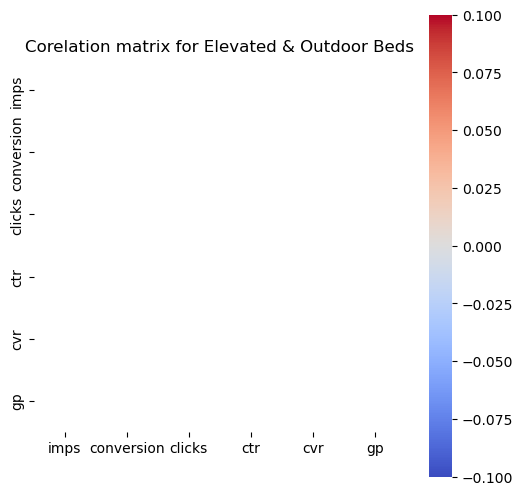

['orthopaedic outdoor dog bed']


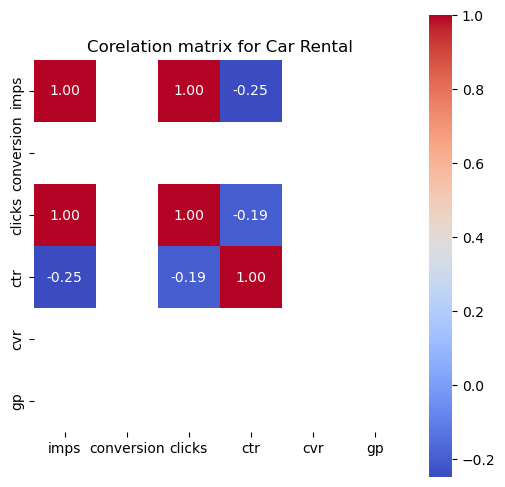

['orlando florida', 'nearby', 'turo car rental', 'road test car', 'rental car deals', 'rental car', 'rent a car', 'slingshot', 'budget car rentals', 'budget car rental', 'budget', 'car rentals', 'car rental', 'deal of the day', 'csr rental', 'auto rental', 'avis', 'alamo rental car', 'enterprise car']


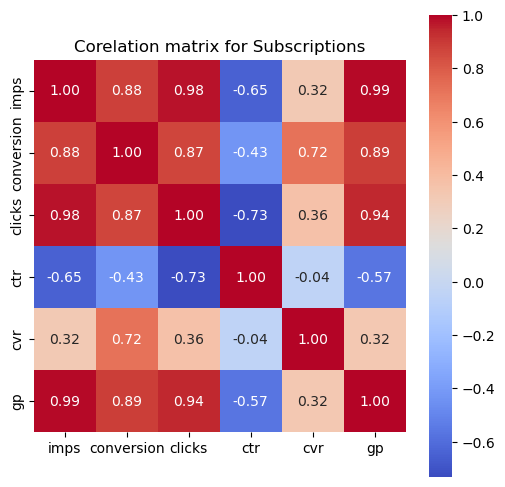

['magazine', 'pandora premium free trial', 'print magazine subscription', 'phoenix home and garden]', 'people magazine', 'magazine subscription', 'nord', 'tv guide', 'robb report magazines', 'sirius radio', 'dogtv', 'colorado magazine', 'ansestry', 'atlantic magazine', 'indianapolis monthly magazine', 'kids magazine', 'ha filers for cheeks', 'free magazine subscriptions']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



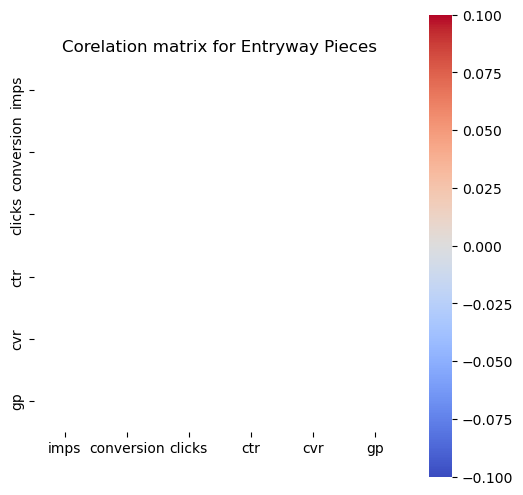

['plant shelf']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



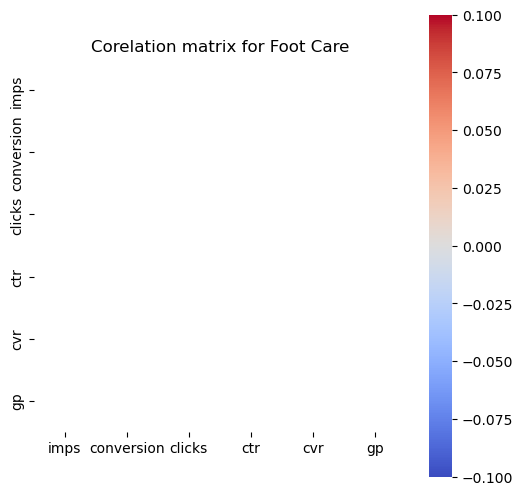

['plastic gel shoe inserts']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



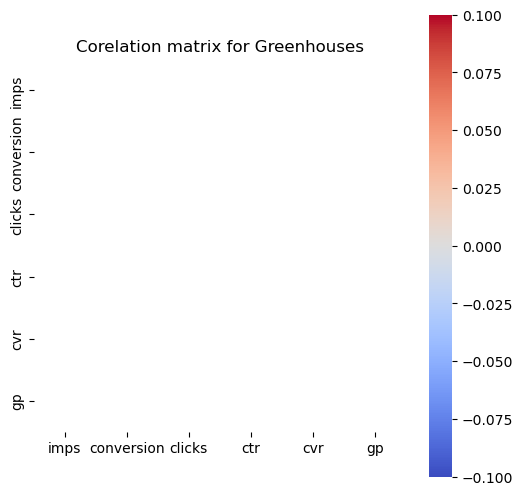

['plants live']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



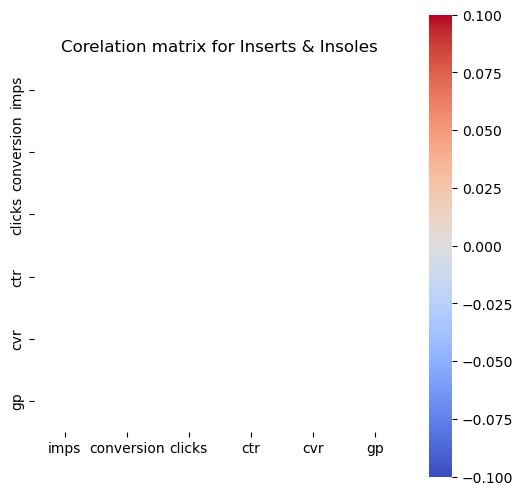

['plantar fasciitis treatments']


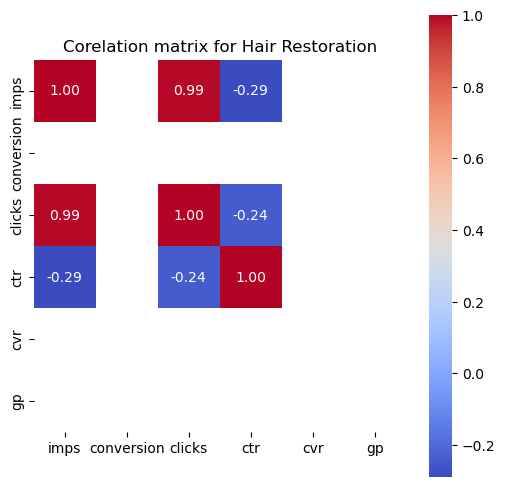

['planet fitness', 'profhilo injections', 'prp for hair', 'prp for hair loss', 'prp hair', 'prp scalp treatment  forest hills', 'prp scalp treatment', 'prp hair restoration', 'dermatologist', 'hair growth', 'hair prp', 'hair transplant', 'hair restoration', 'hair botox treatment']


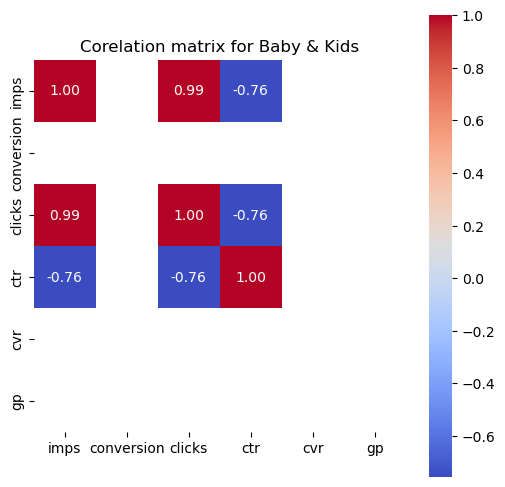

['places to play for kids', 'my groupons', 'customized baby blanket', 'baby', 'first birthday']


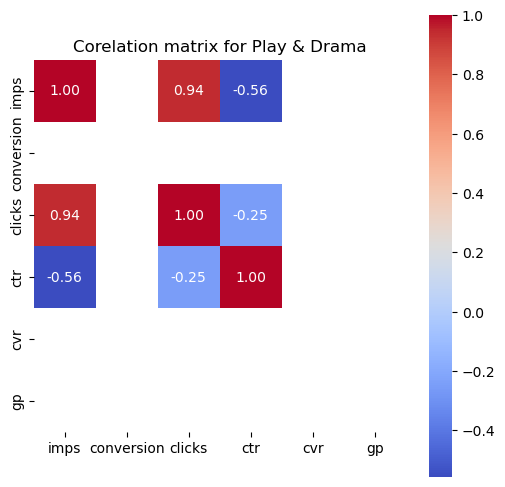

['plays', 'paramount', 'the paramount', 'annie', 'las vegas show']


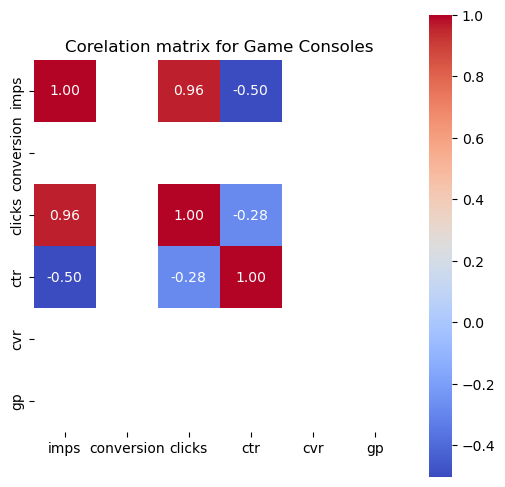

['playstation', 'xobx', 'xbox', 'x-box games', 'ps5', 'ps4', 'retro gaming', 'retro', 'arcade and bar', 'hefty load of the', 'handheld game', 'garmin']


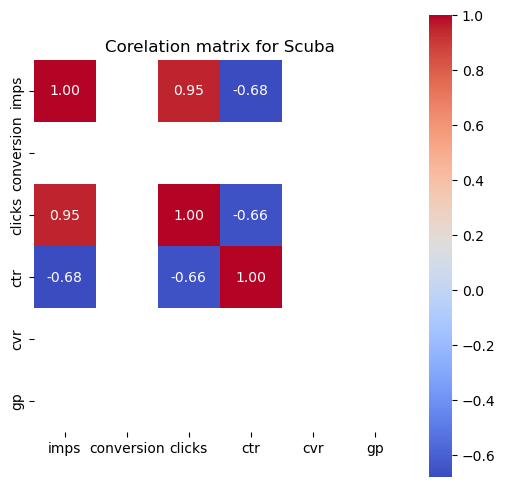

['polynesian cultural center', 'scuba', 'diving', 'advanced open water', 'advance scuba certification', 'blue holic scuba advanced']


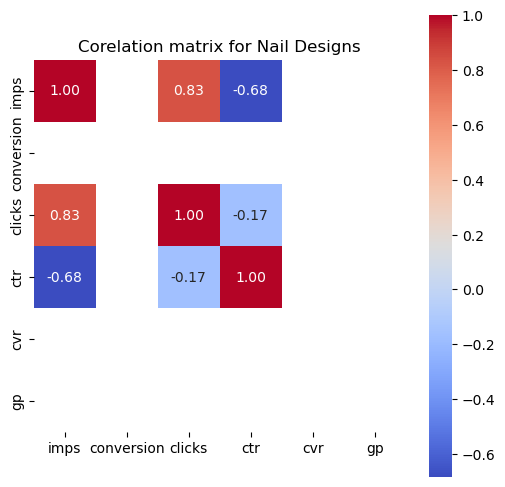

['polish me lee', 'mail salon', 'nail set', 'nail extensions', 'claynor', 'full set nails', 'gel x manicure', 'gel nail with spa pedicure']


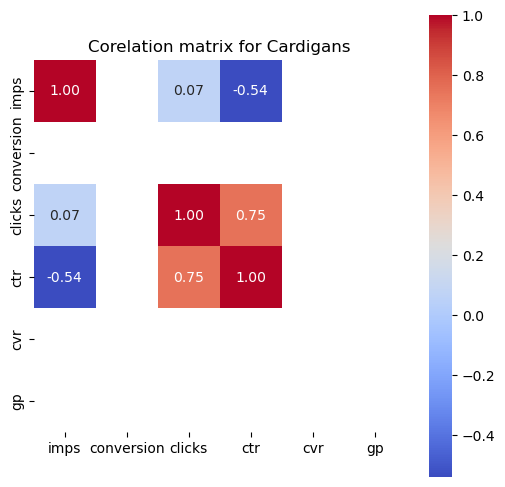

['plus size', 'long cardigan', 'sweaters', 'sweater full length', 'cardigan', 'kiminos']


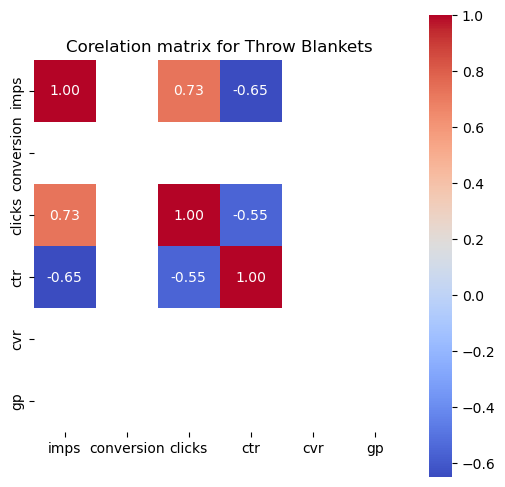

['plush throw blanket', 'blanket', 'aztec throw blanket', 'hooded blanket', 'dymo peinter']


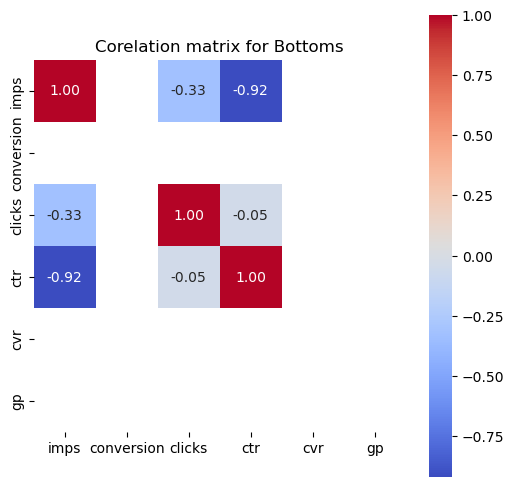

['plus size men shorts and top', 'mens shorts', 'training shorts', 'womens jeans']


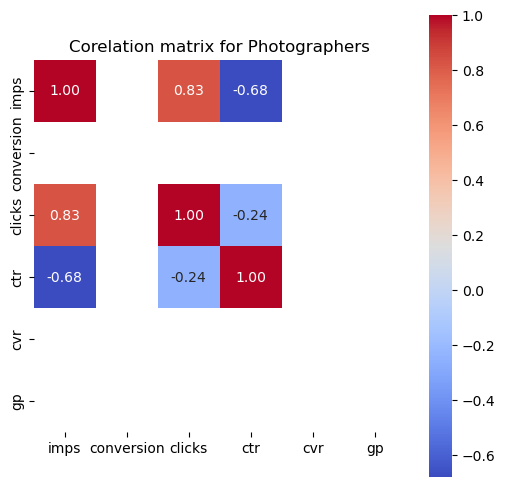

['pig', 'photo booth', 'photograph', 'maternity photo shoot near me', 'wedding photographer', 'wedding photography', 'chemberli', 'headshots', 'headshot', 'group deals']


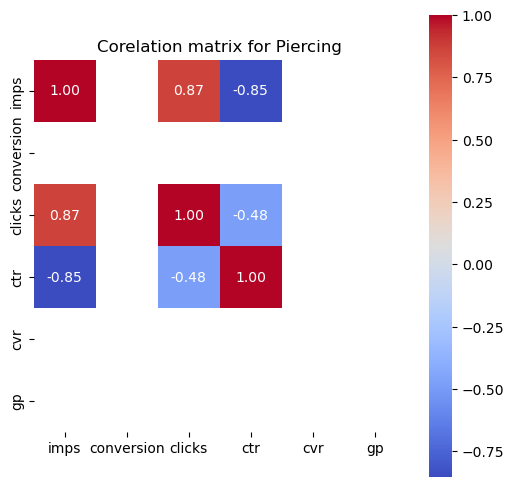

['piercing', 'ear piercings', 'ear piercing']


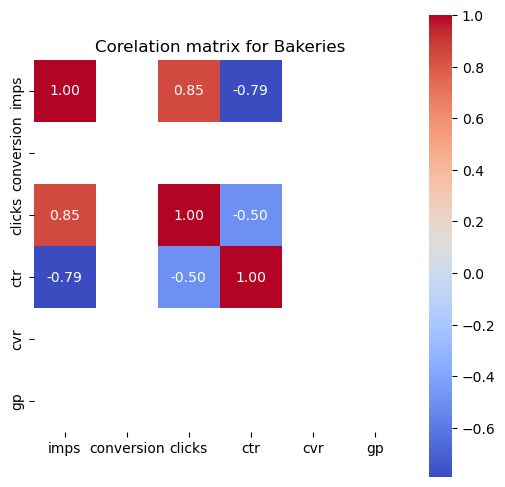

['pie', 'cookie', 'bakery', 'krispy kreme', 'duck donuts', 'dough joy', 'frozen drinks']


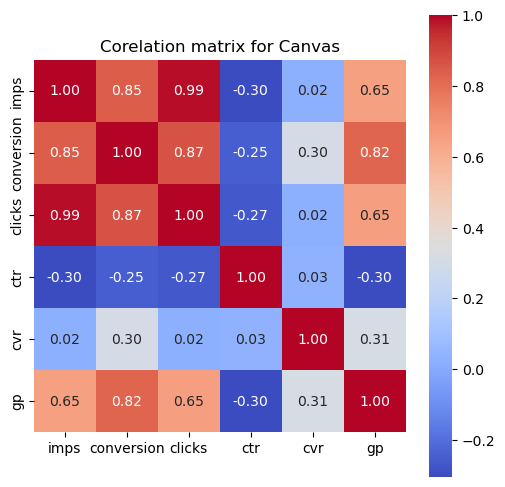

['canvas print', 'canvas', 'art', 'canvas prints', 'photo', 'photo canvas', 'canvas 30x40', 'metal prints', 'canvas p', 'paint and sip columbia sc', 'paint protection', 'picture on metal', 'pictures', 'picture canva', 'print photos', 'poster prints', 'panoramic canvas print', 'photo prints', 'photo csnvas', 'personal trainor', 'metal print', 'shutterfly photos', 'smallwood frame', 'canvas 11x14', 'canvasonsale', 'canvas with shipping', 'canvas photos', 'canvas on sale', 'canvas on demand free ship', 'canvas on demand', 'canvas free shipping', 'canvas collage', 'canvas 9x12', 'canvas 16x20', 'cvs prints', 'custom. framing', 'custom wall art acrylic', 'custom wall art', 'custom', 'arcrilic nails', '16x61 canvas print', '35x45 metal print', '48x36', '4 16x20 canvas prints', '30x40 canvas', 'acrylic nails', 'acrylic print', 'large canvas', 'large canvas print', 'gallery-wrapped prints from simple canvas prints']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



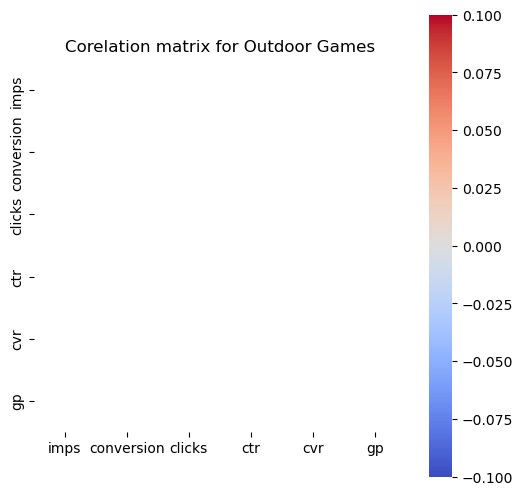

['pickleball']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



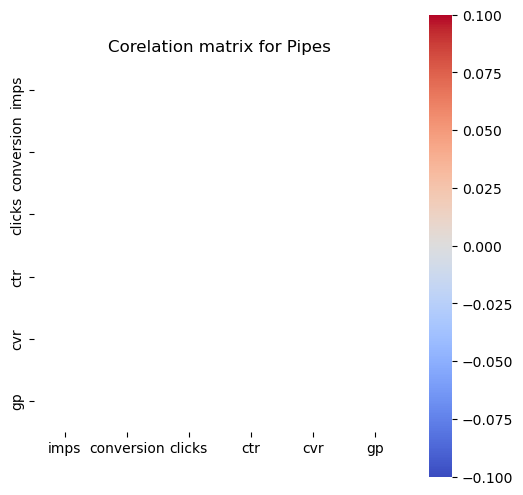

['pipes']


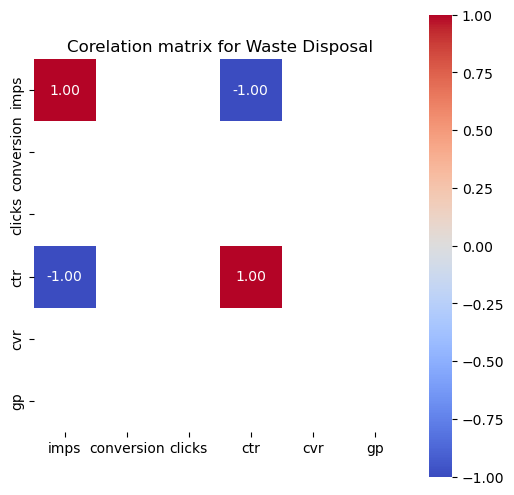

['poo bags', 'dog poop bags']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



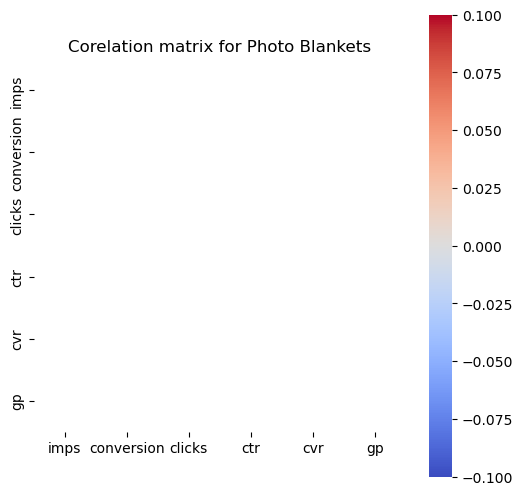

['printeroix']


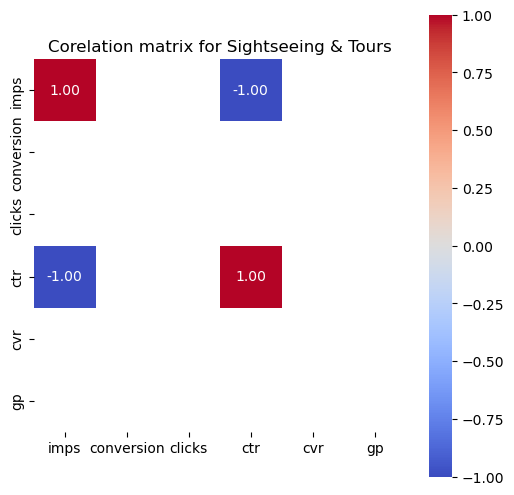

['priceline', 'booking.com']


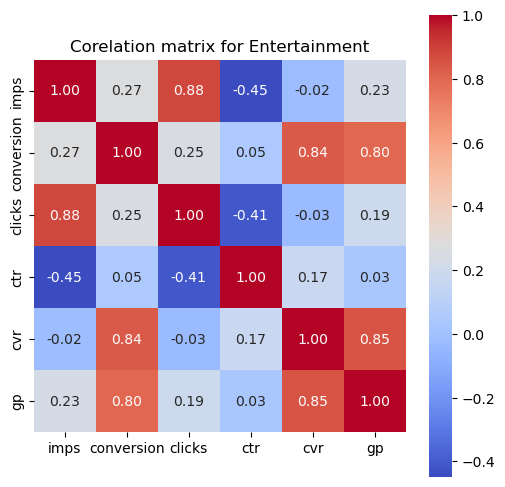

['flagship brunch san diego', 'dinner cruise', 'philadelphia cruise', 'adult entertainment', 'price is right wallingford', 'price is right', 'protools', 'mauka warriors luau', 'live music', 'lu’au', 'lux candle', 'naples florida', 'ocean voyage', 'midevil times dinner', 'murder mystery', 'sunset sailing', 'sunset sail', 'the price is rite', 'things to do sunday', 'victory cruise cape canaveral fl', 'variety show', 'valentine’s day dinner', 'valentines day dinner', "valentine's day dinners", 'volunteer princess', 'san francisco bay cruises', 'public history tour', 'restaurant week dinner cruise', 'sleuth mystery', 'ski lift tickets pa', 'chicago auto show', 'brunch cruise', 'casino cruise', 'day cruise miami', 'day cruise', 'dallas', 'dj', 'dinner for two', 'dinner dectective', 'dinner boat', 'dinner', 'cru', 'cruise kids', 'cruise in', 'cruise dinner', 'alligator', 'Aug 28', '3 day cruise', 'booze cruise', 'boat celebreties', 'bounce it up', 'immersive gamebox', 'jodeci king theater', 

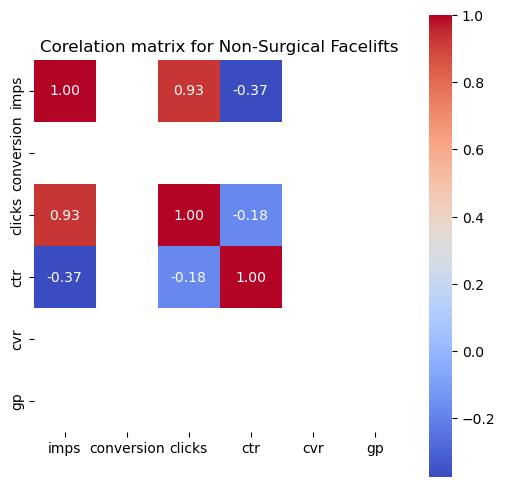

['prf under eyes', 'pdo', 'pdo  threads', 'pdo t', 'pdo thread', 'pdo threats', 'pdo threads', 'pdo threadlift', 'pdo threading', 'lift', 'non surgical', 'mono threads', 'theads', 'threads', 'thread lifts', 'thread lift', 'thread', 'jaw thread', 'jaw facelift', 'face threading', 'foxy eye pdo']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



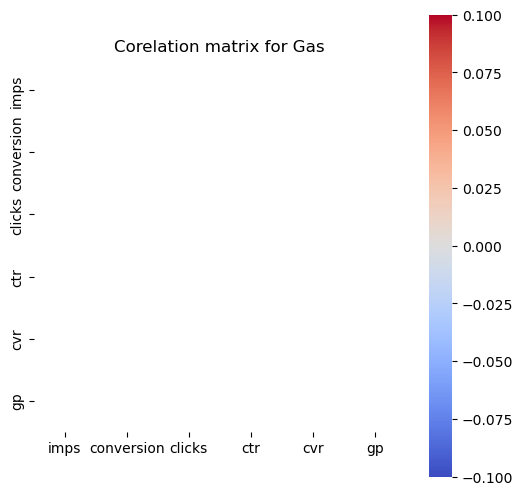

['propane']


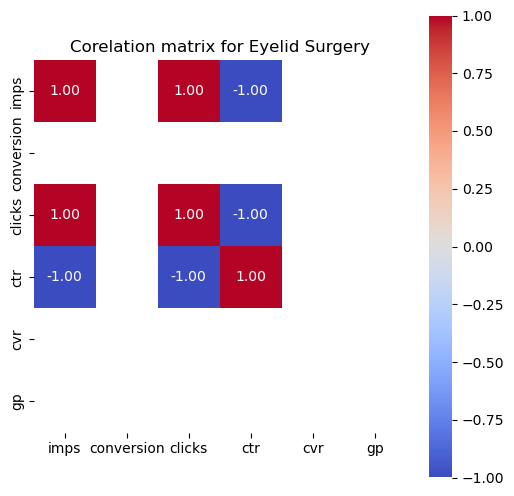

['pro thread lift', 'eye lid']


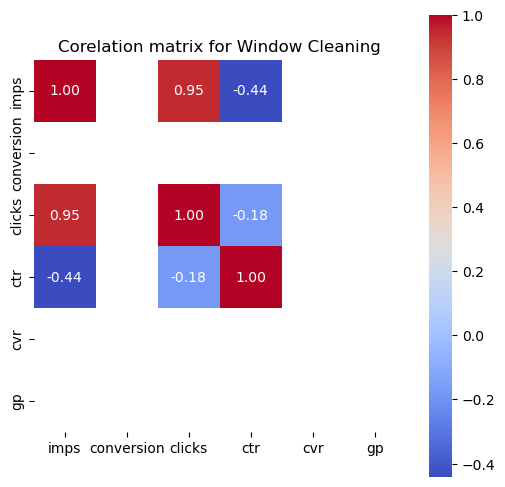

['pressure washing', 'window washing', 'window wadhing', 'window cleanng', 'window cleaning service', 'window cleaning', 'solar panel cleaning', 'house cleaning in orange county']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



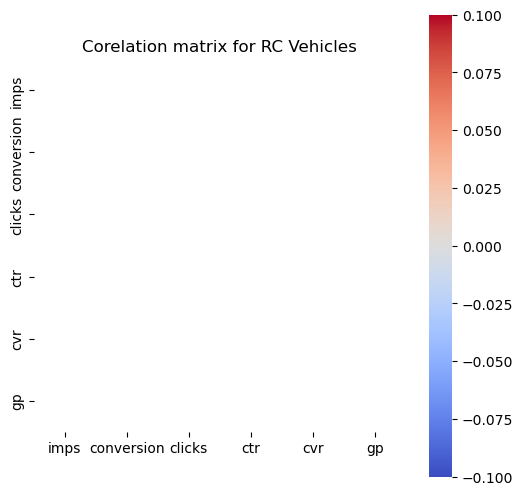

['preschool age']


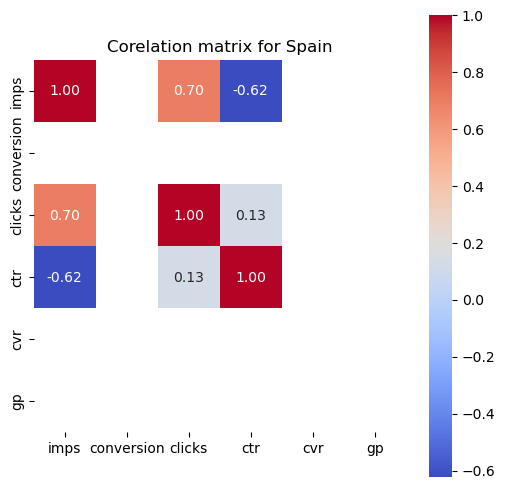

['portugal and spain', 'lisbon porto trip', 'madrid', 'spain']


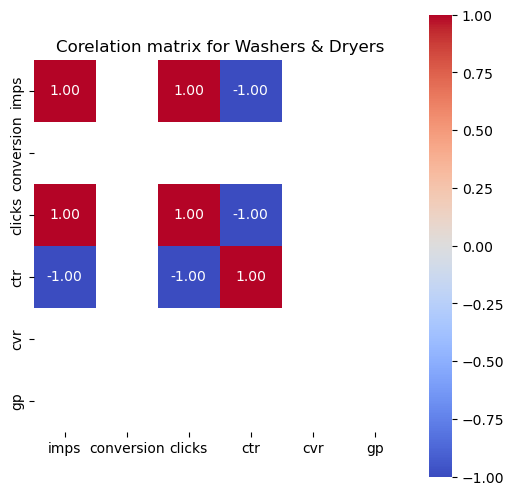

['portable washing machine', 'basket']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



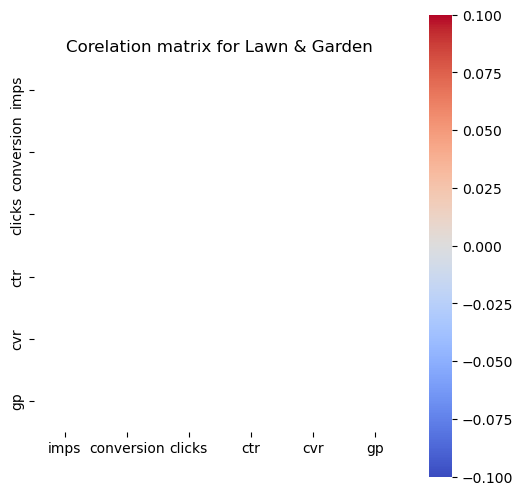

['pool service']


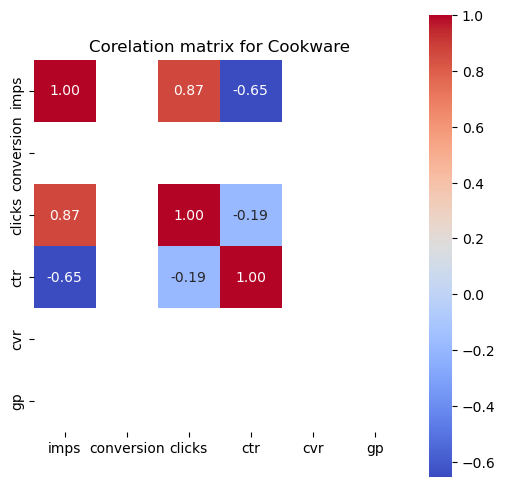

['pots', 'cast iron lid 10 inchg', 'cast iron']


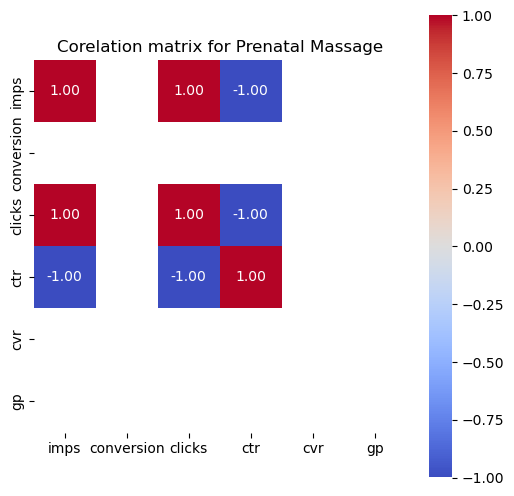

['prenatal', 'maternity massage']


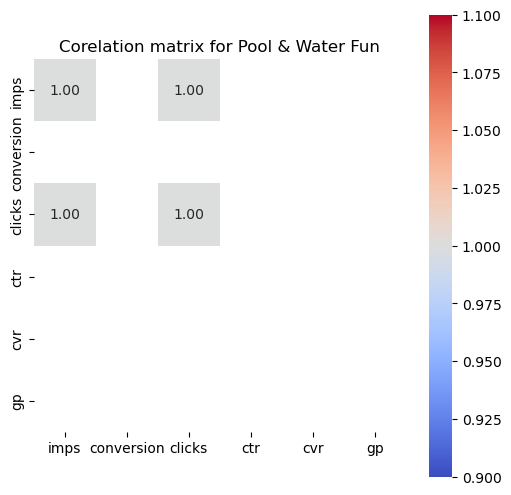

['pregnant', 'floating']


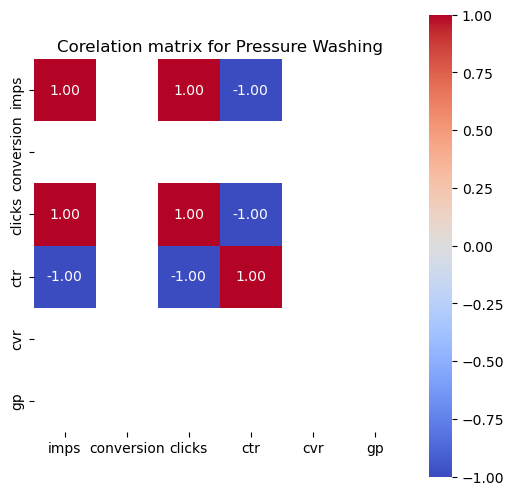

['powerwash', 'power wash house']


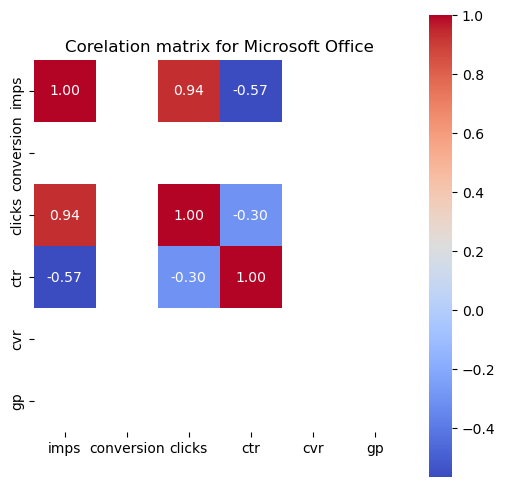

['powerpoint', 'office depot', 'data entry course', 'excel courses', 'excel']


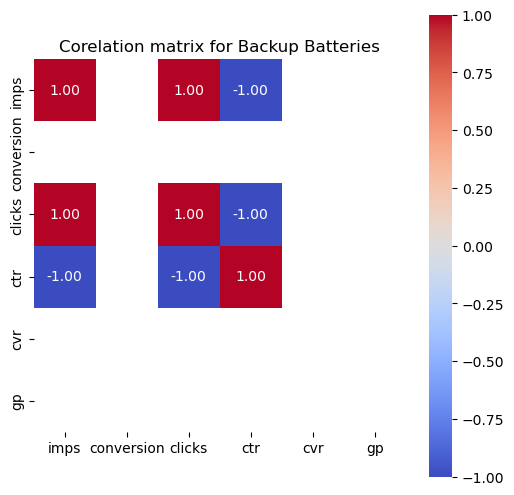

['powermaster usc', 'power bank for iphone 14pro max']


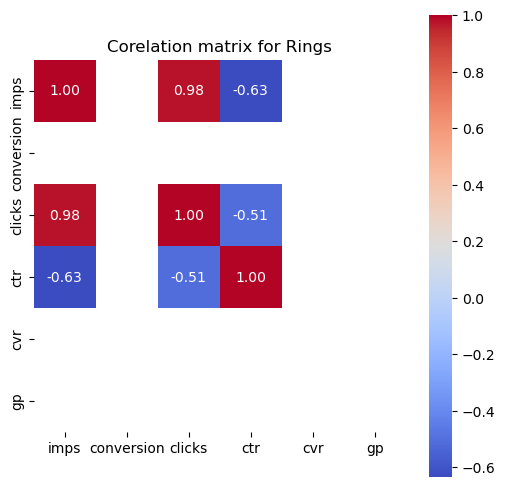

['power steering flush', 'penis prosthetic', 'men’s ring', 'mens silcone wedding bands', 'swaroski rings', 'sex toys ring', 'sex toy', 'diamond rings for women', 'diamond ring', 'aaa service', 'adult massagers', 'gemstones']


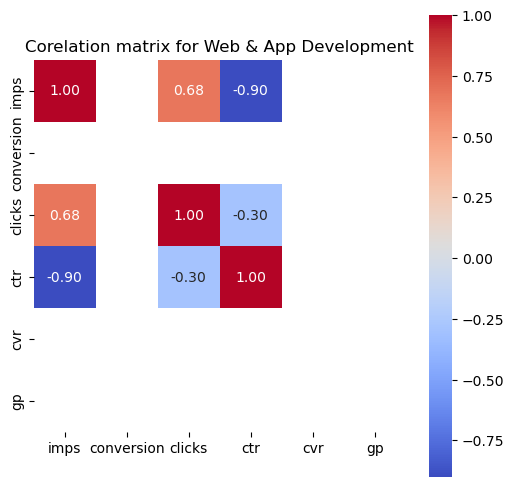

['photoshop', 'adobe suite', 'adobe photoshop', 'adobe acrobat']


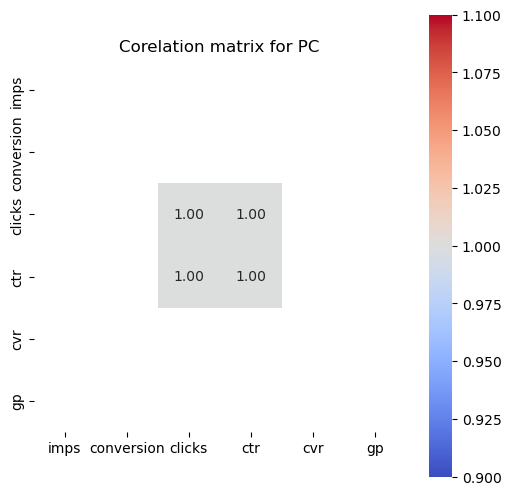

['pc', 'computers', 'laptop hp 128 gb 4 gb ram']


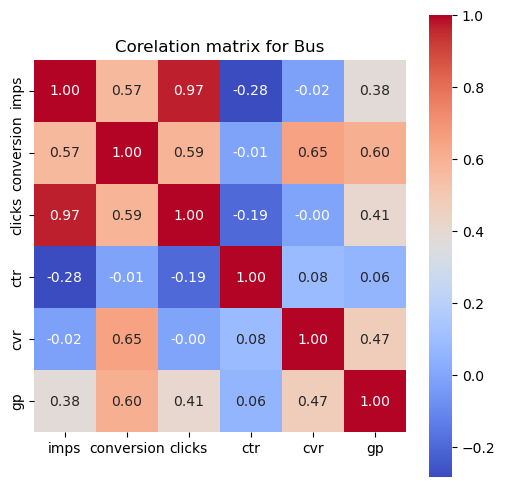

['relny', 'real estate', 'big bus', 'bus', 'classes', 'cannabis', 'aceable', 'florida real estate 45 hour', 'crawl', 'azure tide', 'real estste', 'weed', 'old town trolley tour', 'online real estate', 'online real estate course', 'pistons game', 'property ans casualty', 'pool party', 'patty bus', 'party bus', 'miami tours', 'make up', 'marijuana growing', 'national park express', 'night bus', 'notary training', 'nola ghost riders', 'millineum tour', 'microsoft surface', 'monuments by moonlight', 'training', 'tour guides', 'top view night', 'trolley tour', 'the ride', 'texas real estate', 'wine and painting', 'wildlife safari airboat ride', 'woodberry outlet bus ny', 'woodbury common', 'vegas helicopter', 'washington pre-licensing real-estate', 'savannah ga trolley', 'real estate u', 'realestateu new york', 'realestateu', 'real states', 'real estateu', 'real estate online glass', 'real estate license course', 'real estate license', 'real estate exam', 'real estate course florida', 'real

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



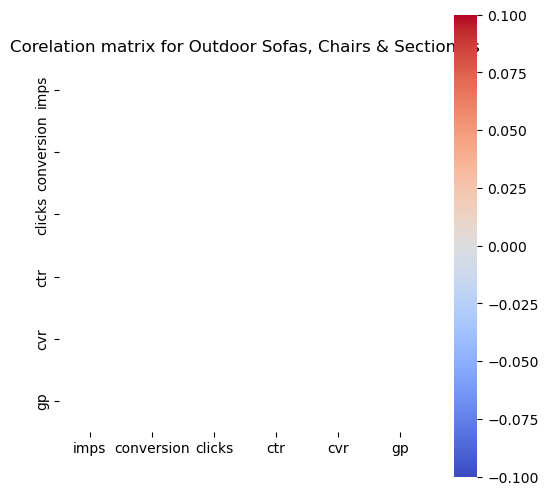

['patio table']


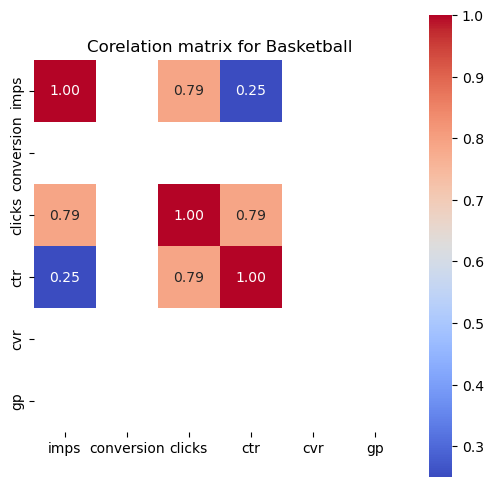

['pat the rock', 'summer camp', 'wizards', 'lakers', 'kids pla']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



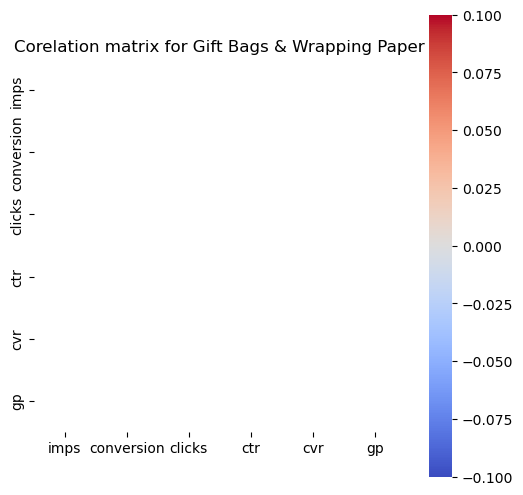

['party paper products']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



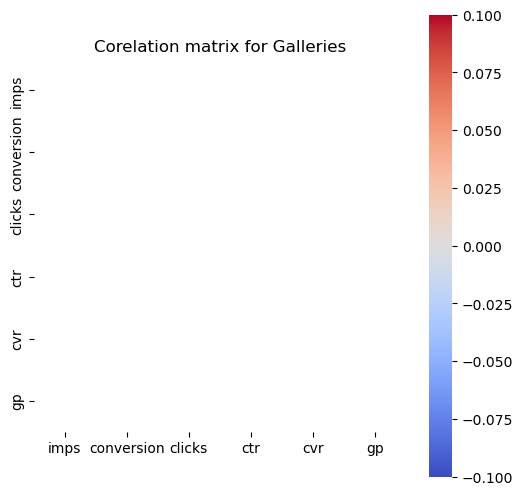

['photography museum']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



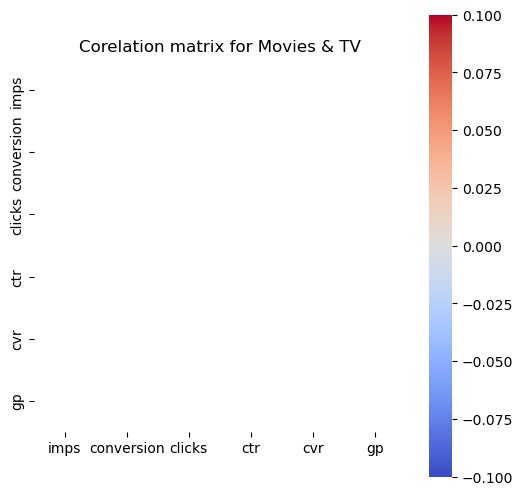

['peacock']


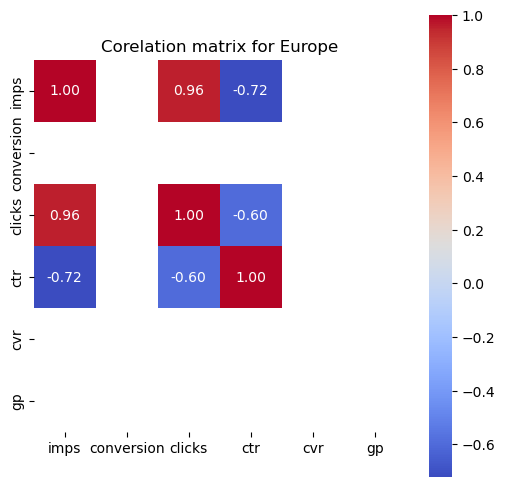

['paris trip', 'mystery vacation', 'mystery getaway', 'travel italy', 'travel to europe', 'trip to ireland', 'vacations', 'vacation with flights', 'vacation flights', 'san francisco vacation', 'all inclusive with air', 'allure sp', '5 day cruises to mexico', 'ipic', 'ireland travel', 'hawaii aulani', 'flights to thailand', 'finland']


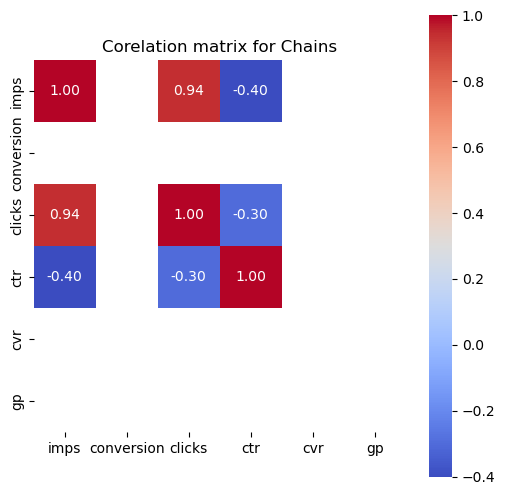

['paper clip necklaces', 'white gold plated puffedmariner chain', 'sterling silver necklace', 'sterling silver chain', 'silver chain', 'cross necklace', '14 kt gold necklace', 'hand therpy  metal glove', 'jewelry cabinet', 'jewelry', 'gold necklaces', 'gold necklace', 'gold chain', 'gold 10k']


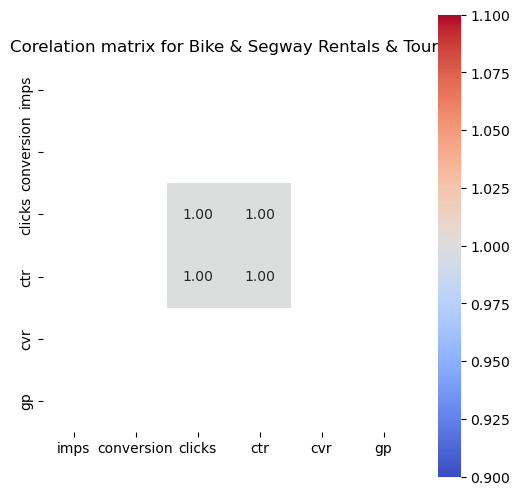

['party bike', 'santa barbara']


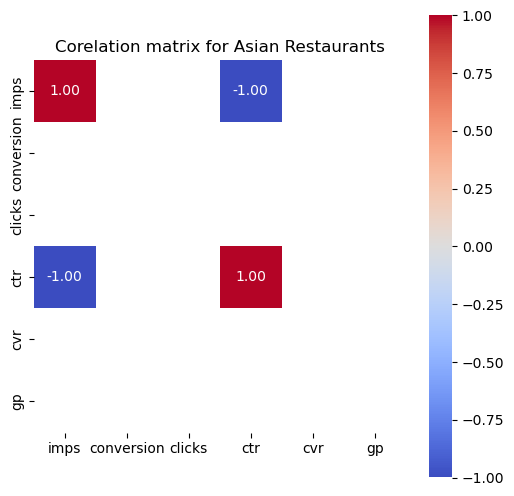

['pho', 'remingtons of niagara restaurant', 'kinnara thai restaurant']


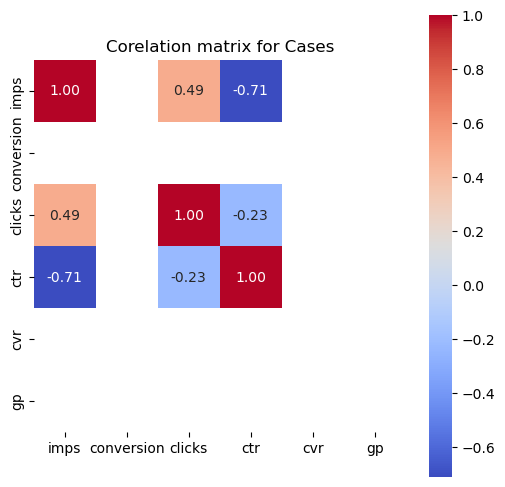

['phone cases', 'call of duty', 'i phone 16 plus case', 'iphone se  3rd generation', 'iphone 15 case', 'ipad cover']


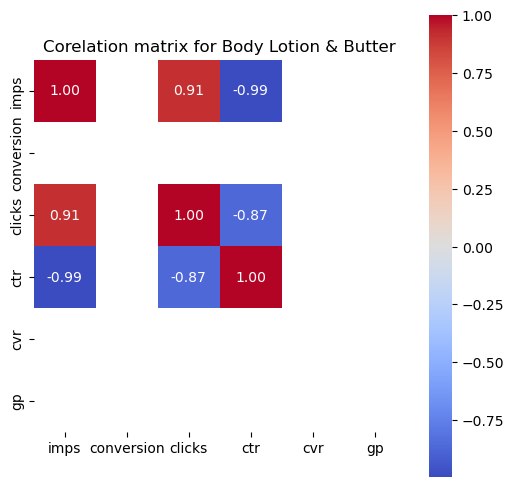

['philosophy', 'indoor tanning lotion', 'hempz']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



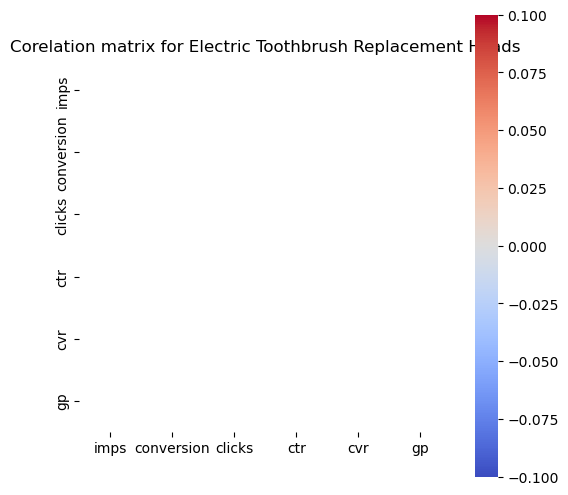

['philips sonicare']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



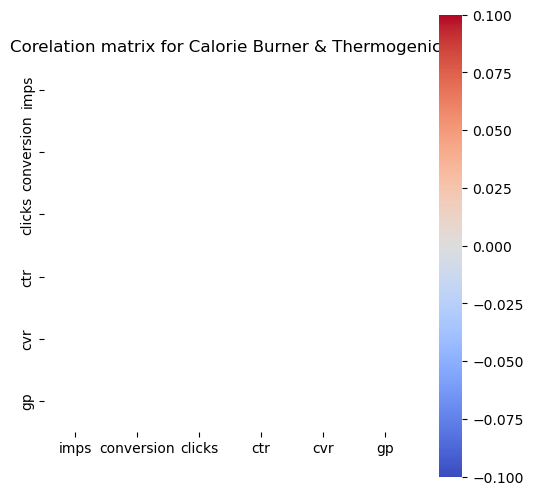

['phenrx']


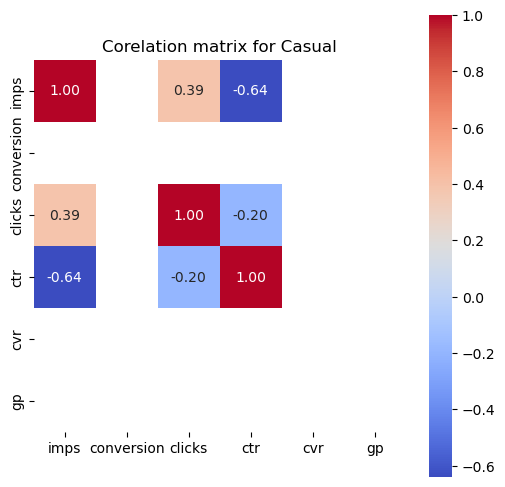

['petite midi skirt', 'mens clothes', "men's wool socks", 'tall men’s full fleece lined heather grey jogging pants', 'summer dresses women', 'socks', 'shoes', 'cargo pants', 'heels for him', 'flece pants', 'dresses']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



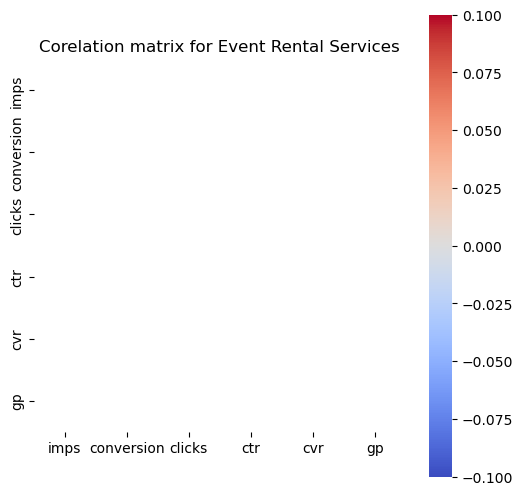

['photobooth']


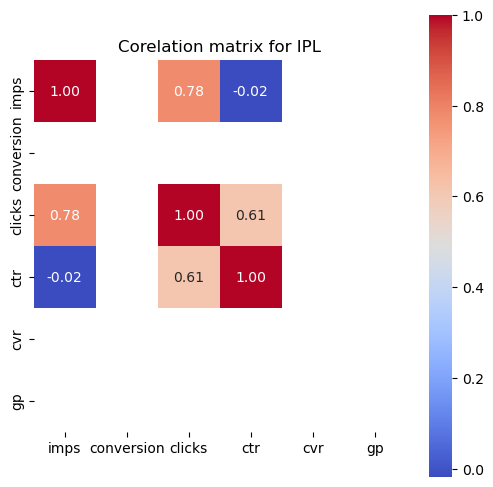

['photo facial', 'láser medical spa', 'ipl for strech marks', 'ipl austin']


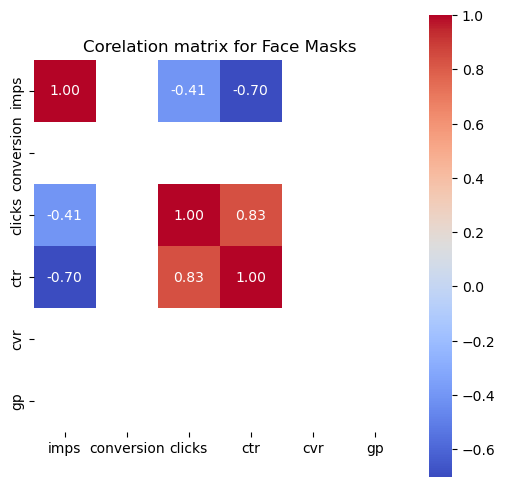

['peter thomas roth face tightener', 'sheet mask', 'facial masks', 'facial mask']


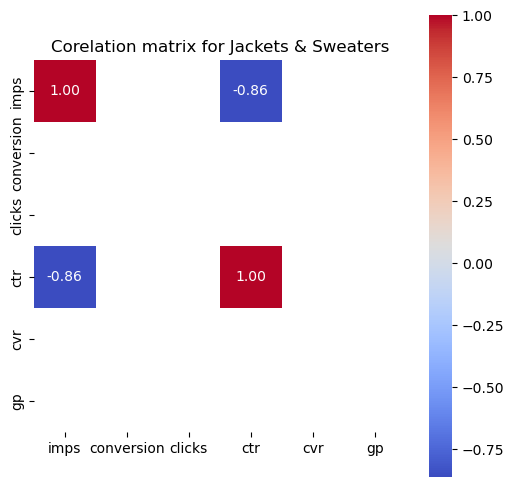

['pet sweaters', 'clothes', 'dog sweaters', 'dog jackets', 'dog coats']


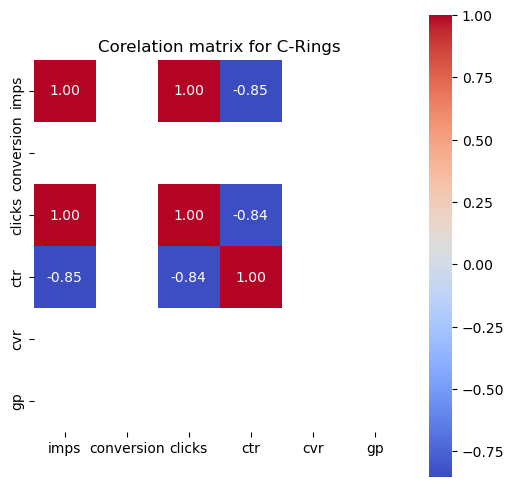

['penis prosthetic', 'sex toys ring', 'sex toy', 'adult massagers']


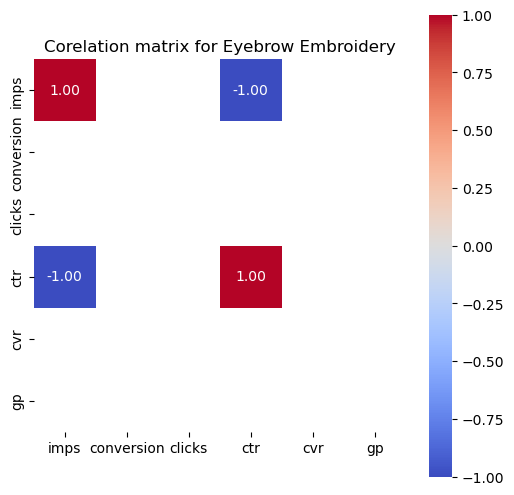

['permanent eyeliner and eyebrow bundles', 'thermage eyebrow', 'eyebrow cleanup and tint     waxing']


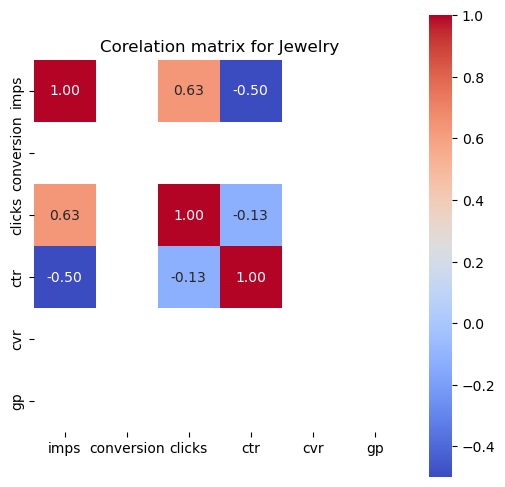

['permanent bracelet', 'permanent jewelry', 'personalized hat', 'personalized belt', 'name necklace', 'morganite necklace', 'mothers ring', 'storage facility', 'silver jewelry', 'class ring', 'car show', 'anklet', '2025 flower show', 'jewlry', 'jewlery']


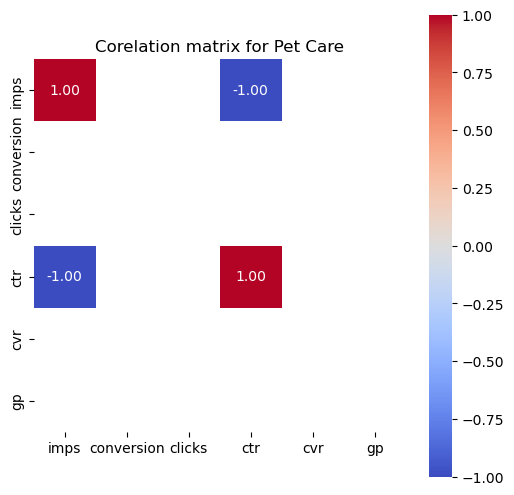

['pet smart', 'personal chef']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



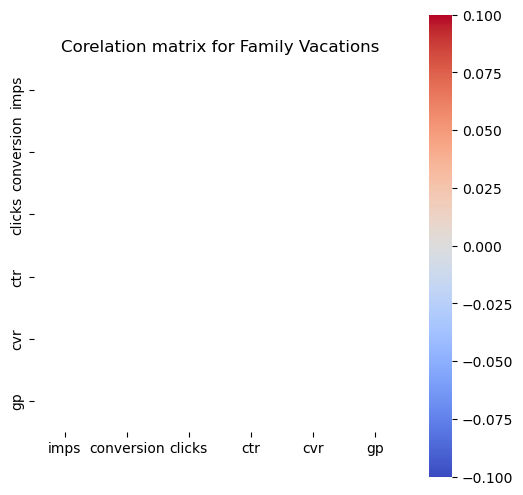

['pennsylvania', 'san antonio texas', 'hotels near dream works nj']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



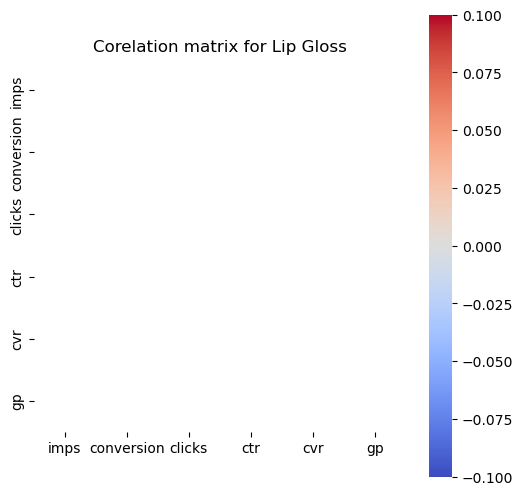

['permanent lip liner']


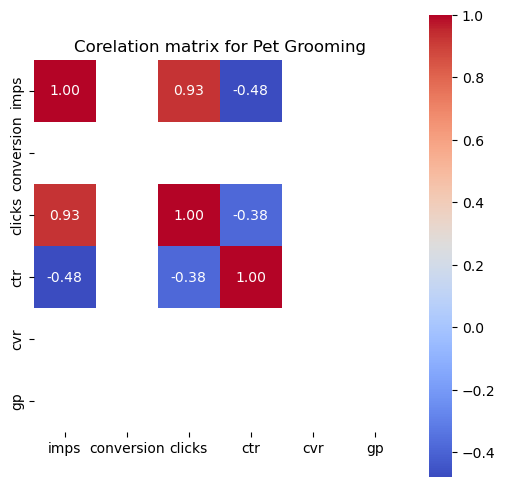

['pet grooming  and dps', 'pet grooming', 'mobile pet grooming', 'puppy grooming', 'cat grooming', 'dog grooming', 'groomer', 'grooming']


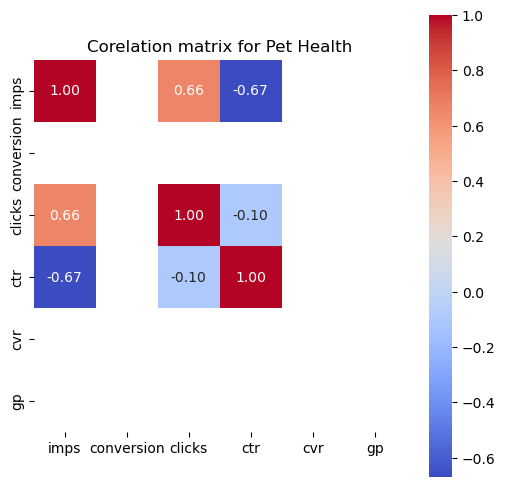

['pet allergy test kit', 'vet', 'rabies vaccine', 'dog dna', 'dog lab test', 'dog haircut', 'dog allergy test', 'insurance']


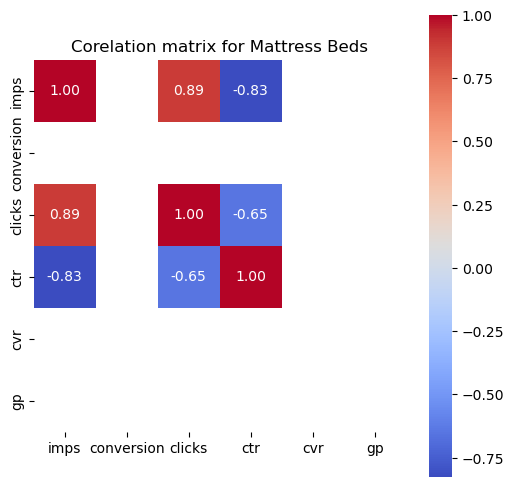

['pet', 'warm', 'puppy', 'southwest airline', 'dog beds', 'jumbo dog bed', 'furhaven']


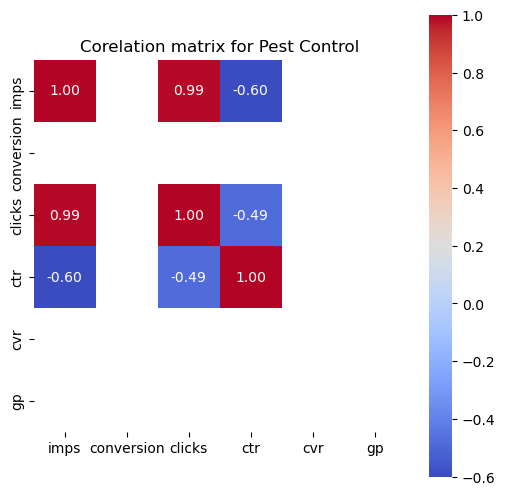

['pest control', 'pest', 'mosquito', 'tree service', 'roach spray']


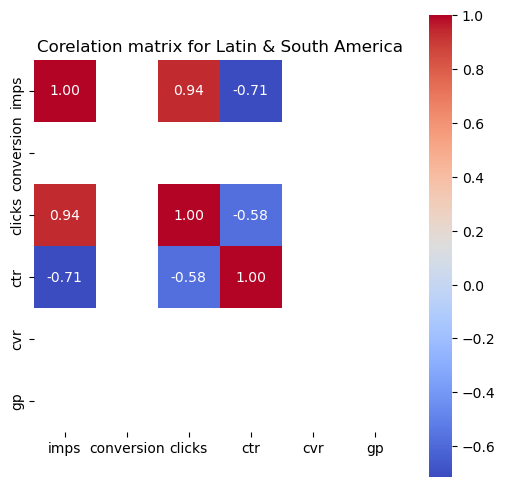

['peru', 'travel by jen', 'trips', 'trip', 'vacation deals', 'costa rica', 'all inclusive plus airfare', 'airfare', 'hotels puerto rico', 'hawaiian getaways']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



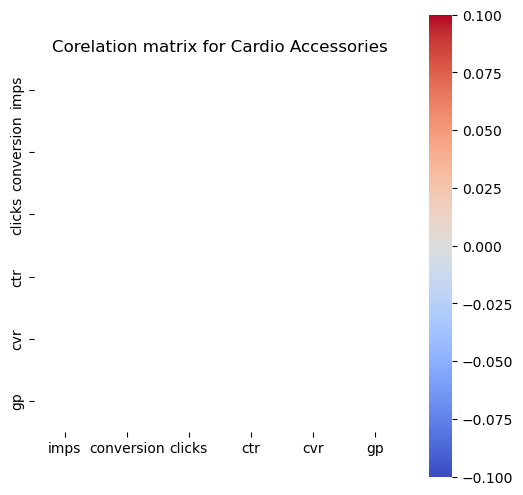

['perspire infrared sauna']


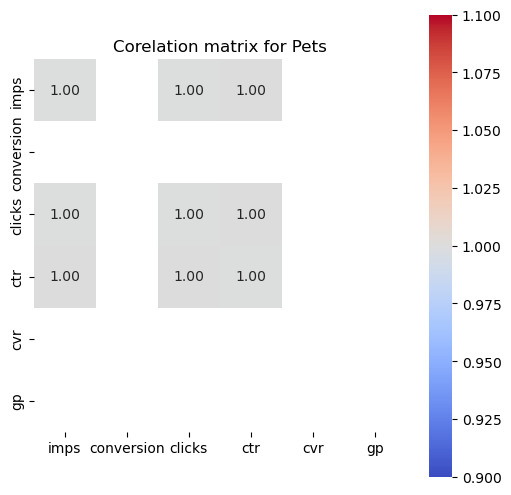

['personalized dog collar', 'dog training']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



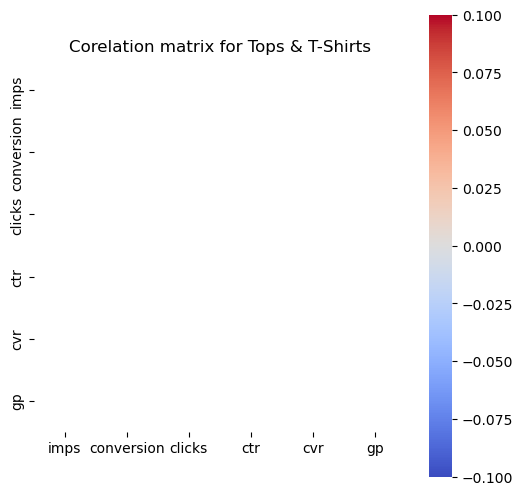

['maternity']


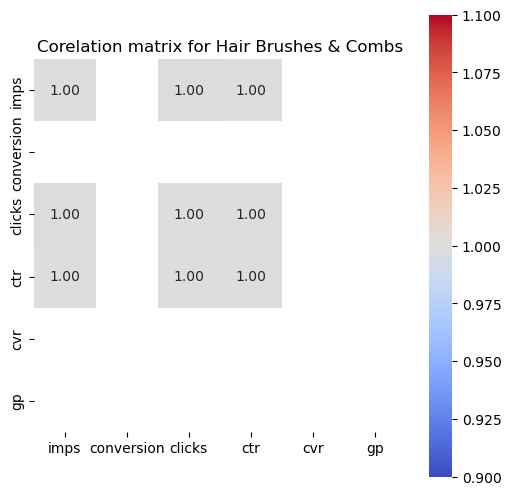

['masón pearson b1', 'mason pearson pocket', 'red/blue light brush']


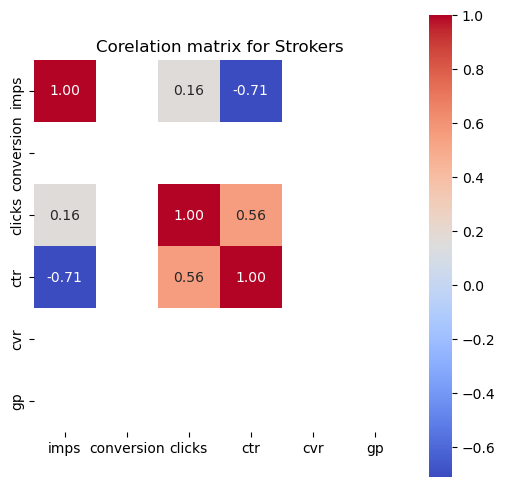

['masturbator', 'male sexual', 'stroker', 'sex toys for men', 'sex doll']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



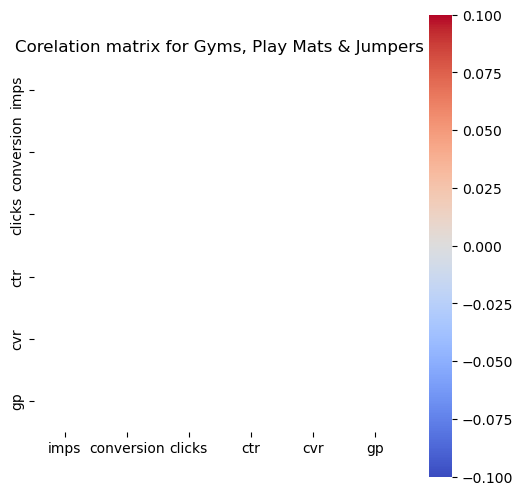

['mbys foldable foam baby play mat for playpen 50"x50", reversible waterproof']


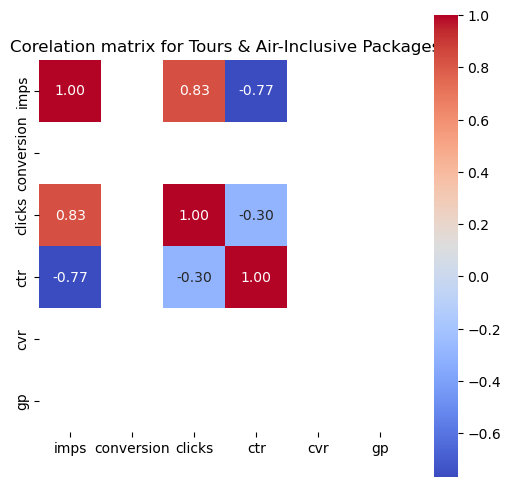

['maxico vacations', 'train', 'travel to japan', 'trips to eruope', 'switzerland', 'thailand', 'with air', 'vacations to ireland', 'dcx', 'all inclusive vacation with air', '1/18/25-1/20/25', 'ireland', 'japan ski', 'japan', 'flights to barcelona']


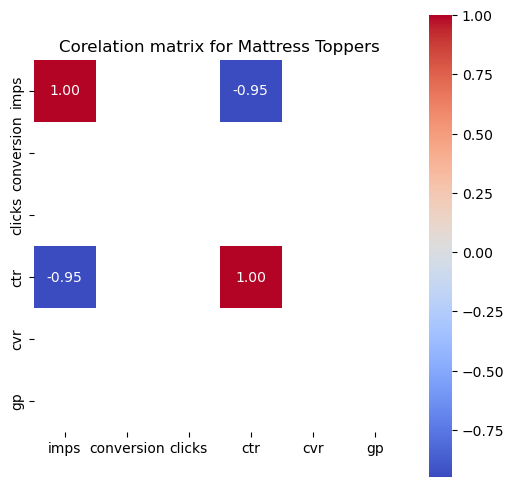

['mattress topper memory foam 4', 'mattress topper memory foam', 'mattress topper']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



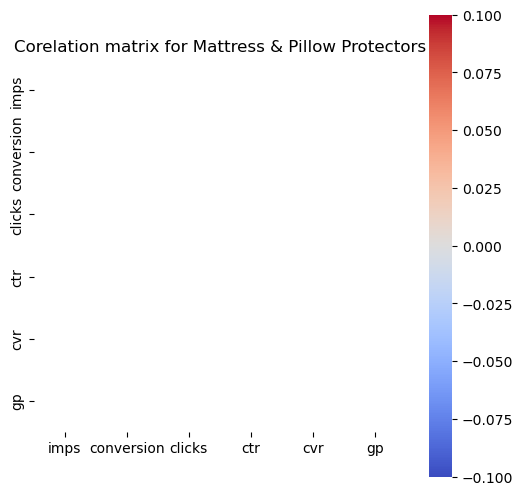

['mattress cover bed bug proof']


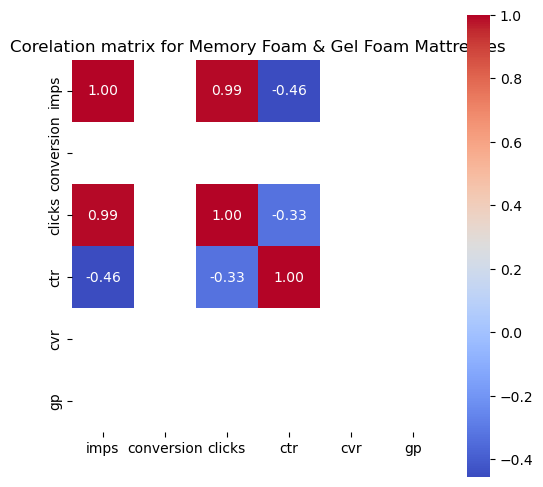

['mattress', 'regular size mattress and box springs', 'full size mattress and box 6']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



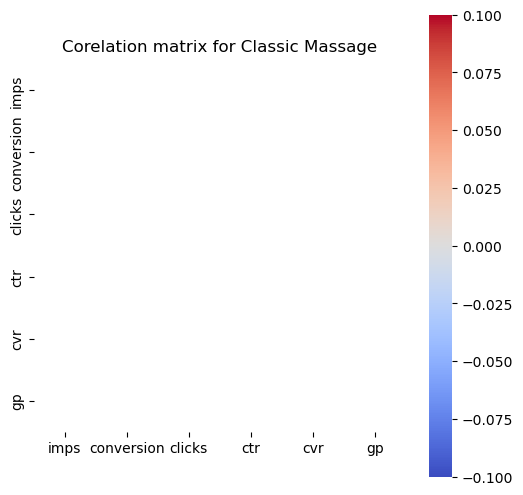

["massage valentine's", 'massage burlington', 'massage in peabody', 'mobile couple massage', 'spa near navy pair', 'spa wellness', 'healing cypres', 'jennifer brand']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



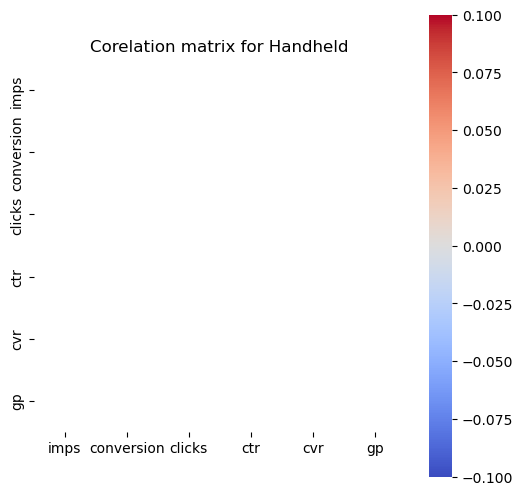

['massage gun']


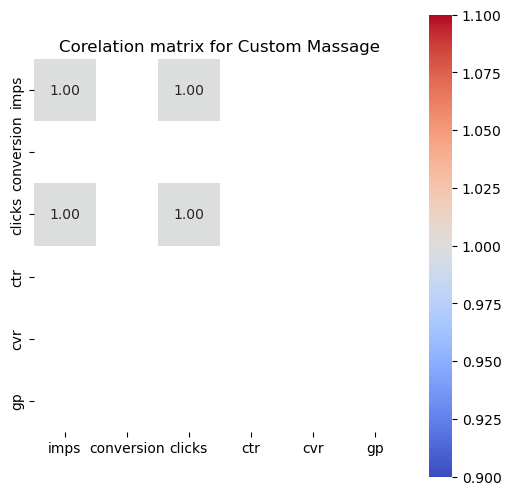

['massage fair oaks', 'couples massage prenatal', 'j sterling massage', 'lavish skin care']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



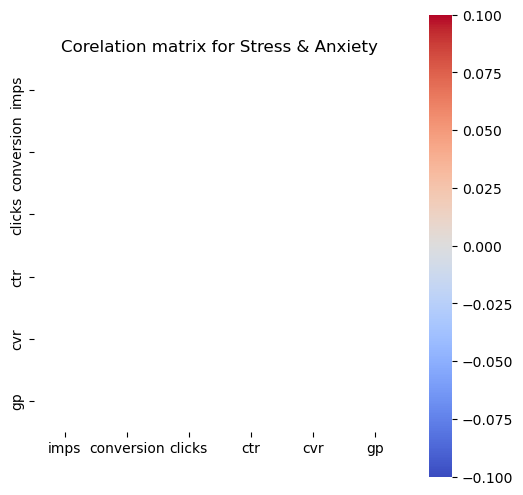

['meat']


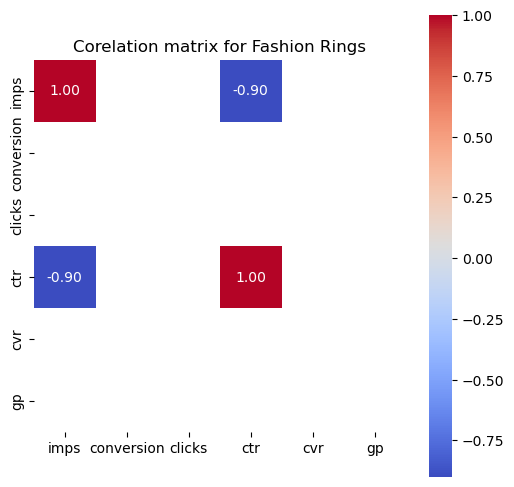

['men’s ring', 'diamond rings for women', 'gemstones']


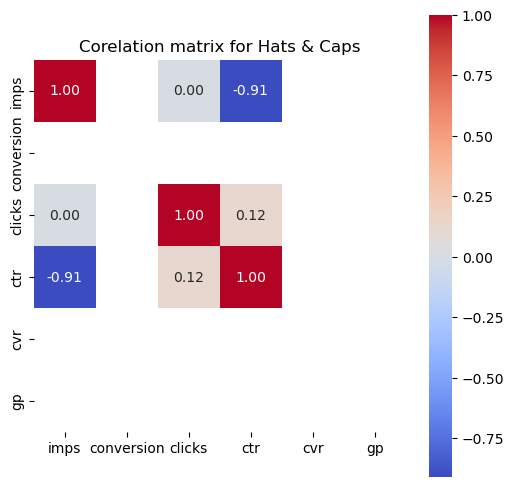

['men’s hat', 'men fedora hat', 'sun hat', 'the teal yogi', 'winter women boot', 'hat scarf glove sets', 'jazz clubs']


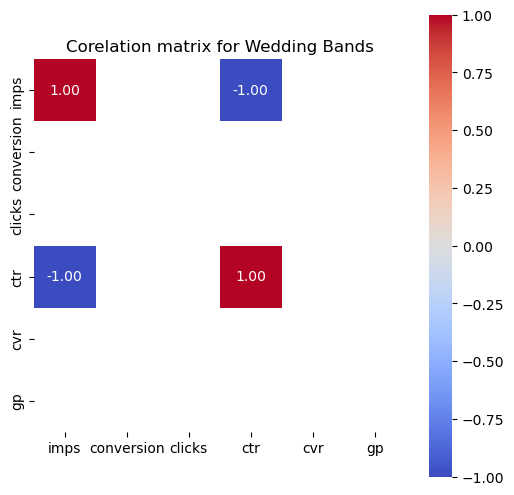

['men’s gold wedding band', 'wedding bands']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



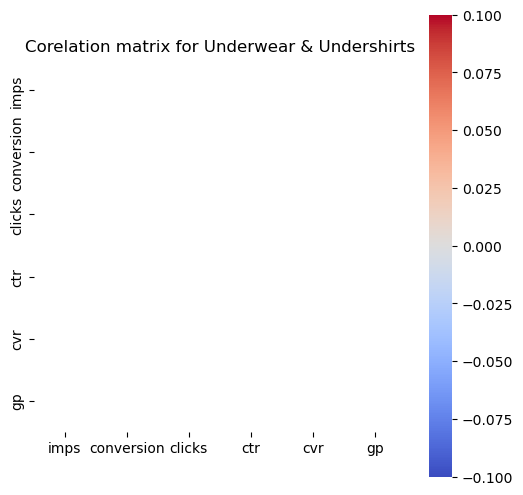

['mens themal pants']


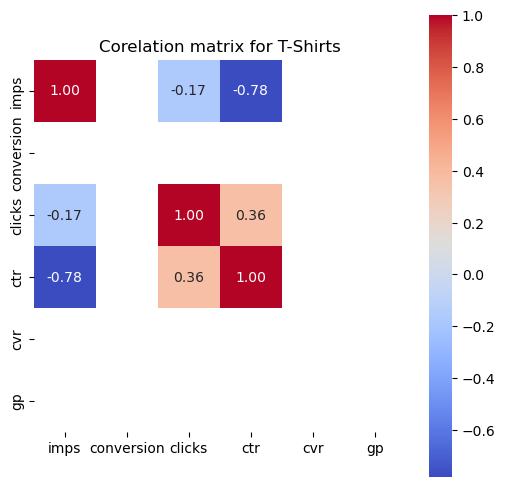

['maternity', 'mens short sleeve hooies', 'royal gorge jeep tour', 'beard', 'ladies cotton thermal', 'la rams shirt', 'jersey']


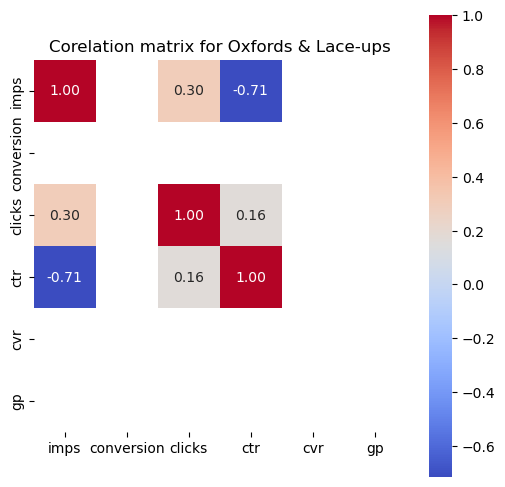

['mens shoes', 'mens dress shoes', 'men shoes', 'men shoe', 'wingstop']


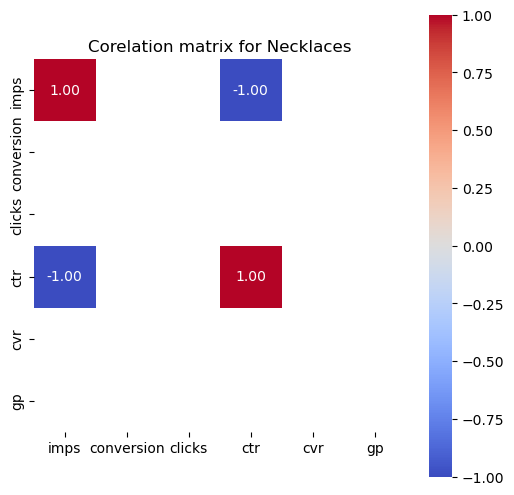

['mens jesus necklace', 'heart']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



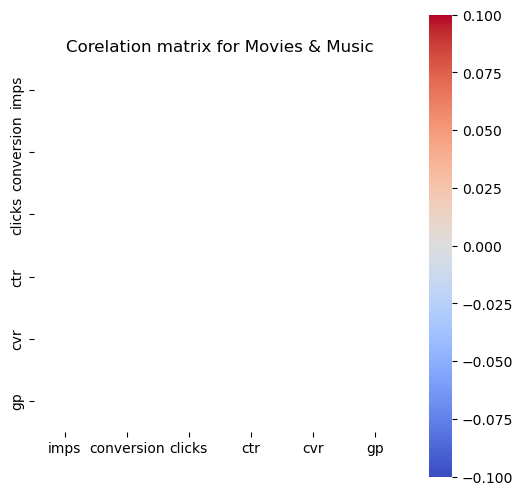

['mega con']


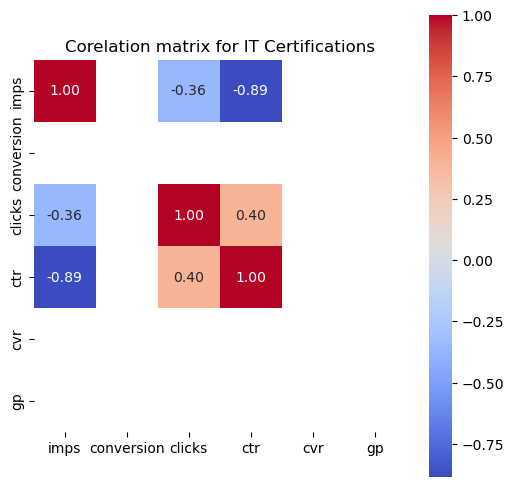

['medical coding', 'medical certifications', 'scrum master certification', 'cybersecurity', 'computer class', 'big data', 'it course']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



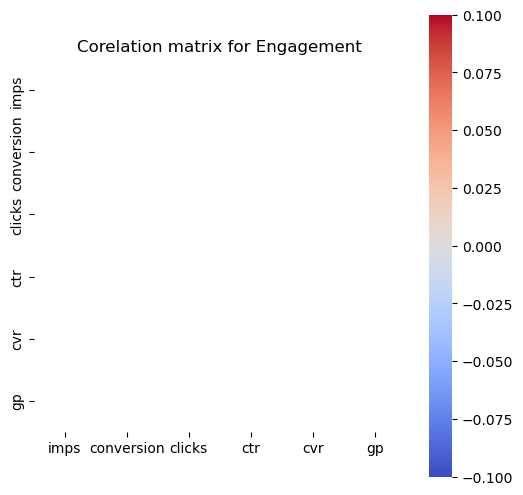

['mens diamond rings']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



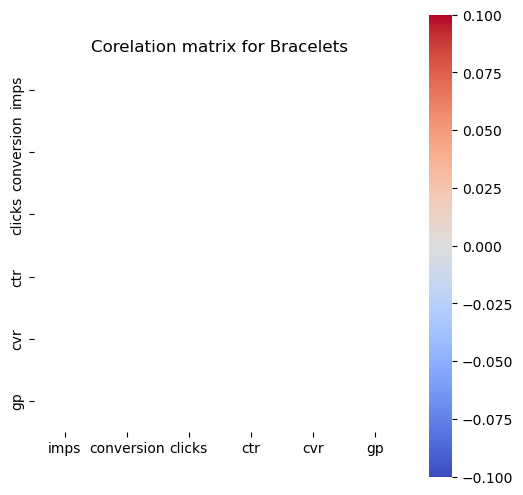

['mens bracelets']


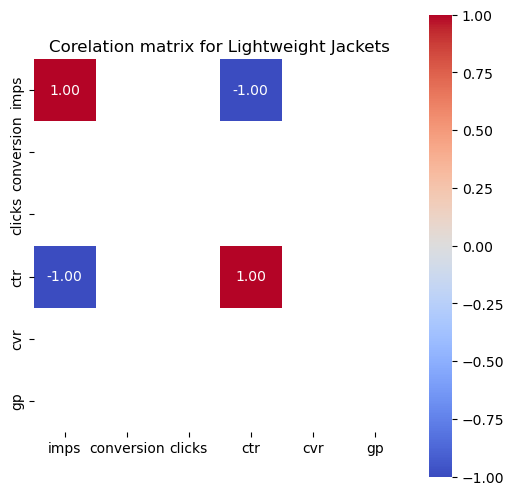

["men's winter jackets", "woman's heated jacket"]


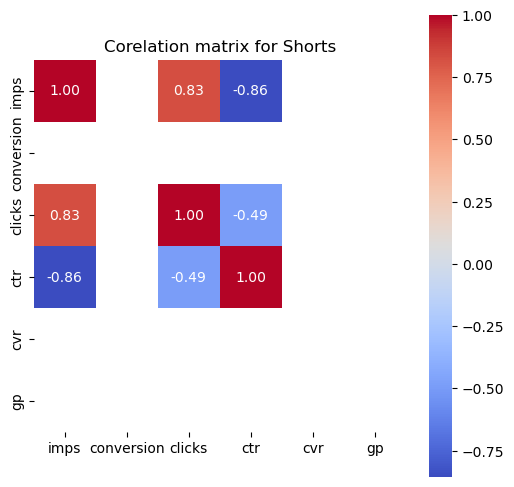

["men's slacks", 'silk feel biking shorts in asorted colors for women', 'classic-fit belted cargo shorts', 'cotton nightgown', 'high waisted bike shorts tummy']


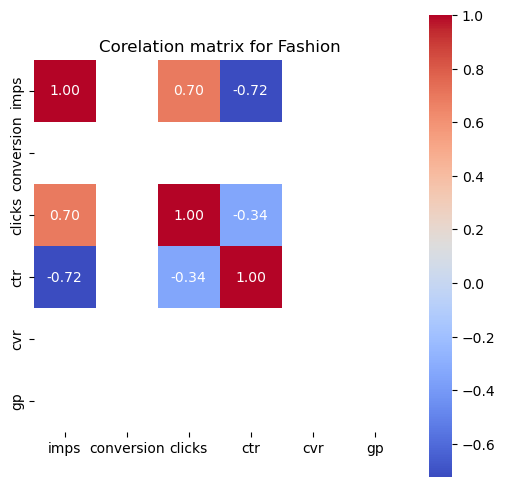

['men’s ring', 'men watch', 'watch', 'diamond rings for women', 'gemstones']


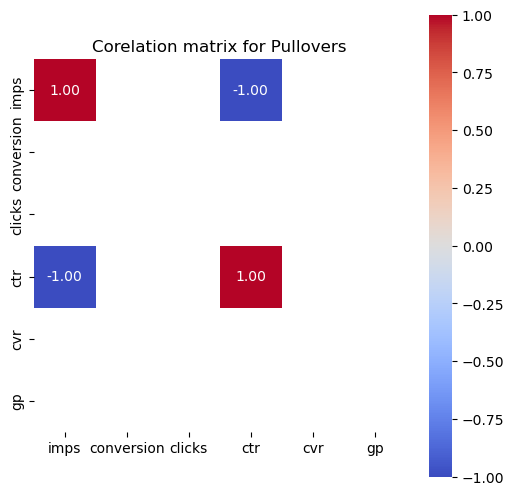

['men sweaters', 'hoodies']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



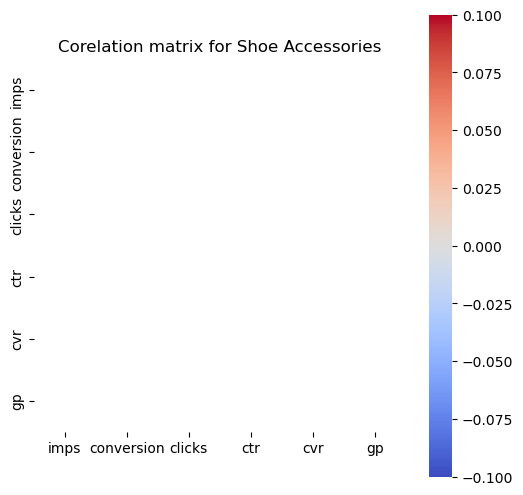

['men shose']


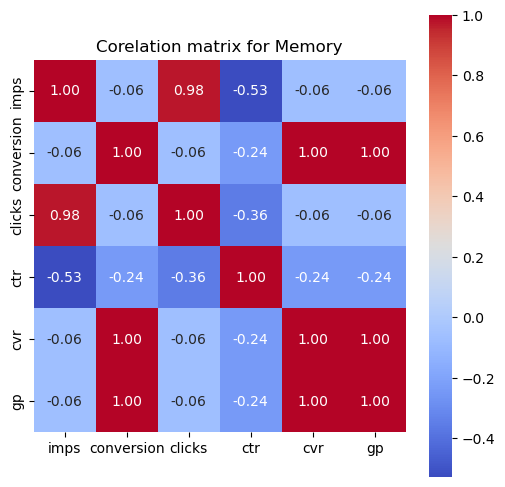

['pillows', 'pillow', 'mattress', 'memory card', 'my pillow', 'sd card', 'regular size mattress and box springs', 'apple pencil', 'full size mattress and box 6']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



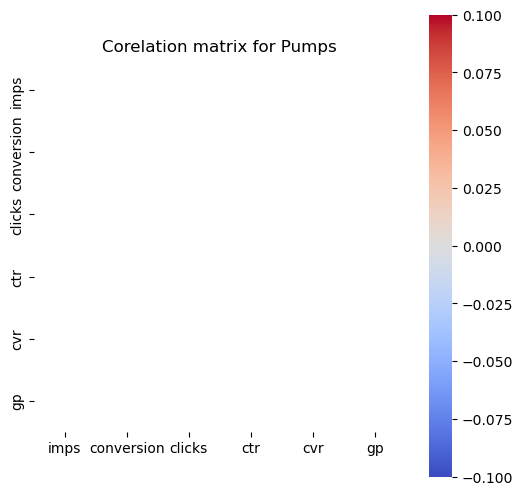

['mary ruths']


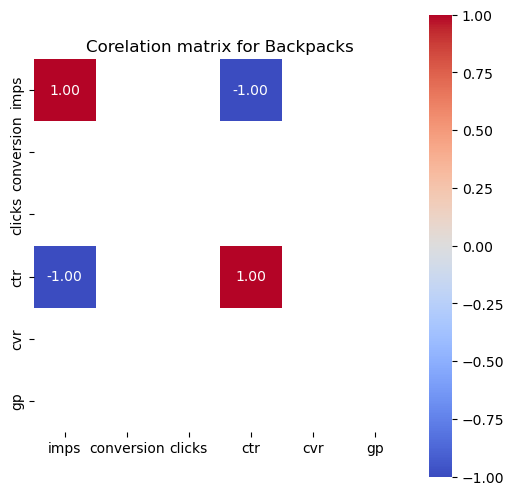

['little gym', 'backpack']


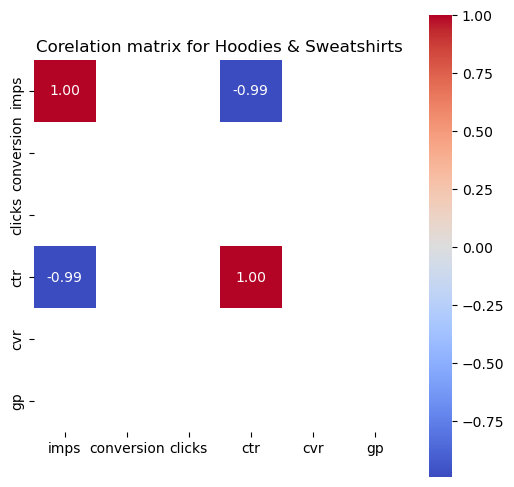

['longview washington', 'long sweatshirt', 'sweater']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



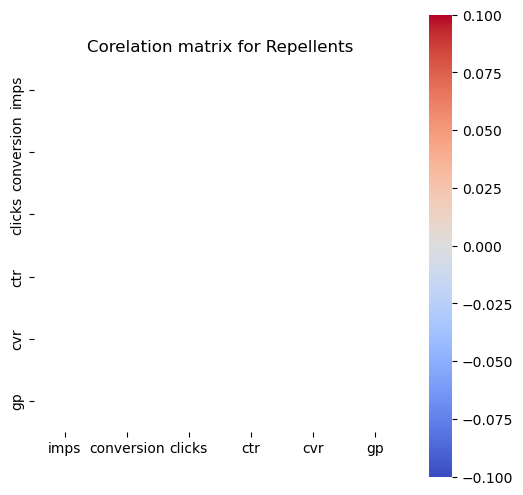

['long gardening scissors']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



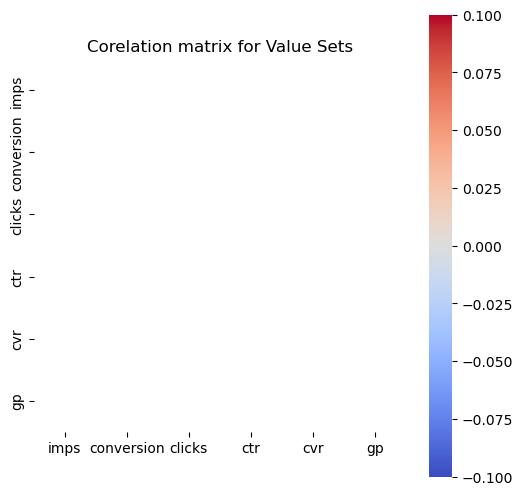

['living proof']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



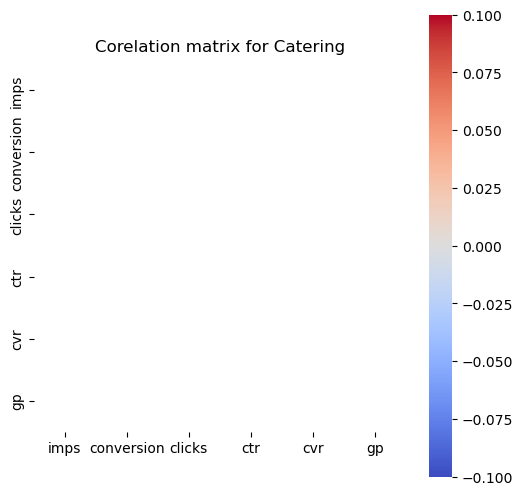

['live music and dinner']


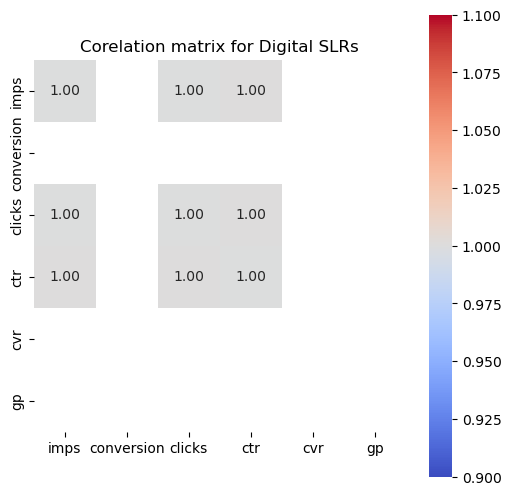

['lens', '6ave']


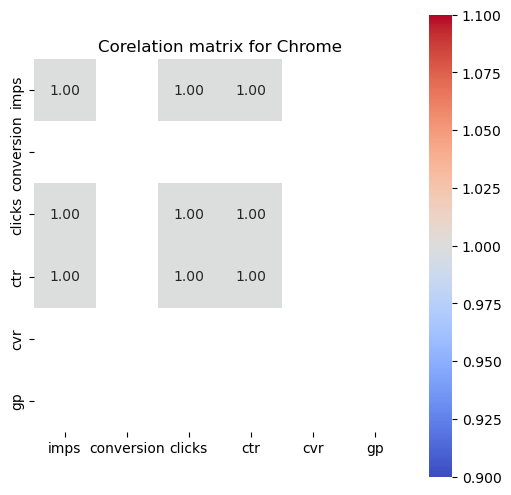

['lenovo laptops', 'refurbish computer', 'laptops']


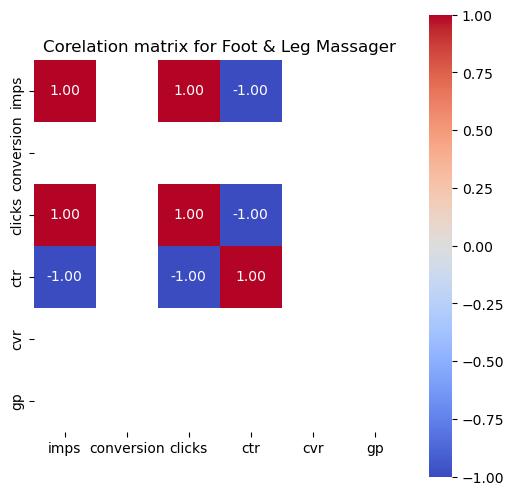

['leg massage', 'northridge foot mass']


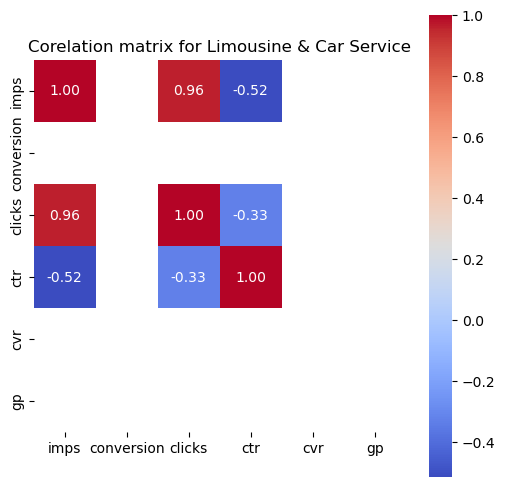

['limousine', 'limo ride', 'limo airport', 'limo', 'oakland zoo', 'transportation', 'scooter rentals', 'sf airport car service', 'skunk train', 'car service', 'airport transport', 'hartsfield jackson']


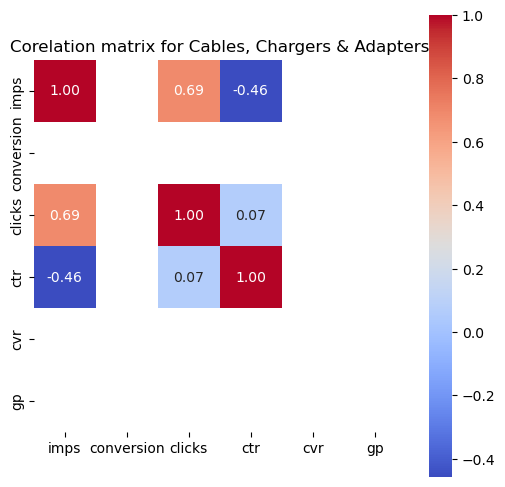

['lightning cable purple', 'usb type c fast charging cable 45w', 'usb to usc', 'samsung', 'samsung  galaxy pink  buds', 'samsung fast charging charger', 'charging station', 'charger', 'anker', '3-pack for samsung usb type c fast charging cable galaxy s8 s9 s10 plus note 8 9', 'iphone14 charger', 'iphone repair', 'fast charger for iphone and mac']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



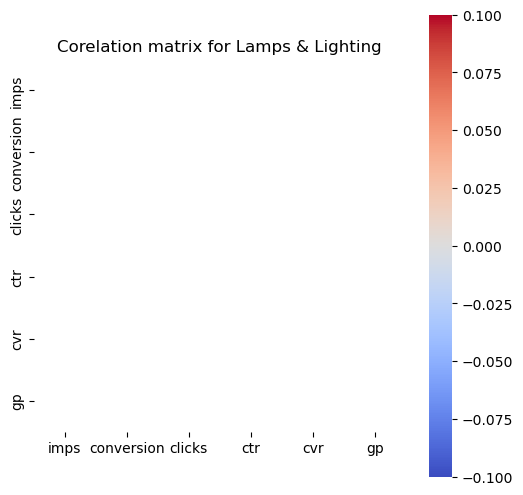

['lighting']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



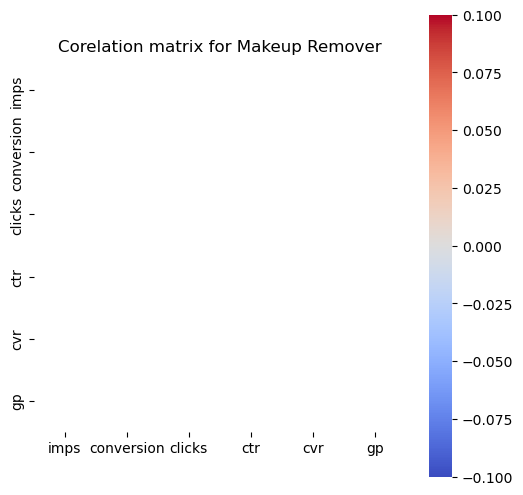

['makeup towel']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



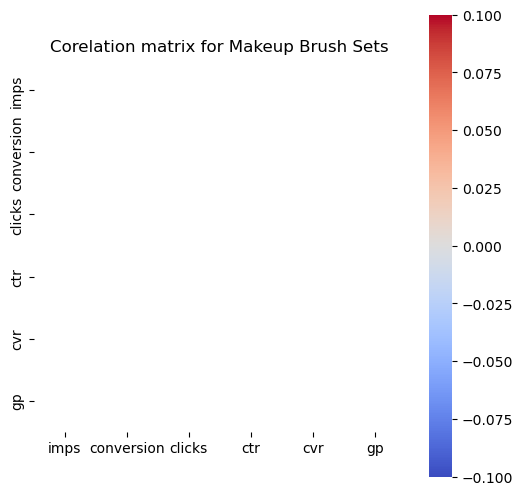

['makeup brush']


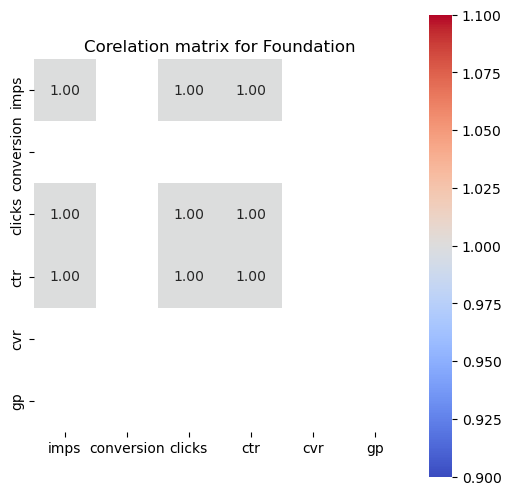

['makeup', 'foundation']


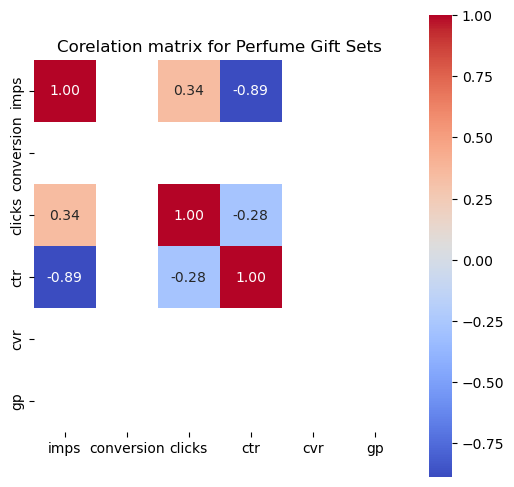

['make perfume', 'womens boots', 'coach floral', 'gift set women']


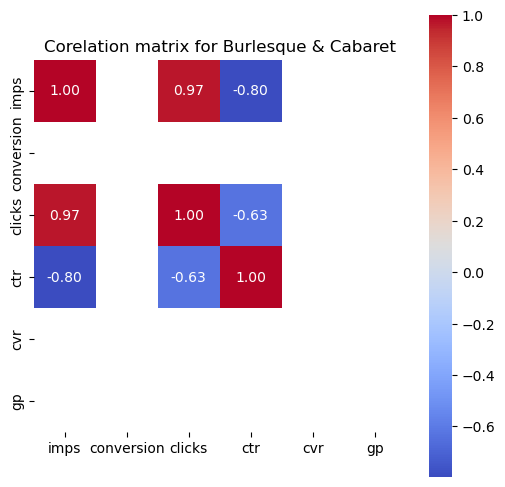

['magic mike', 'thunder show', 'fantasy']


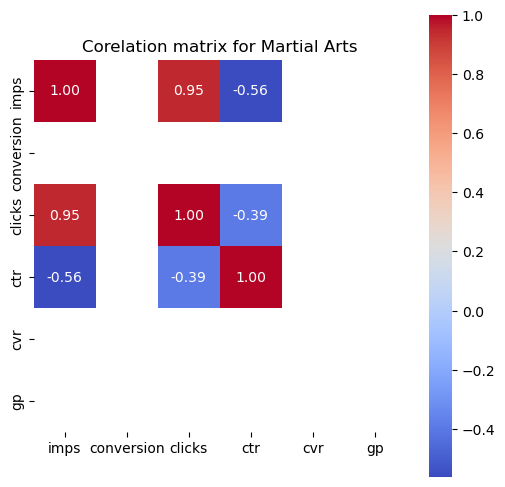

['martial arts', 'mma', 'self defense', 'self defense for women', 'art class', 'bjj', 'judo', 'jiu jitsu', 'karate', 'fit classes']


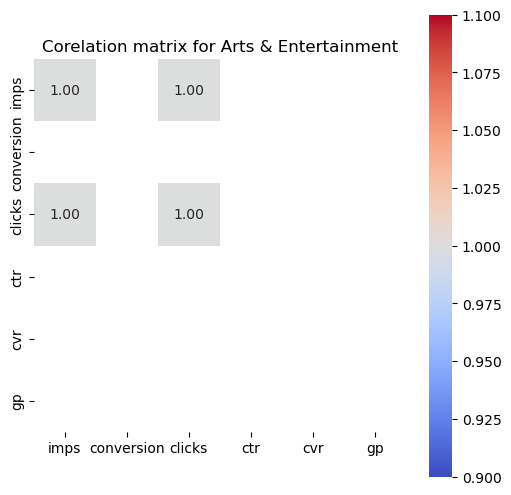

['lux candle', 'Aug 28']


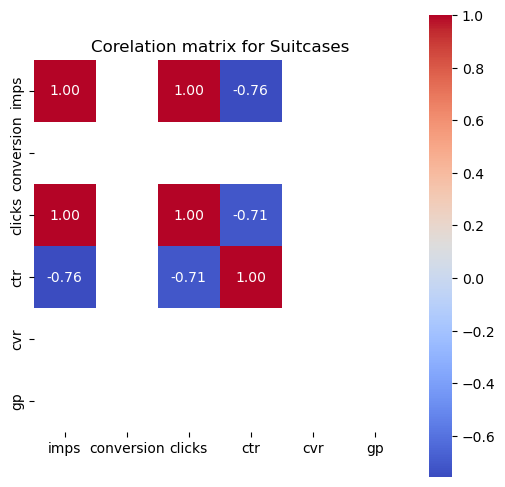

['luggage set', 'luggage', 'suitcase set', 'carry on luggage', 'green brown luggage']


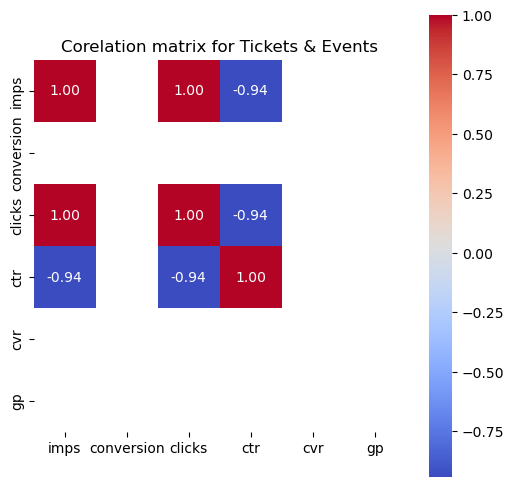

['luaua', 'luau', 'complete playground', 'big black comedy show']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



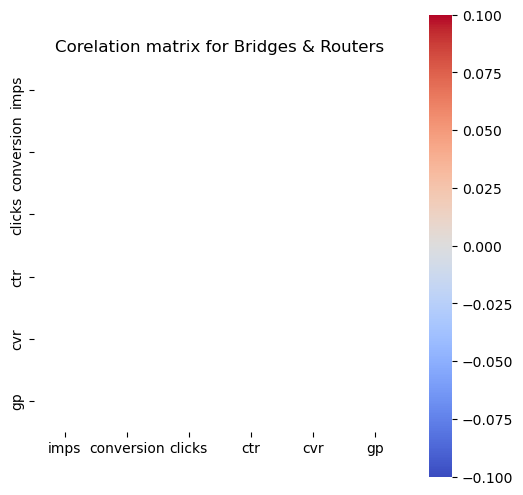

['lte router']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



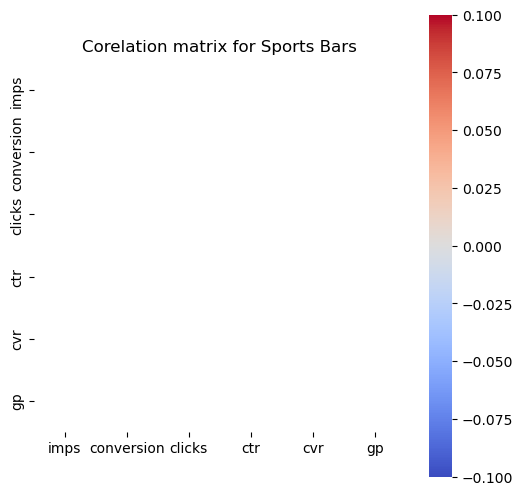

['lounge bar']


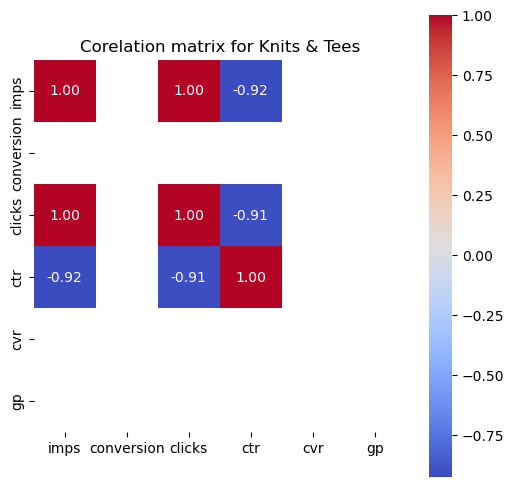

['mac mouse', 'valentine', 'fake jersey']


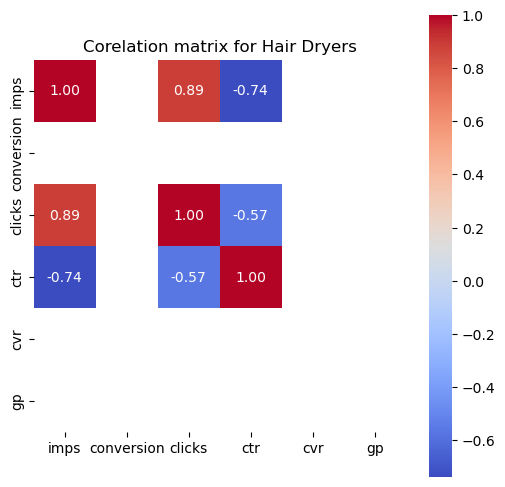

['neo hairdryer', 'blowdryer', 'blow dryer', 'babyliss', 'babylis', 'babybliss blowdryer', 'hair dryer']


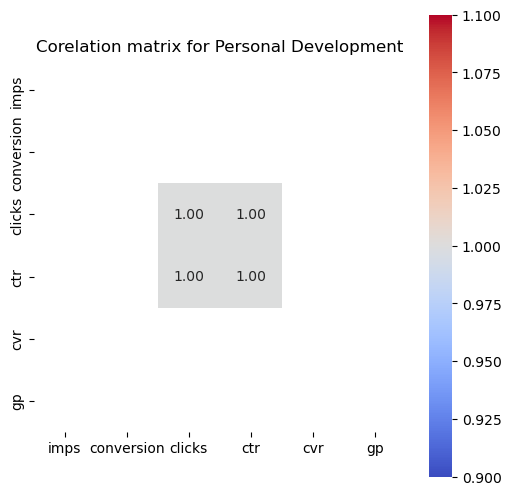

['new life', 'resume writing']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



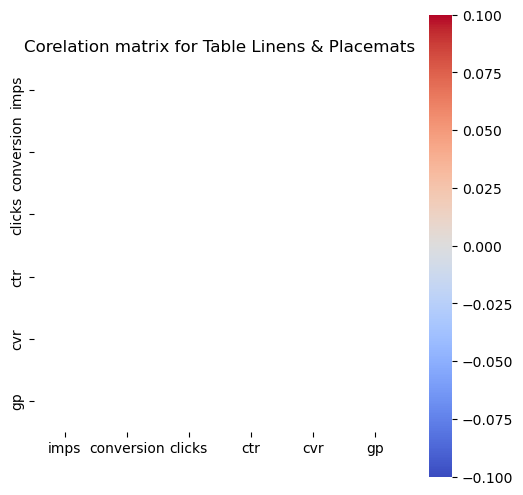

['netflix']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



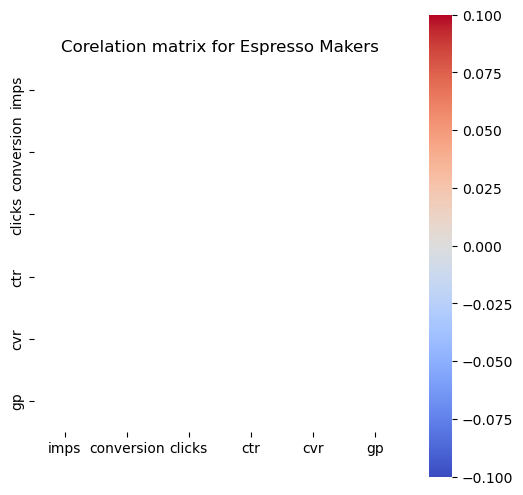

['nespresso limited-edition vertuo pop  coffee and espresso maker by breville, matte black gold']


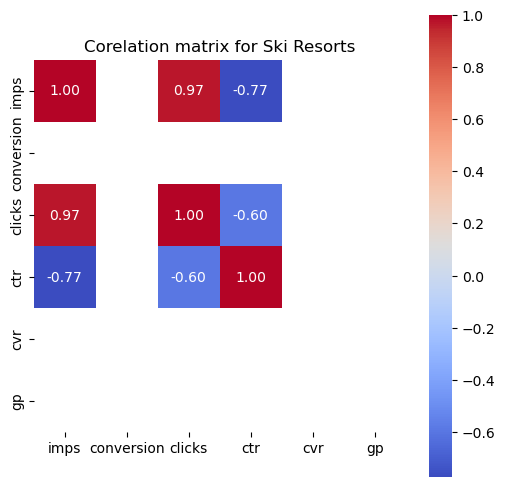

['nh', 'rezorts', 'tanning in burlington vt', 'concord, nh', 'grand lake']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



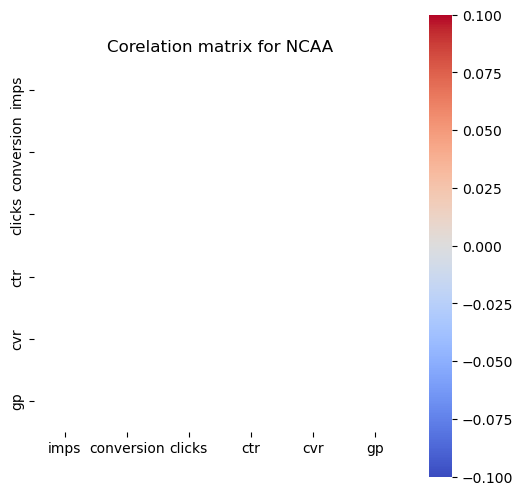

['ncaa']


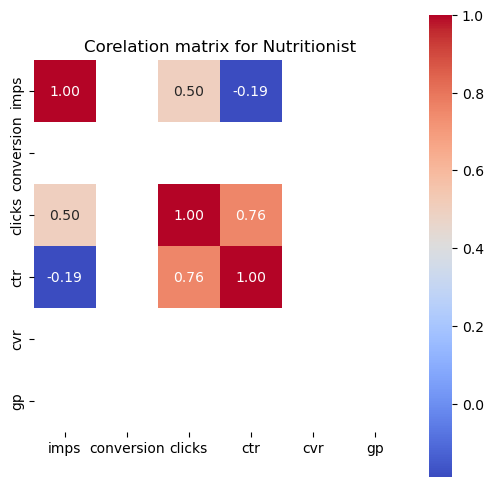

['nutritionist training', 'weight loss plan', 'centreofexcrllence alkaline nutritionist']


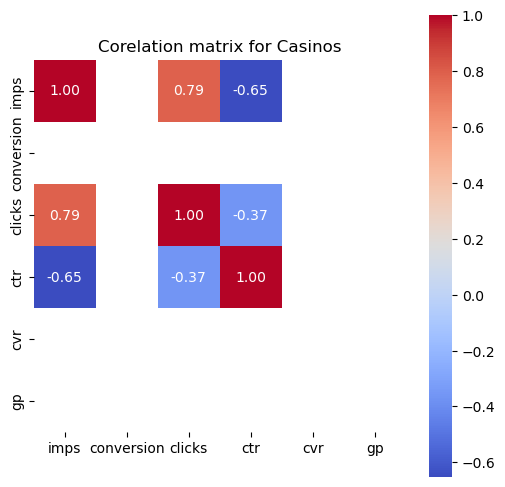

['ocean casino atlantic city', 'showboat hotel atlantic city nj', 'atlantic city hotel and casino', 'alantic city', 'borgata', 'boardwalk', 'hote', 'hotels in atlantic city', 'hotels atlantic city', 'el cortez']


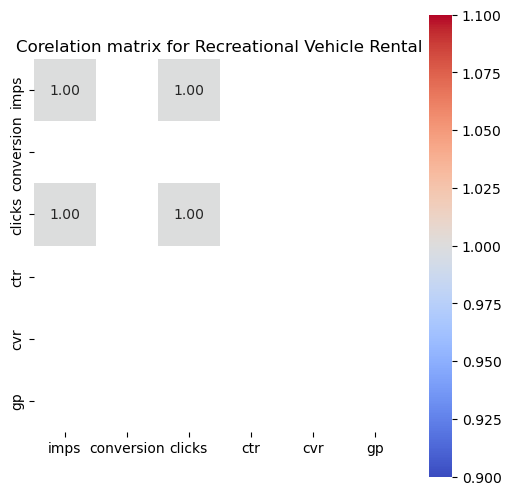

['off roading', 'scooters', 'electric scooters']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



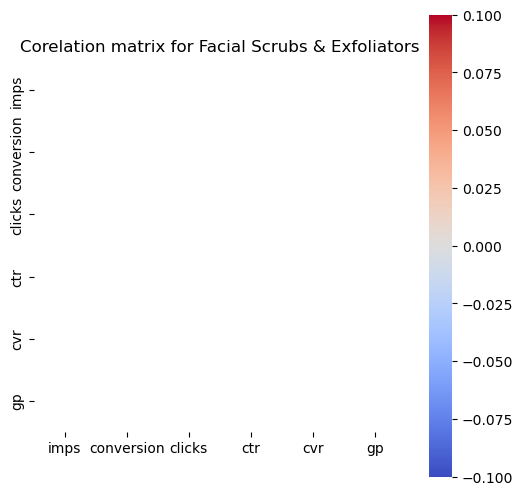

['nothing bundt']


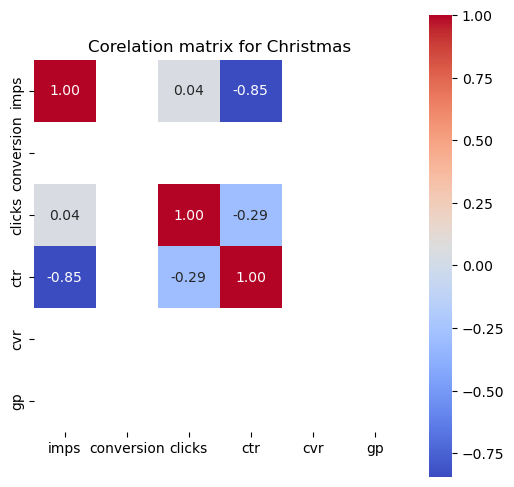

['no ft', 'christmas tree', 'christmas clearance', 'lanterns']


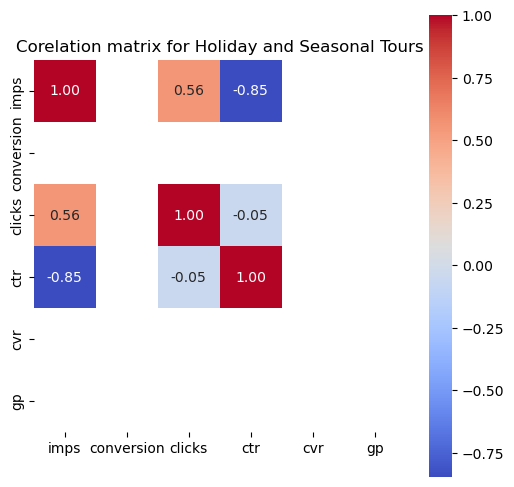

['nights of lights', 'nights of', 'sleigh rides', 'central park', 'adventure boat tours']


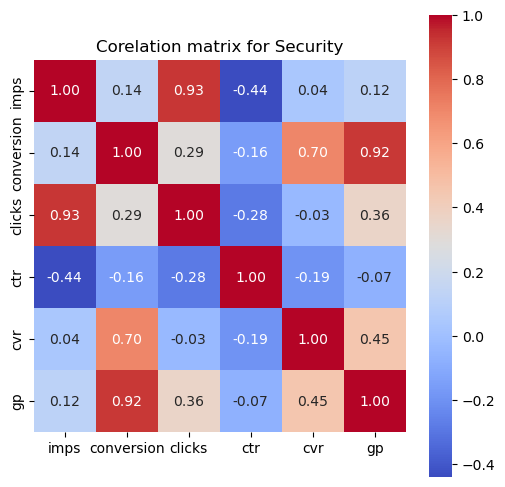

['remote car starter', 'car radio', 'battery jump', 'norton an tivirus', 'tire world', 'tools', 'tune-up', 're.ote start', 'ring doorbell', 'remote starters', 'remote starter', 'remote start up', 'remote start installation', 'remote start', 'remote car start', 'car alarm', 'car starter package', 'car starter for manual', 'car starter', 'car remote starter', 'dashcam install', 'diamond exge', 'automatic car starter', 'automatic car start', 'auto start', 'auto car start', 'air pump', 'boomer', 'jump starter', 'good year tires']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



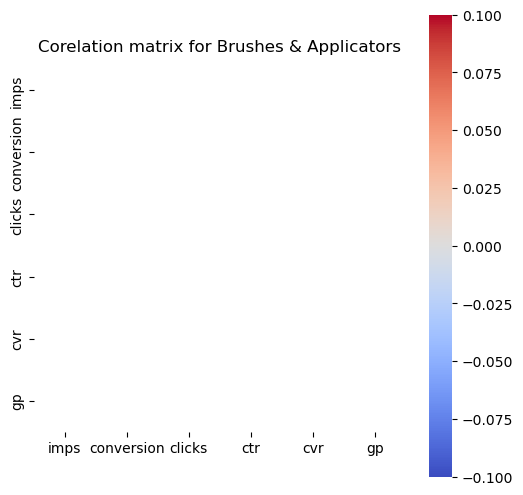

['north carolina charlotte  flights delta']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



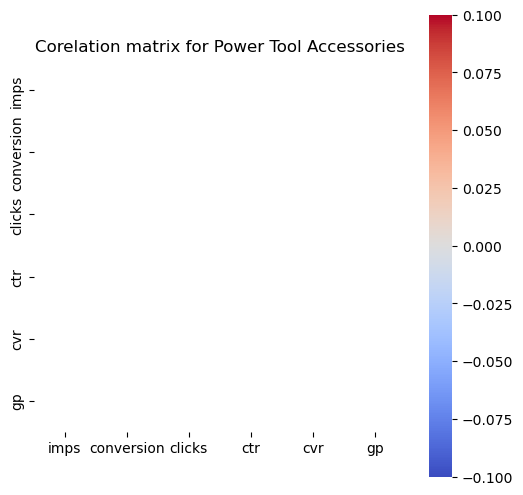

['milwaukee']


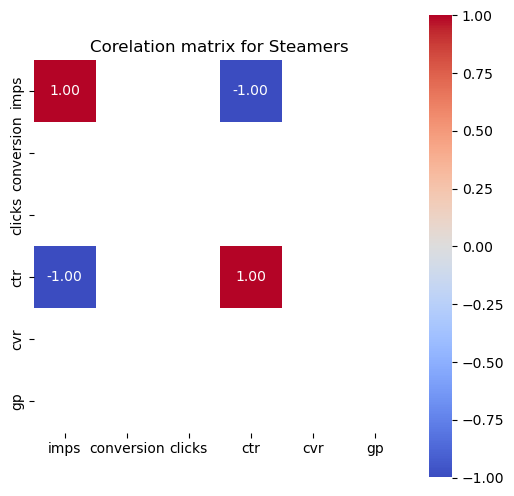

['milk frother steamer', 'cookware']


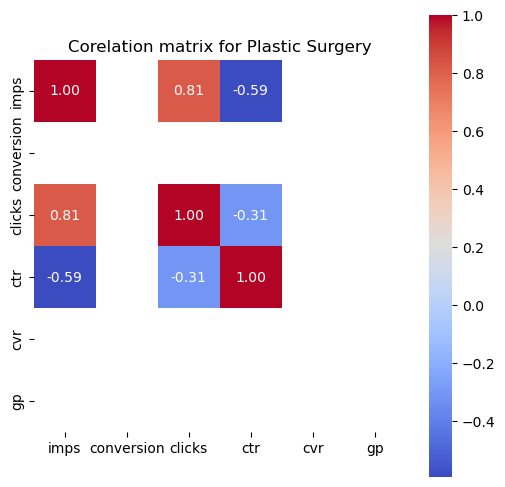

['milia', 'mole removal', 'mole', 'thermiva', 'vaginal steaming', 'vaginal rejuvenation', 'vaginal', 'vsteam', 'wart', 'skin tags', 'skin tag removal', 'skin tag', 'butt vacuum shaping', 'dark spot removal', 'age spot removal', 'emsella chair']


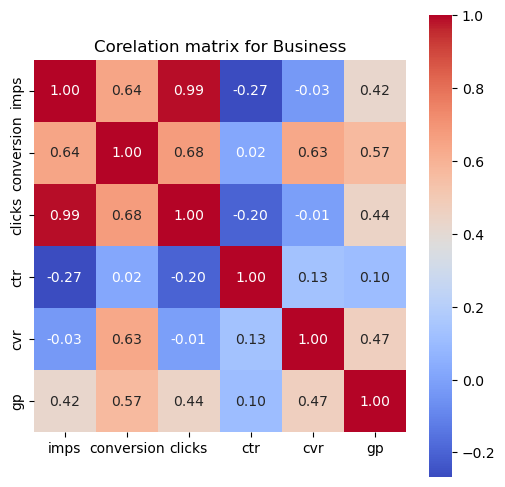

['relny', 'real estate', 'classes', 'cannabis', 'aceable', 'florida real estate 45 hour', 'azure tide', 'real estste', 'weed', 'online real estate', 'online real estate course', 'pistons game', 'property ans casualty', 'make up', 'marijuana growing', 'notary training', 'microsoft surface', 'training', 'texas real estate', 'wine and painting', 'washington pre-licensing real-estate', 'real estate u', 'realestateu new york', 'realestateu', 'real states', 'real estateu', 'real estate online glass', 'real estate license course', 'real estate license', 'real estate exam', 'real estate course florida', 'real estate course', 'real estate classes', 'real  estate', 'real', 'stylist', 'ceshop real eastate', 'certificate small engine', 'business journal', 'business', 'computer', 'amazon', 'aceable agent', 'beauty classes', 'bible course', 'imac', 'insurance license', 'healthcare certified courses', 'hitt classes', 'law', 'eyelash classes', 'enhanced firearm training', 'gold cost school', 'group fi

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



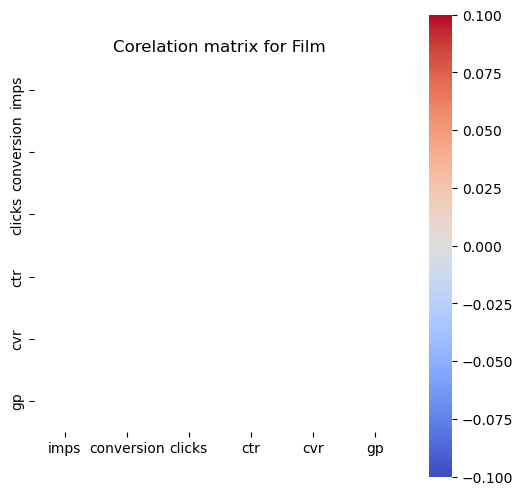

['mini printer']


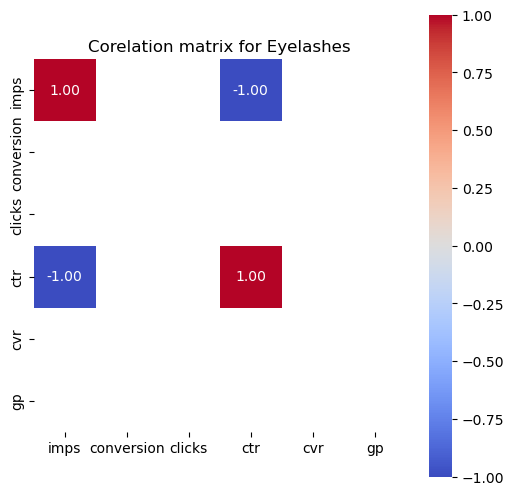

['microblading eyebrow', 'lash serum']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



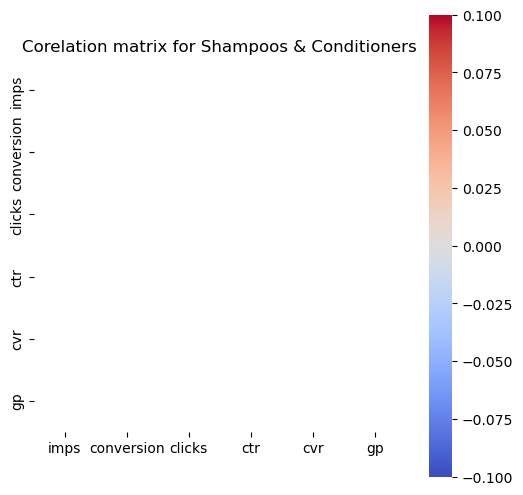

['muddy mat']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



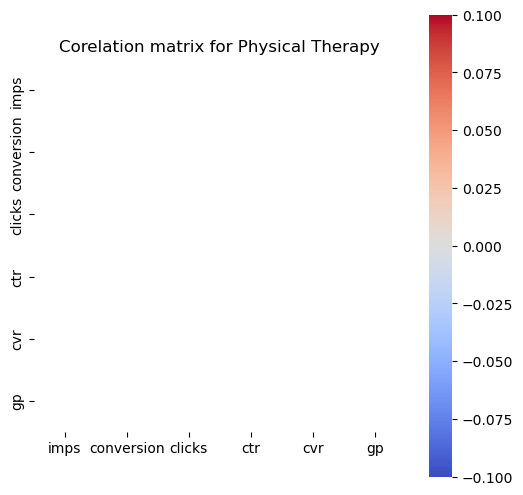

['movement', 'alter treadmill']


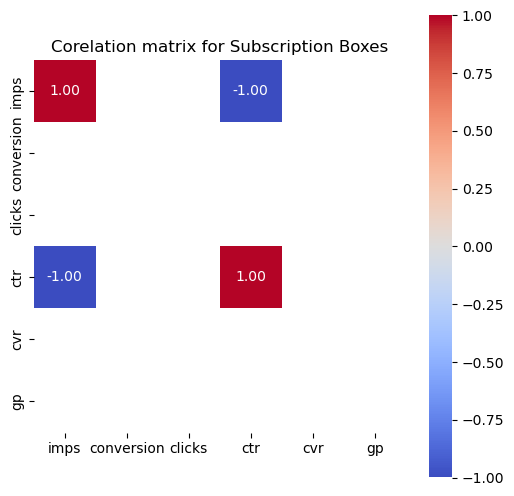

['monthly boxes', 'yeti']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



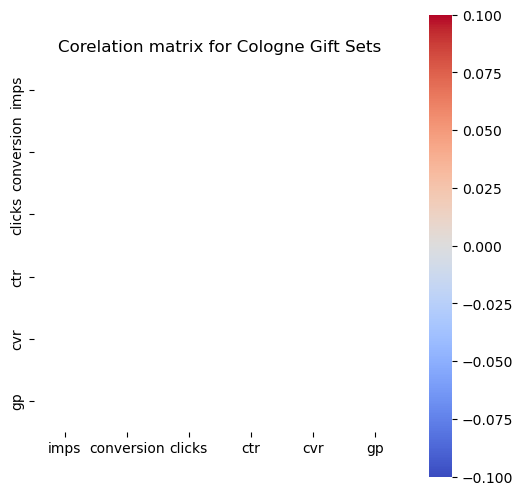

['mont blanc']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



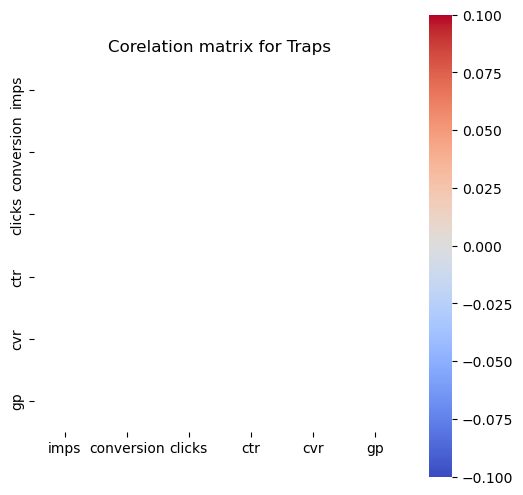

['mouse traps']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



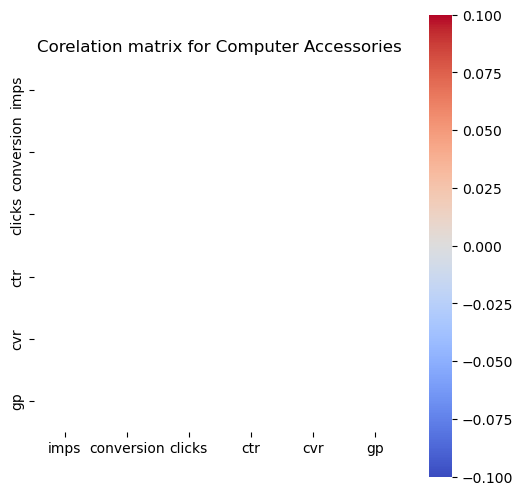

['mouse pad']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



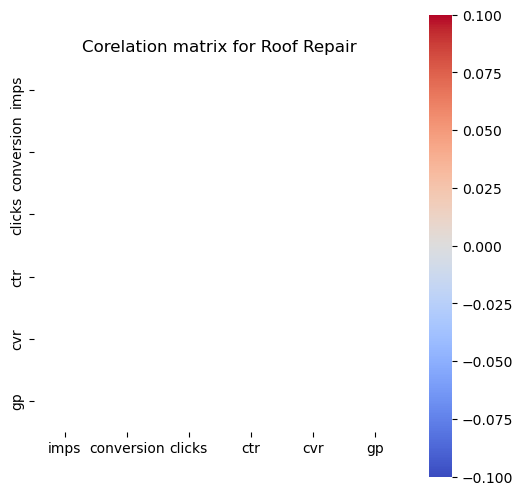

['moss cleaning']


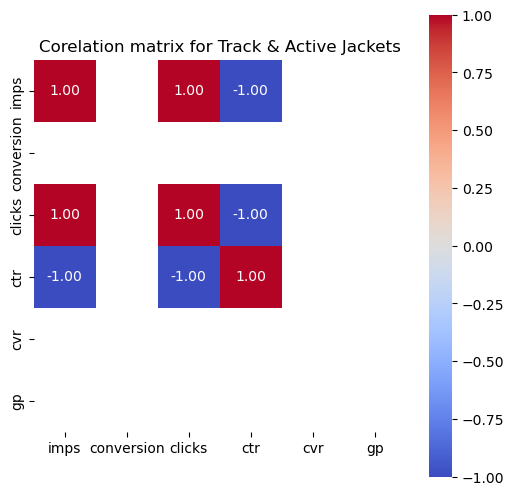

['tracksuit for men', 'usa tracksuit']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



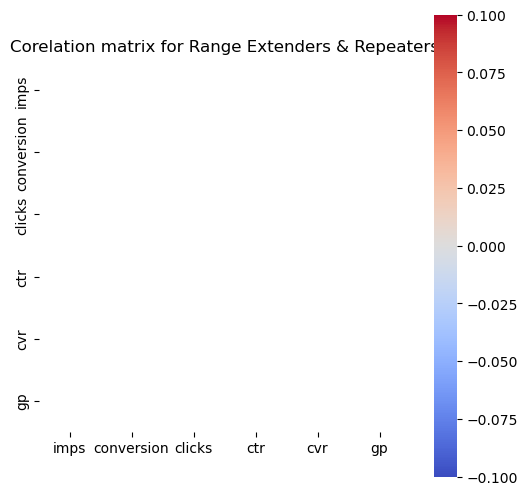

['tp link']


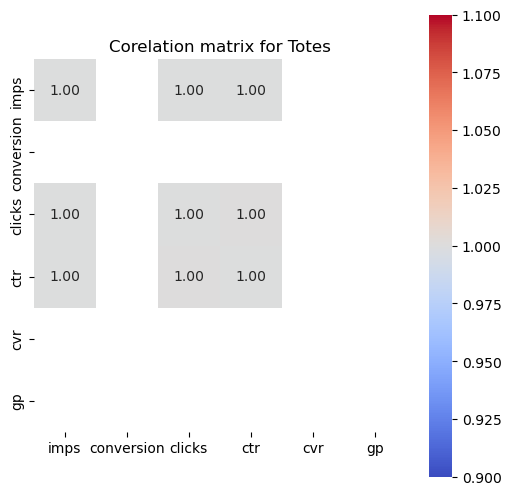

['tory burch handbag', 'clarisonic mia 2']


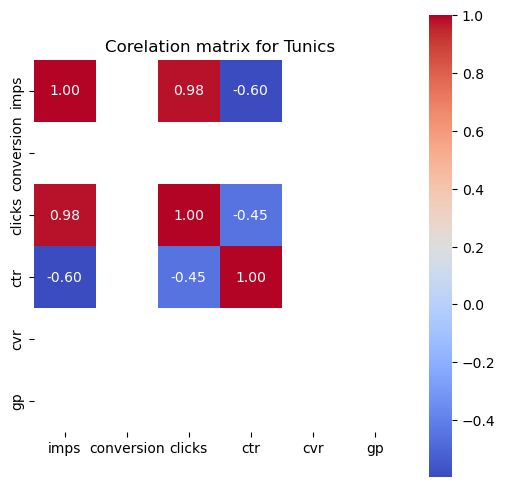

['tops', 'yellow tshirt', 'womens tops', "women's tops", 'crafts', '"simply fit"']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



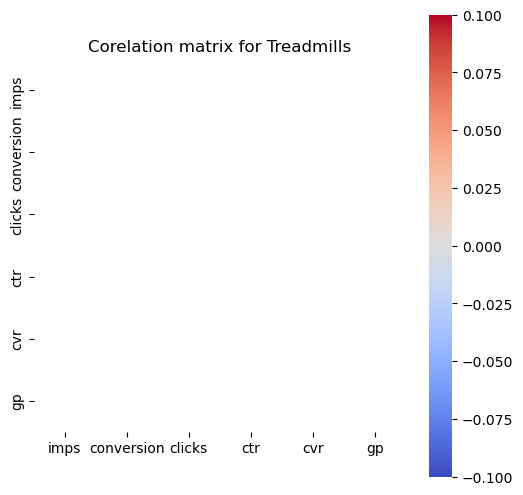

['treadmill']


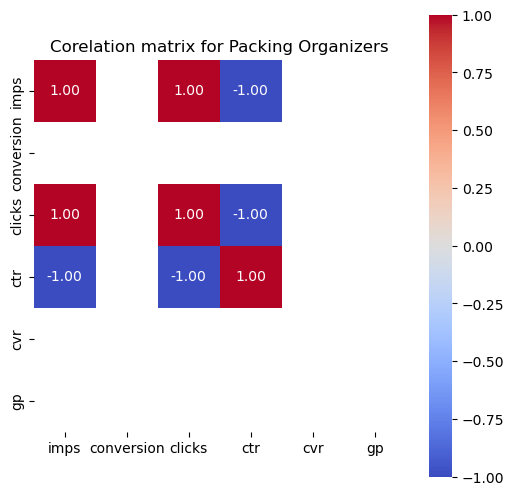

['travel', 'fire safe']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



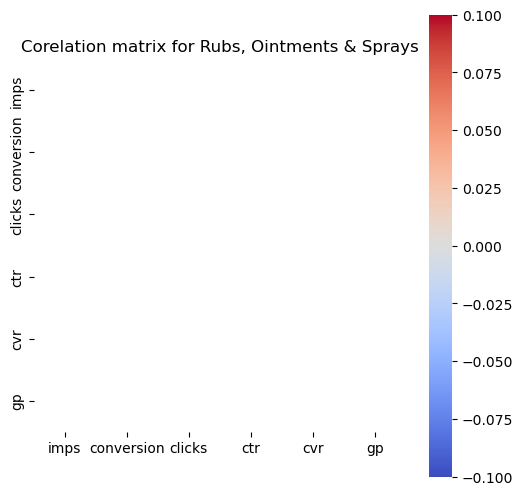

['tiger pain']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



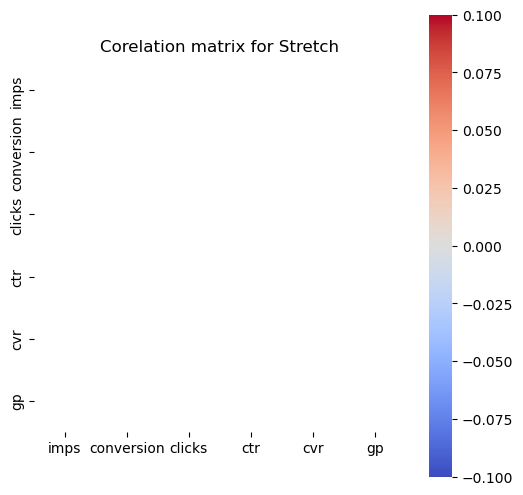

['tiger balm']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



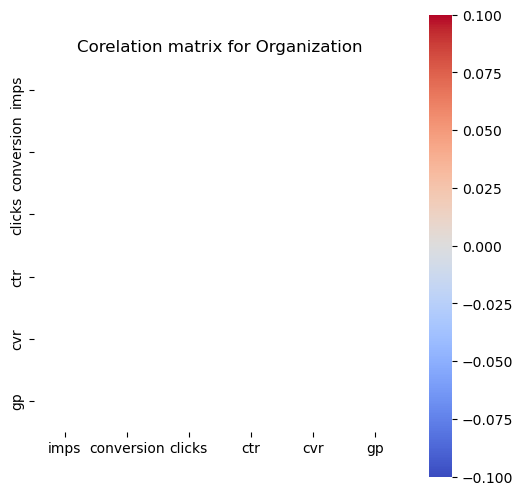

['toodler car seat']


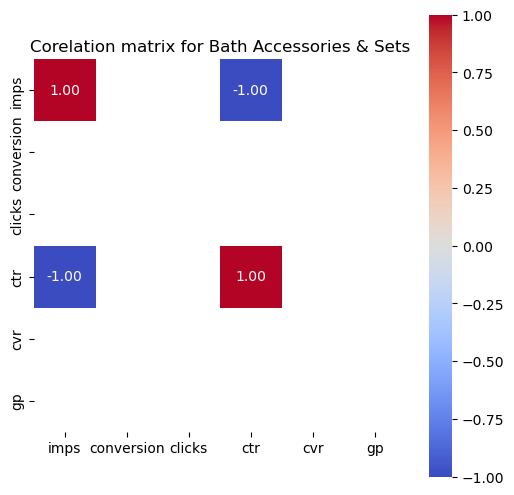

['toilet seat', 'bars']


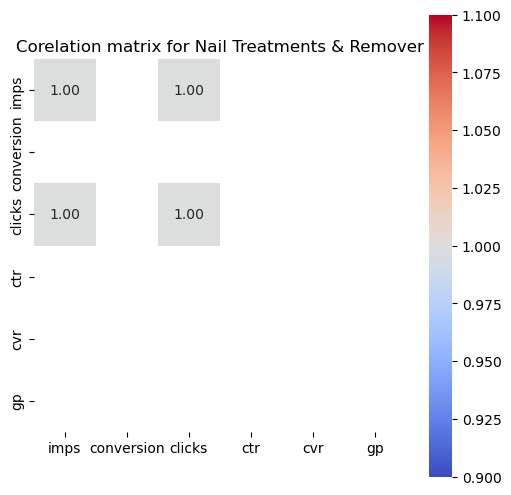

['toe fungus laser', 'fungus toenail treatment']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



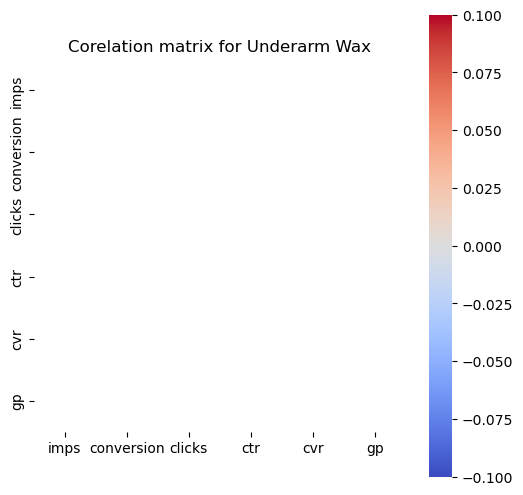

['underarm wax']


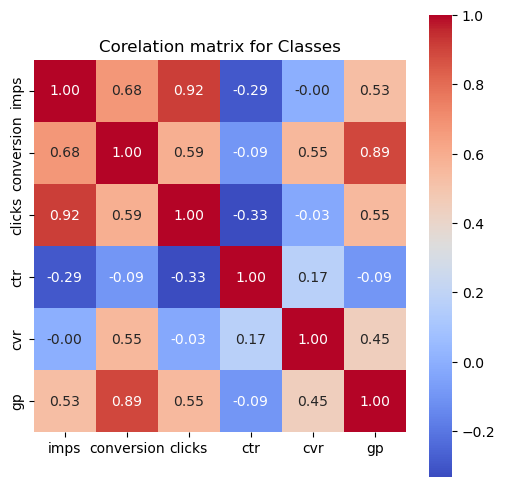

['class', 'cooking class', 'parkour', 'couples cooking class', 'pole dancing classes', 'air aerial fitness', 'wedding dance classes', 'cooking classes sc', 'cooking classes', 'pure barre', 'paint with a twist', 'painting activity', 'paint nite', 'paint nighgt', 'paint kids', 'paint birthday party', 'pole dancing', 'pole dance', 'pole classes', 'pole', 'piano lesson', 'private salsa classes', 'pottary craft', 'potterry clases', 'pottety', 'pasta making class', 'pasta making', 'pasta class', 'pasta', 'matt burke', 'long island', 'lessons', 'leo angelo art san diego ca', 'neon brush experience', 'udemy', 'tango lessons', 'tango', 'sushi making class', 'sushi making', 'temu codes', 'vegan cooking class', 'wedding lessons', 'wedding lessongs', 'wedding dance', 'voice lessons', 'salsa kings', 'salsa dancing', 'salsa dance lessons', 'salsa classes', 'salsa class', 'salsa', 'rooftop', 'romance and dance', 'sacramento', 'sauces', 'spanish lesson', 'splash paint', 'spin art', 'single adult gymna

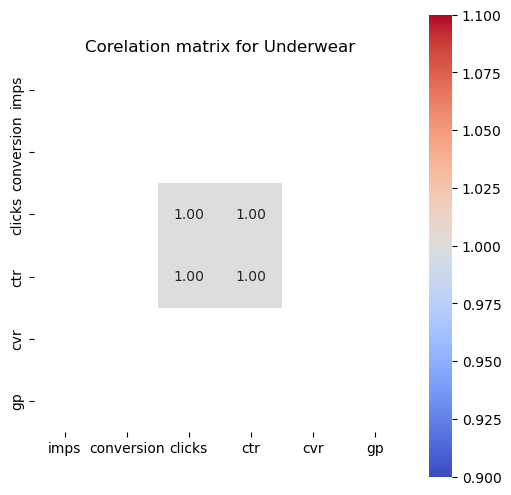

['mens themal pants', 'underwear-mens']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



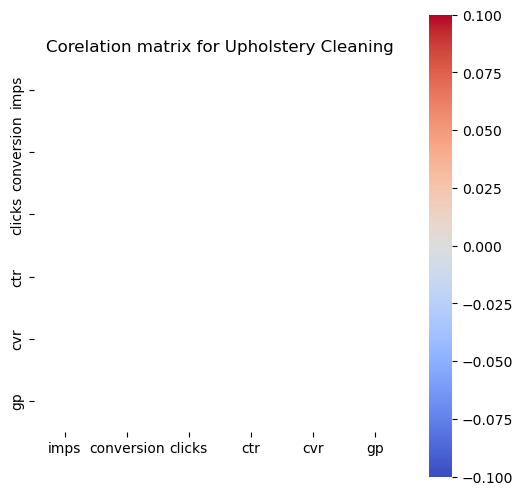

['upholstery cleaning for sofa and loveseat']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



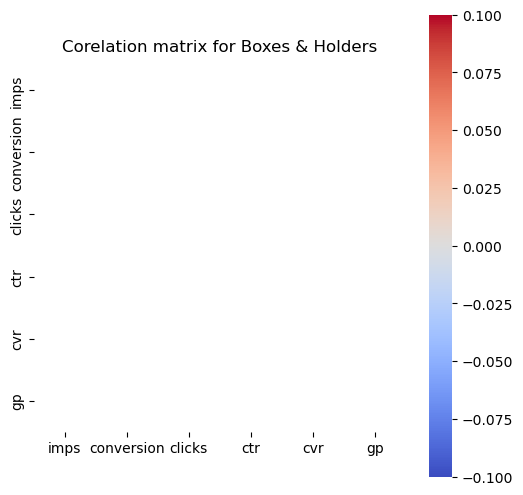

['universal carry case']


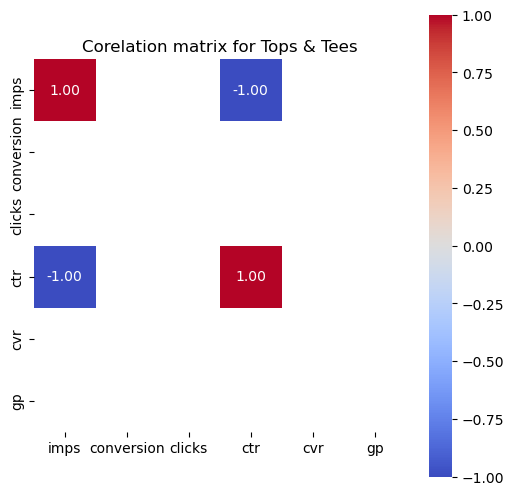

['tube top', 'botton down shirts for men']


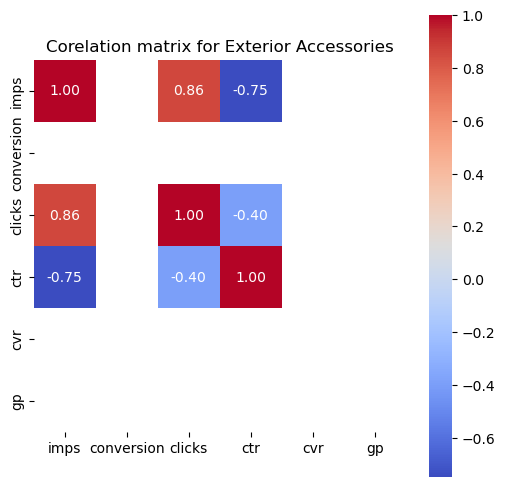

['truck rentsl', 'auto wrapping', 'ice scraper', 'i’ve scraper']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



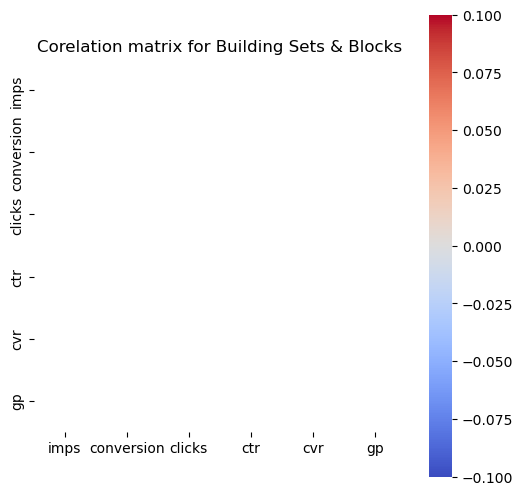

['tytan']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



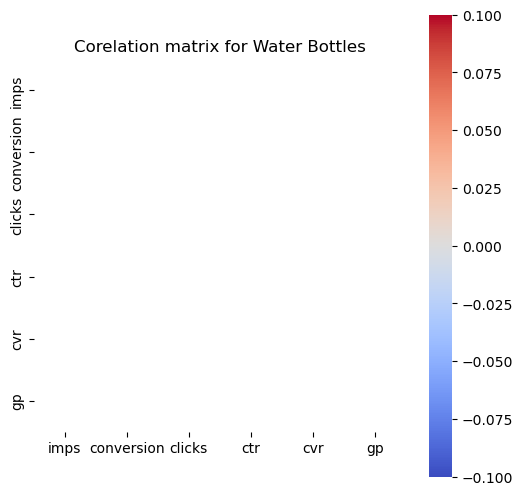

['tumble']


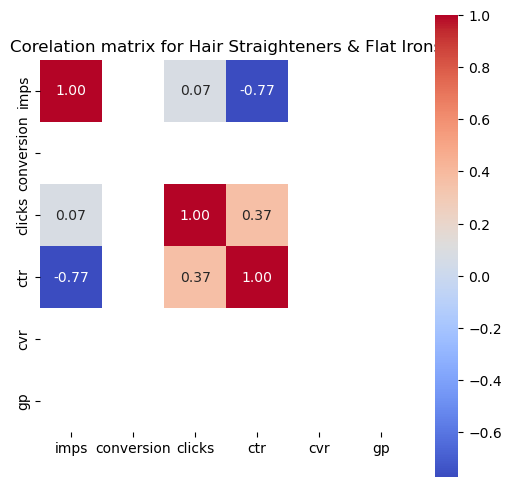

['tymo flat iron curler', 'chi', 'curling iron', 'babybliss', 'baby bliss flat iron', 'flat iron']


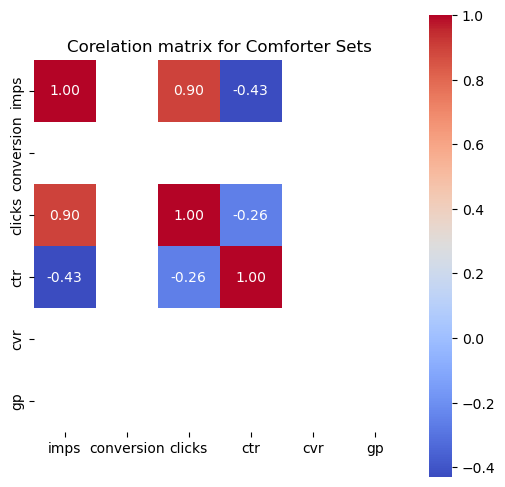

['twin bed in a bag', 'textured comforter', 'queen size comforter set', 'queen comforter', 'cal king comforter', 'california king comforter set', 'brown full size comforter sets with pillows', 'comforter sets 100% cotton lightweight', 'comforter sets', 'comforter light weight', 'comforter', 'comfor', 'conforters', '7 piece comforter set', '10 piece comforter set queen', 'full size bed in bag comforter sets with pillows', 'full size bed']


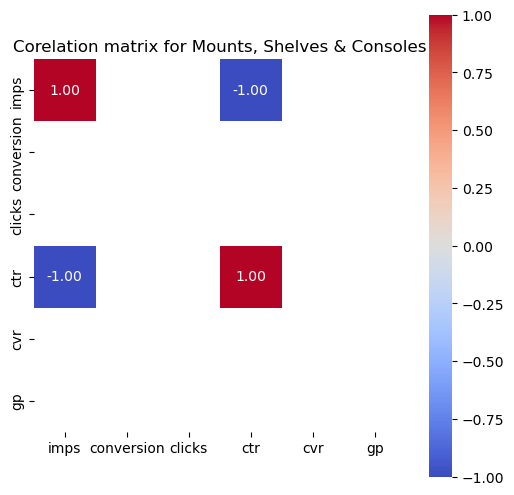

['tv mount swivel', 'youtube tv service']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



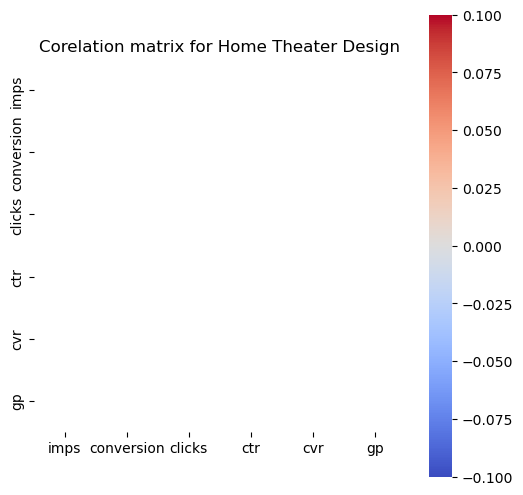

['tv hangers']


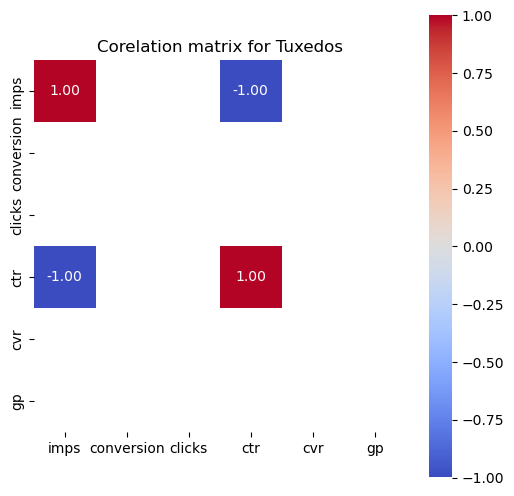

['tuxedo rentals', 'tuxedo']


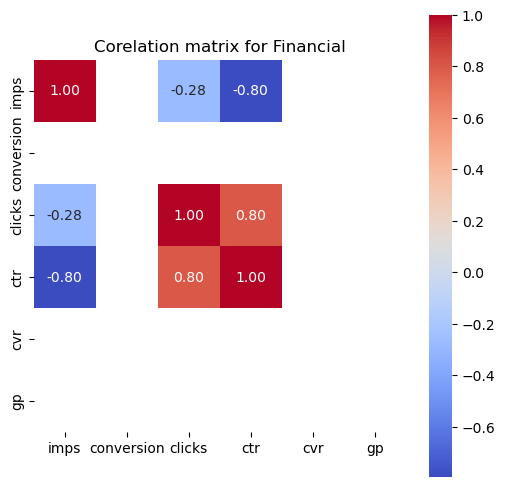

['turbotax', 'taxes', 'tax']


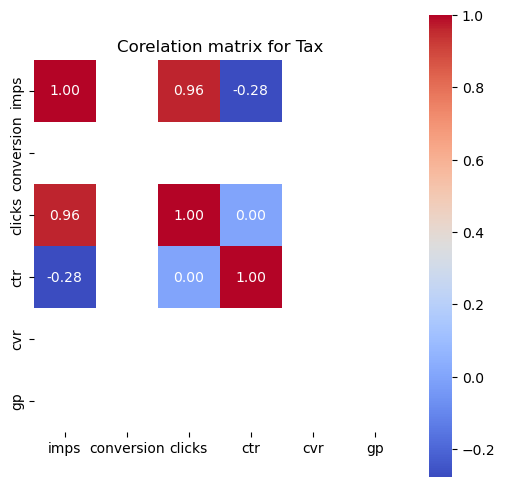

['turbo tax 2024', 'turbo tax', 'turbo']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



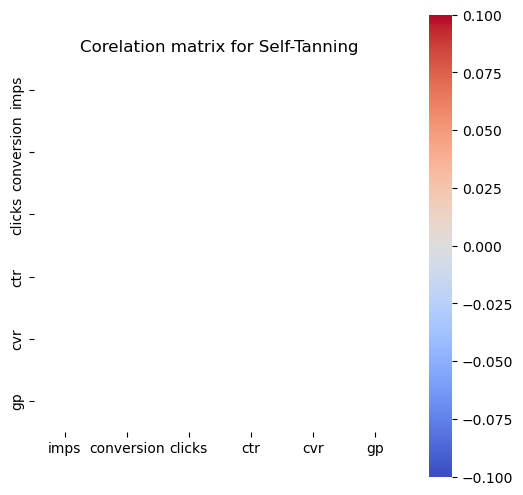

['tanning lotion']


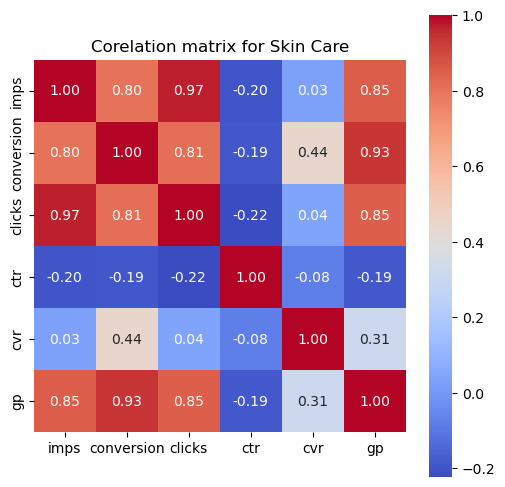

['microneedling', 'morpheus8', 'fraxel', 'fractional laser', 'pico laser', 'dermaplaning', 'dermablading', 'dark spots hands', 'pixel laser', 'pixel', 'pitted scars', 'prf treatment', 'prf', 'potenza', 'pores', "men's face laser treatment", 'melasma laser toning', 'láser treatment', 'neck treatment', 'nctf 135', 'micro', 'nucell skin me', 'midtown laser spa', 'mironeedling', 'micro needling albany ny', 'micro needling', 'micro needle', 'micro dermabrasion', 'micronedling', 'microneedlong', 'microneedlings', 'microneedling rf', 'microneedling prp', 'microneedle', 'my sunshine beauty', 'morpheus', 'morphe', 'tixel', 'underarm pigmentation', 'under eye treatment', 'undereye', 'tags remover', 'tca cross acne treatment', 'xanadu', 'v beam', 'vitruvian beauty lounge.', 'scottsdalesculpt', 'santa ana zoo', 'scars', 'scarlett rf', 'scar laser', 'scar', 'radiofrequency', 'radiofrequency microneedling', 'prp microneedling', 'prp microneedle', 'prp micro', 'rf and micronedling', 'resurfacing', 'r

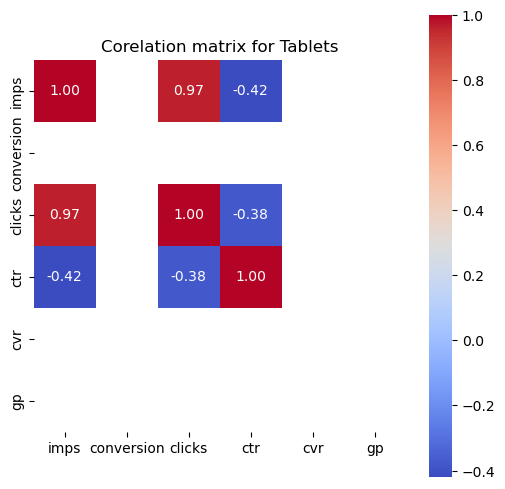

['tablet', 'screen repair for ipad', 'ipad pro', 'ipad minu', 'ipad 7.9', 'ipad 10th gen', 'ipad']


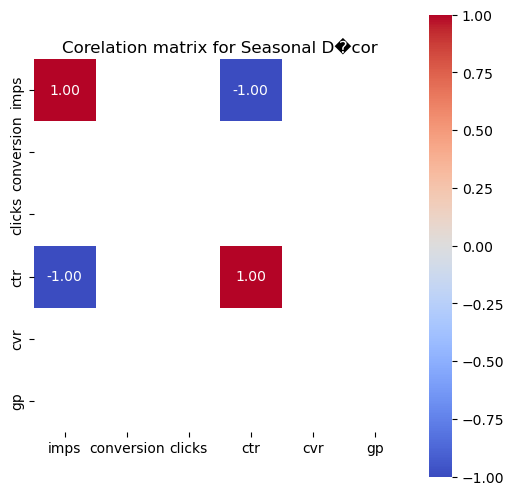

['tear trough filler', 'christmas storage']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



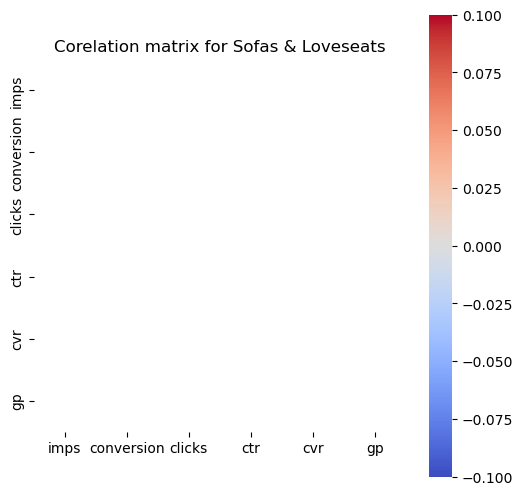

['teal chair']


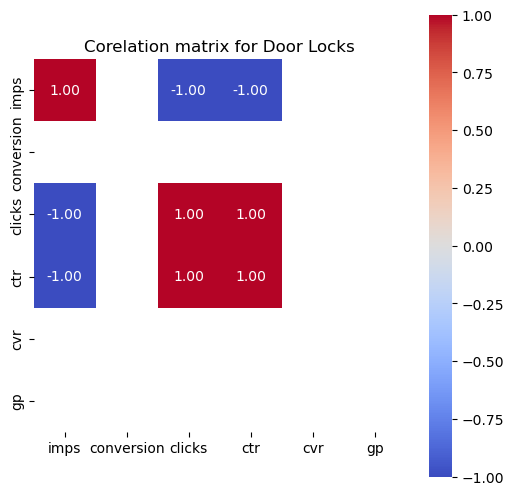

['tcl lock', 'door knobs']


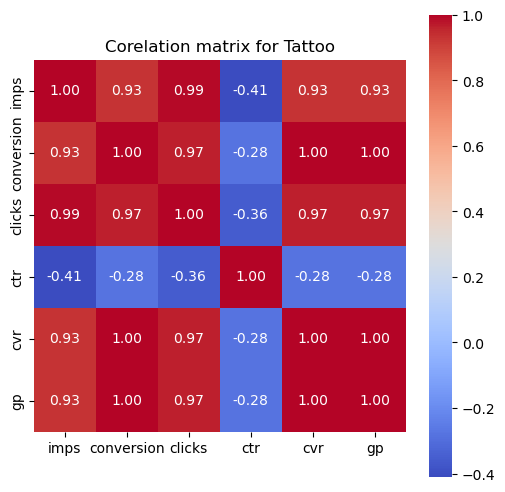

['tattoo removal', 'tattoos', 'tattoo shops', 'tattoo removable', 'tattoo', 'tatto removal lake forest', 'stretch marks', 'discover pico laser removal eyebrows tattoo', 'henna dye', 'laser tattoo removal', 'laser tattoo', 'laser scar removal', 'eyebrow tattoo removal']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



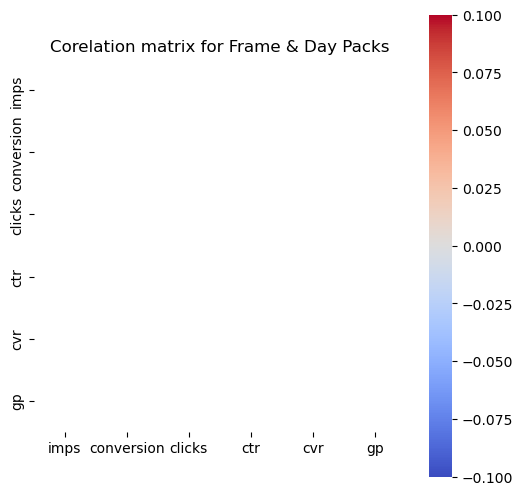

['sunglasses case']


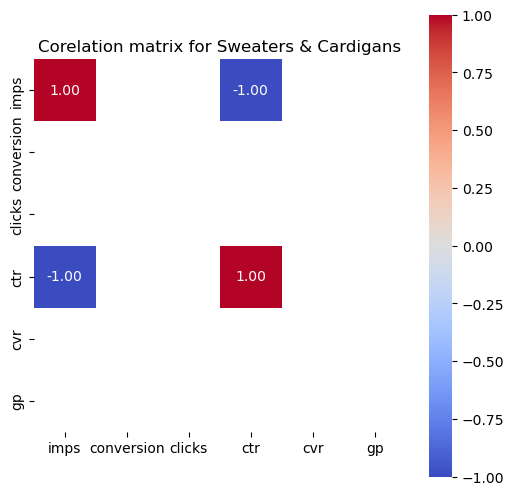

['sweaters', 'sweater full length']


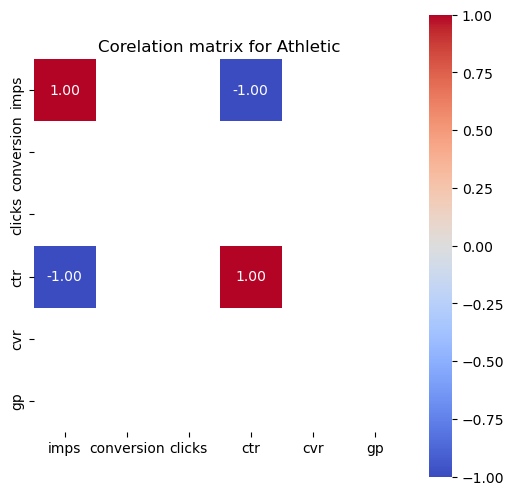

['sweat', 'water shoes']


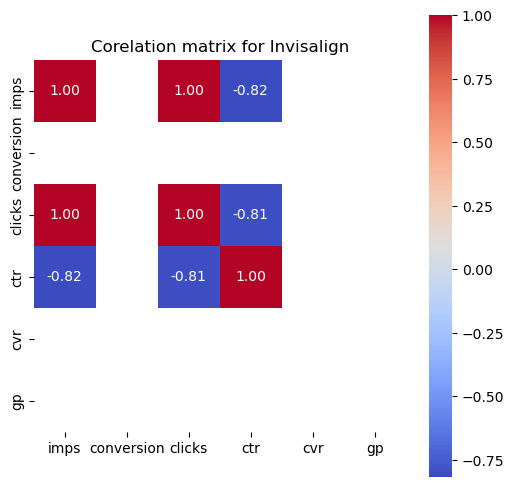

['teens', '6 month smiles invisilign', 'braces', 'invisalign']


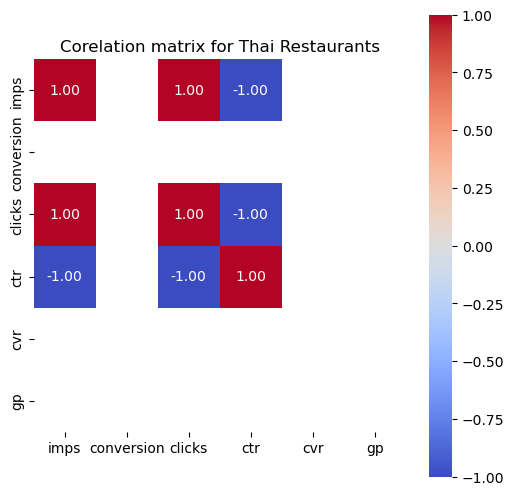

['the sea', 'cruise dinner for 6']


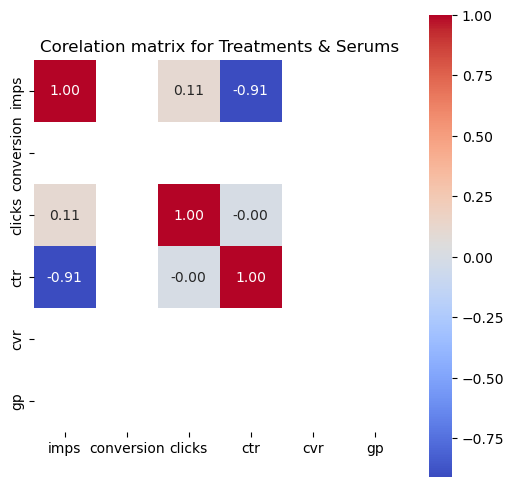

['the rich cream', 'yonka', 'skinceuticals c e ferulic', 'jan marini', 'evel']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



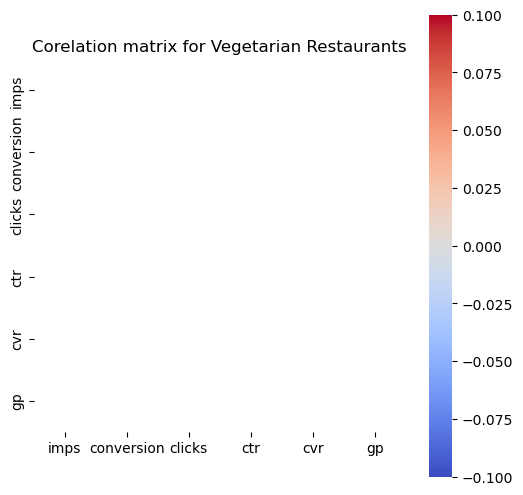

['thia food']


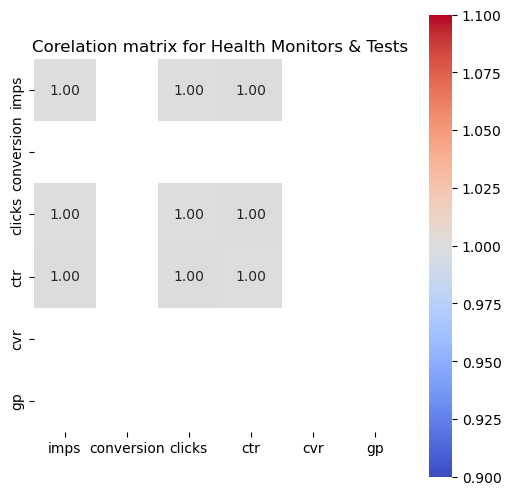

['thermometer', 'dna']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



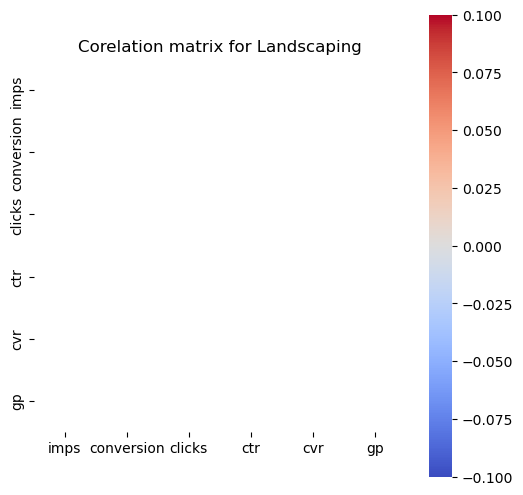

['terrarium']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



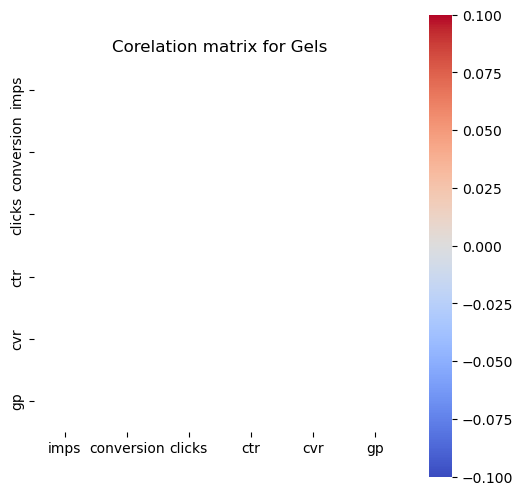

['teeth whitening kit']


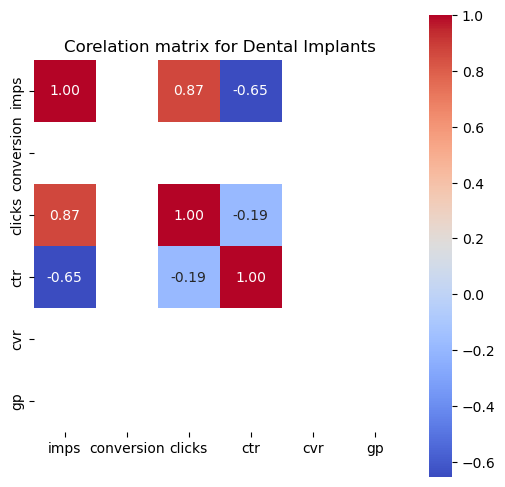

['teeth implant', 'veneers', 'veneer']


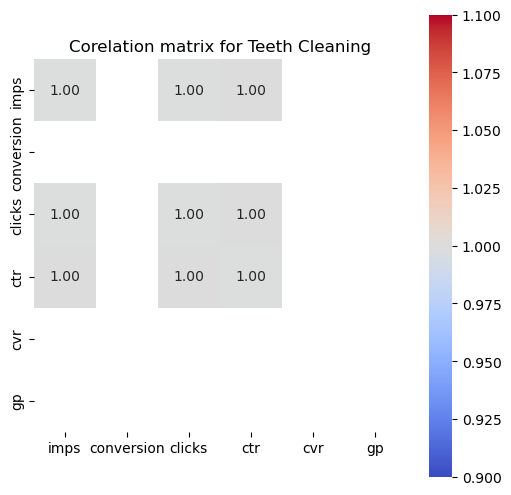

['teeth deep cleaning', 'dental exam']


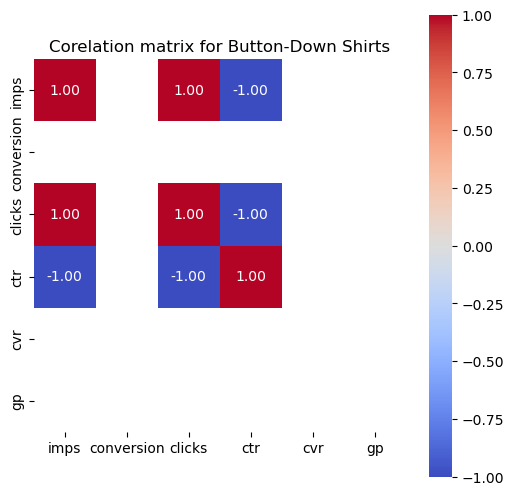

['the duttons', 'shirt']


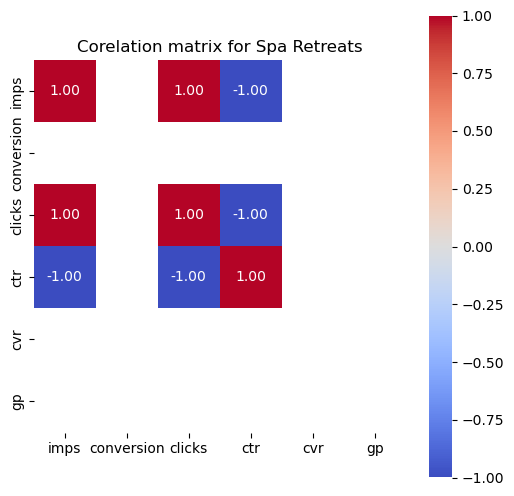

['the abbey', 'romantic getaways', 'geneva']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



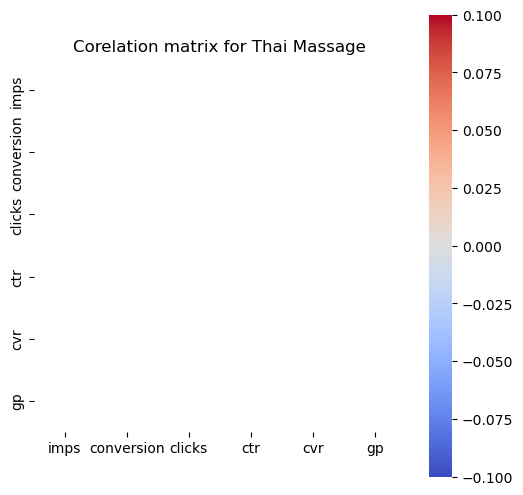

['thai  massage', 'stretching', 'haircut massage']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



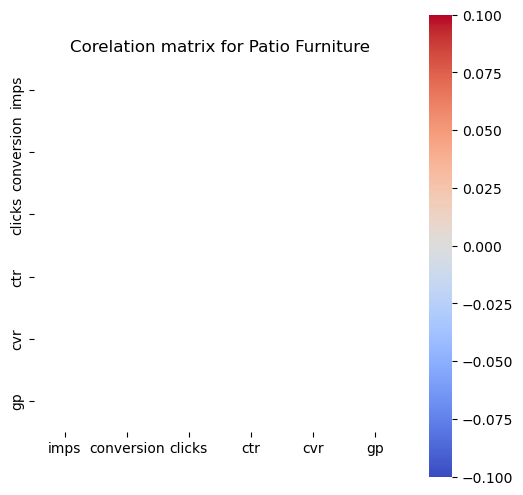

['windshield shade']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



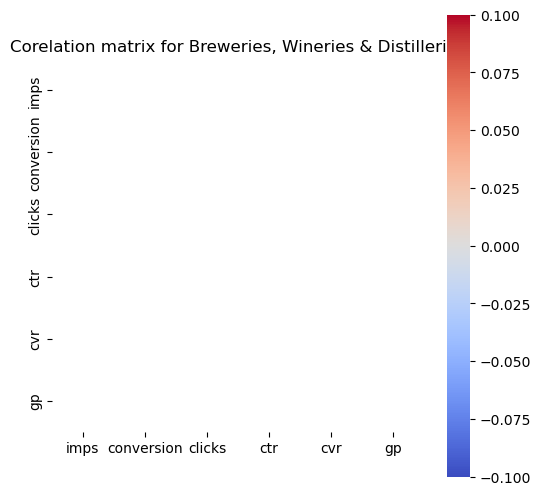

['wine tasting class', 'house wine', 'fragrance making class']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



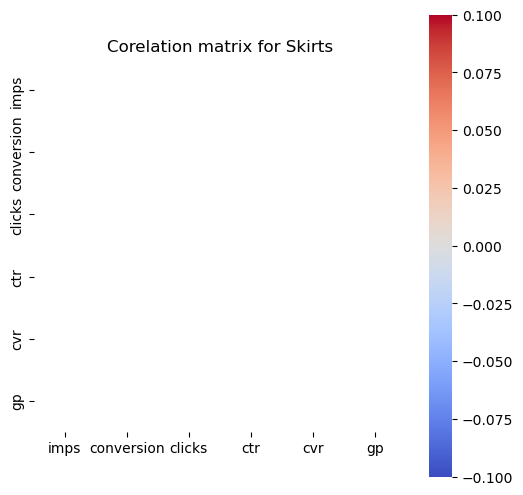

['woman shoes']


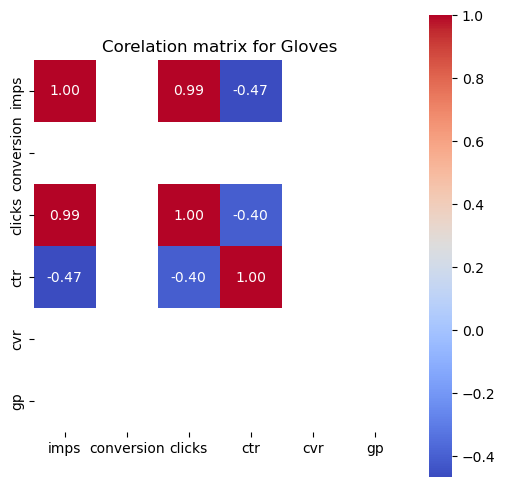

['winter gloves men', 'cashmere', 'arthritis gloves', 'gloves']


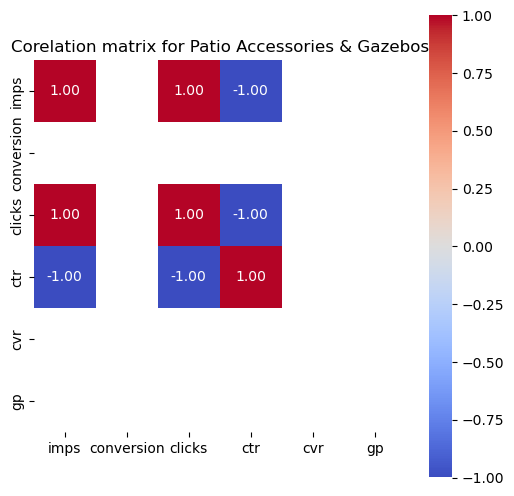

['white party tent', 'wedding']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



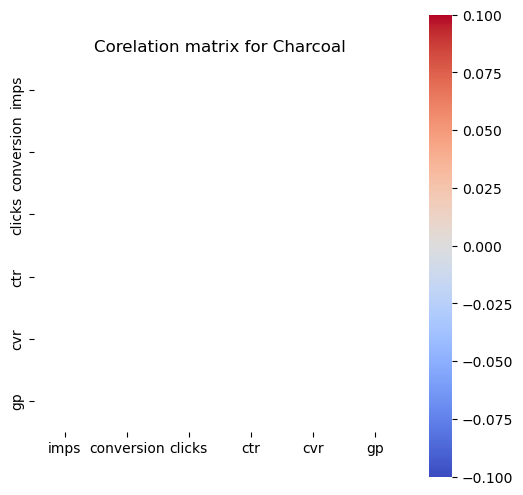

['white chocolate grill']


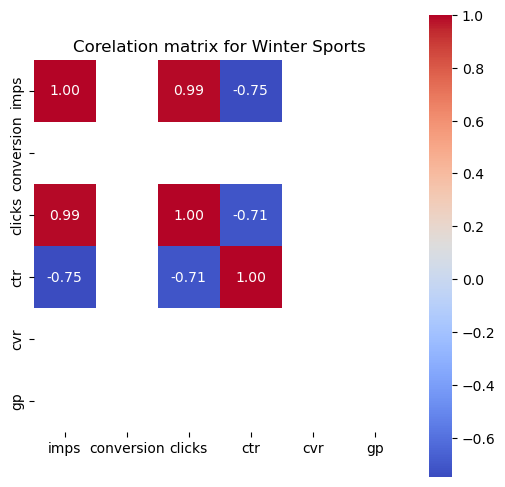

['weston ski track', 'snowmobile', 'snowboarding', 'skiing']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



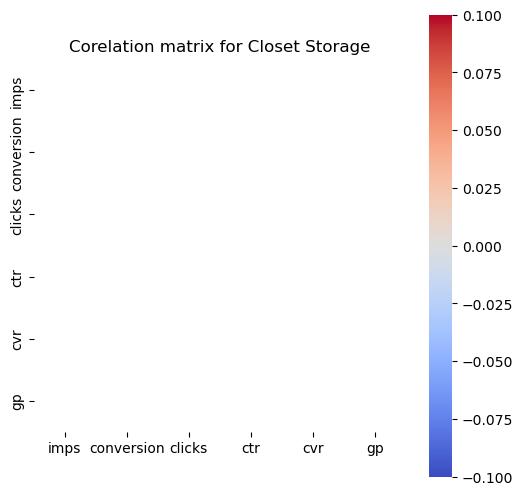

['womem clothes', 'key hanger']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



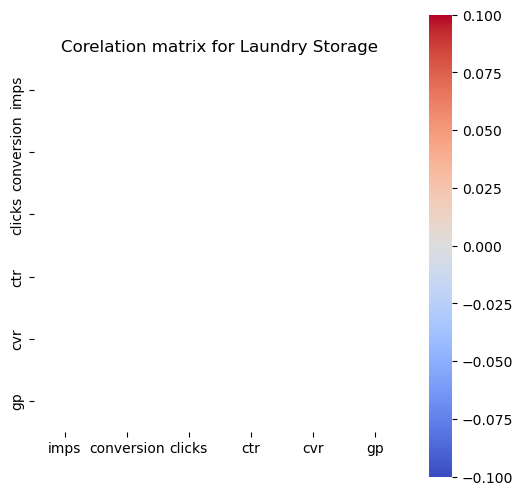

['womem clotjes']


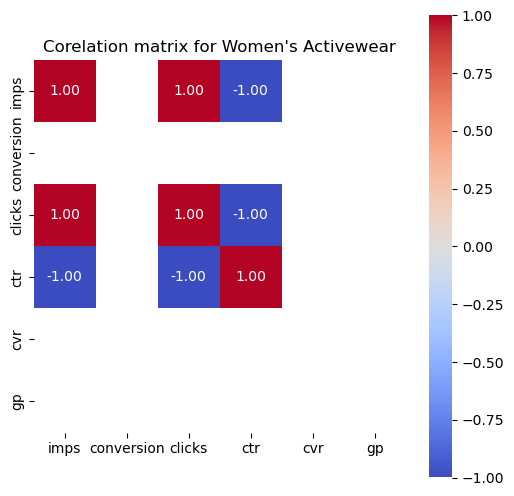

['yoga pants', 'women cloyhes', 'women clothes', 'high tea']


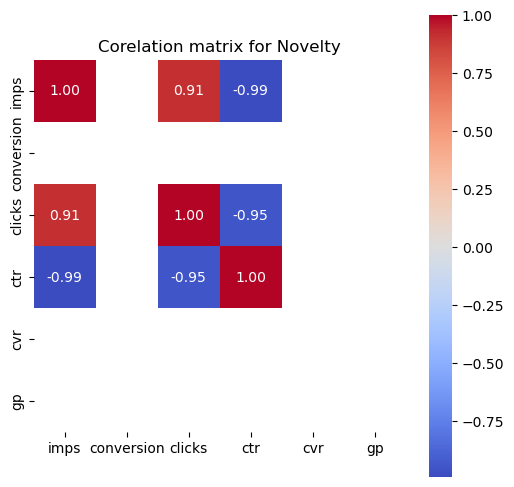

['yellow gold ankle bracelet', 'butterfly', 'anklet', 'jewlry', 'ear rings']


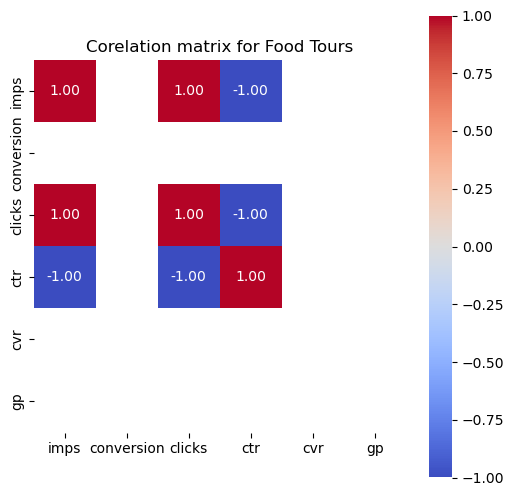

['ybor city', 'chocolate tour', 'creole queen river']


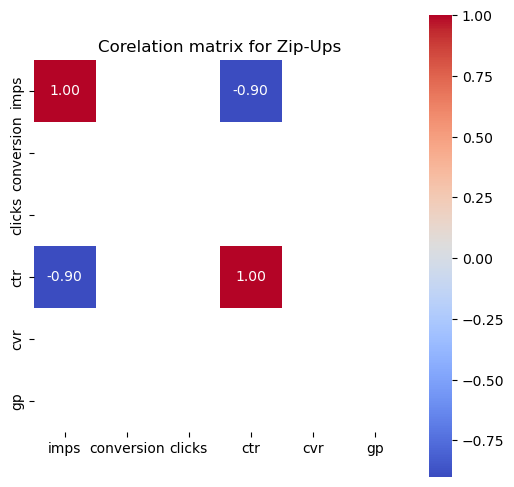

['zip', 'work jacket', 'dallas cowboys']


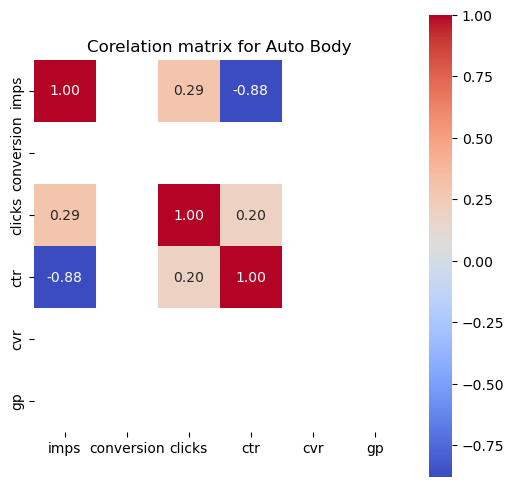

['z bart', 'rim scratch', 'detail and auto body repair', 'body repair shop', 'headlight', 'lawrenceville']


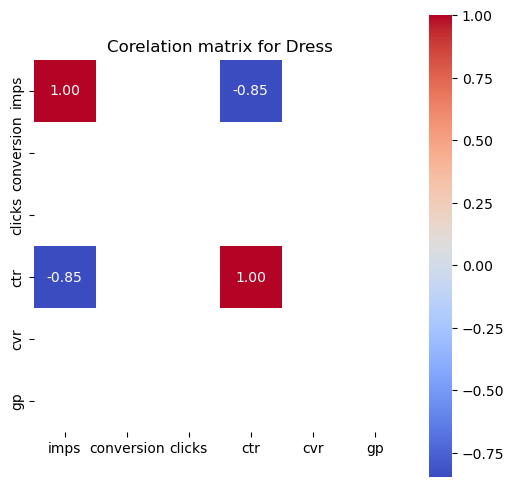

['women’s heels', 'womens swing dresses', 'womens cargo stretch pants', 'shoes rack', 'lady godiva womes high heel pumps', 'dress pants']


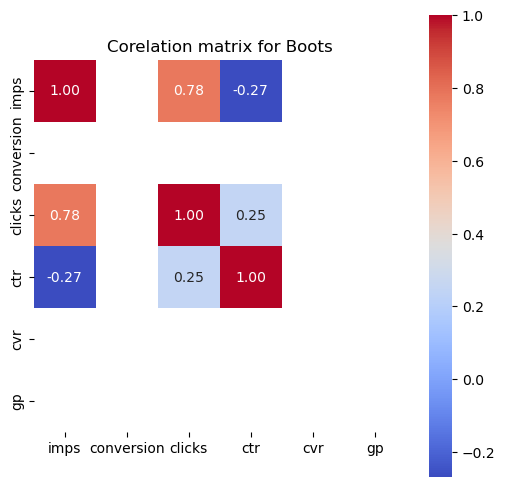

['womens winter boots', 'work boots', 'steal toe boots', 'snow', 'size 7 work boots men', 'chelsea boots']


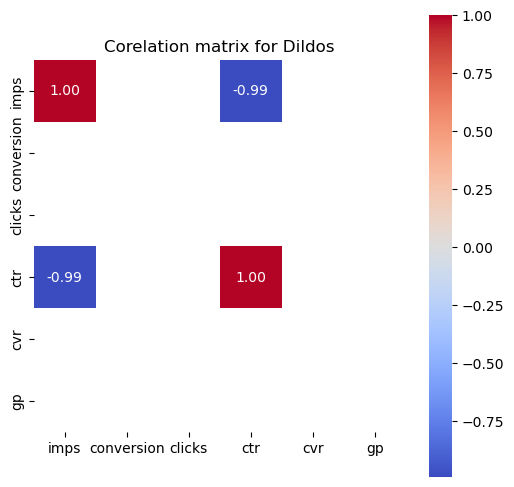

['womens toys', 'dildos', 'flex dildo']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



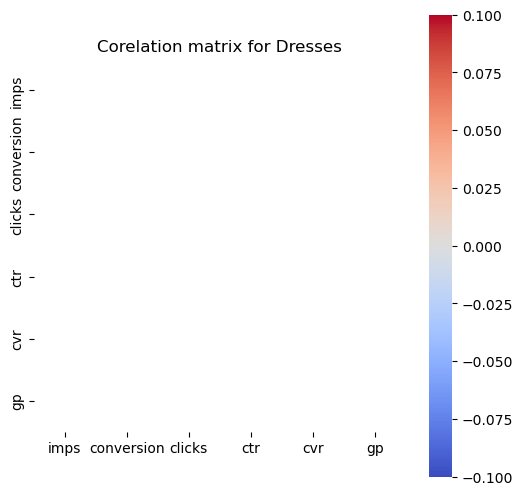

['womens swing dresses']


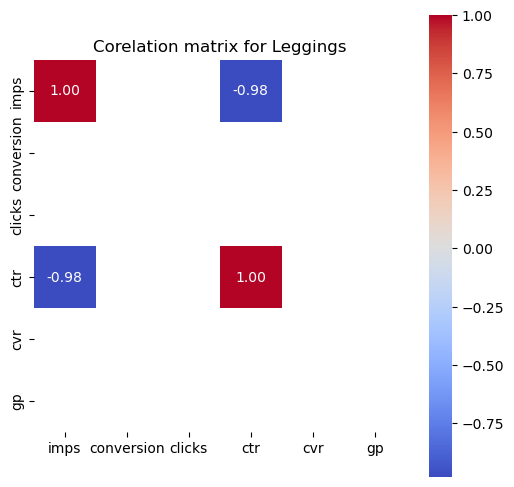

['womens jeggings', 'jivini pants', 'jeggins', 'jvini']


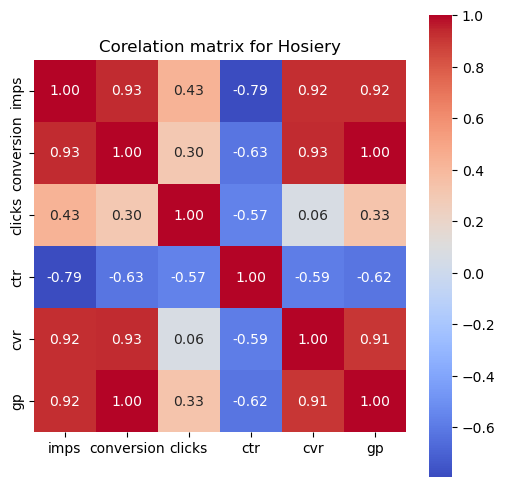

['holiday compression socks', 'compression socks', 'tights', 'thigh highs', 'winter', "women's textured tights", '10036']


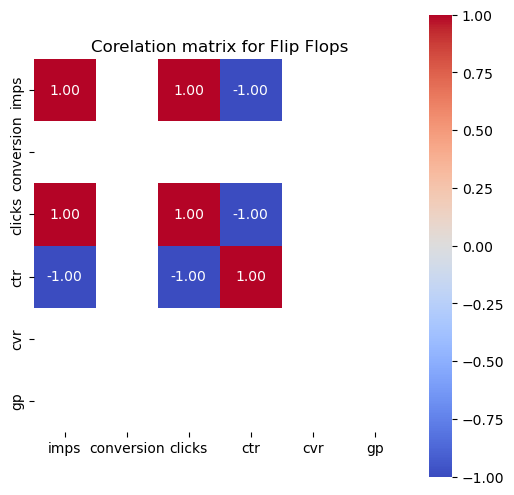

["women's sandals", 'sandels for women']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



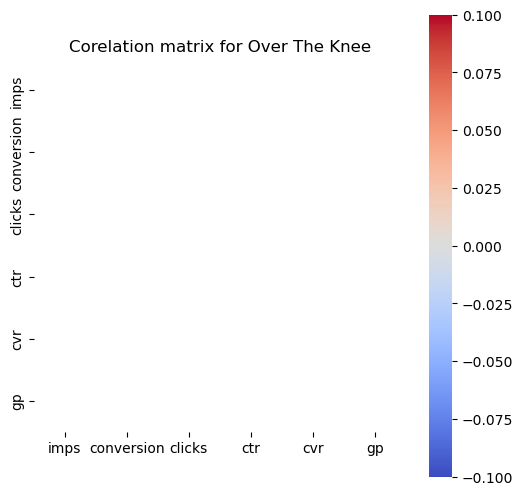

["women's boot"]


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



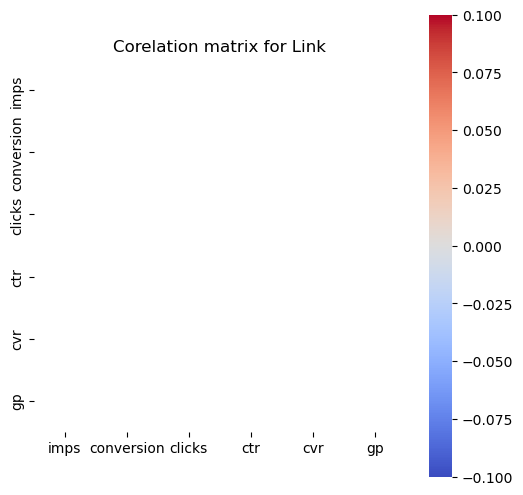

['women watch']


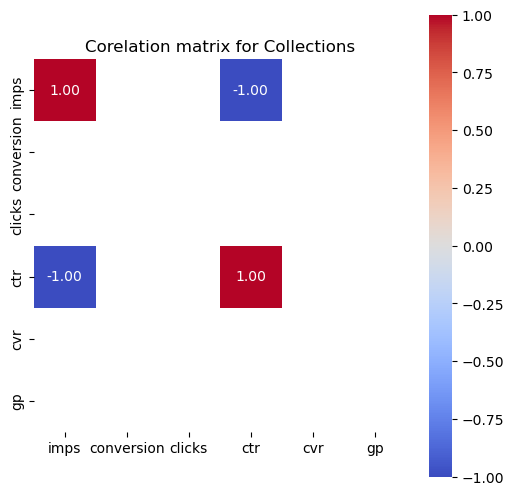

['women jewelry', 'black diamond earrings']


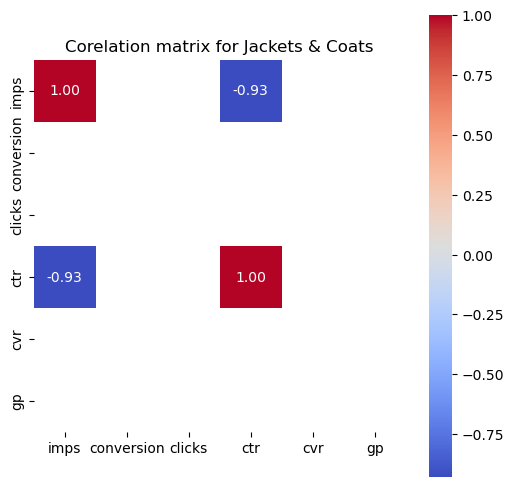

['women coats', "jacket women's", 'genuine down coat/jacket']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



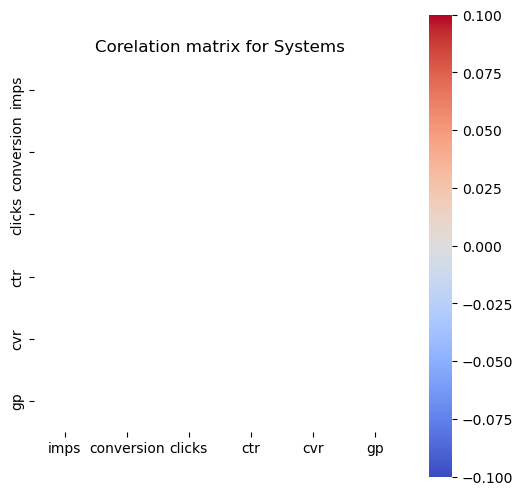

['wyze']


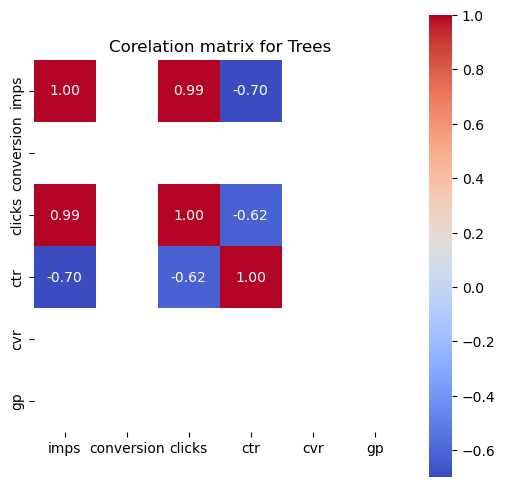

['wrought iron ornament holder', 'cat', 'cat tree']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



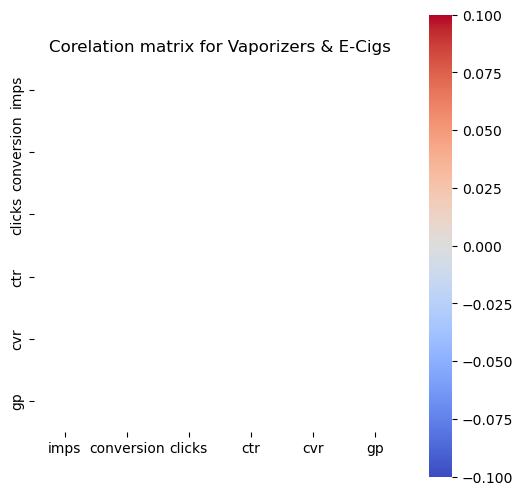

['vape']


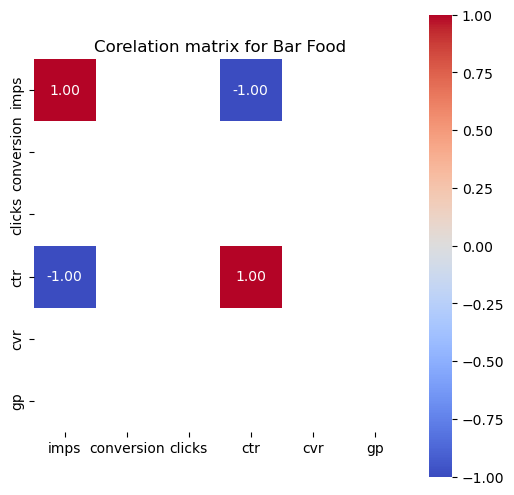

['village idiot', 'gift basket food']


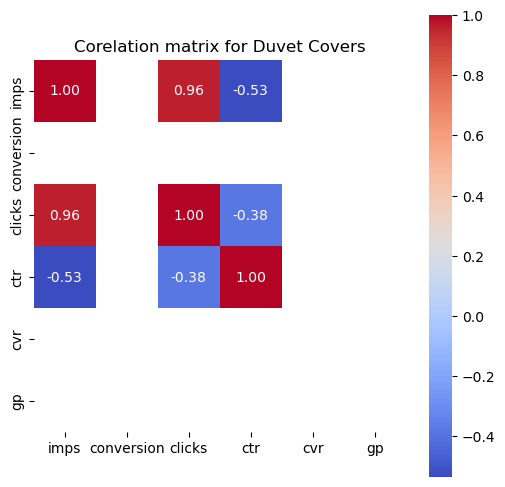

['vet visits for sog', 'cuisine at home', 'duvet set', 'duvet covers', 'duvet cover twin', 'duvet', 'foldable shoe racks with cover']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



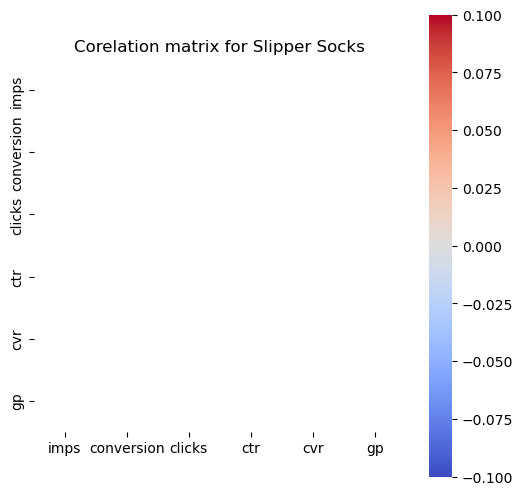

['valentine’s day']


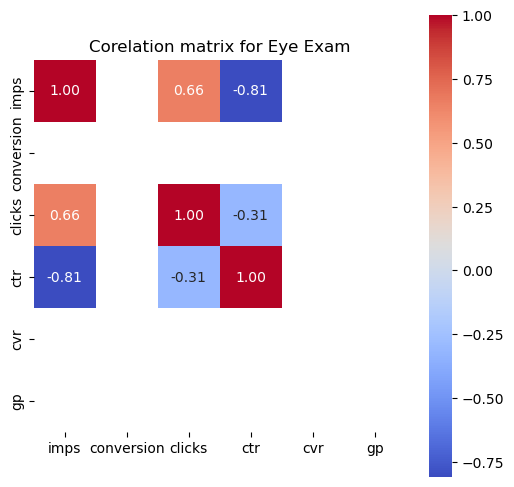

['vision', 'contact lens eye exam', 'contacts lens exam', 'contacts', 'contact lens exam']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



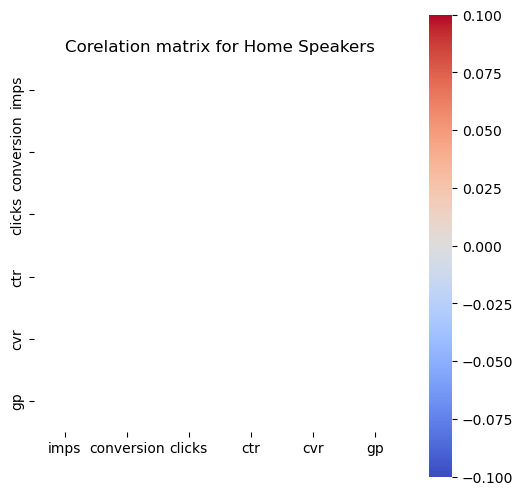

['waterproof speakers']


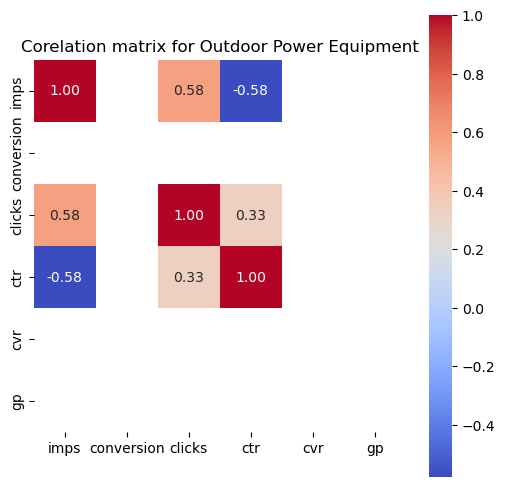

['welder', 'weedeater', 'cordless snow shovel', 'hot wheels monster truck']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



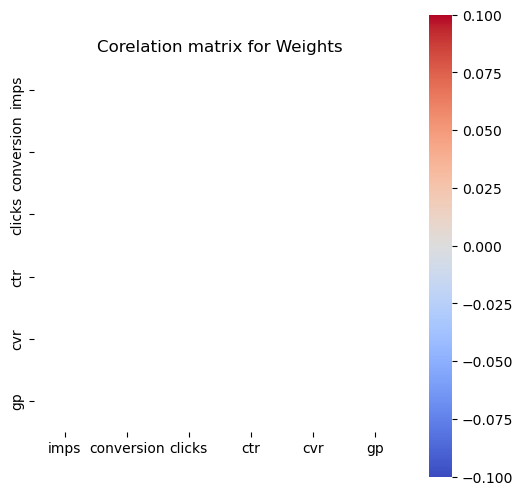

['weights']


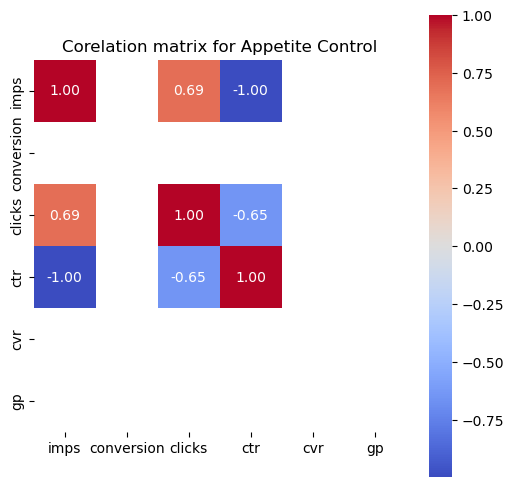

['weight loss patch', 'diet pill', 'appetite suppressant']


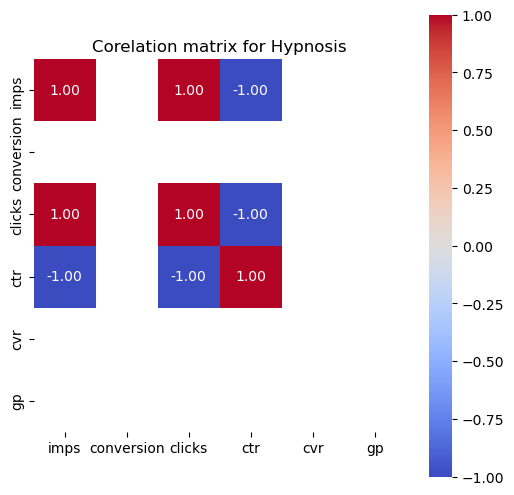

['weight lose', 'hypnotherapy', 'hypnosis']


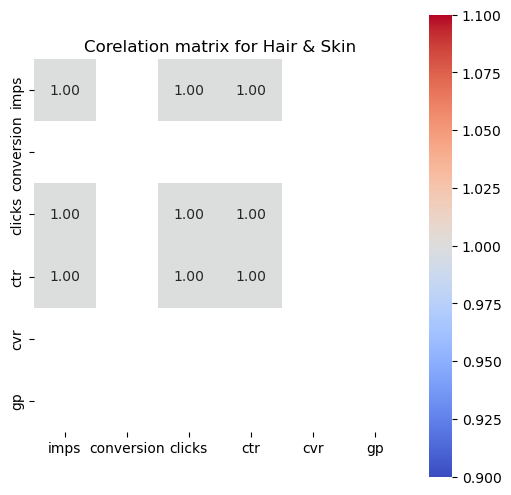

['viviscal pro', 'viviscal']


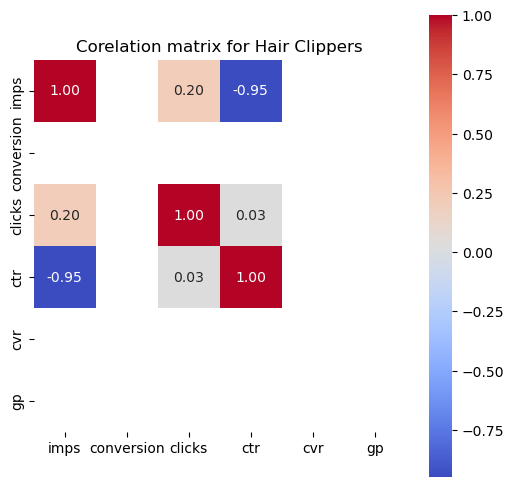

['wahl', 'clippers', 'clipper', 'babylisspro clips', 'babylisspro', 'baby less clippers', 'haircut clippers', 'hair trimmer']


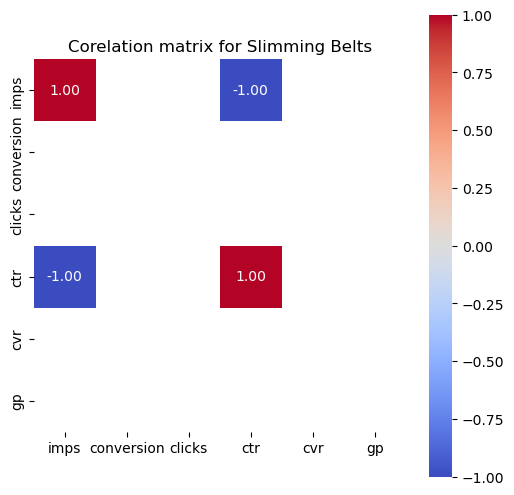

['waist trainer', 'waist traner']


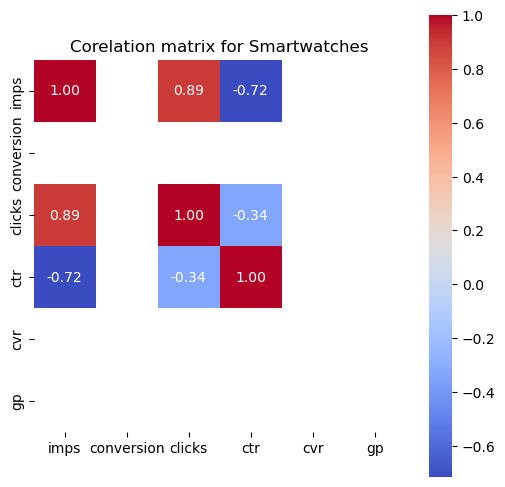

['watches', 'apple watch series 9', 'apple watch men', 'apple watch']


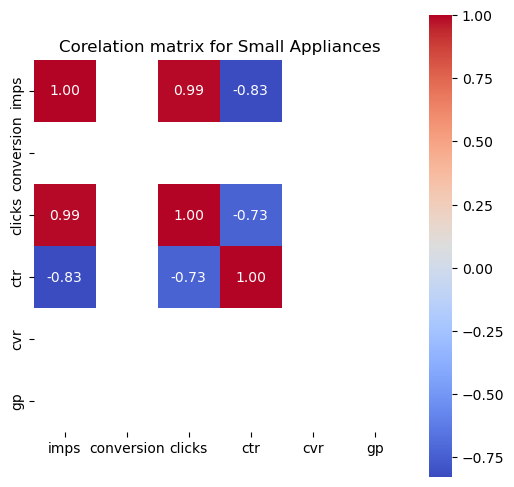

['warmer mugs', 'stove top covers', 'air fryer']


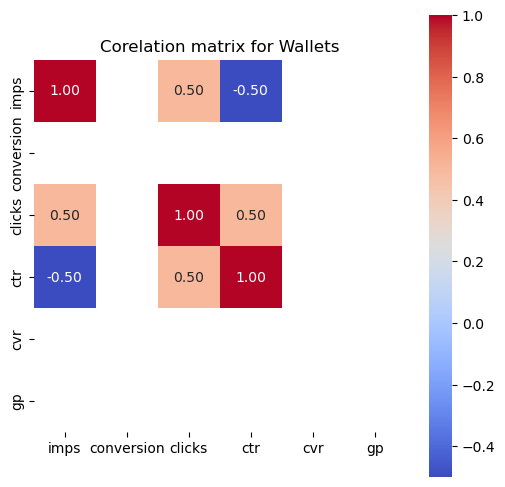

['wallets\\', 'wallet', 'leather hobo bag']


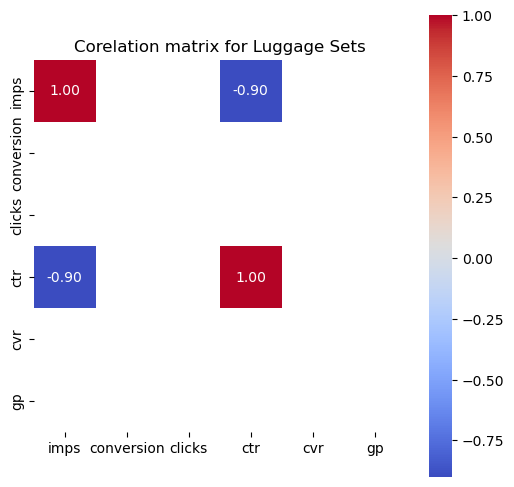

['suitcase', 'jasper, ab', 'external hard drive']


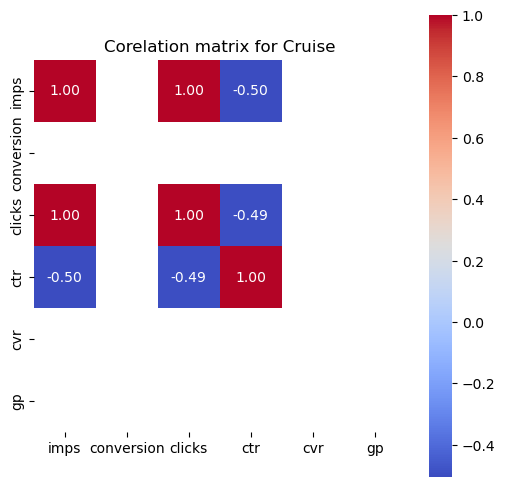

['san diego harbor cruise', 'river cruises overnight', 'carnival cruise', 'crusie', 'cruize', 'cruises', 'cruise tickets', '4 day getaway', 'bahamas cruise', 'bahama cruise']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



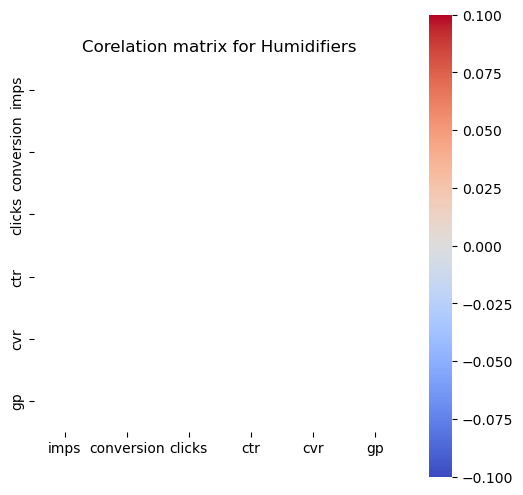

['salking 2-in-1 ultrasonic essential oil diffuser']


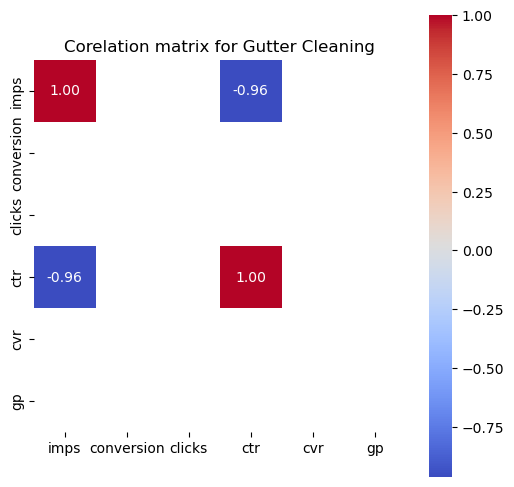

['roofing', 'gutters', 'gutter']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



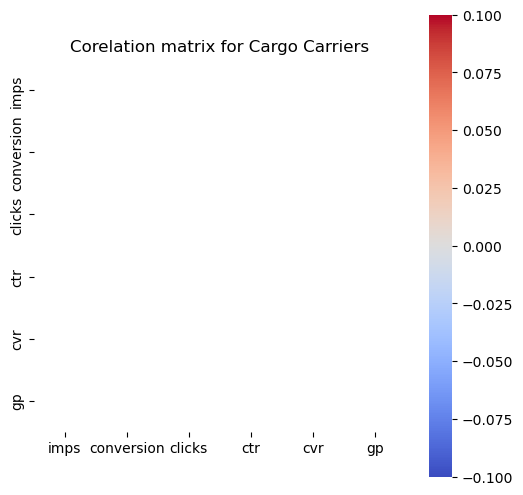

['roof']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



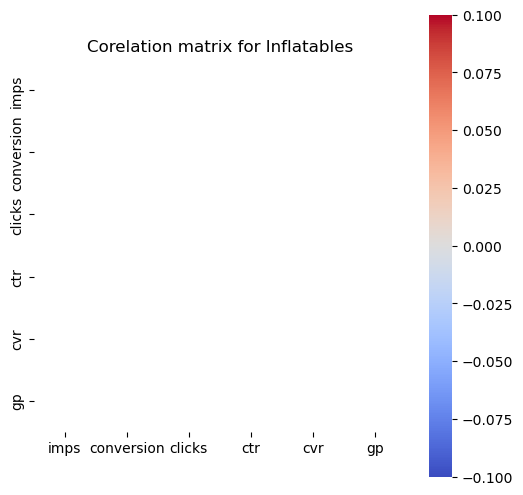

['rockin jump']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



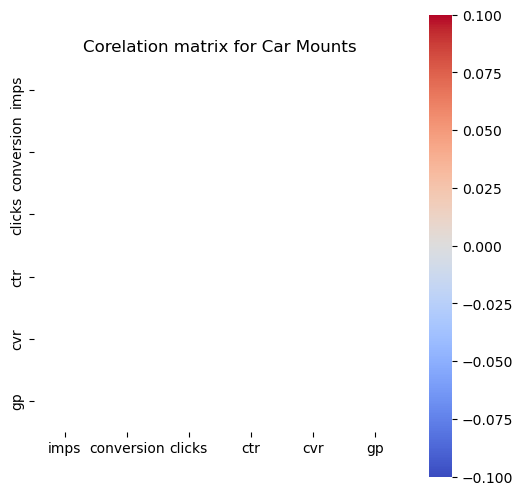

['rotating spicerack']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



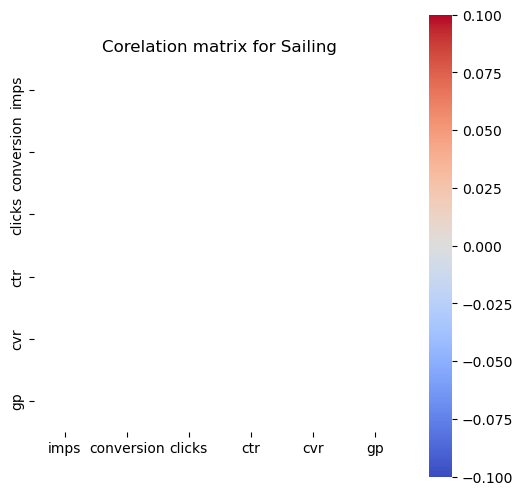

['sailing lesson']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



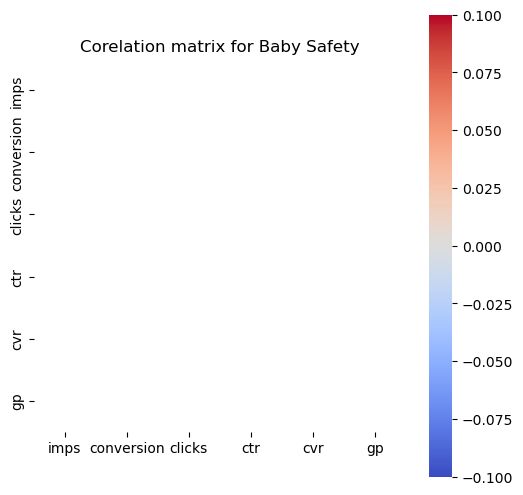

['safe']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



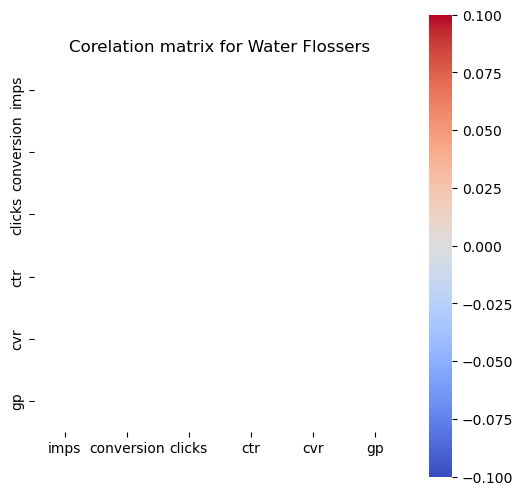

['ryobi electric cleaner']


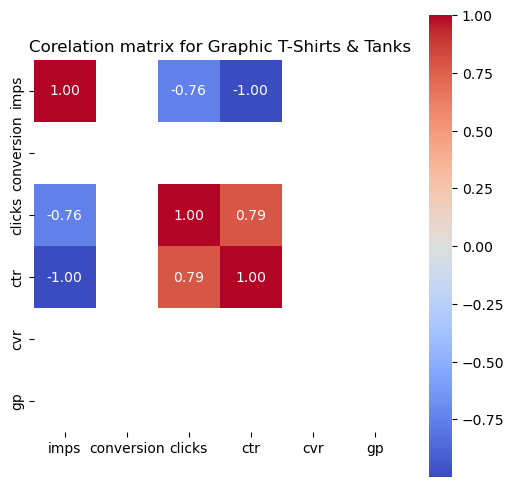

['royal gorge jeep tour', 'beard', 'jersey']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



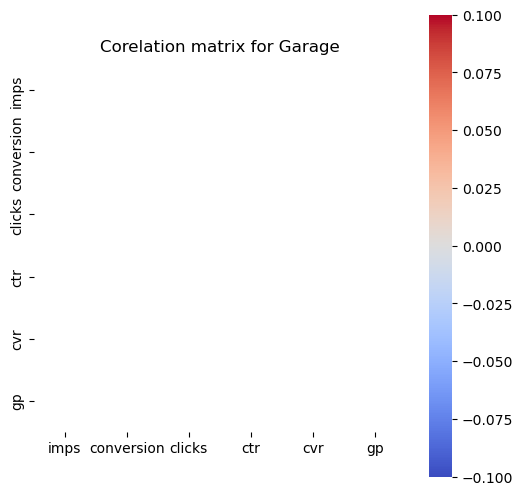

['rug for door', 'door repair']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



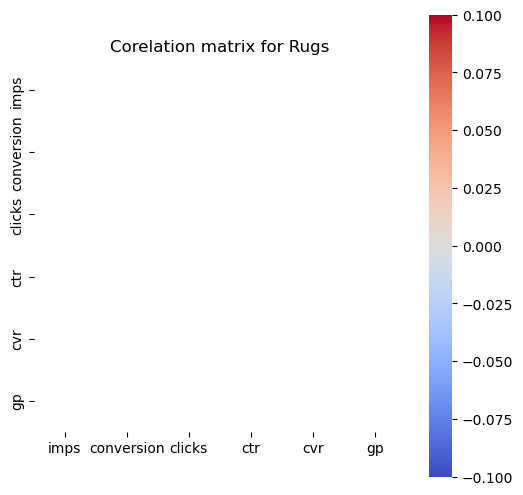

['rug']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



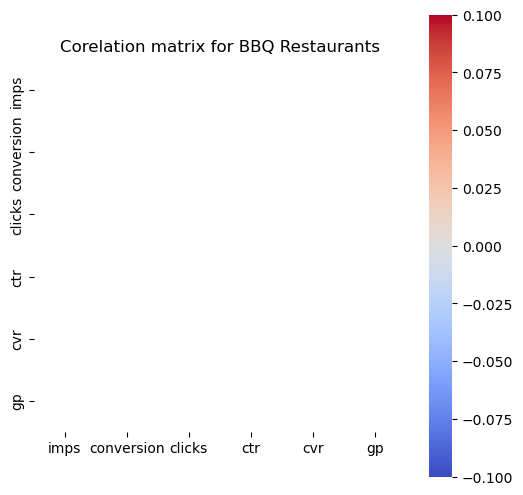

['rudys', 'dinner for si', 'a-aki']


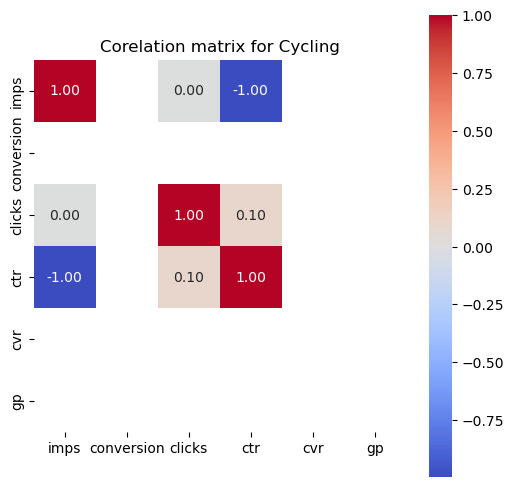

['scooter vegas strip', 'biking', 'bike rental']


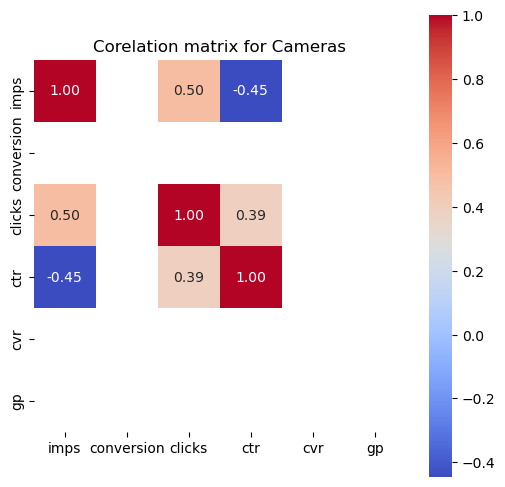

['security camera', 'security', 'ring camera', 'ring', 'sony', 'camera', 'canon ixy 650 / elph 360 digital camera', 'dash cam', 'alpha a7 v', 'a7 v', 'drones']


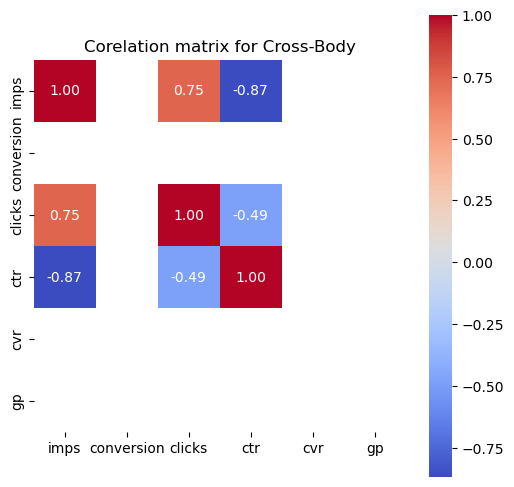

['secured credit card', 'purse', 'purs mk', 'crossbody']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



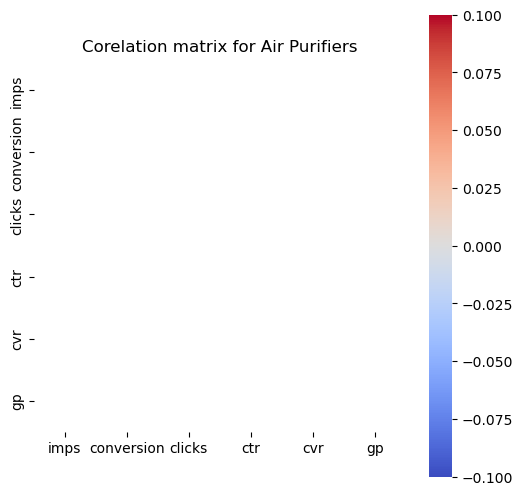

['sans air purifier']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



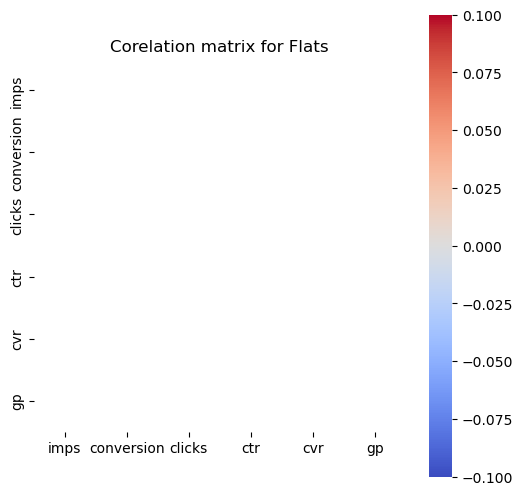

['sandals']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



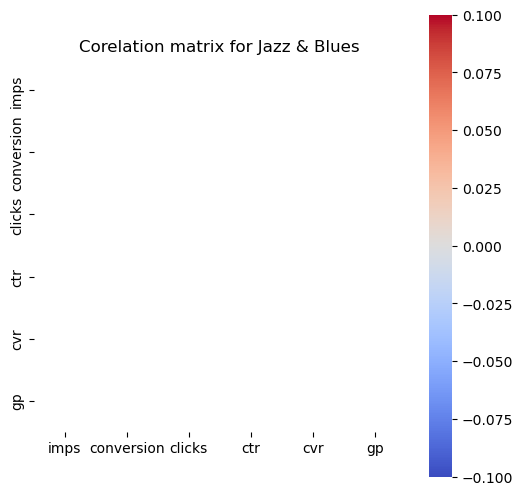

['randb concert']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



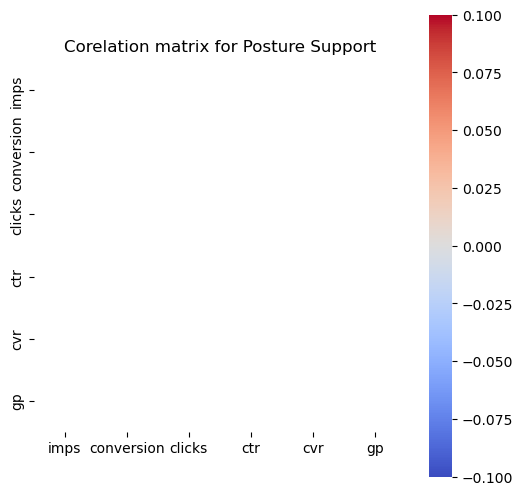

['races']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



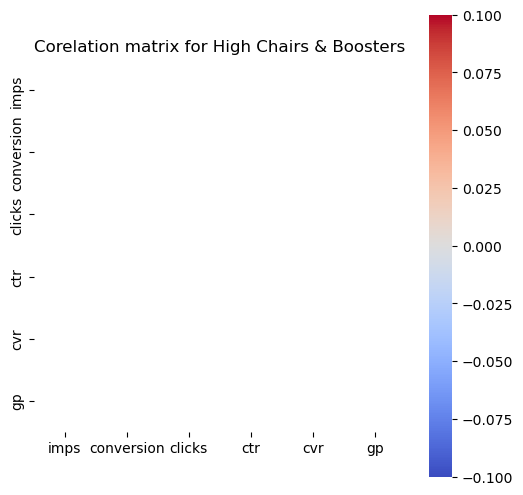

['recliner']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



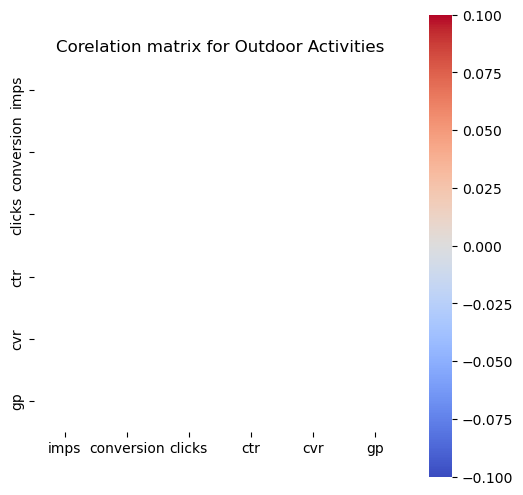

['ready set play']


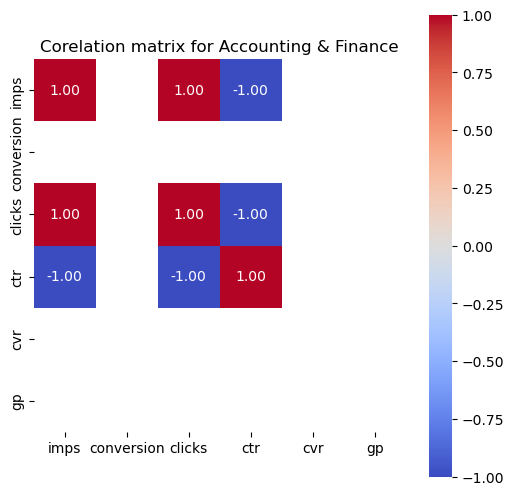

['quickbooks', 'quick books']


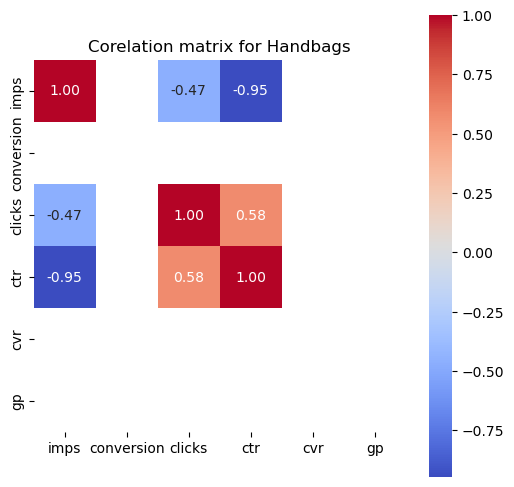

['purses', "dick's sporting goods", 'book bags', 'backpack shoe compartment']


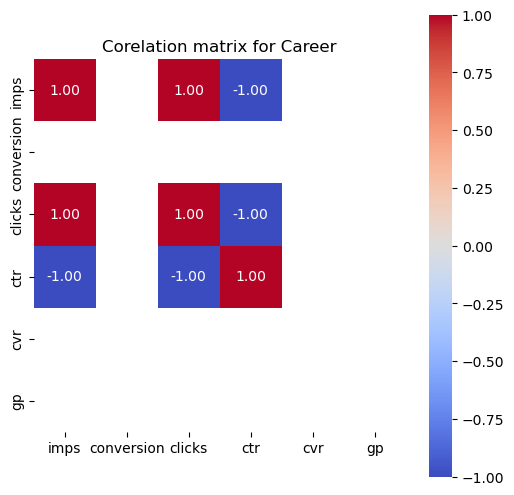

['resume workshop', 'resume']


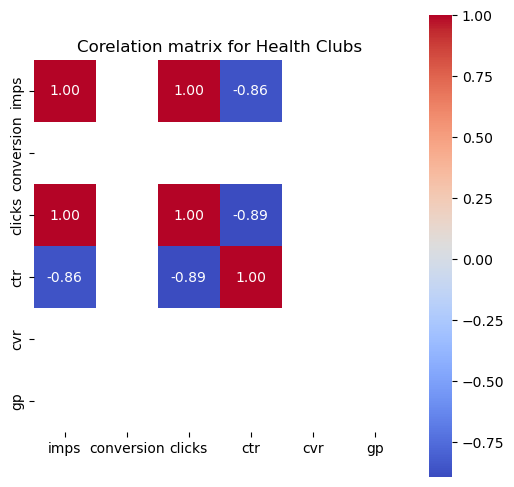

['ritani', 'gym0⁹', 'gym', 'fun fitness']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



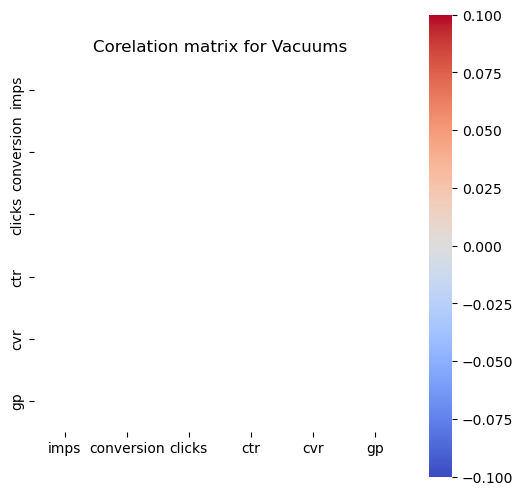

['robot vacuum and mop']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



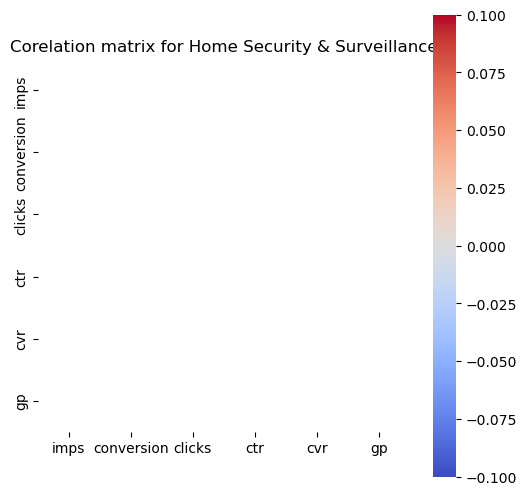

['ring doorbell']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



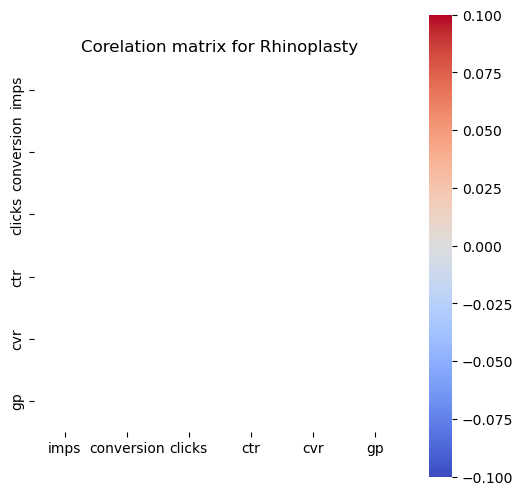

['rhinoplasty']


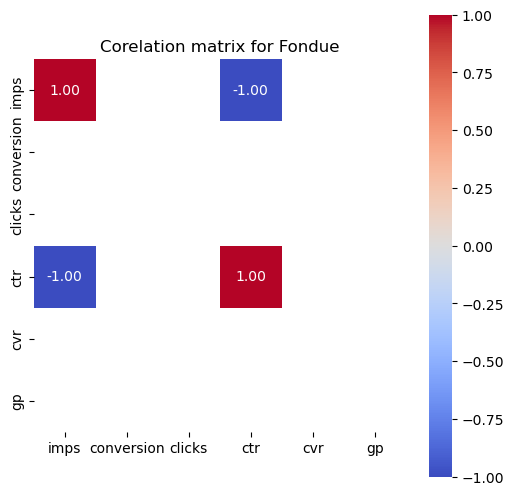

['ressturants', 'simply fondue', 'la fondue', 'la fondu', 'fondue']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



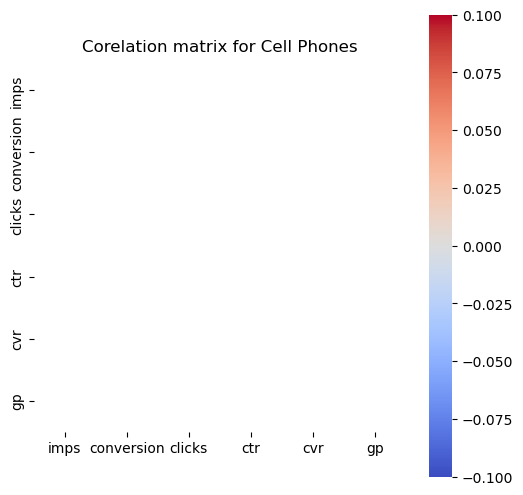

['refurbished samsung galaxy s22 ultra']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



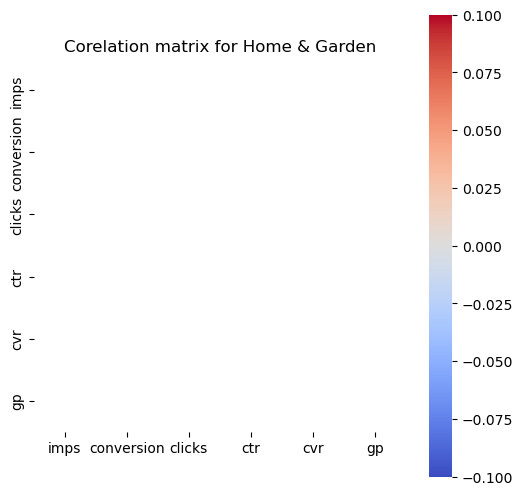

['refill propane tank in palatka florida 32177']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



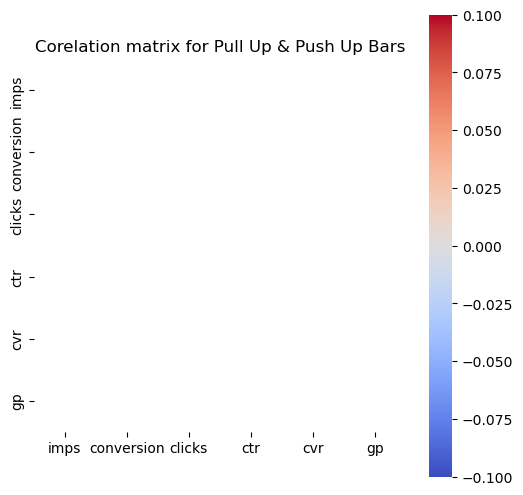

['resistance fitness']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



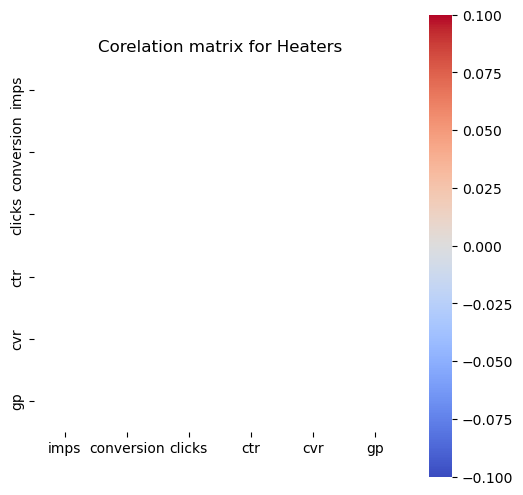

['space heater']


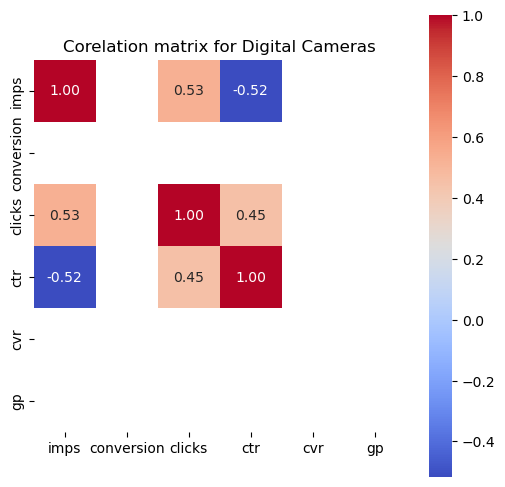

['sony', 'camera', 'canon ixy 650 / elph 360 digital camera', 'alpha a7 v', 'a7 v']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



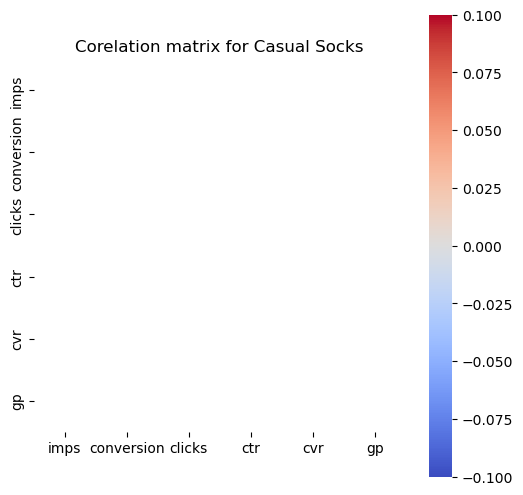

['socks']


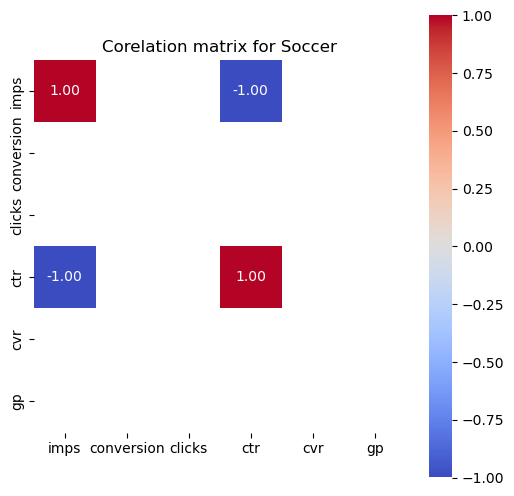

['soccer goal', 'baseball']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



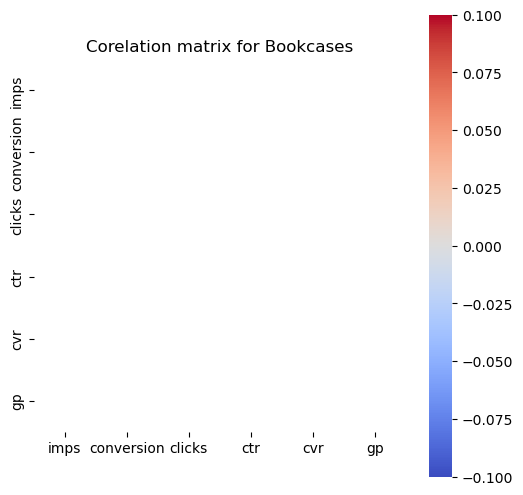

['storage cube']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



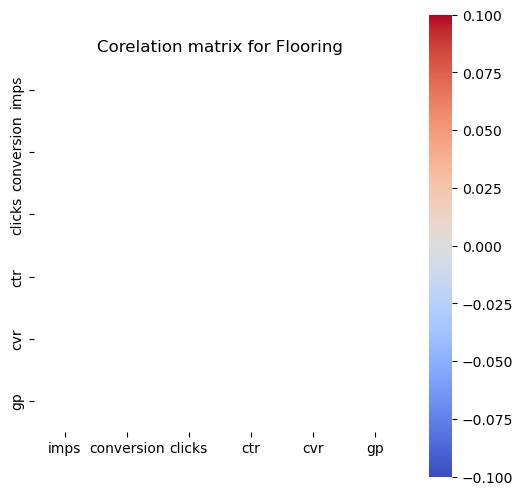

['steam mop']


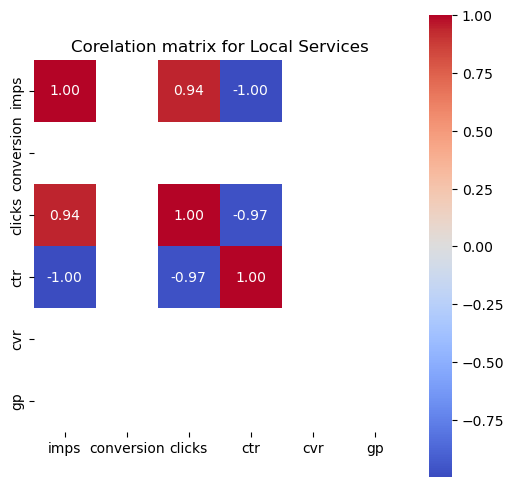

['storage', 'storage locker', 'airport lounge']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



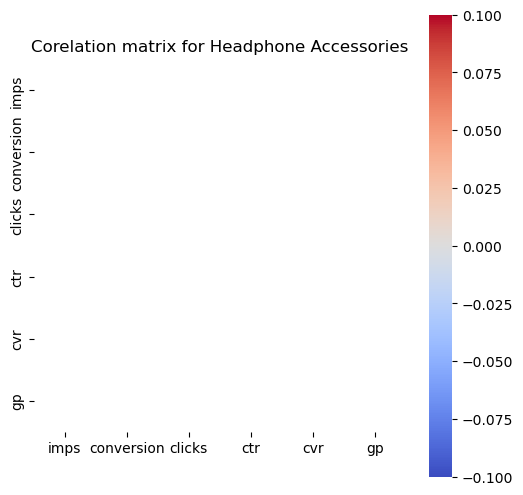

['speeders']


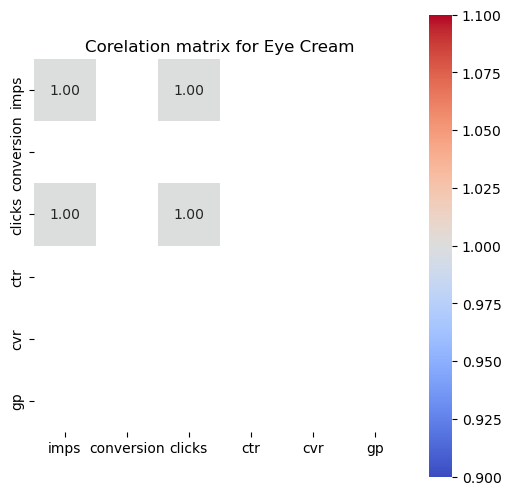

['strivectin', 'antiage']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



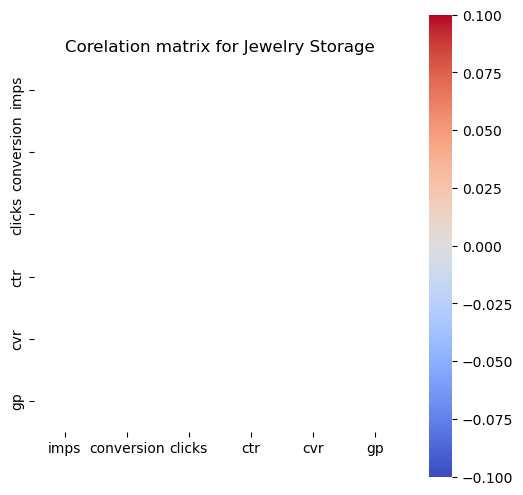

['storage facility']


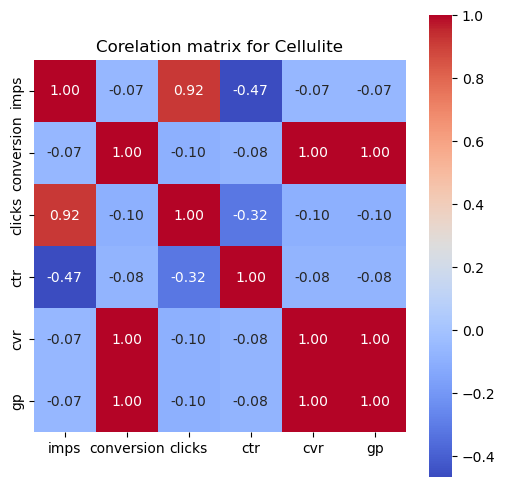

['cava lipo', 'tummy tightening', 'venus legacy', 'sculpt', 'southshore laser', 'suda tonic body wrap', 'stretch brackets for women', 'skin tightning', 'cellulie', 'cavitation', 'cavitatiin', 'cativation', 'cryolipolysis', 'body fat', 'body cavation', 'bodyology', 'fat removsl', 'fat freezing treatments', 'fat dissolve injections', 'esthetics', 'evolve body sculpting', 'endermologia', 'endermologie', 'endospere', 'freeze fat cells in metairie']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



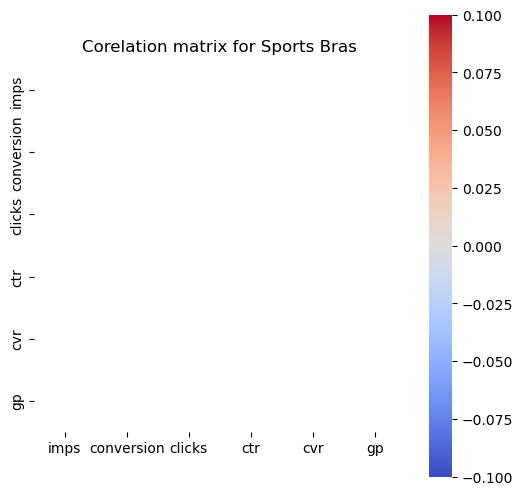

['sports and outdoors']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



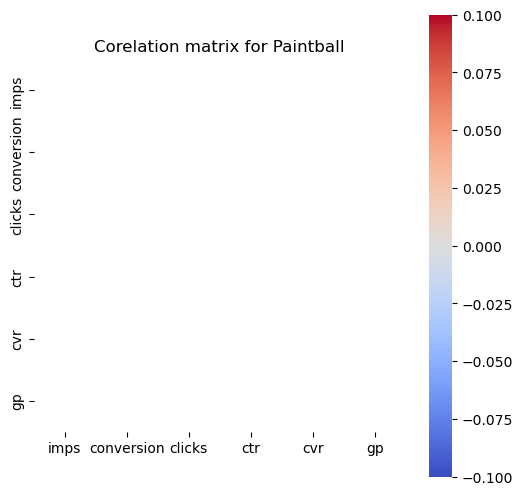

['splatter party']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



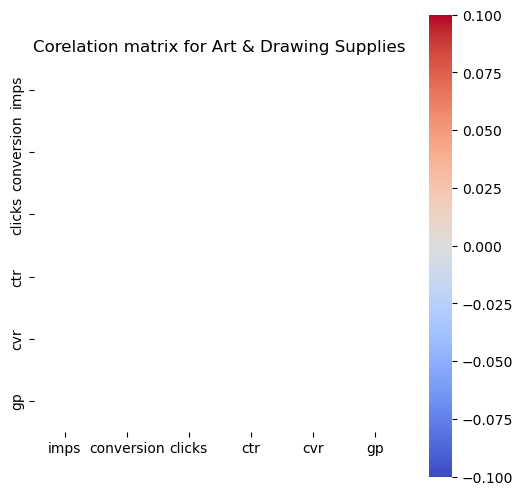

['splatter paint']


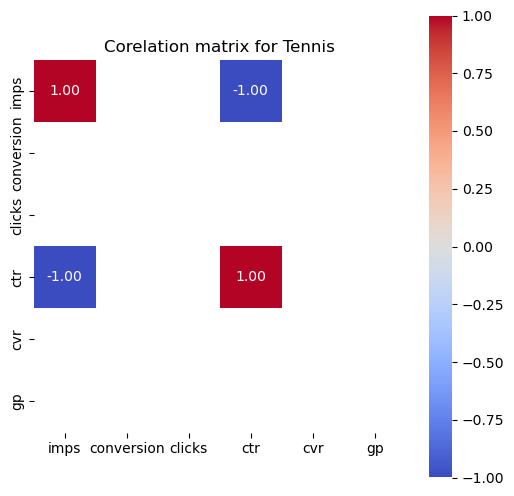

['spirit airline', 'bracelets']


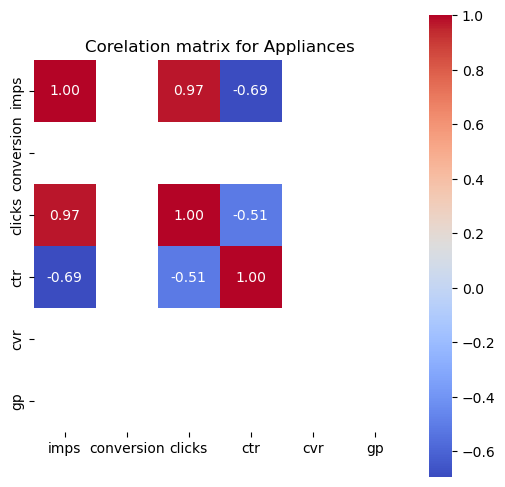

['warmer mugs', 'stove top covers', 'standard brita water filter', 'air fryer', 'ge mwf refrigerator water filter, genuine replacement filter, certified to reduce lead, sulfur, and 50  other impurities, replace every 6 months for best results, pack of 1']


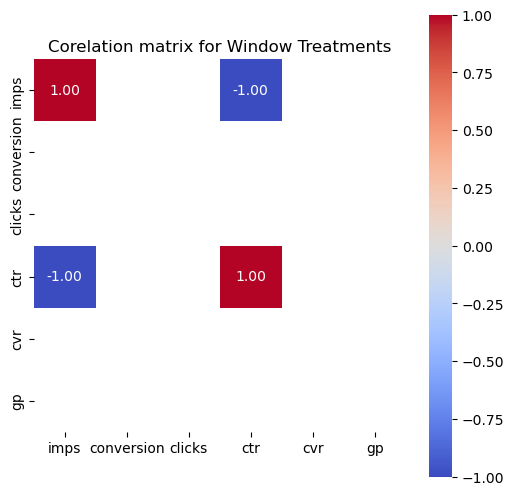

['stain glass', 'black out curtains']


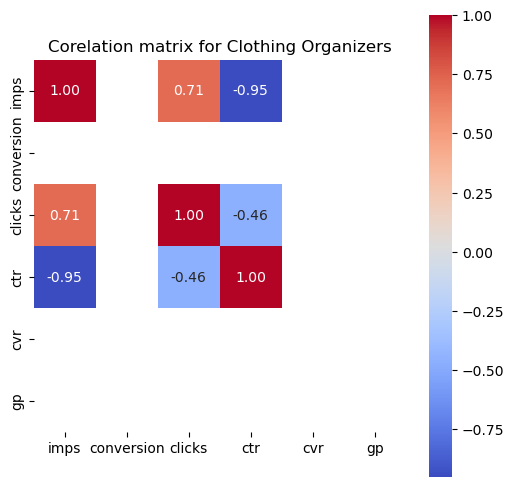

['stackable storage bins', 'side table', 'clothes rack']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



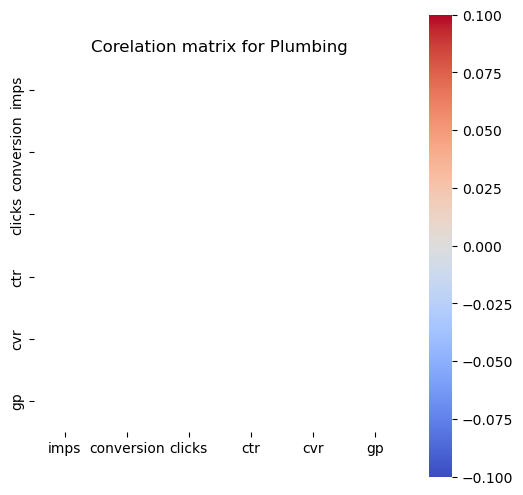

['shower head']


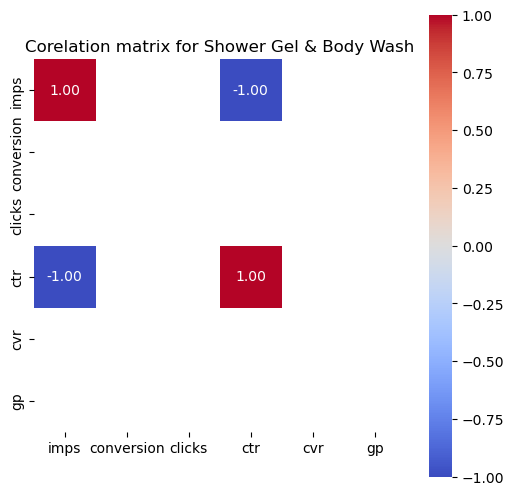

['shower gel', 'body wash']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



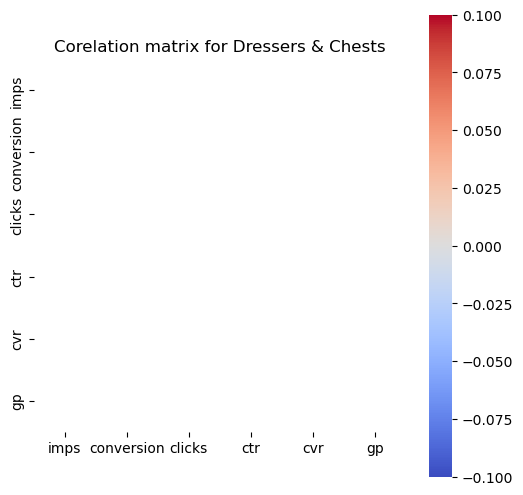

['shoes rack']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



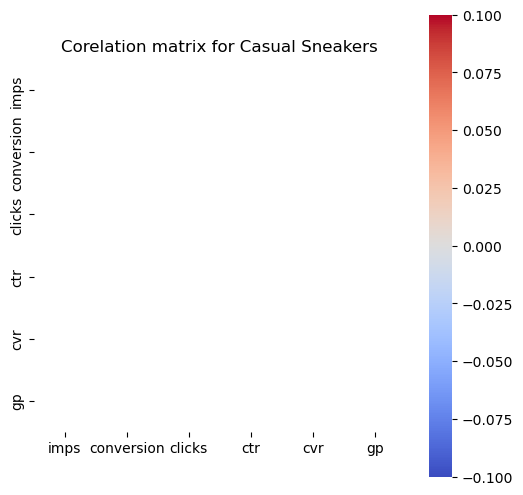

['shoes']


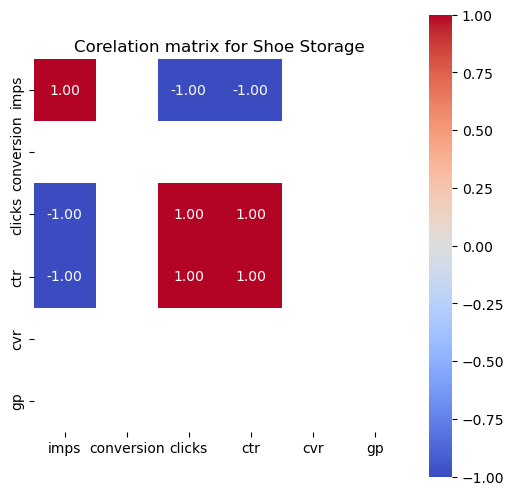

['shoe', 'all black dish rack']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



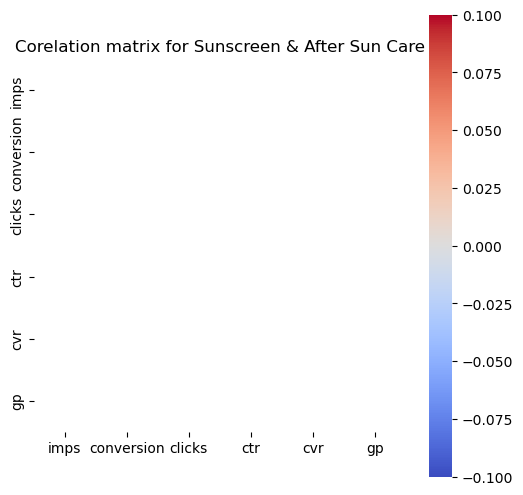

['shiseido']


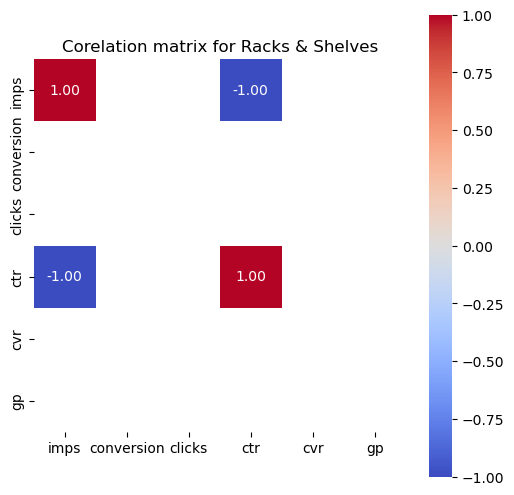

['shelving', 'garage door replacemen t']


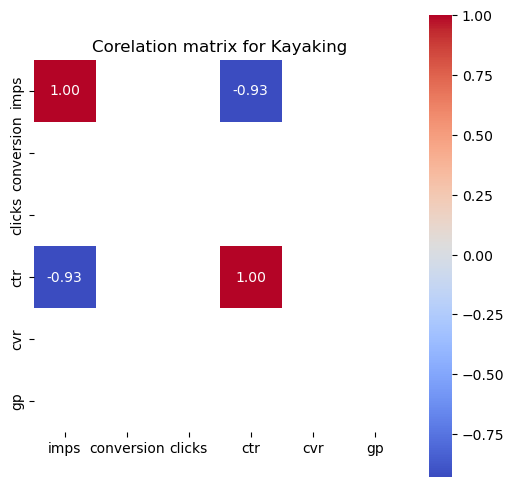

['silver springs manatee kayak', 'canoe', 'kayak verde', 'get up and']


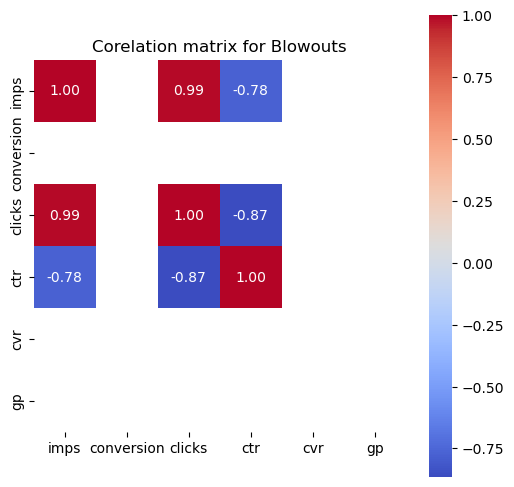

['shampoo and blowout', 'shag 86', 'deep condition and hair cut', 'blowout', 'blow outs', 'edan edan', 'haircut and blowout']


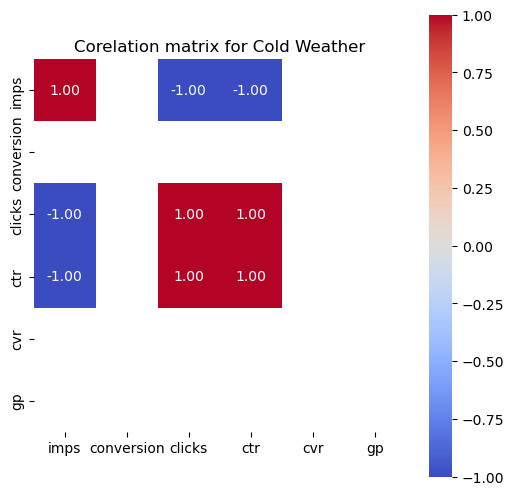

['snow boots', 'cold lasar']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



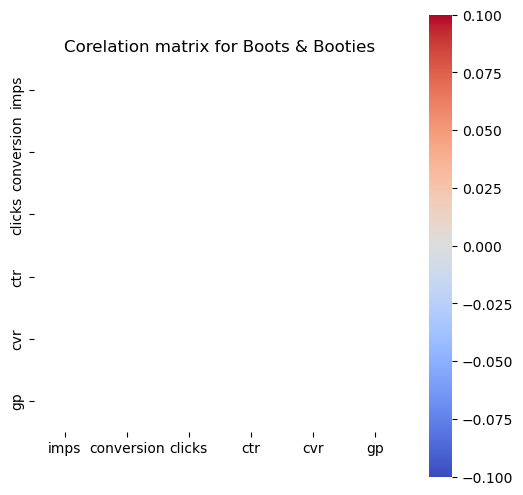

['snow']


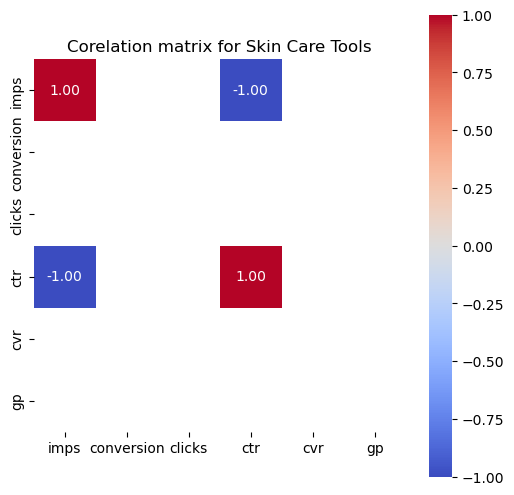

['skin care', 'blackhead']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



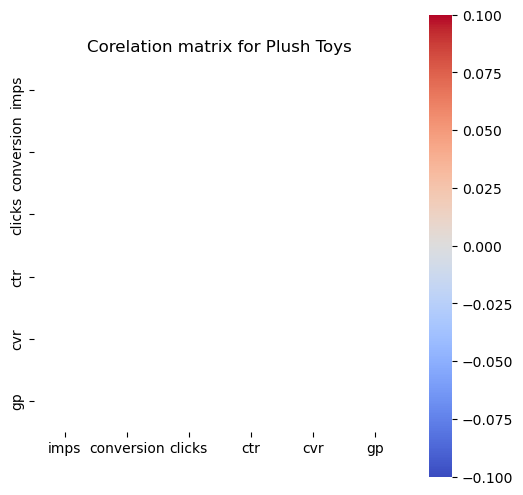

['chewy']


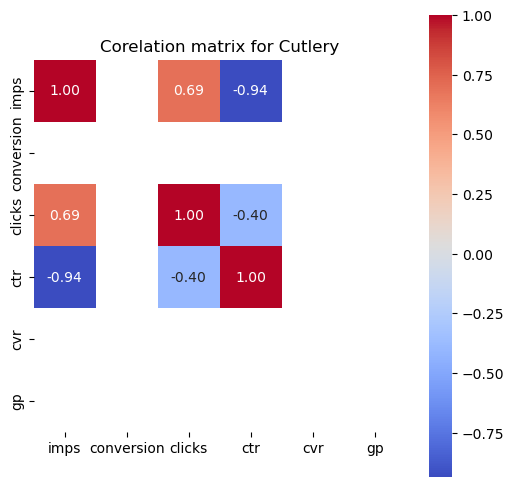

['chef', 'cutting board', 'kitchen knives']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



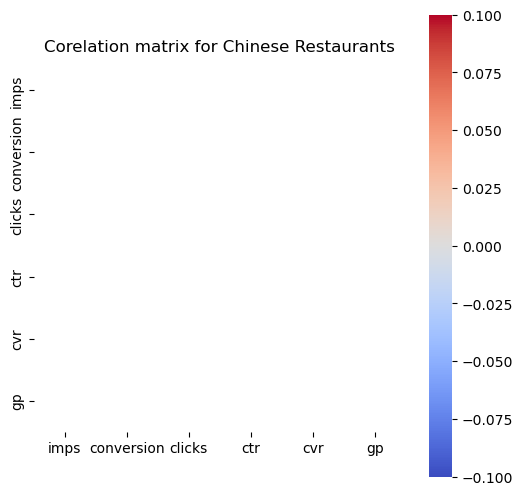

['chinese', 'hometown']


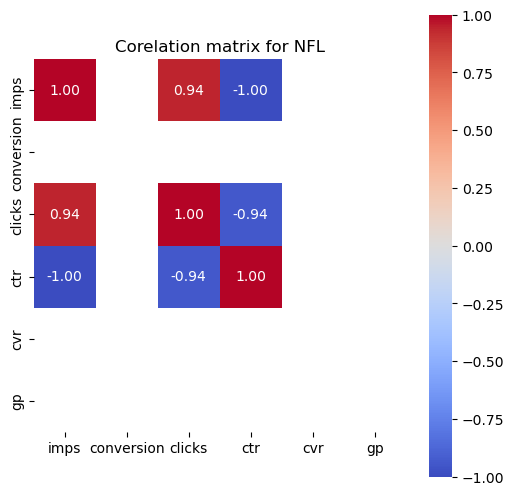

['chiefs', 'cooler', 'green bay packers']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



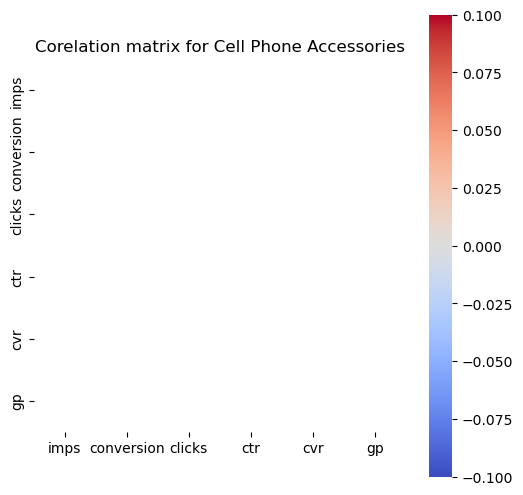

['cell phone sticker']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



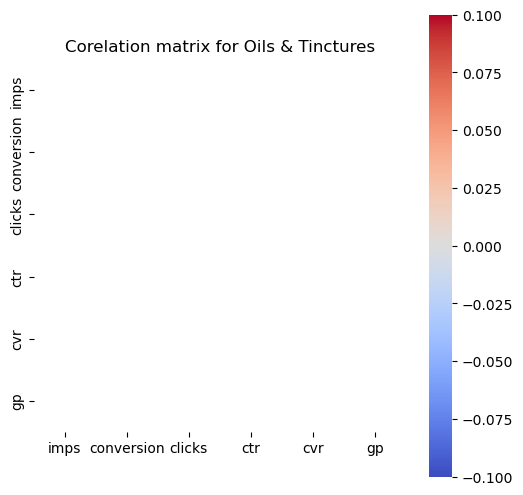

['cbd oil']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



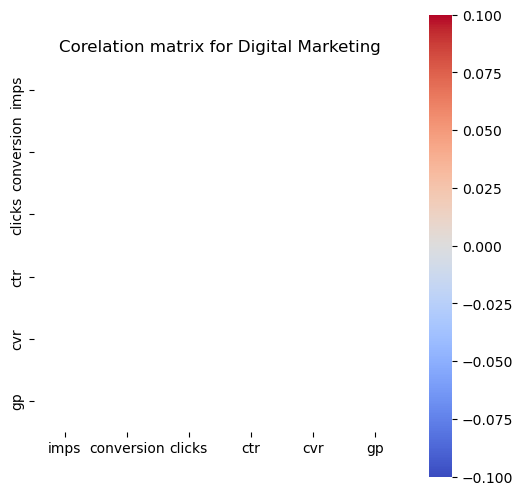

['certification']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



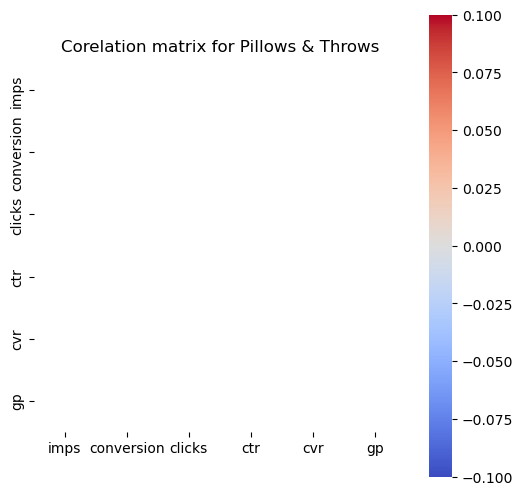

['cloud pillow']


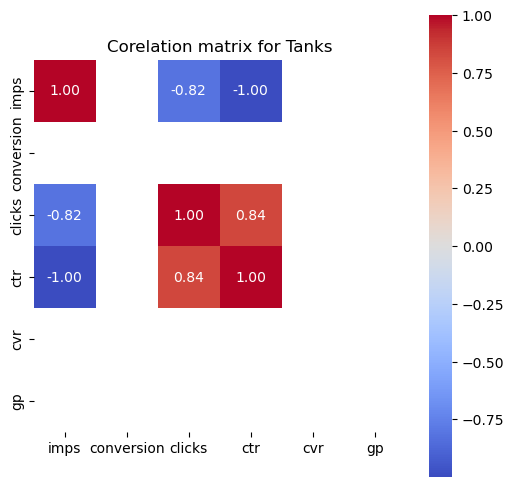

['royal gorge jeep tour', "clearance woman's tank tops", 'beard', 'jersey']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



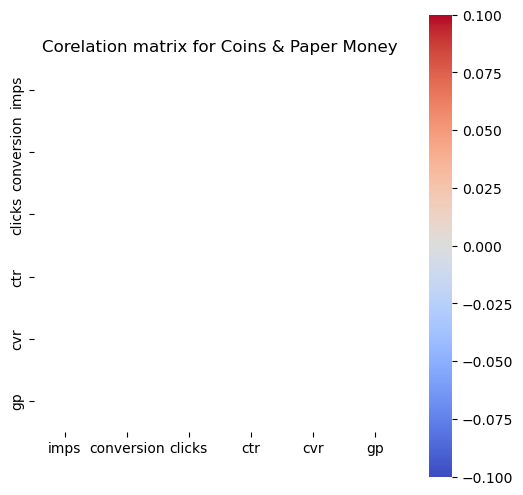

['coins']


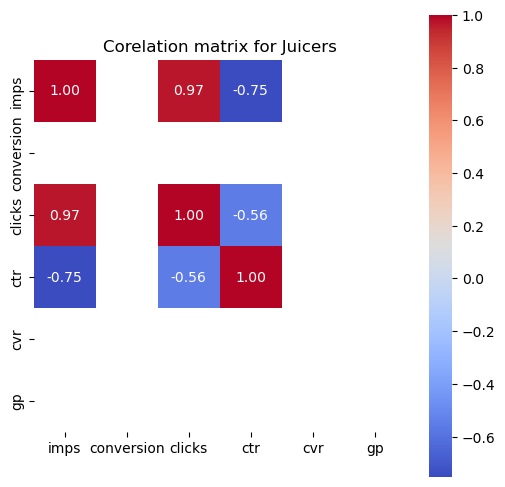

['cold juice press machine', 'blenders and juicers', 'juicer']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



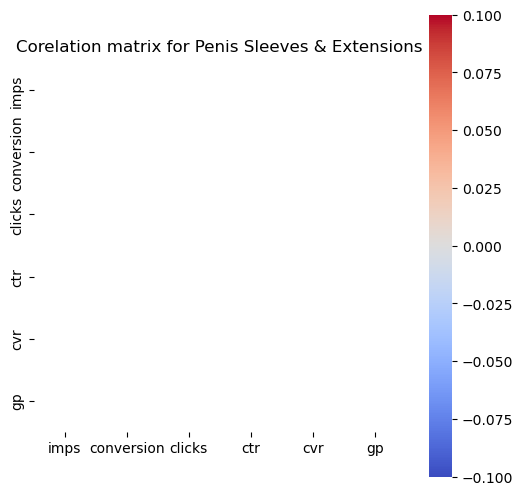

['cock ring']


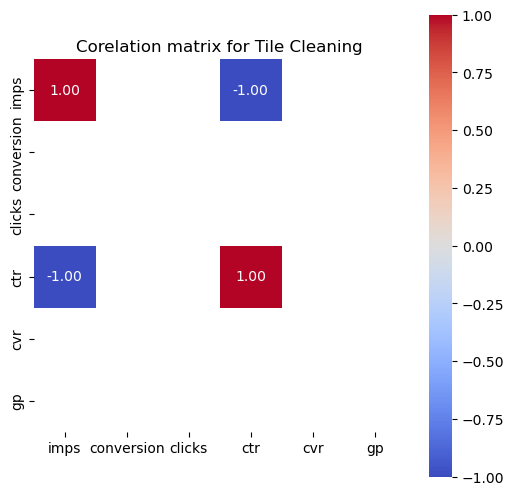

['clean floors', 'carpet cleaning inglewood']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



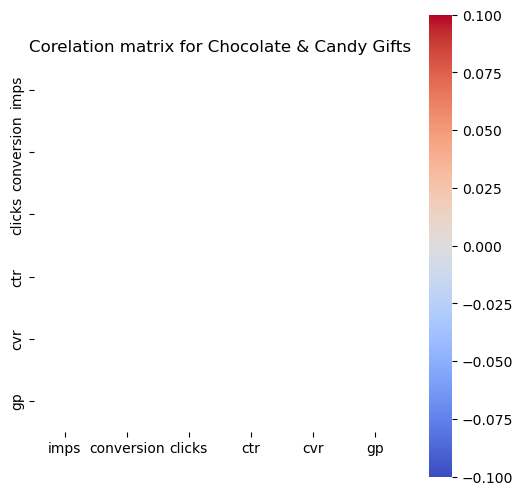

['chocolate']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



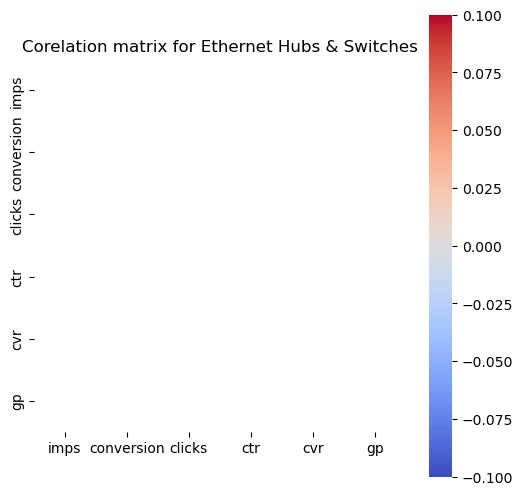

['chromebook']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



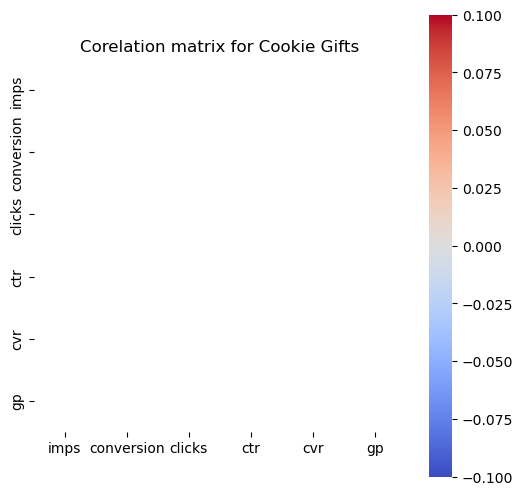

['cake']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



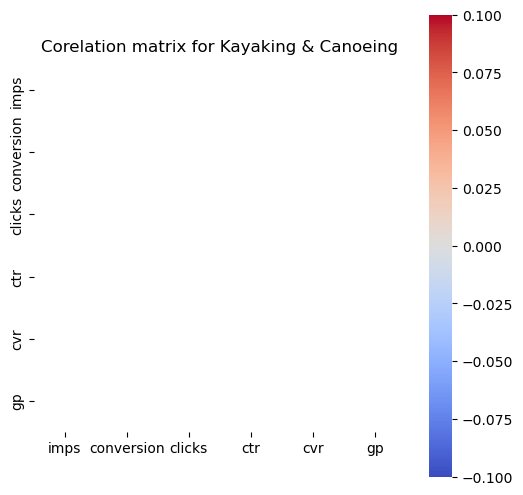

['canoe']


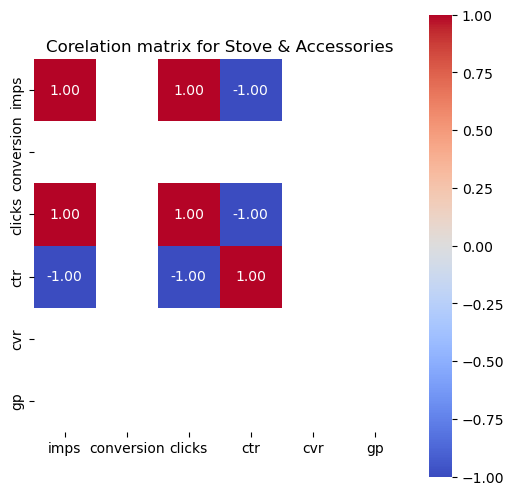

['camping', 'bbq']


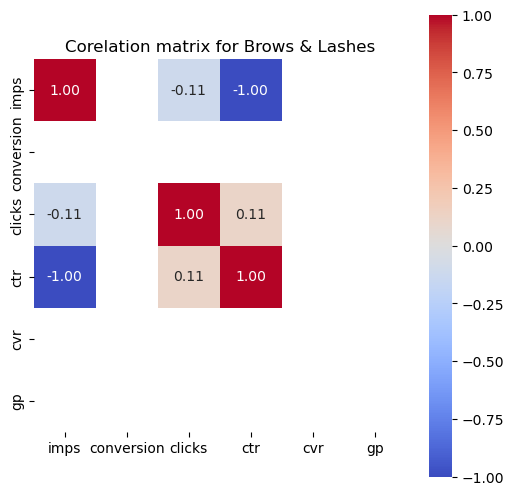

['brow tint and lamination', 'brow shaping', 'eye extensions']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



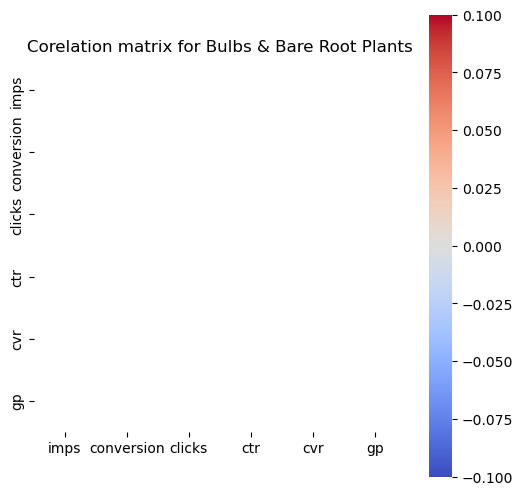

['bulbs']


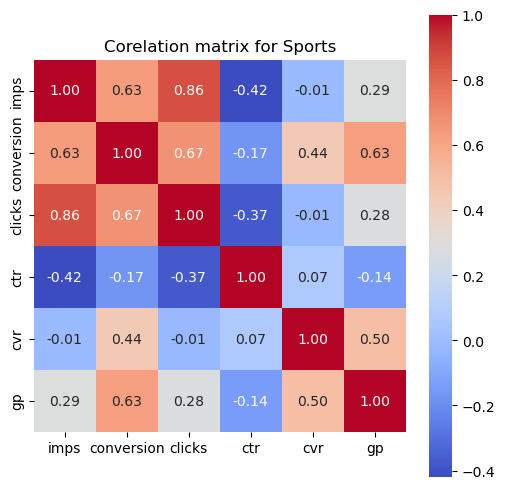

['bury the hatchet horsham', 'stock show', 'urban air', 'jet ski', 'area 53', 'stretch massage', 'big air', 'paintball', 'regen medical', 'zipline', 'archery', 'kayak', 'ghosttown zipline', 'pontoon boat rental', 'jayell ranch', 'swan eola', 'paddleboard', 'paint ball', 'play', 'pontoon', 'private sail', 'private captained boat tour', 'pro rodeo tickets', 'pbr', 'paris massage', 'parasailing tour xtreme', 'parasailing', 'parks', 'natural bridge caverns', 'miami watersports', 'long island canoe kayak rentals', 'lone star axe', 'linq zipline', 'lihue', 'mantas', 'manta ray', 'manta', 'lounge bar', 'natural bridge', 'national western stock show', 'oaks park', 'oahu', 'night snorkling', 'night', 'museum of ancient life', 'treetop trekking miami', 'tanks paintball', 'sunset tour', 'swimming with manatee', 'swim with manatees', 'surf', 'swan boats', 'surfing lessons', 'surfing', 'surf lesson', 'things for men', 'things to do as a couple', 'the edge', 'white water rafting', 'weston ski track'

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



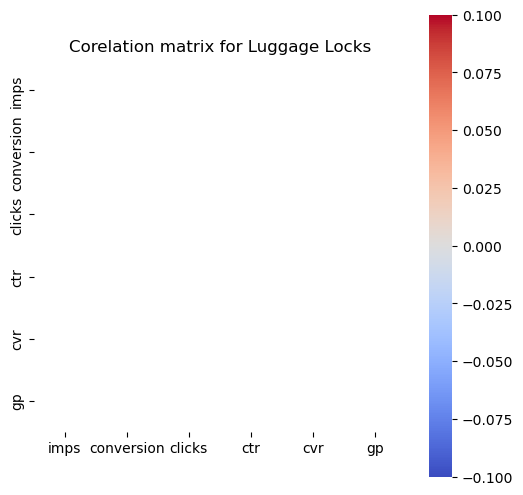

['carryon luggage']


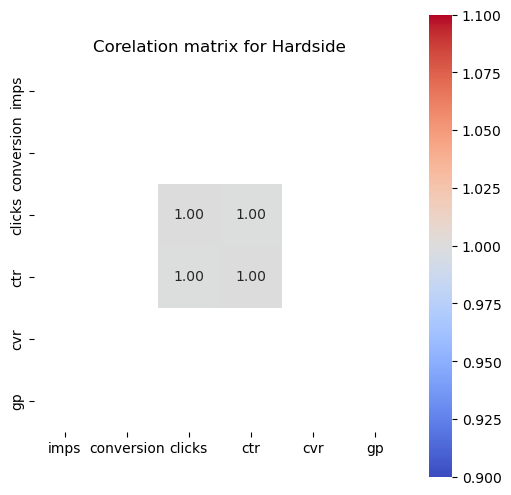

['carry on', 'international travel']


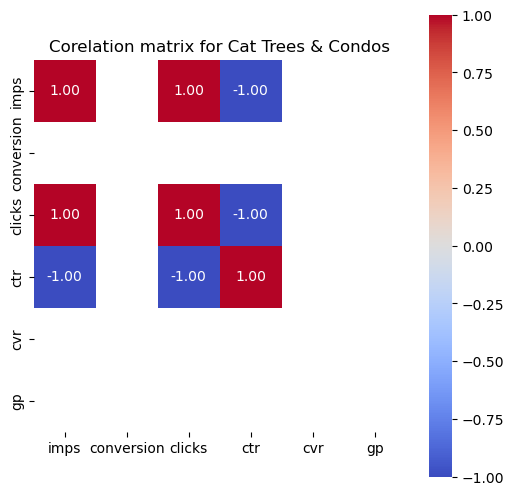

['cat', 'cat tree']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



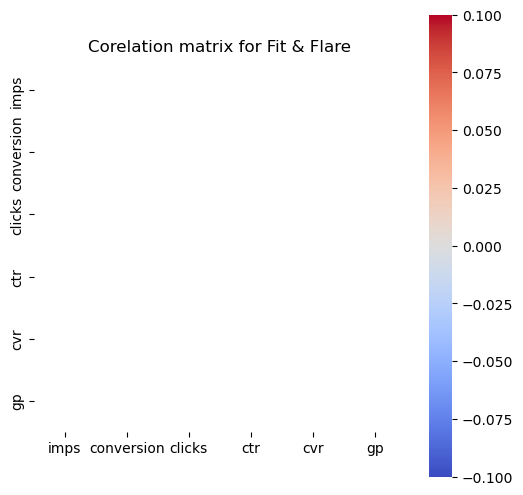

['casual dress']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



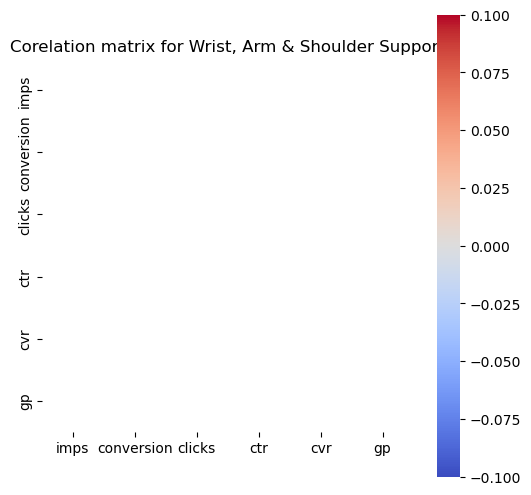

['castro oil wraps']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



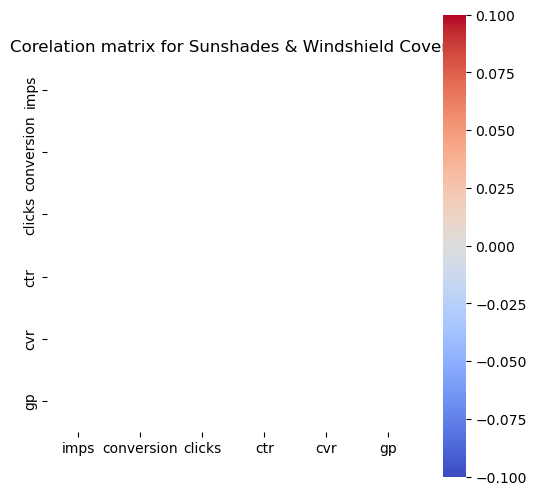

['car windows covers']


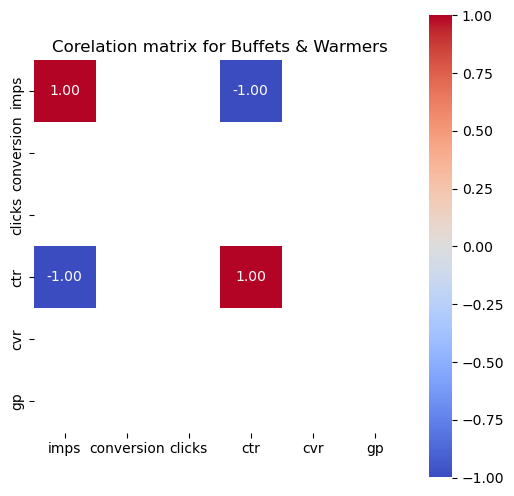

['daisho', 'cup stainless']


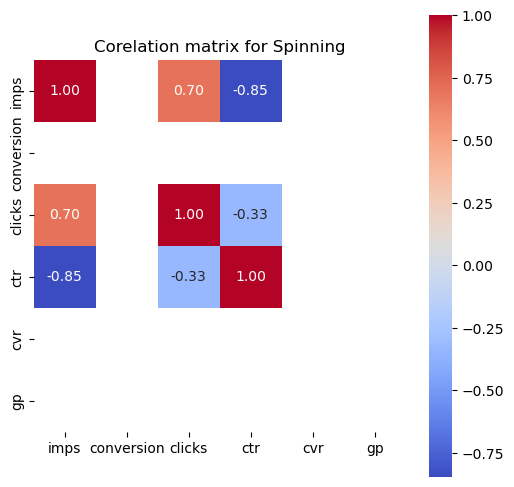

['cycling class', 'cycling', 'cycle', 'indoor cycling']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



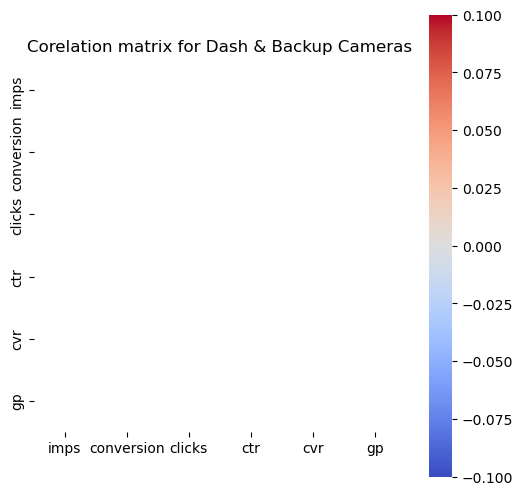

['dash cam']


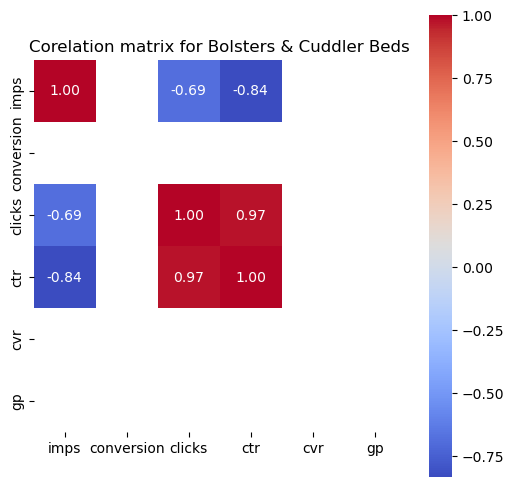

['dog nail trim', 'dog bed', 'anti anxiety beds for dogs', 'donuts']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



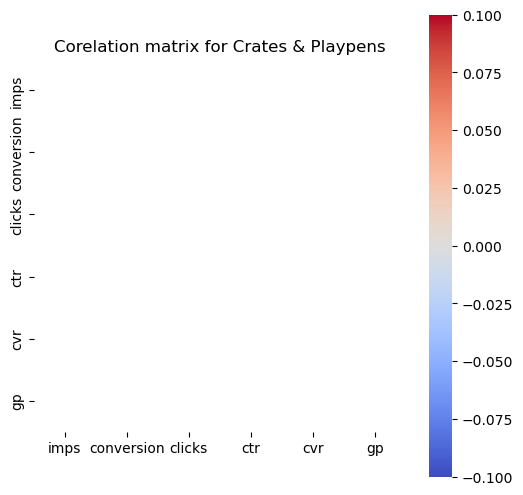

['dog fence']


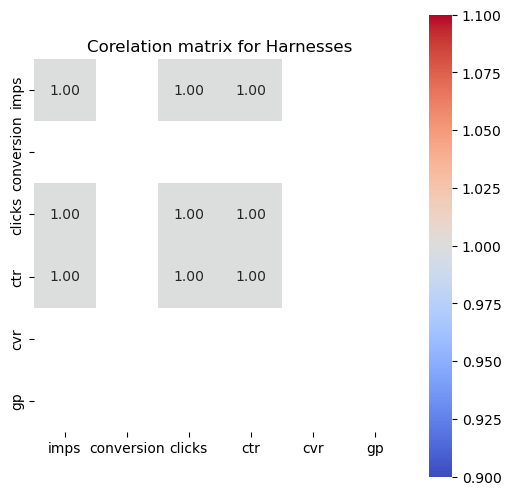

['dog coller', 'dog']


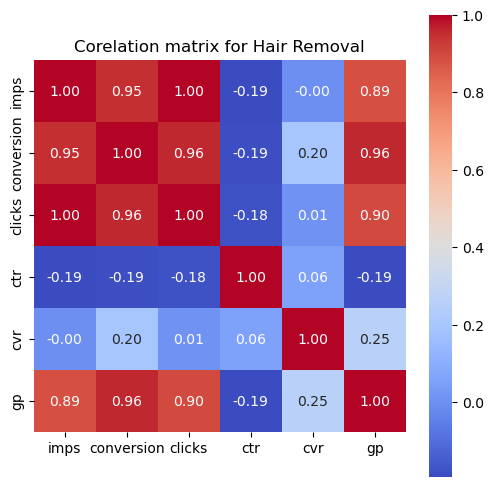

['laser hair removal', 'laser', 'laser hair-removal', 'lazer hair removal', 'sev laser', 'sev', 'yag laser', 'proskin', 'montclair rejuvenation', 'full body laser', 'laser hair', 'simplicity laser', 'laser hair removwl', 'hair laser', 'full leg laser', 'laser hair remobal', 'sec laser calabasas', 'painless lazer', 'prolase', 'precise medical', 'permanent laser hair removal', 'lser hair removal', 'love you laser', 'lotus health', 'luz lounge', 'láser', 'top aesthetics unlimited', 'top aesthetic laser', 'underarm hair removal', 'unlimited laser hair', 'unlimited laser hair removsl', 'unlimited', 'unique laser', 'tribella laser', 'turlock, ca', 'sun and shade spa oa', 'sedo', 'rejuv', 'removal remove red blood vessels: all kinds of telangiectasia, cherry hemangioma and more.', 'spa 7', 'spider vein removal', 'simplicity', 'sev calabasas', 'semper', 'skyn', 'skinstation laser', 'skinny spa', 'skin bleaching and laser hair removal', 'skin city lab', 'skinlicious', 'skinagency', 'candela', '

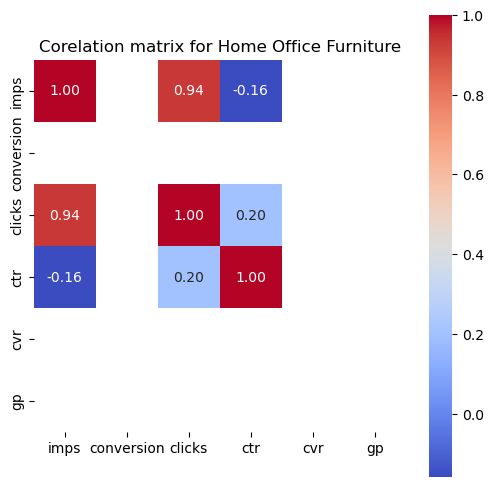

['desk', 'gaming table', 'furniture']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



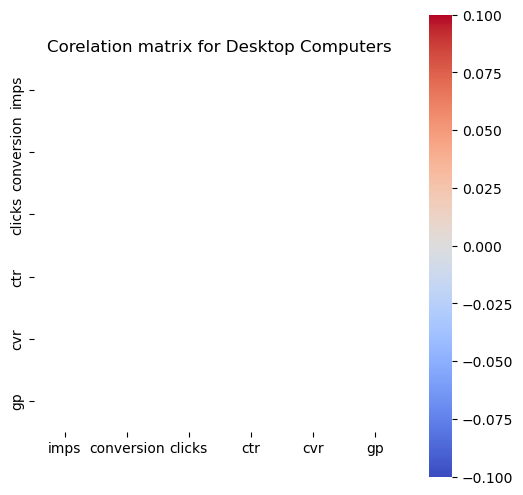

['desktop computer', 'desktop']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



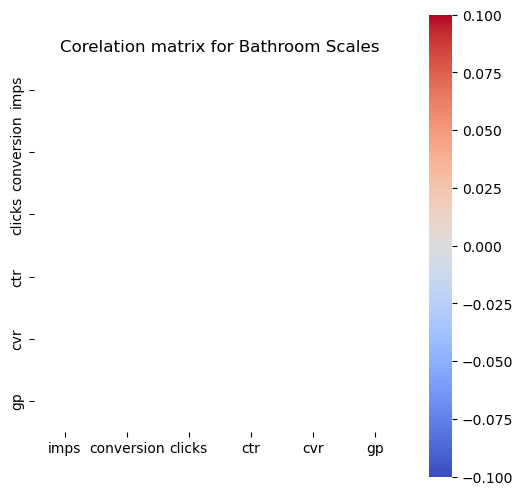

['diabetes']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



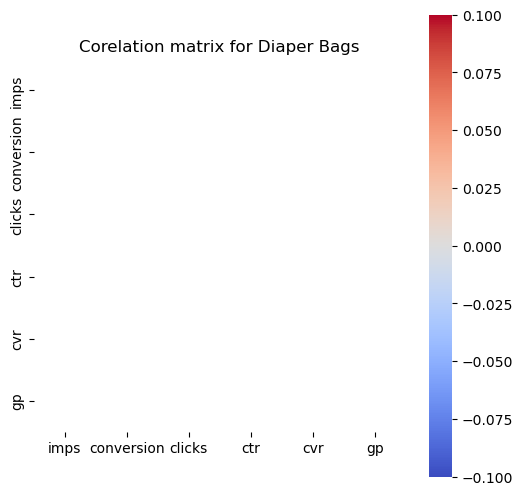

['diaper bags']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



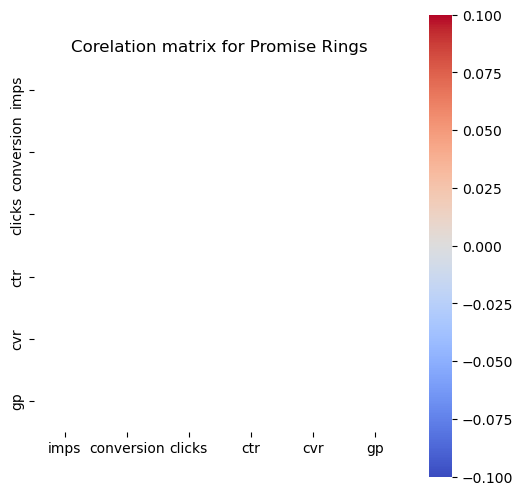

['diamond ring']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



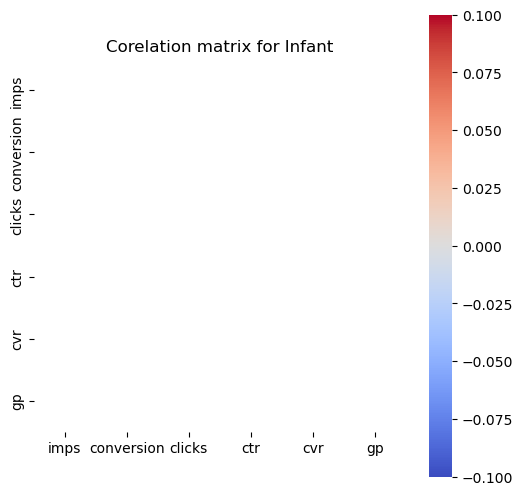

['convertible carseat']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



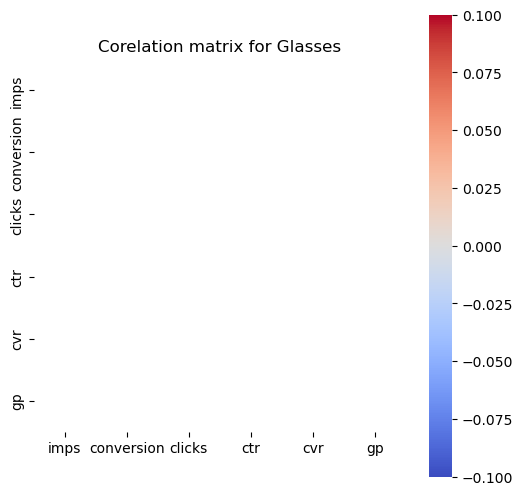

['contacts exam']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



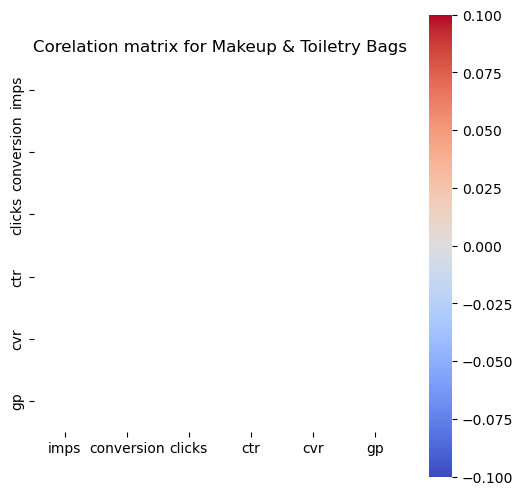

['cosmetic surgery']


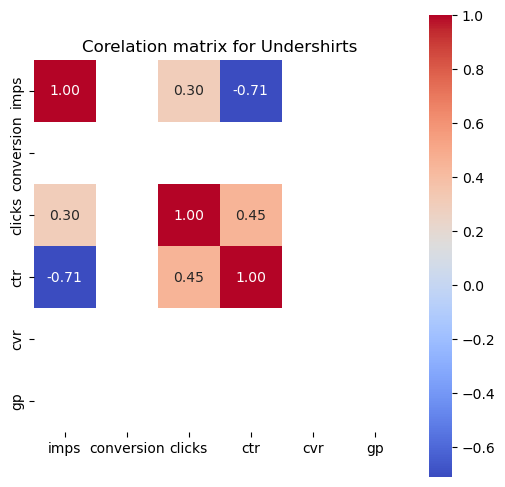

['mens themal pants', 'compression tank', 'compression shirt', 'body compression']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



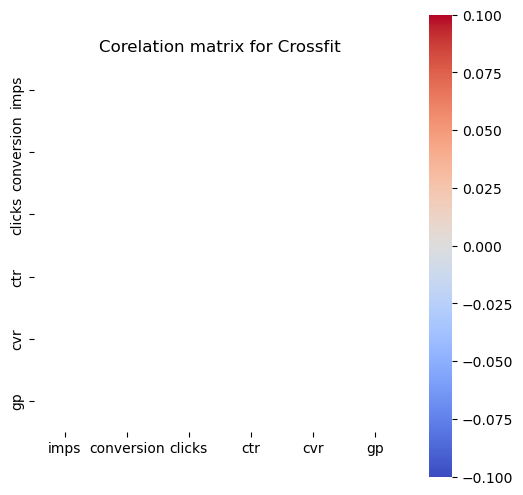

['crossfit']


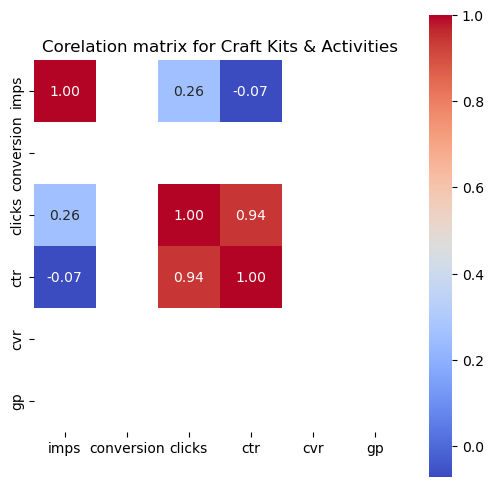

['crochet', 'adult beginner gymnastics', 'epoxy']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



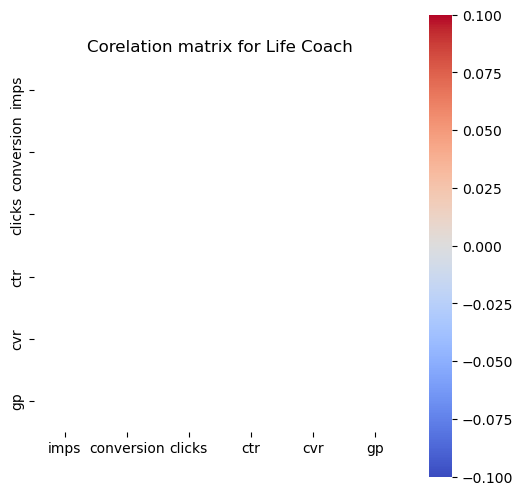

['croach']


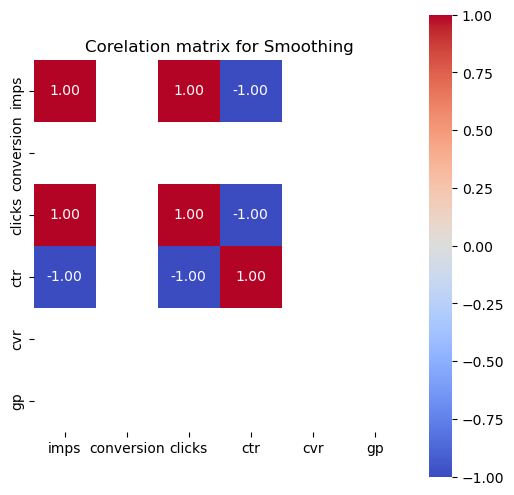

['crew fiber', 'hair dryers']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



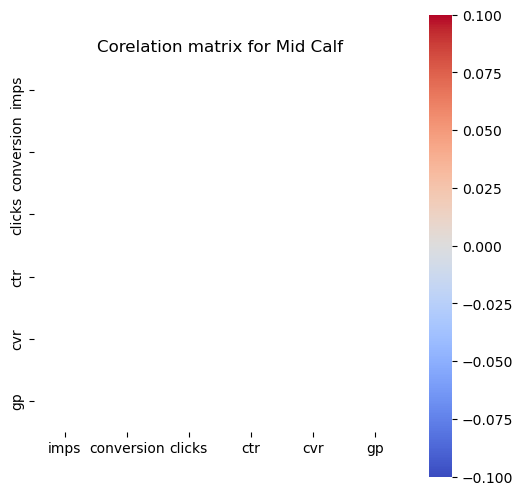

['cowboy boots']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



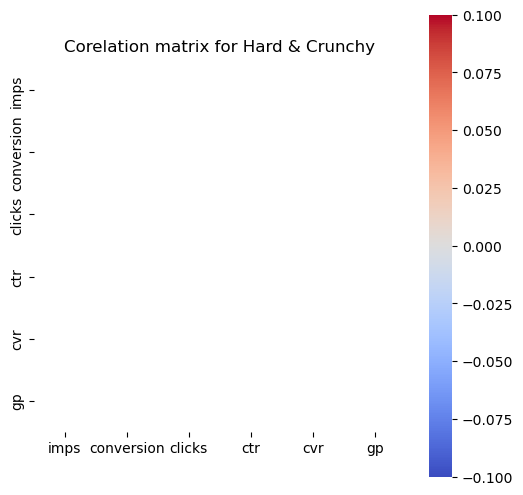

['cow ears']


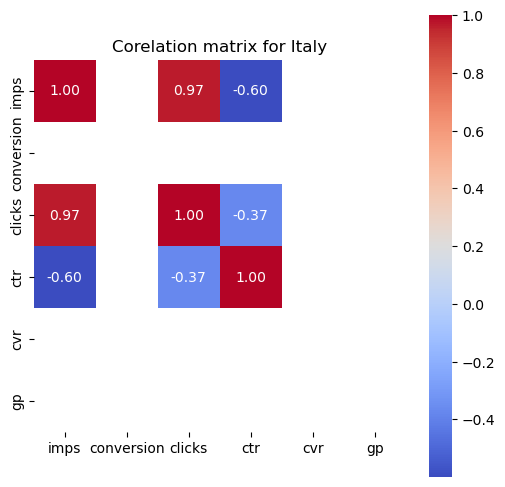

['crystal mountain michigan', 'atlanta getaway', 'ireland and italy vacations', 'italy', 'italy trip', 'italy 7 day travel', 'florence italy']


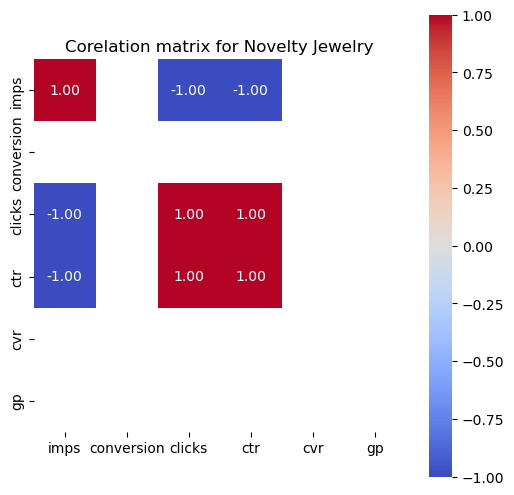

['anklet', 'jewlry']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



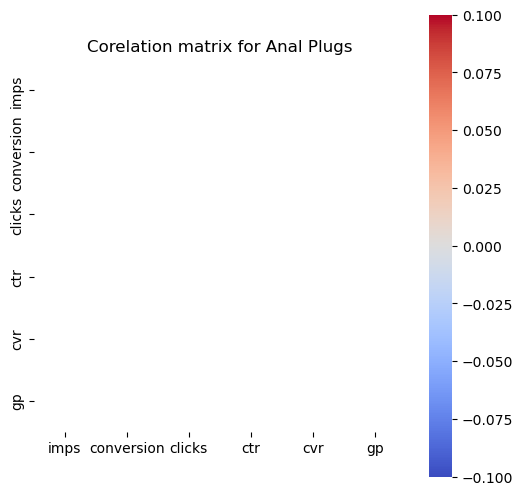

['anal']


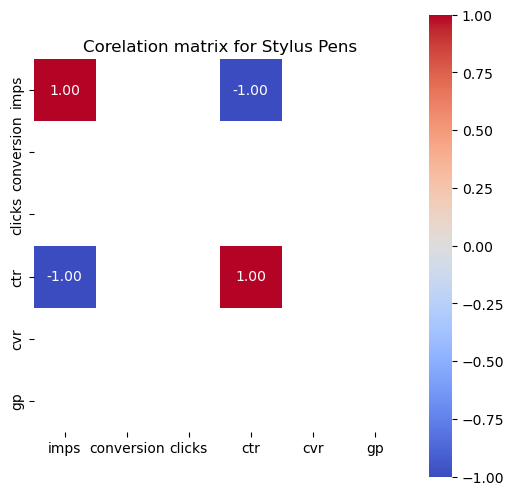

['apple pen', 'air bnb']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



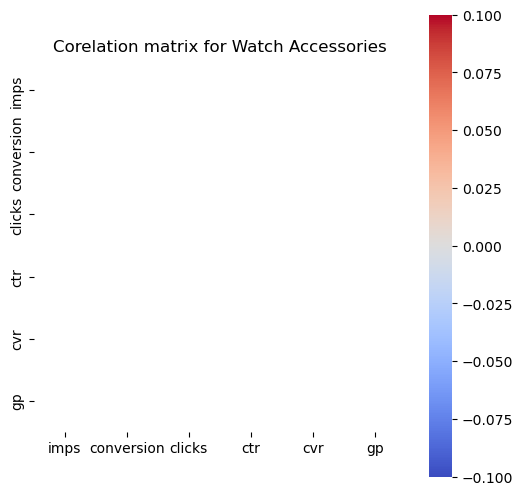

['apple watch screen protectors']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



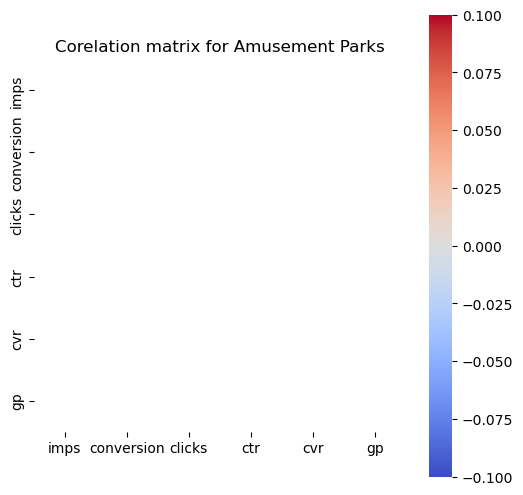

['alpine coaster']


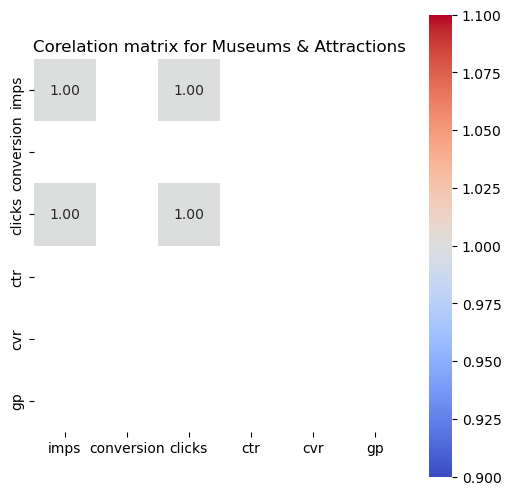

['atlanta zoo', 'activities for kids', 'baltimore science museum', 'faris wheel atlanta']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



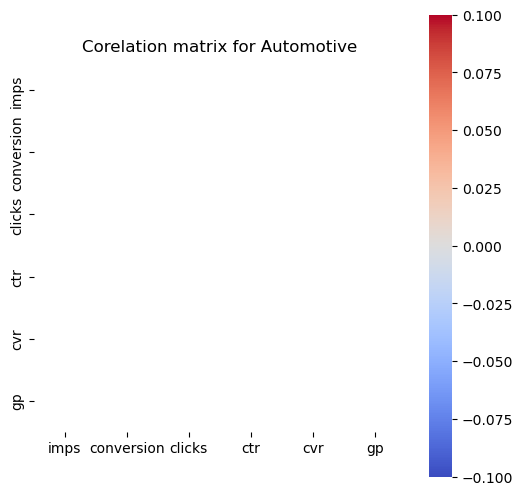

['automotive window tinting']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



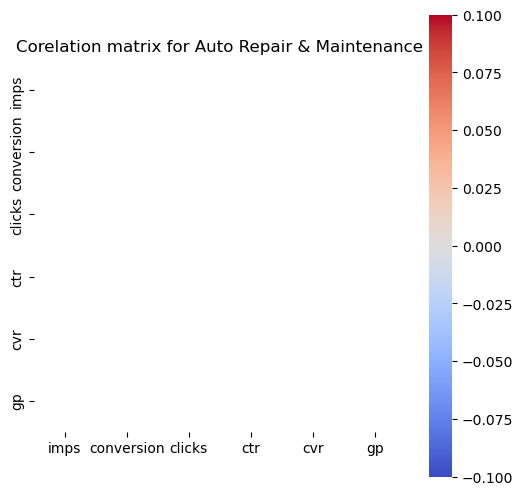

['auto wraps']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



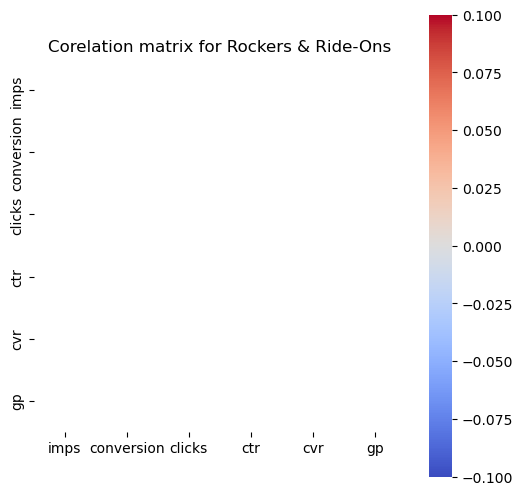

['atv tours']


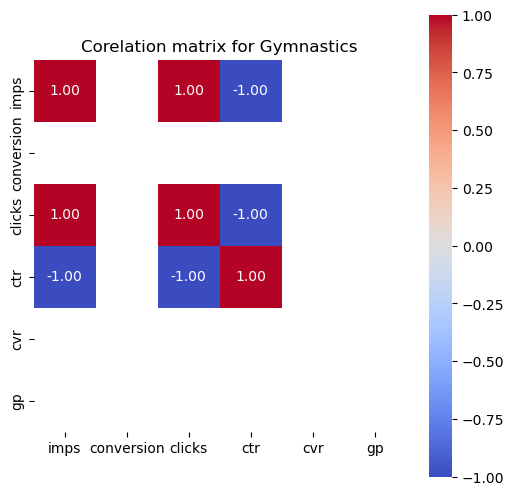

['asi', 'kid gymnastics', 'kds', 'gymnastics']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



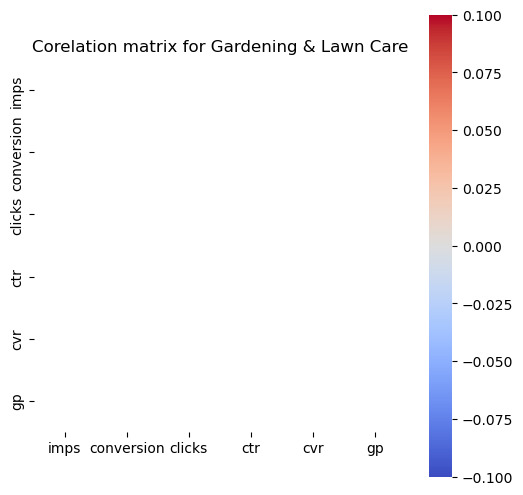

['artificial']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



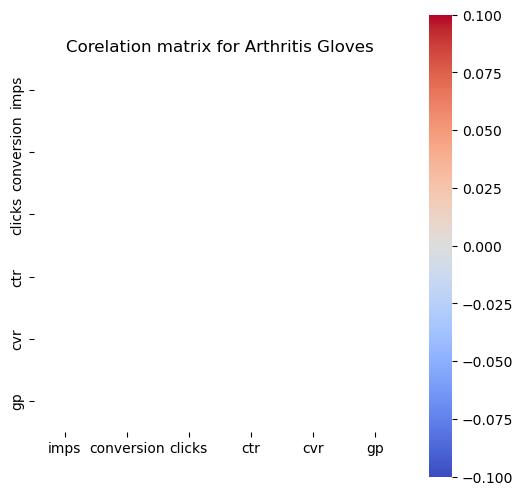

['arthritis gloves']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



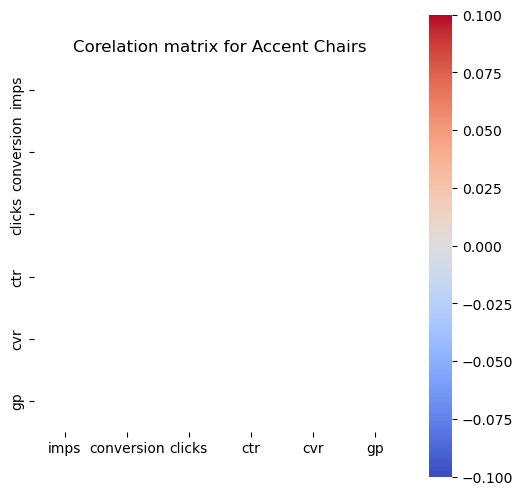

['accent chair']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



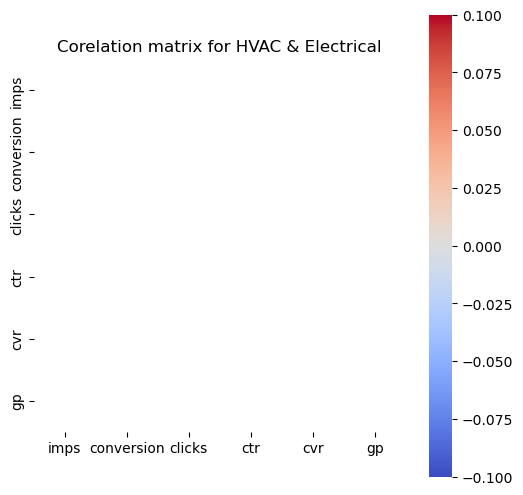

['ac service']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



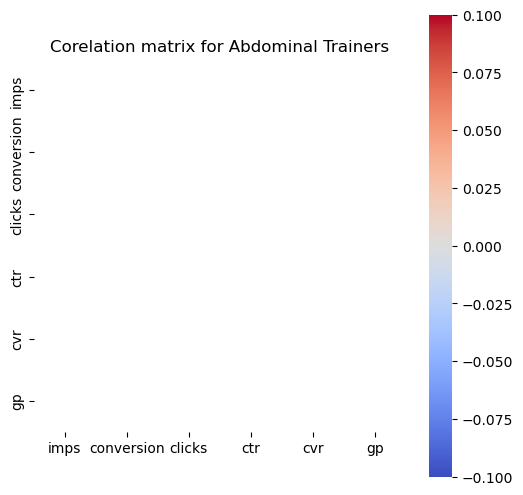

['abdominal stimulator']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



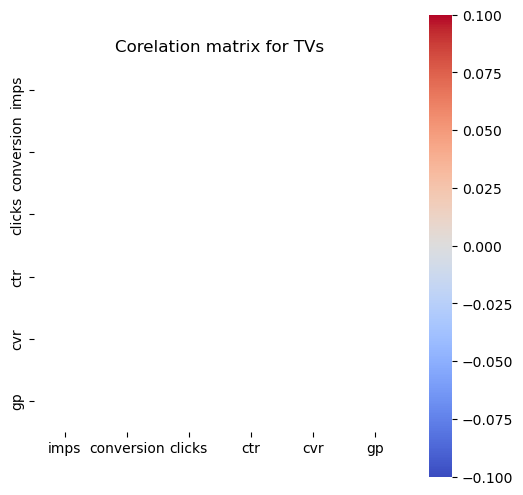

['43" smart tv']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



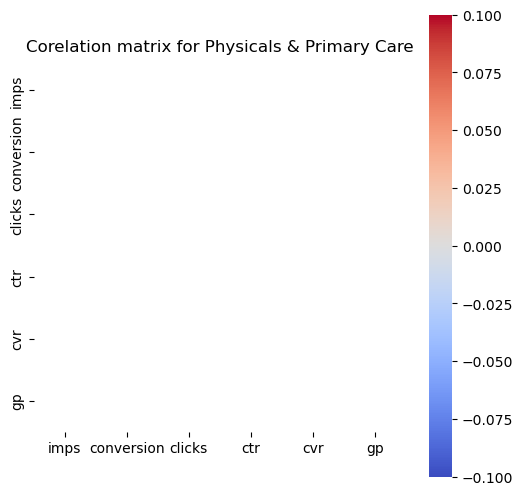

['23andme']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



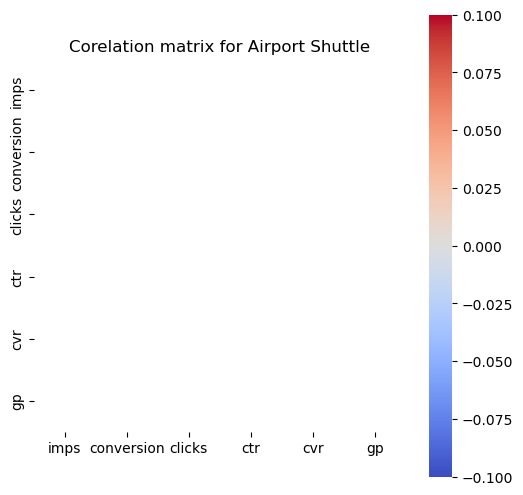

['airport shuttle']


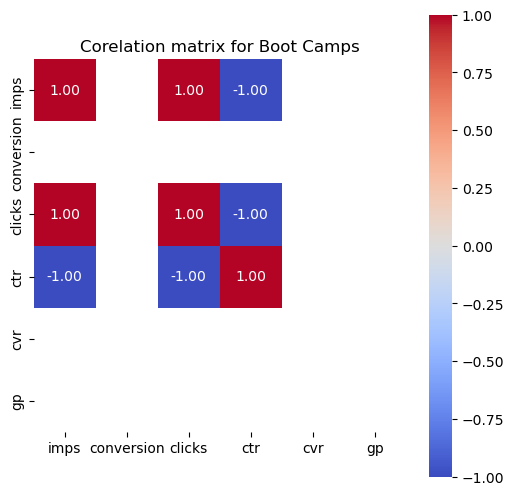

['aerial fitness', 'bootcamp']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



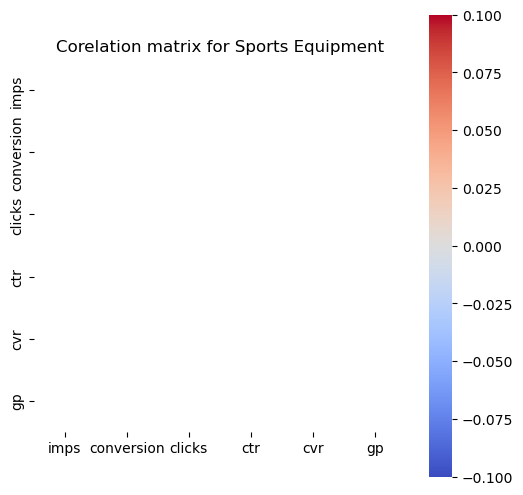

['advanced open water scuba']


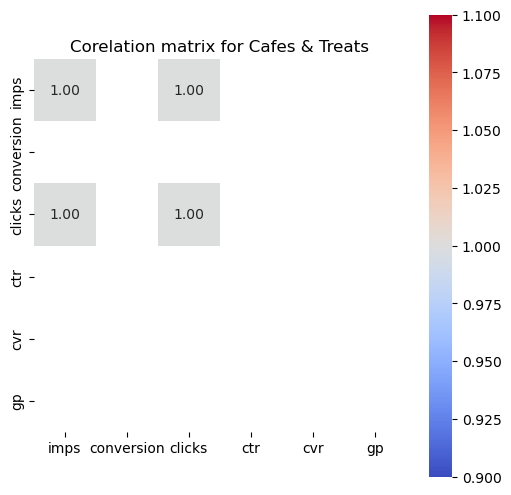

['boba tea', 'fruity ice treats']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



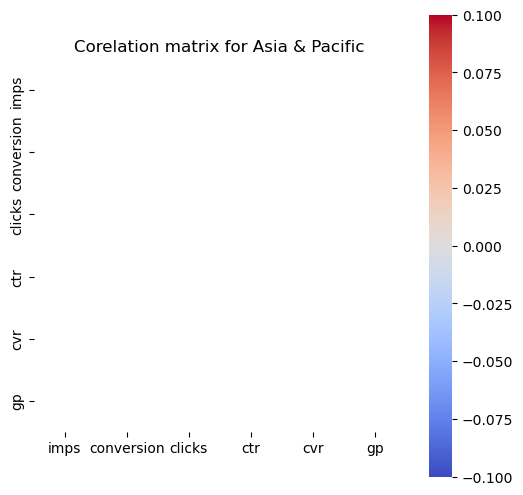

['bora bora']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



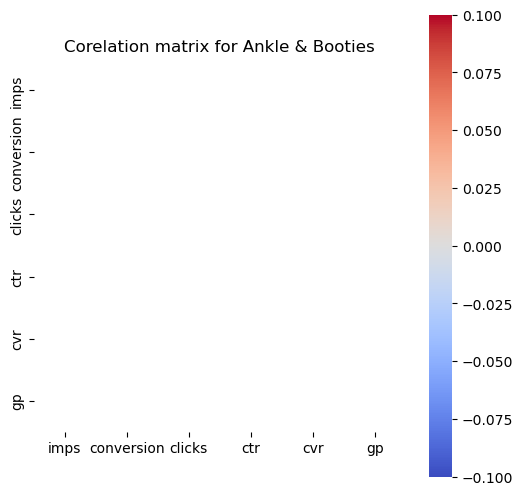

['boots']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



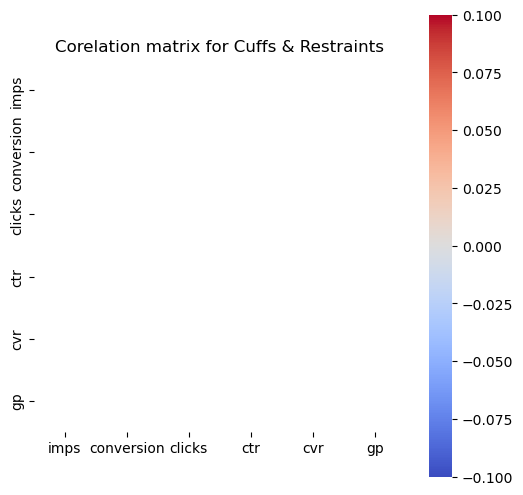

['bondage kit']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



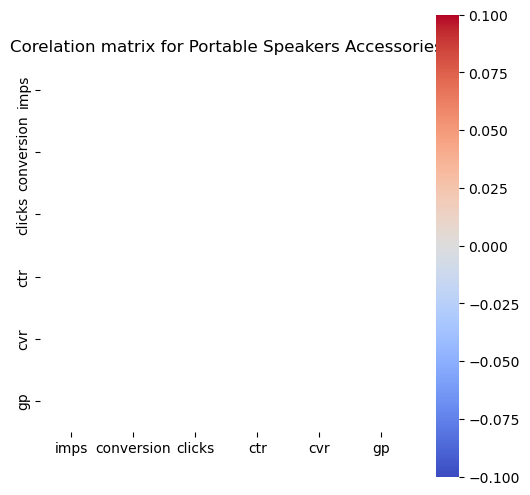

['blank cds']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



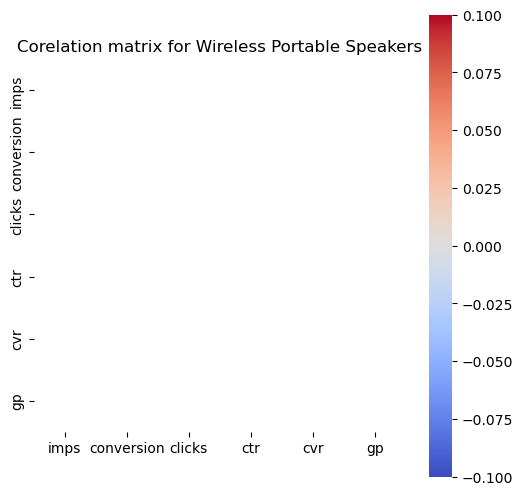

['bluetooth speaker']


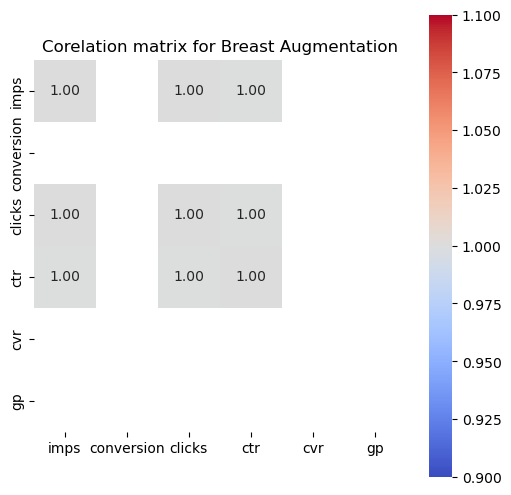

['breast augmentation', 'breast reduction', 'gynecomastia']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



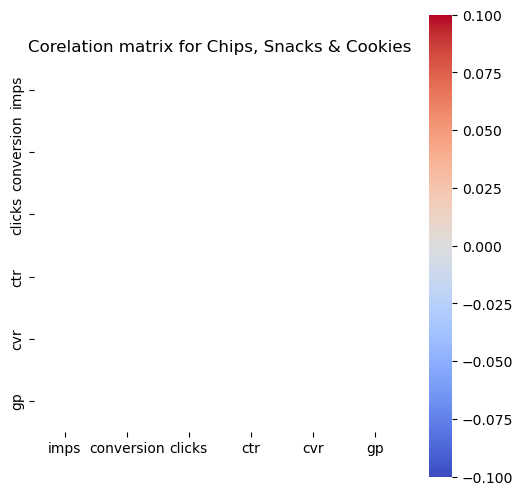

['bread stores']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



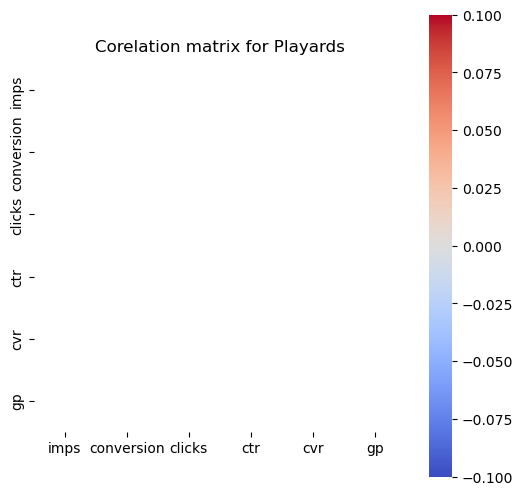

['bounce n play']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



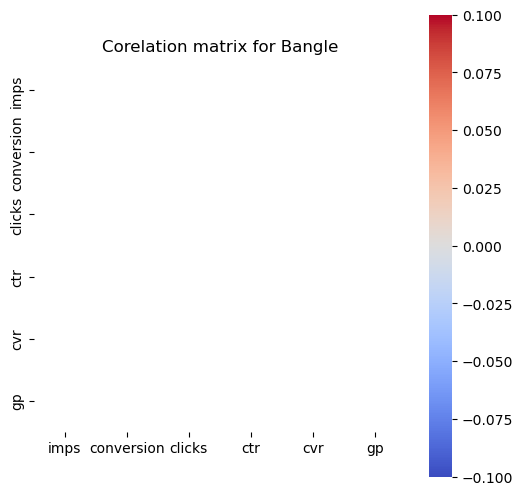

['bandles']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



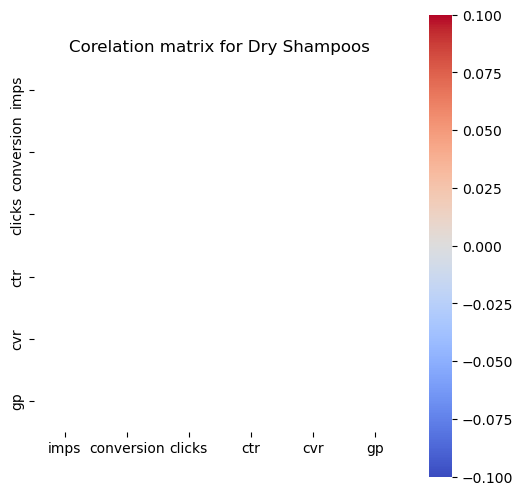

['batiste']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



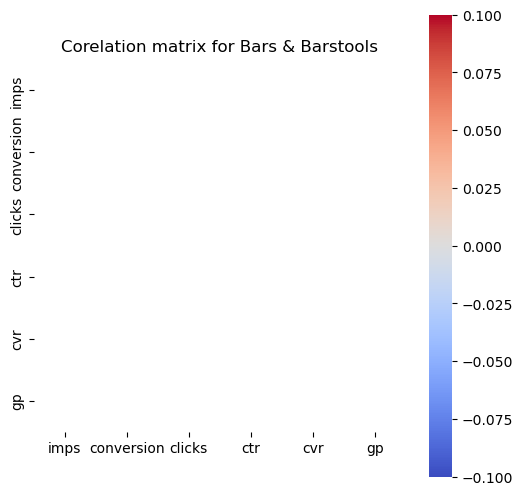

['bar stool']


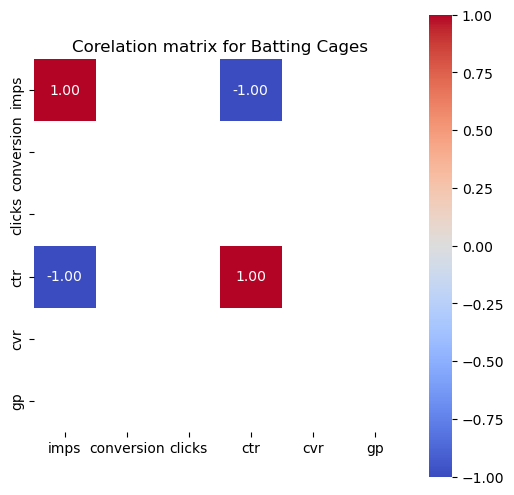

['batting cage', 'batting cages']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



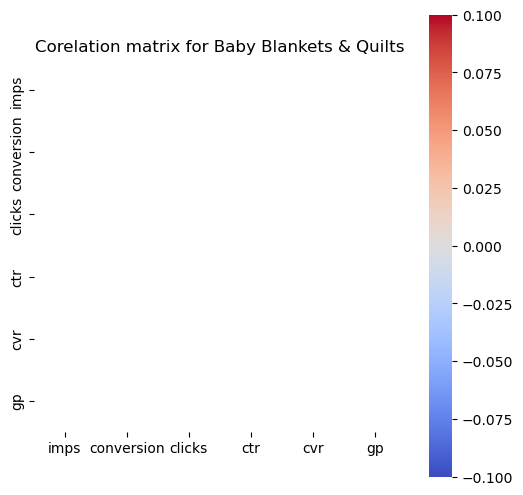

['baby teethers']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



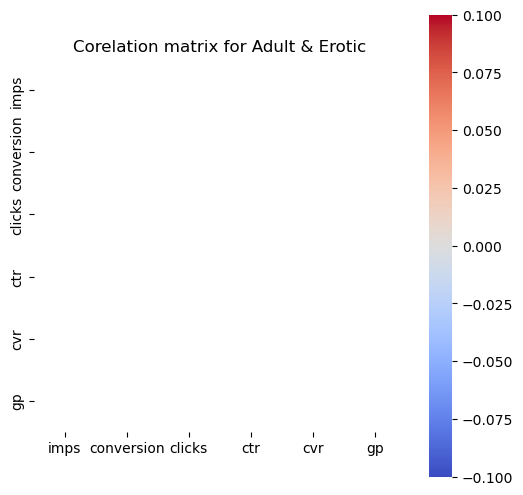

['bigotires']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



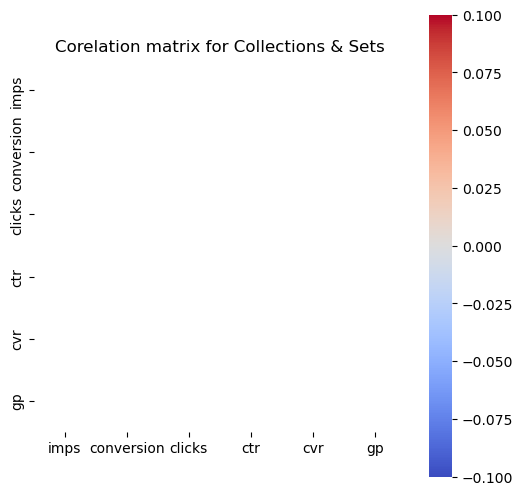

['black diamond earrings']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



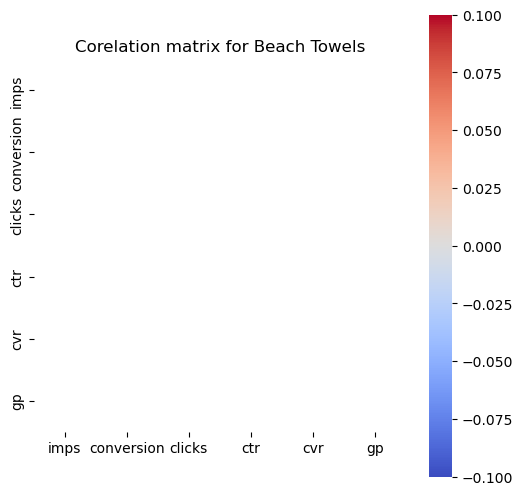

['bj club']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



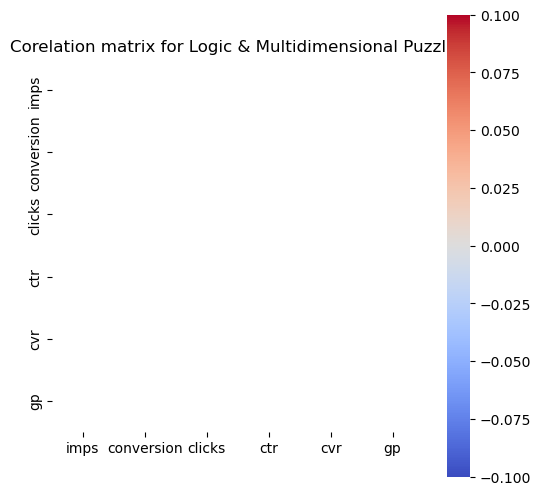

['big heads', 'house of flowers book nook kit']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



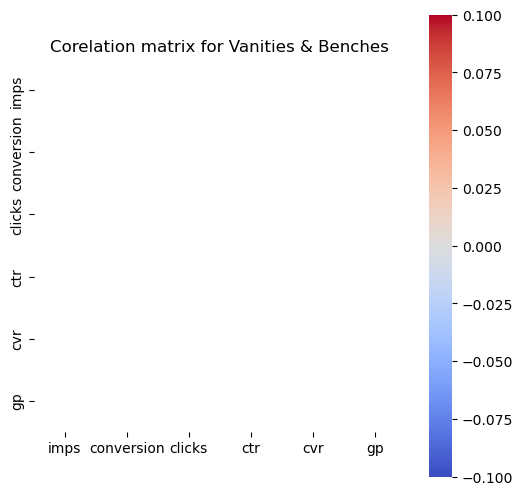

['bedroom furniture']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



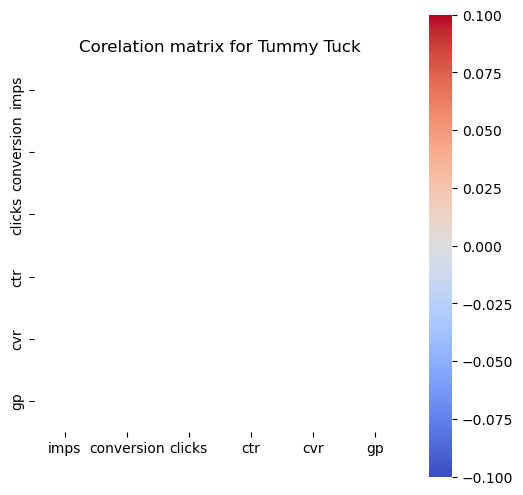

['beverly hills instittute of plastic surgery']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



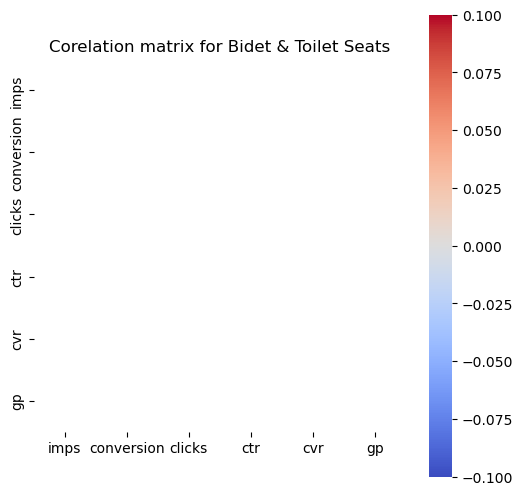

['bidet']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



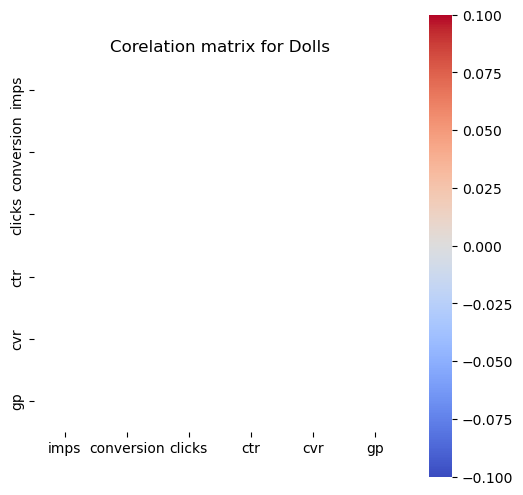

['doll']


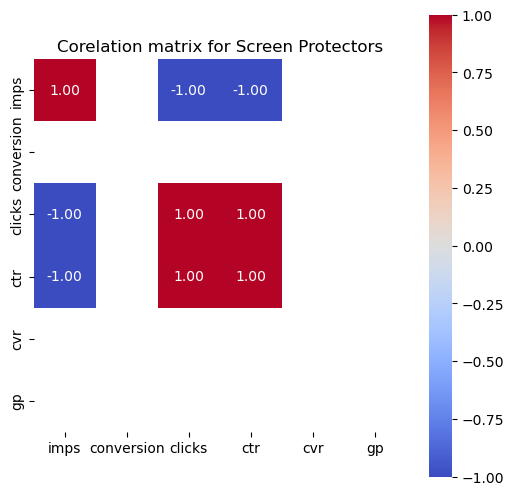

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



['ihones', 'iphone 15 screen protector']


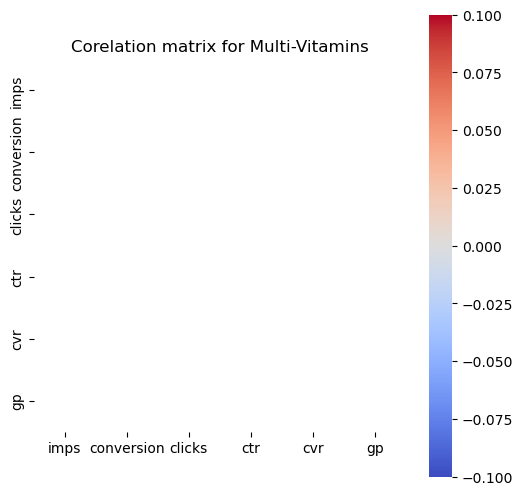

['iron vitamin']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



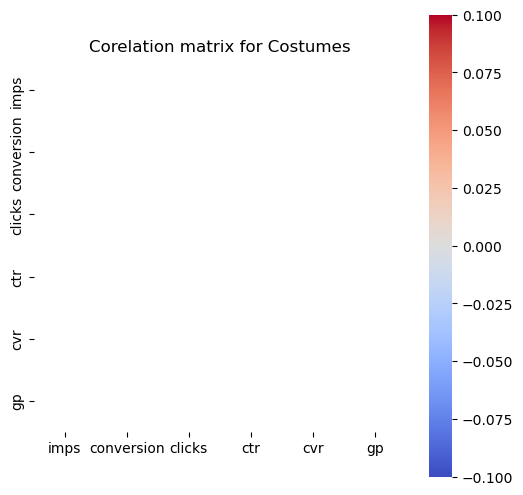

['inflatable dog costume']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



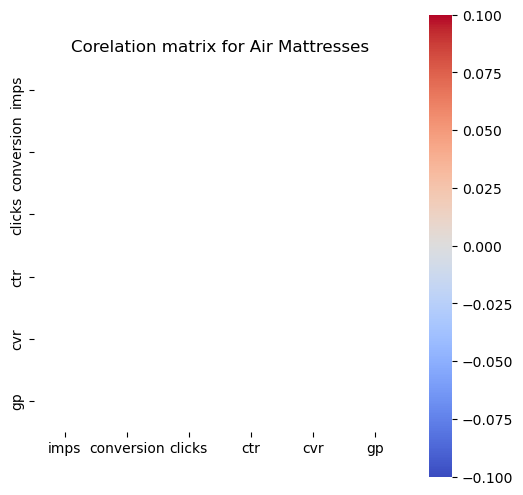

['inflatable costume']


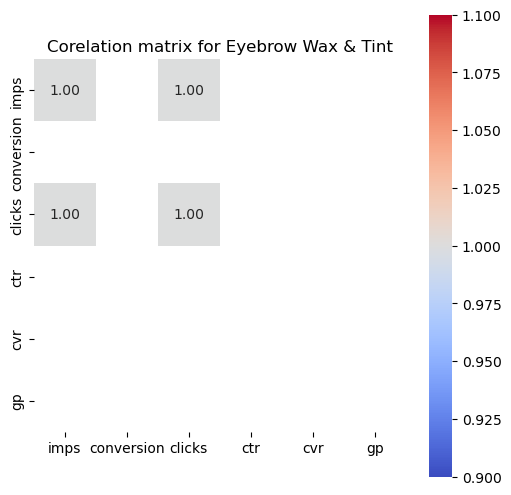

['henna brows', 'lash lamination', 'eyebrow and tints', 'eyebrow shape']


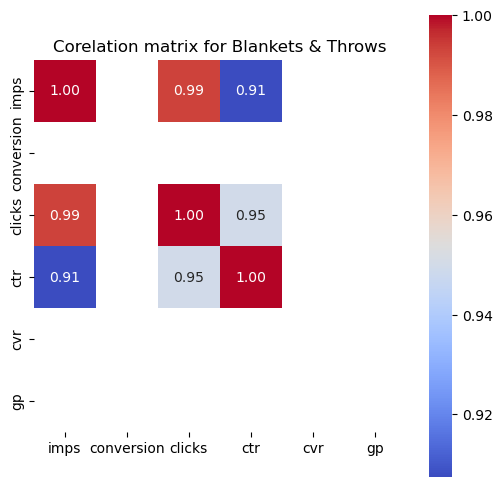

['heating blanket', 'heated blanket', 'electric blanket']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



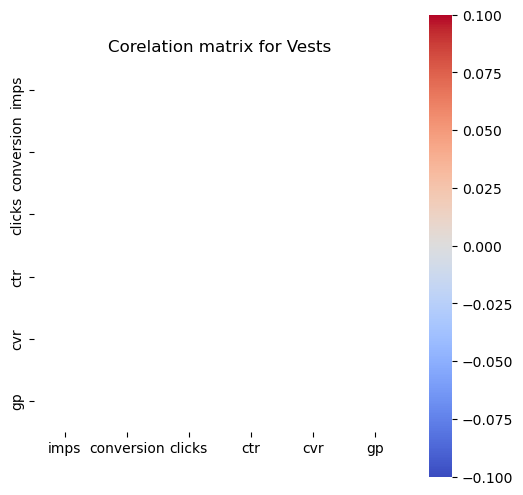

['heated vest']


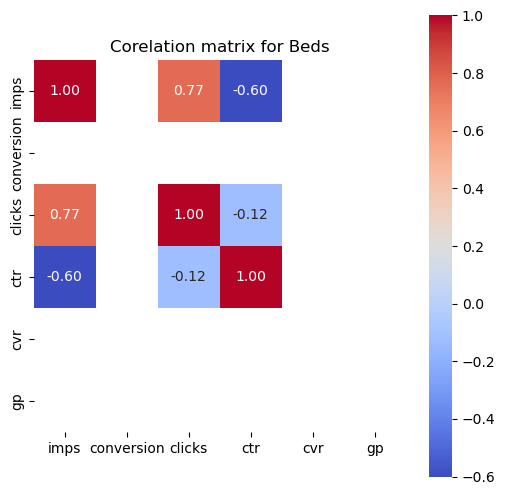

['orthopaedic outdoor dog bed', 'pet', 'warm', 'puppy', 'southwest airline', 'dog nail trim', 'dog beds', 'dog bed', 'anti anxiety beds for dogs', 'homary furniture', 'jumbo dog bed', 'donuts', 'furhaven']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



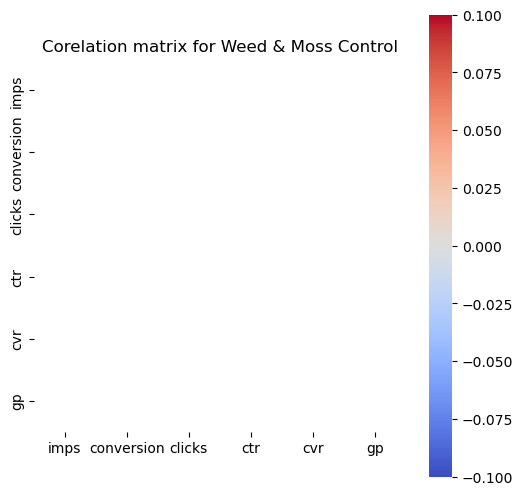

['landscaping']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



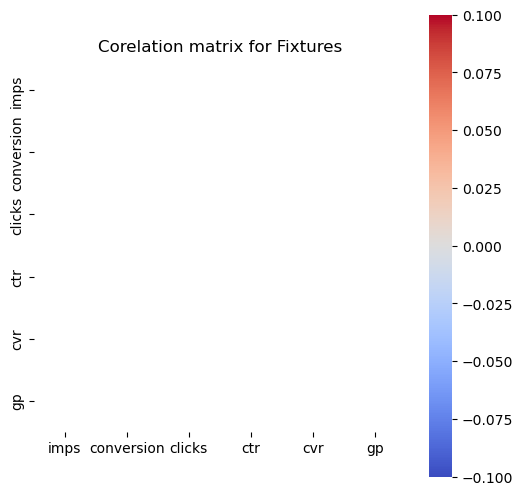

['lamps']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



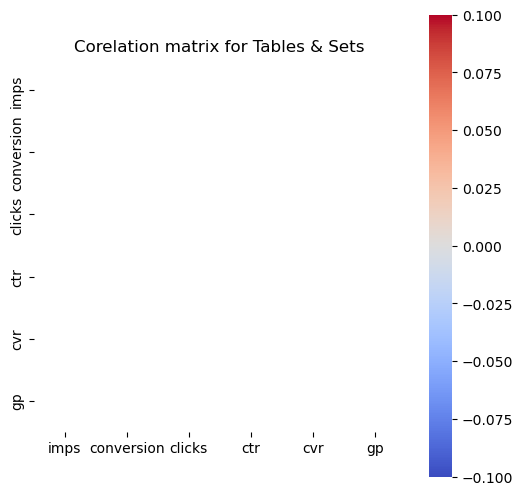

['kitchen table set']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



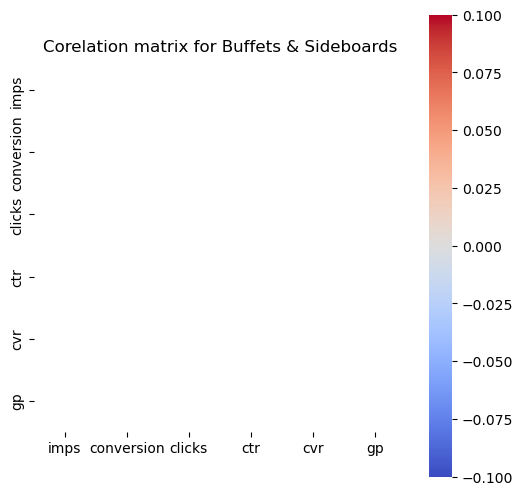

['kitchen cabinets']


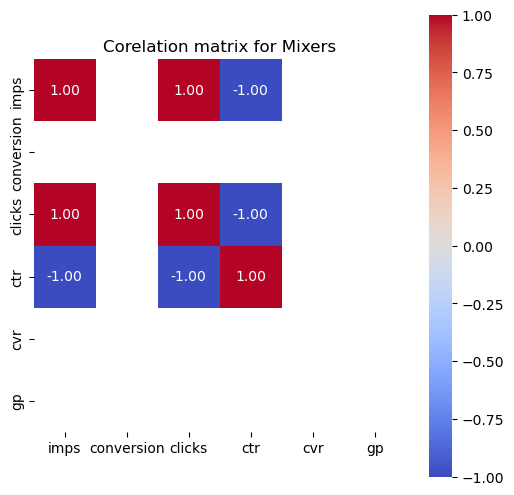

['kitchen aid', 'garlic/onion chopper']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



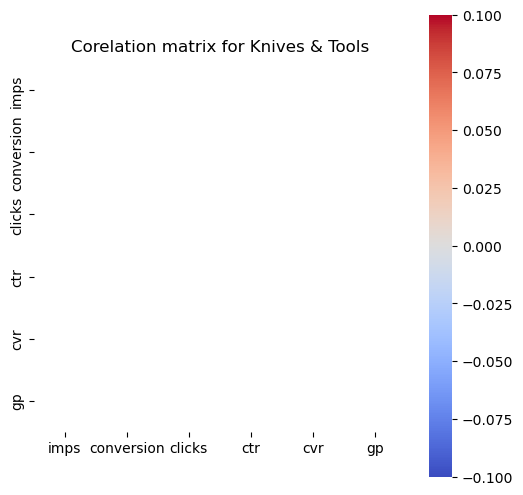

['knives']


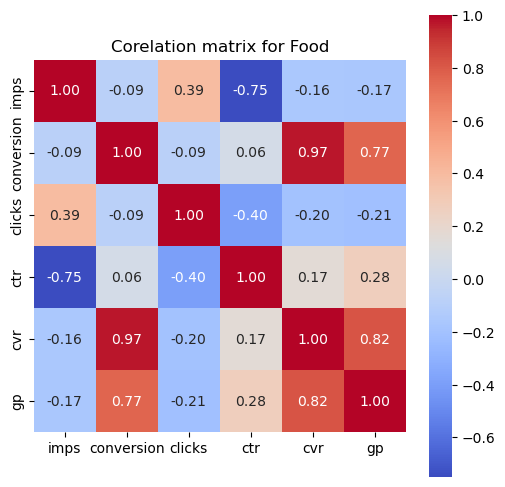

['tequila tasting', 'wine festival', 'chef scoochies', 'dishes', 'kids lunch box', 'ybor city', 'village idiot', 'salt cave new york city', 'sticky phone  holder', 'spice rack', 'stans donut fest', 'chocolate tour', 'creole queen river', 'bourbon', 'kitchen products', 'kroger', 'electric lunch box', 'food savers bags', 'gift basket food']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



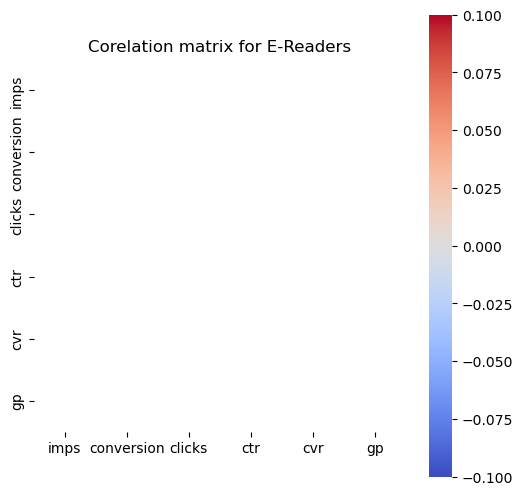

['kobo']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



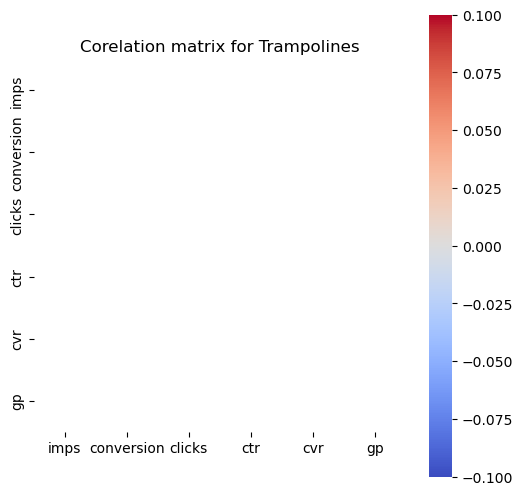

['launch family entertainment trampoline']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



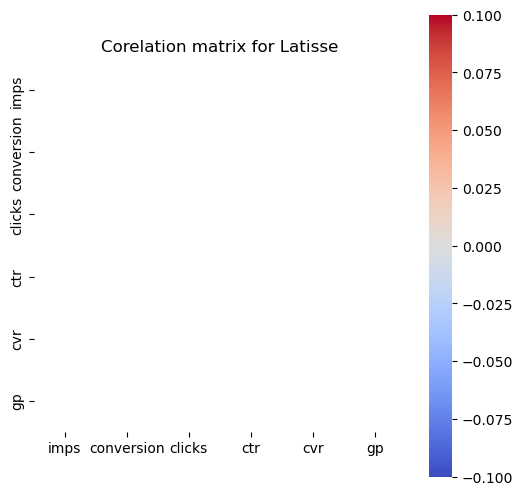

['latisse']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



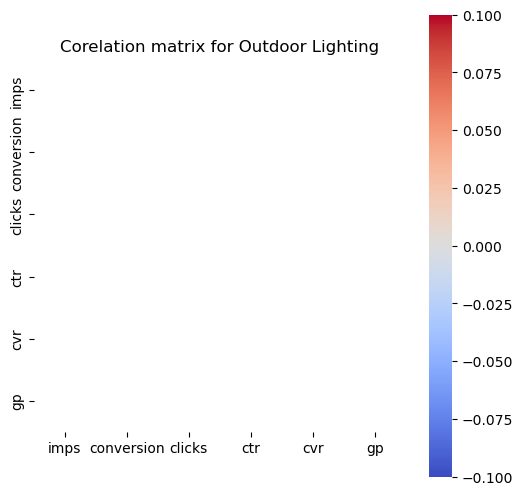

['lazer light show']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



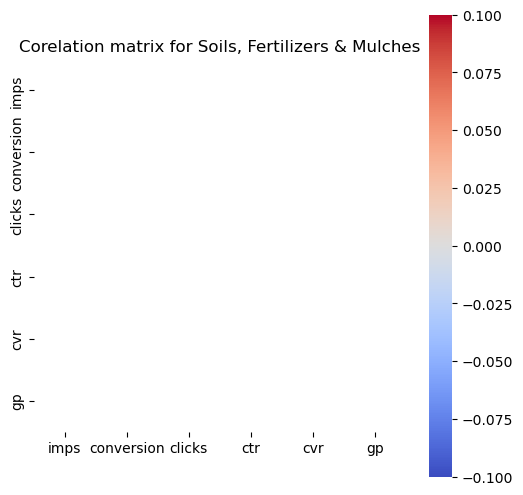

['lawn and garden']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



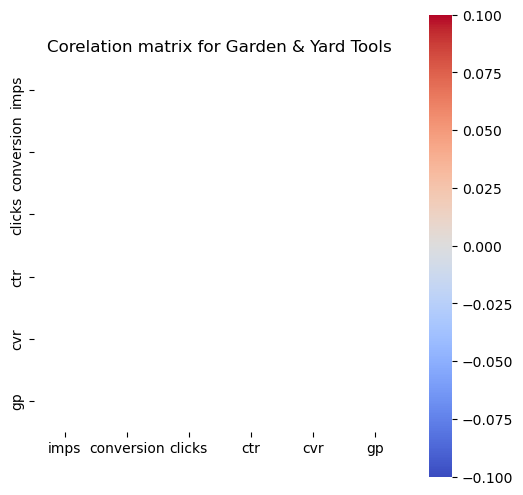

['lawn']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



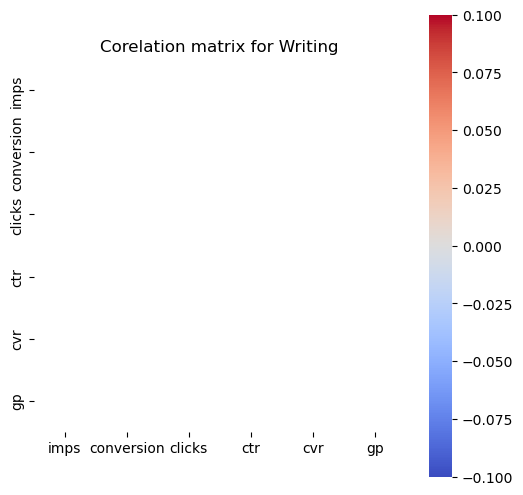

['laser  face lift']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



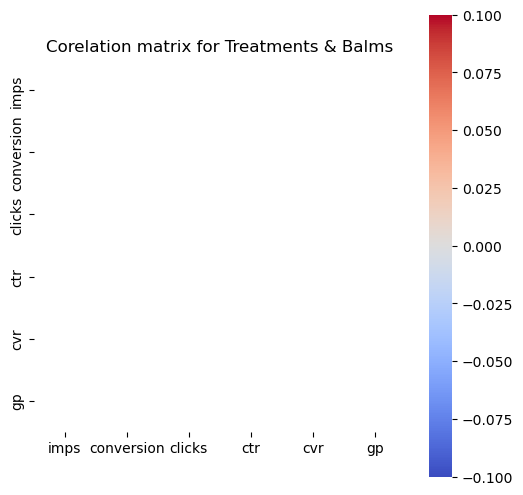

['laser lip plumping']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



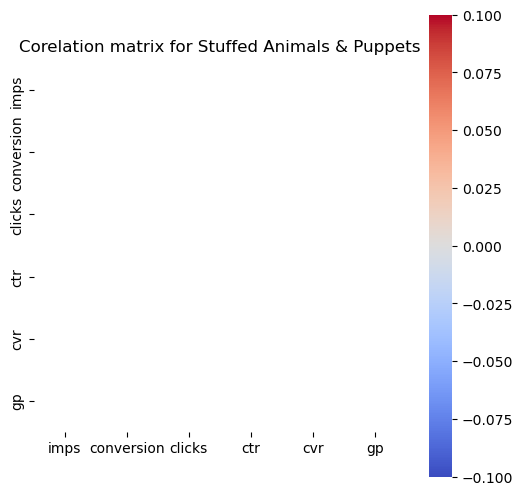

['kid open play session']


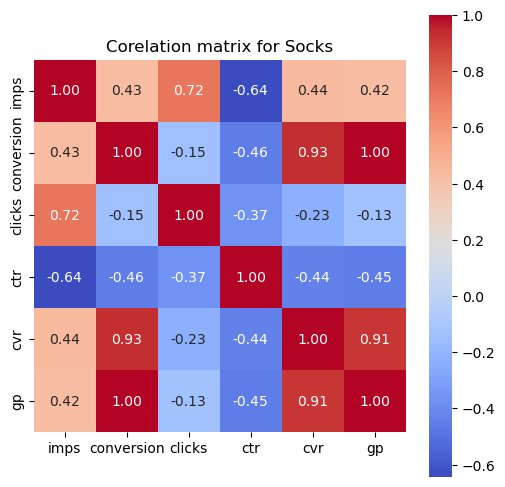

['holiday compression socks', 'compression socks', 'tights', 'thigh highs', 'winter', 'valentine’s day', 'socks', 'kids socks']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



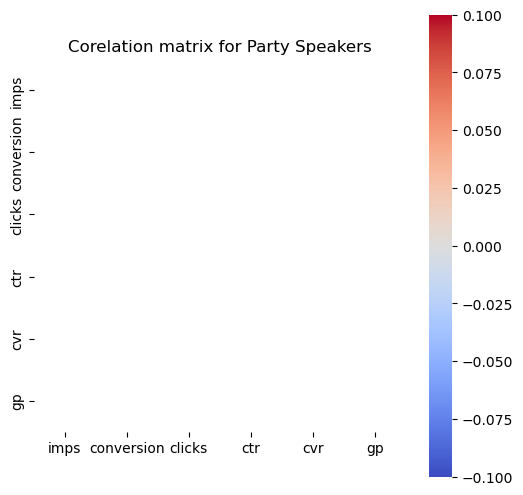

['karaoke']


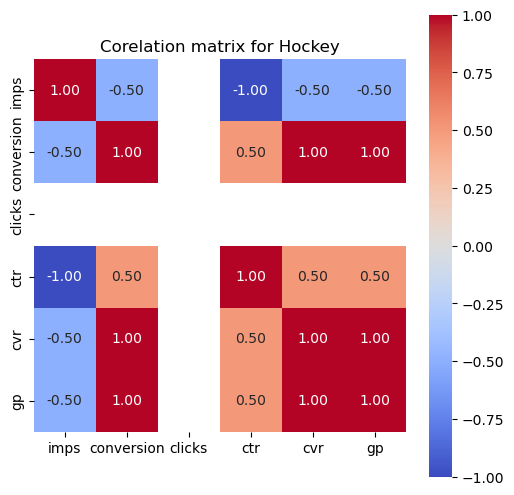

['chicago wolves', 'storage cube kids', 'fan']


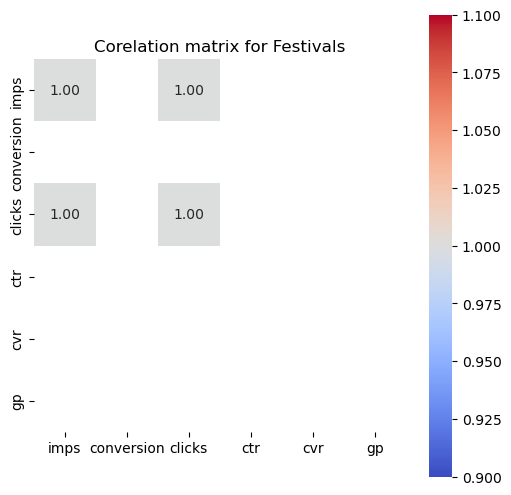

['fair', 'dry diggins']


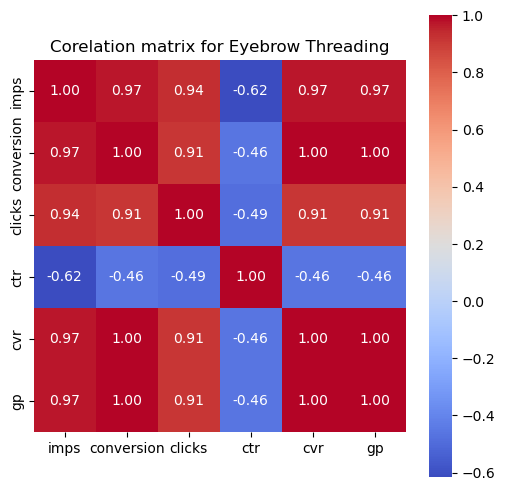

['eyebrow threading', 'wax eyeb', 'brow', 'beauty cafe', 'face lift injections', 'eyebrow coloring', 'eye brow threading', 'eyebrows wax']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



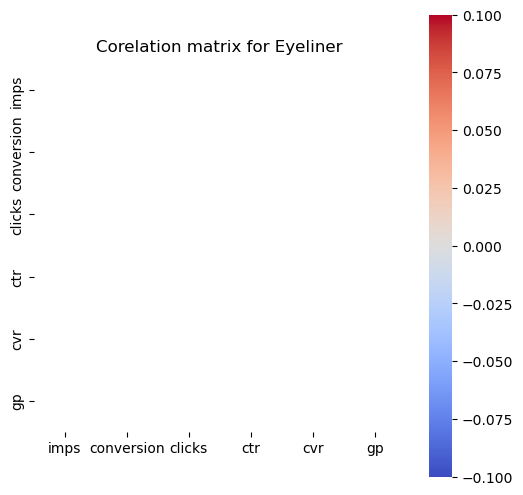

['eyeliner']


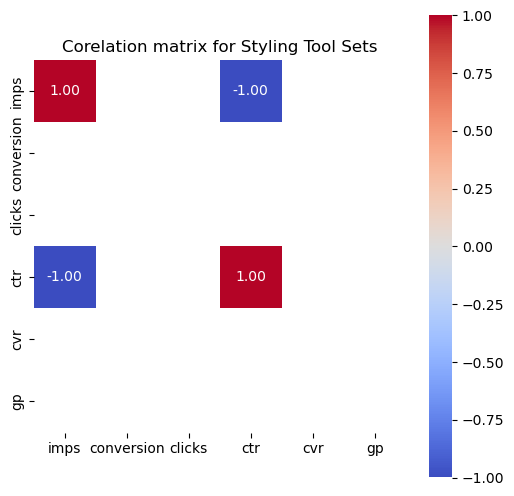

['female hair dryer', 'hair curling iron']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



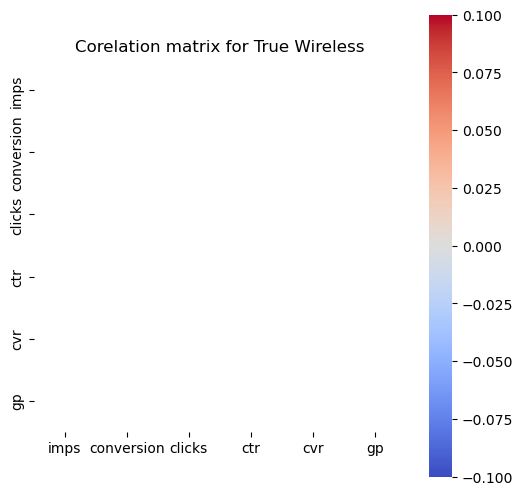

['earbuds']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



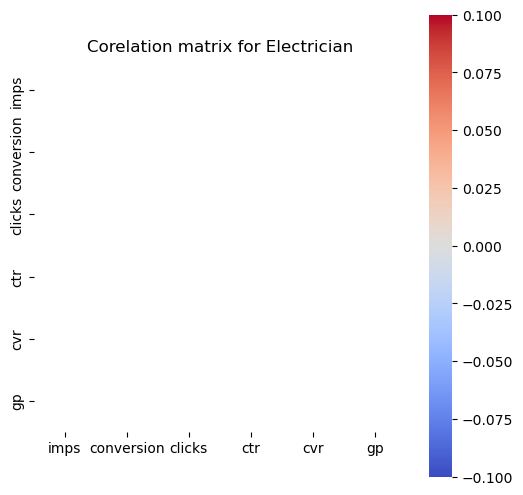

['electrician']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



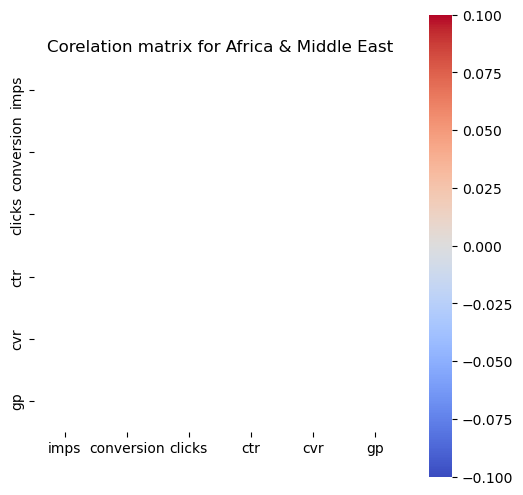

['egypt']


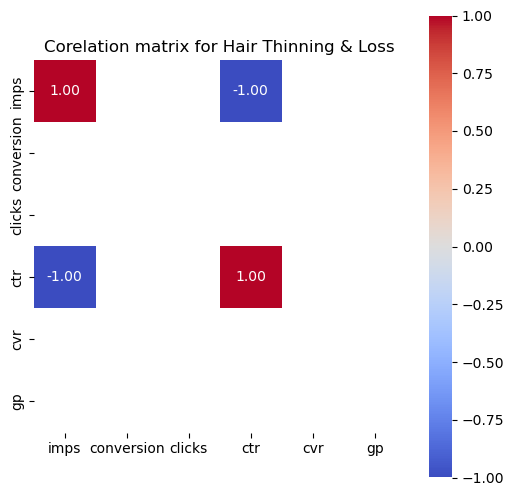

['ed', 'hair fiber']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



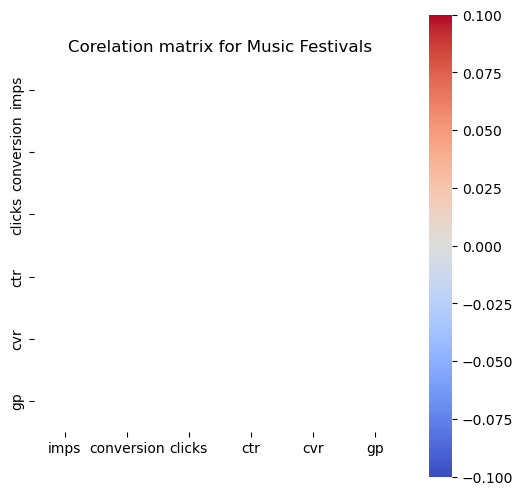

['dry diggins']


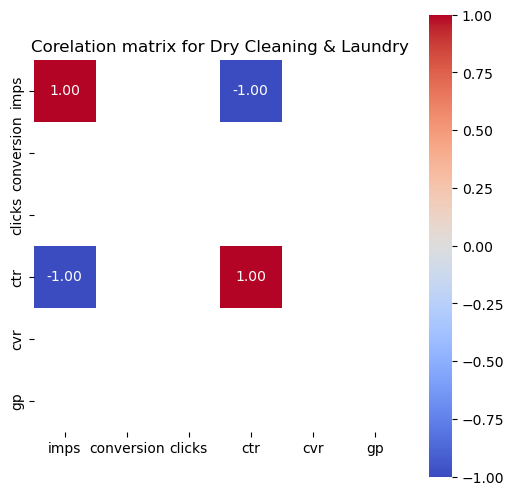

['dry cleaning', 'dry clean']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



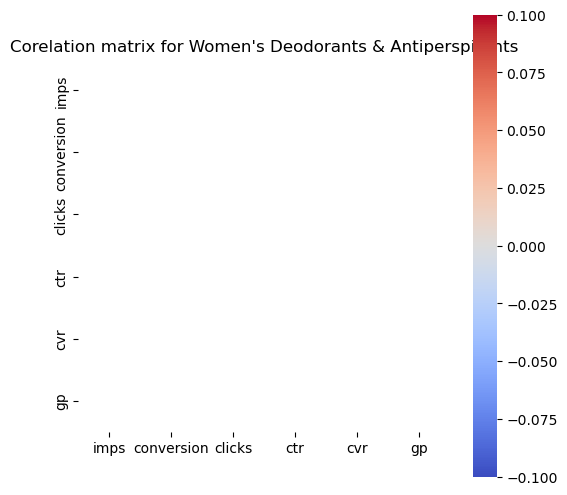

['dove deadorant']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



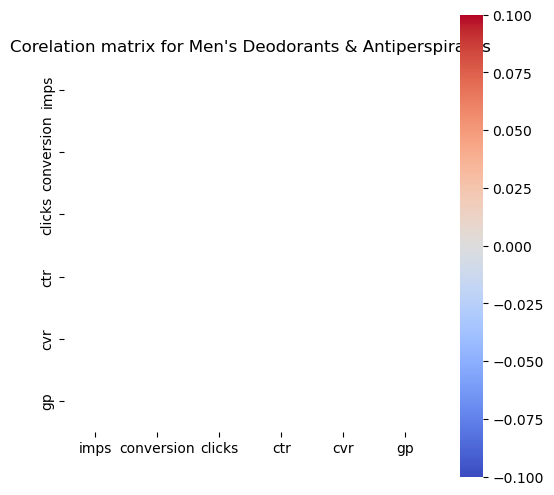

['dove']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



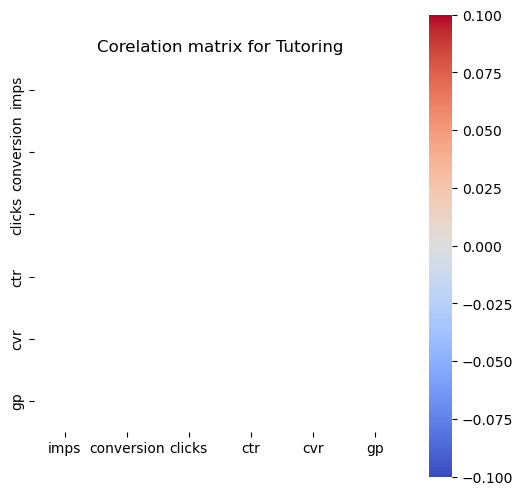

['doordash']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



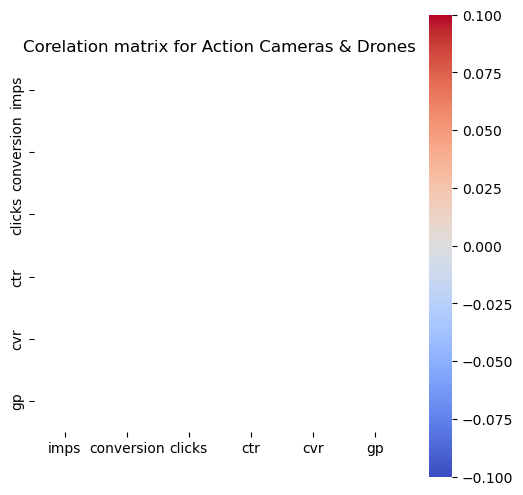

['drones']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



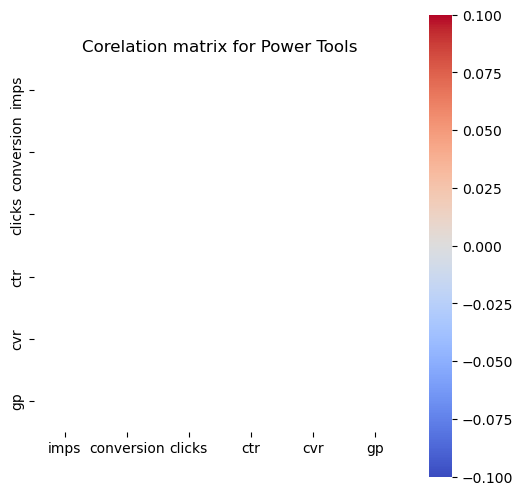

['drilling bits']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



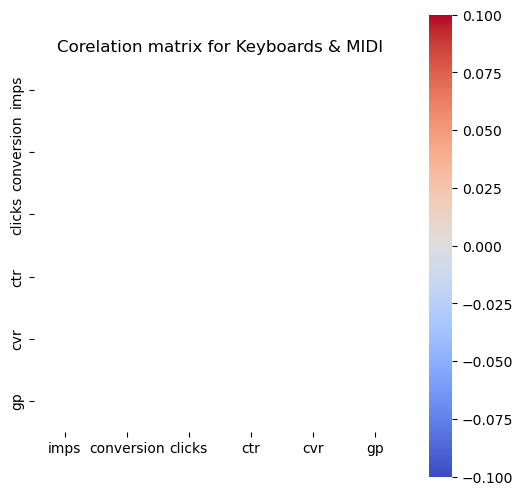

['electronic']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



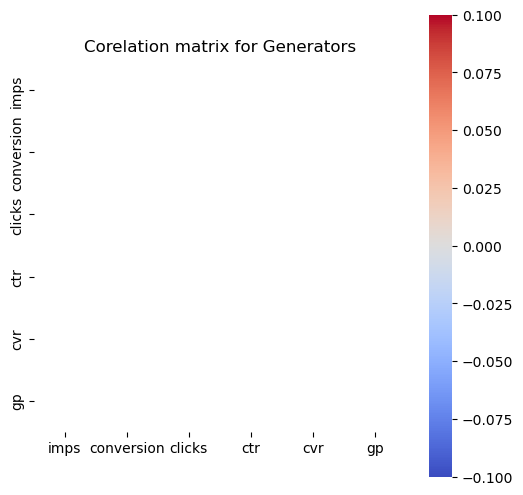

['electronics']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



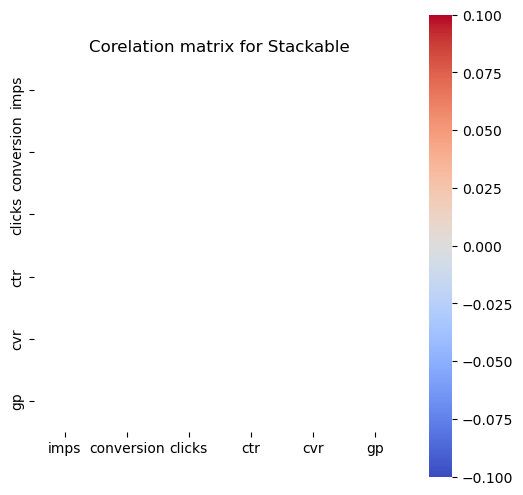

['eternity band']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



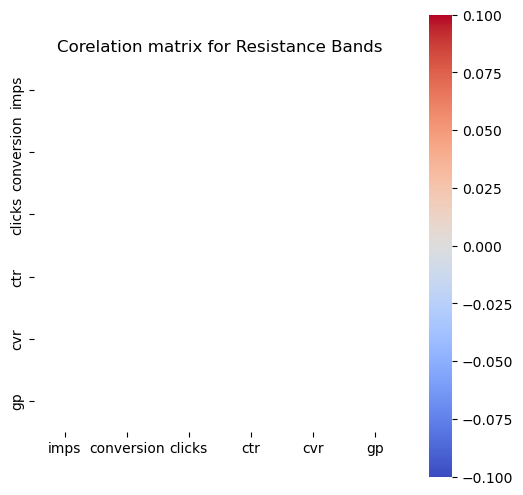

['exercise bands']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



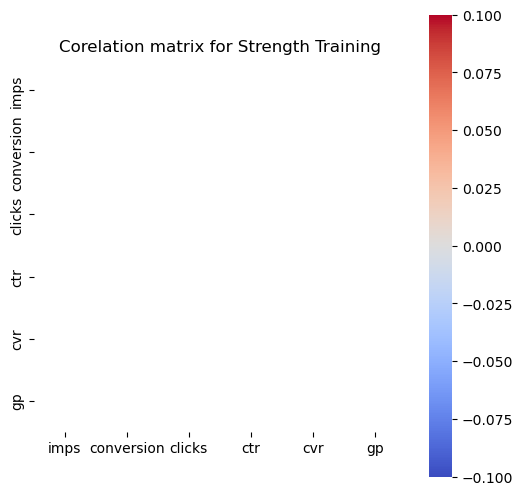

['exercise']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



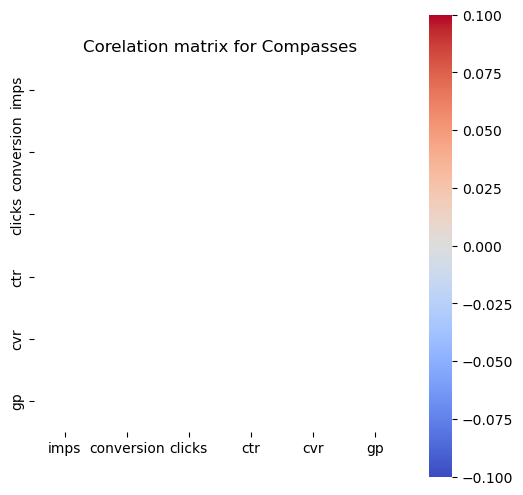

['emergency']


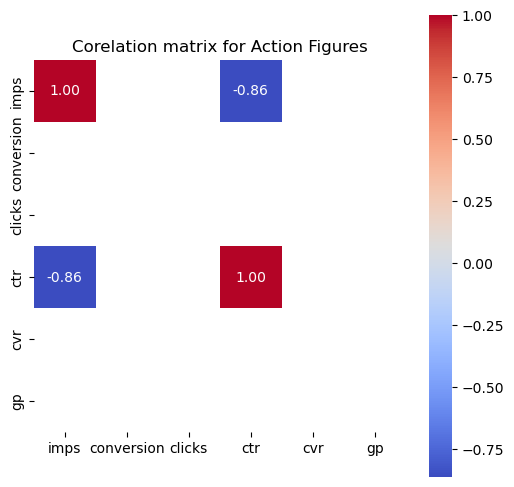

['elvis costello', 'funko pop', 'funco pop cheap']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



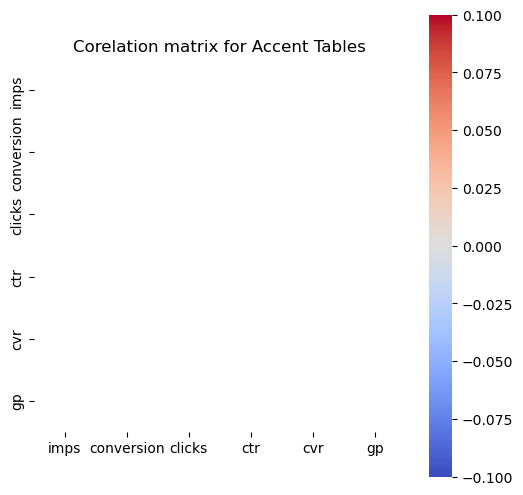

['entry table']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



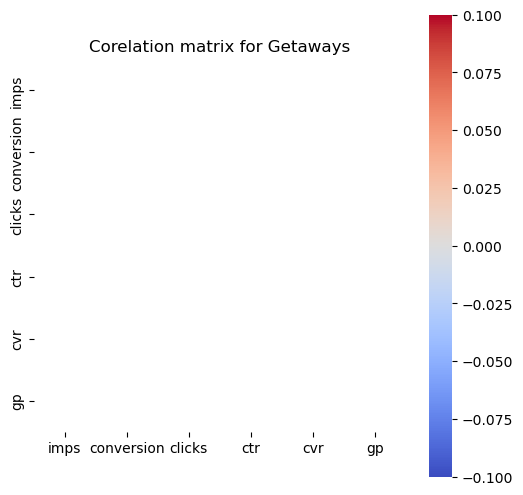

['enterprise rental car']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



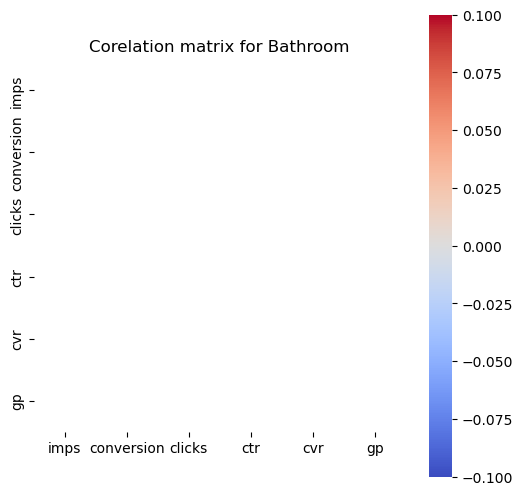

['diabetes', 'enema']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



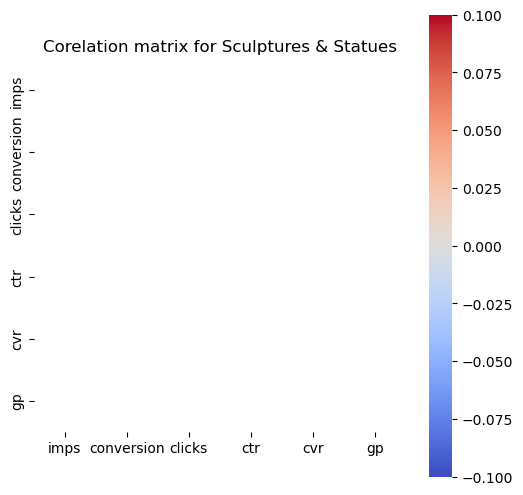

['green wall']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



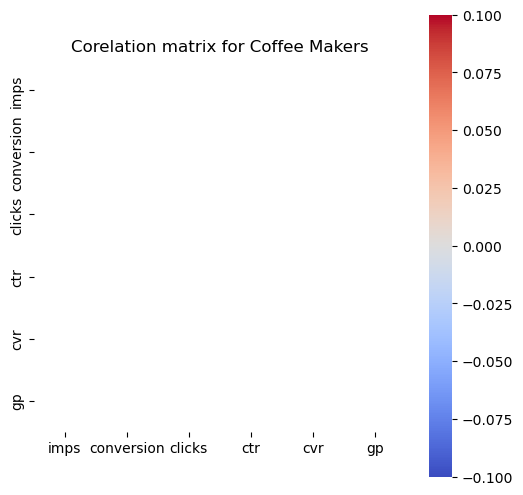

['green tea']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



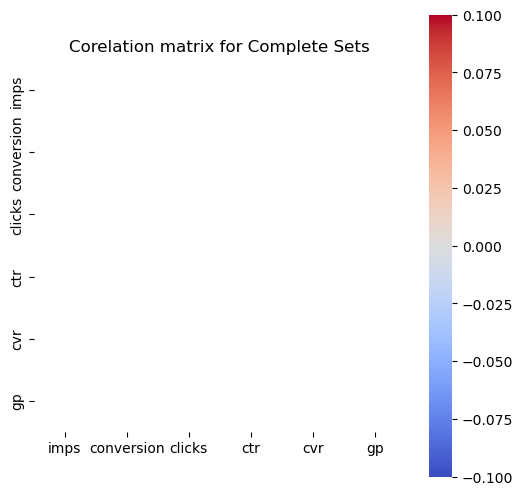

['golf clubs']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



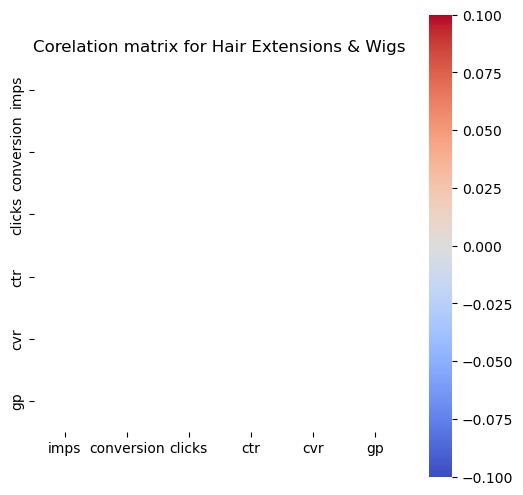

['hair extensions']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



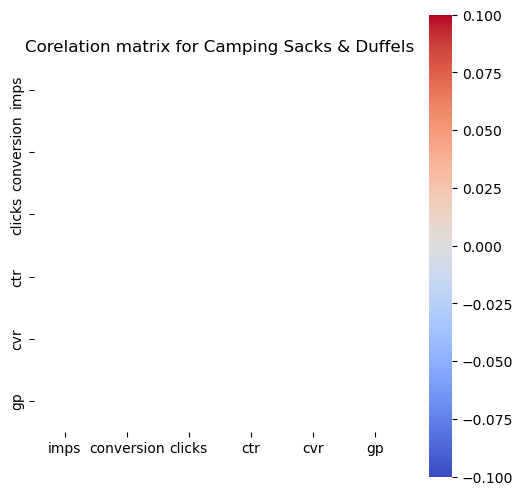

['gym bag']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



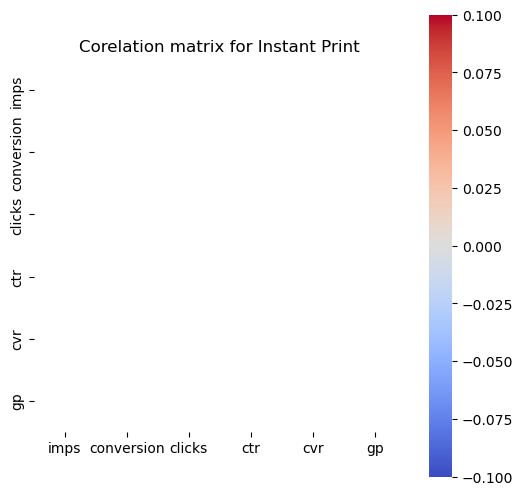

['fujifilm instax mini instant film']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



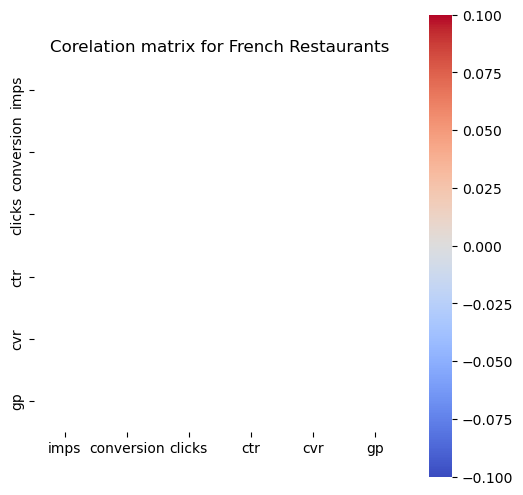

['french food']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



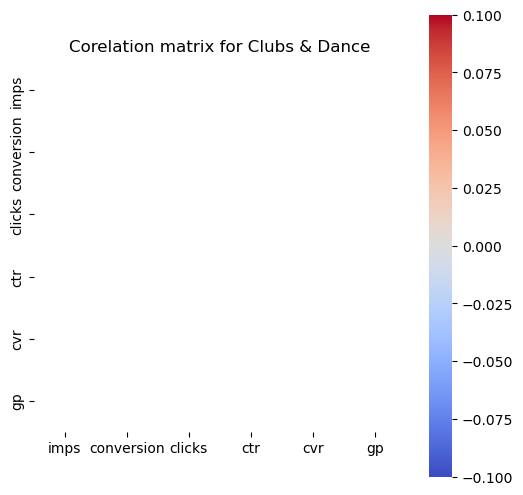

['freestyle']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



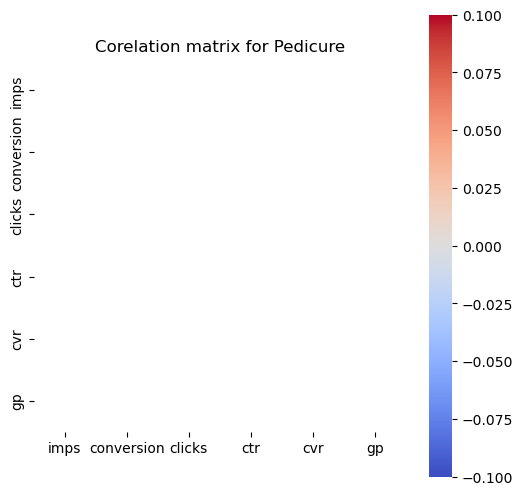

['full set pedicure']


/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:202: RuntimeWarning:

All-NaN slice encountered

/Users/zphilipp/miniconda3/lib/python3.12/site-packages/seaborn/matrix.py:207: RuntimeWarning:

All-NaN slice encountered



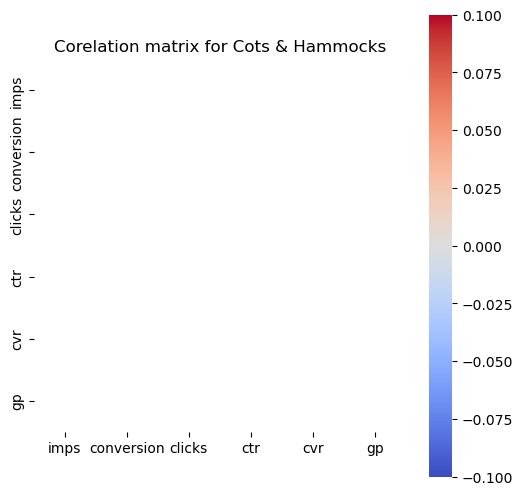

['folding mattress']


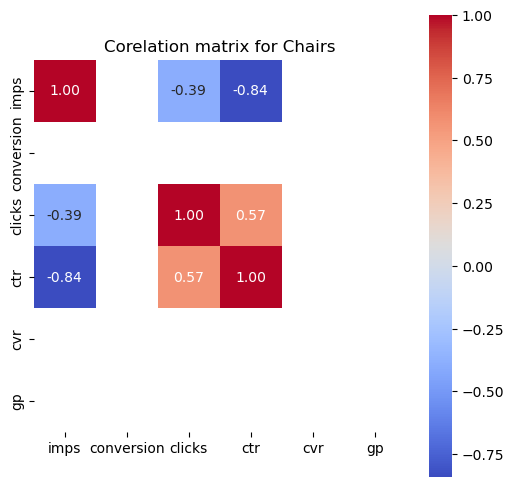

['patio table', 'recliner', 'accent chair', 'furniture movers']


In [267]:
df = df_source[["imps", "conversion", "clicks", "gp", "cft_cat_name", "query"]].query("clicks > 0").groupby(["query"]).agg({
    "clicks" : "sum", "cft_cat_name" : "first", "conversion" : "sum", "imps" : "sum", "gp" : "sum", "query" : "first", "cft_cat_name" : "first"}
)[["imps", "conversion", "clicks", "gp", "cft_cat_name"]].reset_index().sort_values("gp", ascending = False)#.query("query == 'botox'").head(1)
df["ctr"] = df["clicks"] / df["imps"]
df["cvr"] = df["conversion"] / df["clicks"]

for name in df["cft_cat_name"].unique():
    filtered_df = df[df['cft_cat_name'].str.contains(str(name), na=False)]

    d = pd.DataFrame(filtered_df)
    correlation_matrix = d[["imps", "conversion", "clicks", "ctr", "cvr", "gp"]].corr()
    queries = d["query"].unique().tolist()
    plt.figure(figsize=(6, 6))
    sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm', square=True)
    plt.title('Corelation matrix for %s' % name)
    plt.show()
    print (queries)